<a href="https://colab.research.google.com/github/Rodrigo-Lopes-de-Andrade/Artigos_e_Projetos/blob/main/Seaborn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="darkgrid")
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 100

## 1. Gráficos de dispersão

O gráfico de dispersão é um dos pilares da visualização estatística. Ele descreve a distribuição conjunta de duas variáveis ​​usando uma nuvem de pontos, onde cada ponto representa uma observação no conjunto de dados.

In [ ]:
df = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/tips.csv')

In [ ]:
df.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


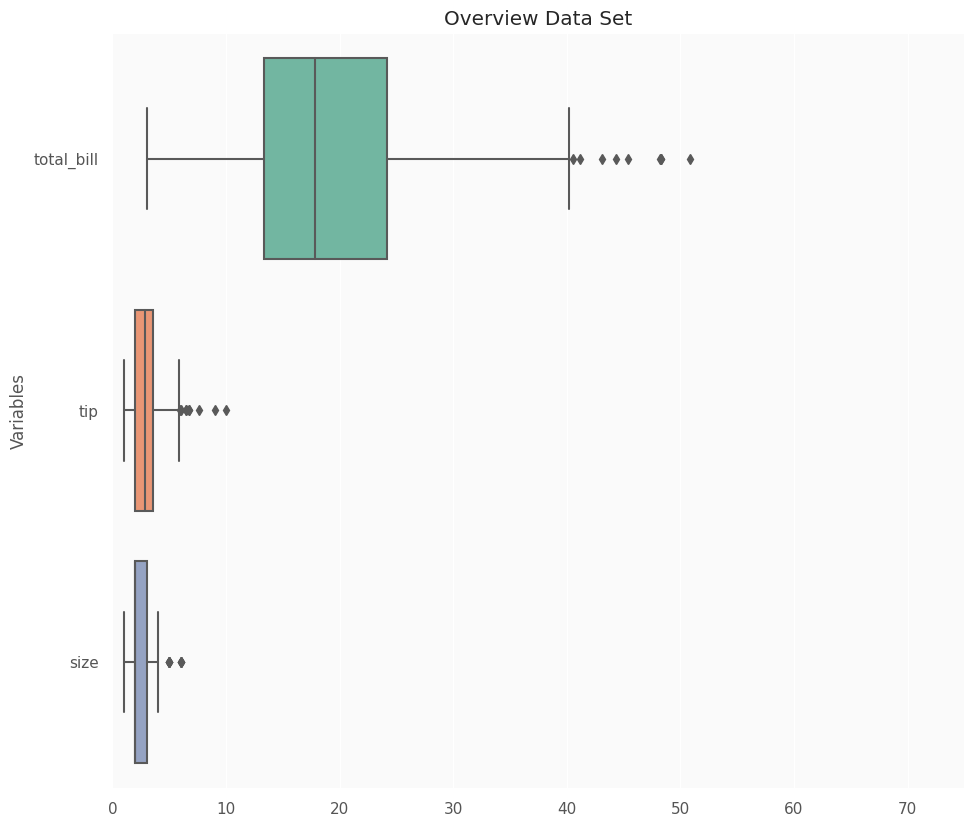

In [ ]:
plt.style.use('ggplot') # Using ggplot2 style visuals 

f, ax = plt.subplots(figsize=(11, 10))

ax.set_facecolor('#fafafa')
ax.set(xlim=(-.05, 75))
plt.ylabel('Variables')
plt.title("Overview Data Set")
ax = sns.boxplot(data = df, 
  orient = 'h', 
  palette = 'Set2')

In [ ]:
from collections import Counter
### Zoom datasets 
def zoom_dataset(data):
    Count_missing_val = data.isnull().sum()
    Percent_missing = (data.isnull().sum()/data.isnull().count()*100)
    Percent_no_missing = 100 - Percent_missing
    Count_unique = data.nunique()
    Percent_unique_val = Count_unique / len(data)*100
    Type = data.dtypes
    data=[[i, Counter(data[i][data[i].notna()]).most_common(3)] for i in list(data)]
    top = pd.DataFrame(data, columns=['Name', 'Top_3']).set_index(['Name'])
    tt = pd.concat([Percent_no_missing, Count_missing_val, Percent_missing, Count_unique, Percent_unique_val, Type], axis=1, 
                   keys=['Percent_no_missing','Count_missing_val', 'Percent_missing', ' Count_unique', 'Percent_unique_val', 'Type'])
    tt = pd.concat([tt, top[['Top_3']]], axis=1, sort=False).reset_index()
    return((tt))

In [ ]:
#overview train - test
for i in [train, test]:
    display(zoom_dataset(i))

NameError: ignored

In [ ]:
#overview train - test
for i in [df]:
    display(zoom_dataset(i))

,Name,Percent_no_missing,Count_missing_val,Percent_missing,Count_unique,Percent_unique_val,Type,Top_3
0,total_bill,100.0,0,0.0,229,93.852459,float64,"[(13.42, 3), (10.34, 2), (21.01, 2)]"
1,tip,100.0,0,0.0,123,50.409836,float64,"[(2.0, 33), (3.0, 23), (4.0, 12)]"
2,sex,100.0,0,0.0,2,0.819672,object,"[(Male, 157), (Female, 87)]"
3,smoker,100.0,0,0.0,2,0.819672,object,"[(No, 151), (Yes, 93)]"
4,day,100.0,0,0.0,4,1.639344,object,"[(Sat, 87), (Sun, 76), (Thur, 62)]"
5,time,100.0,0,0.0,2,0.819672,object,"[(Dinner, 176), (Lunch, 68)]"
6,size,100.0,0,0.0,6,2.459016,int64,"[(2, 156), (3, 38), (4, 37)]"


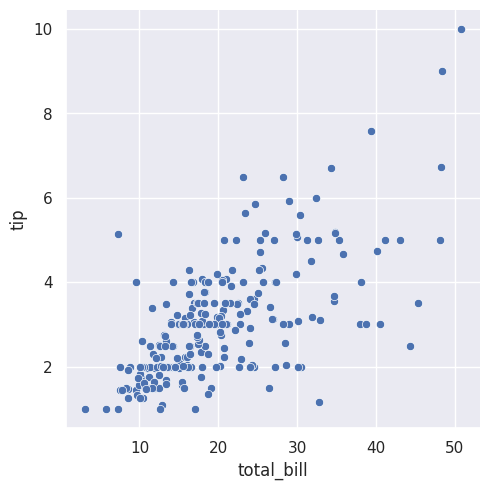

In [ ]:
sns.relplot(x="total_bill", y="tip",color = 'b', data=df);

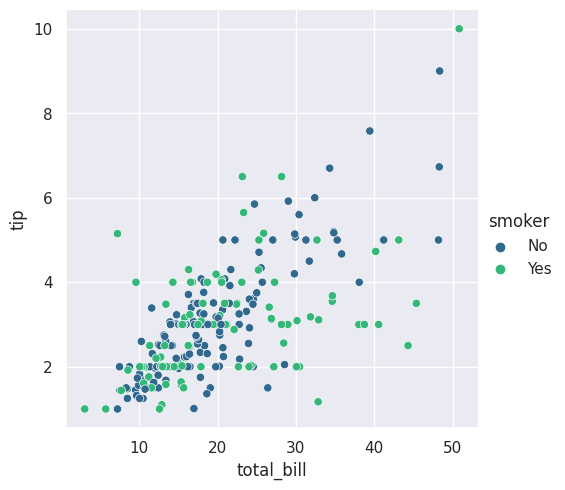

In [ ]:
sns.relplot(x="total_bill", y="tip", hue="smoker",palette = 'viridis', data=df);

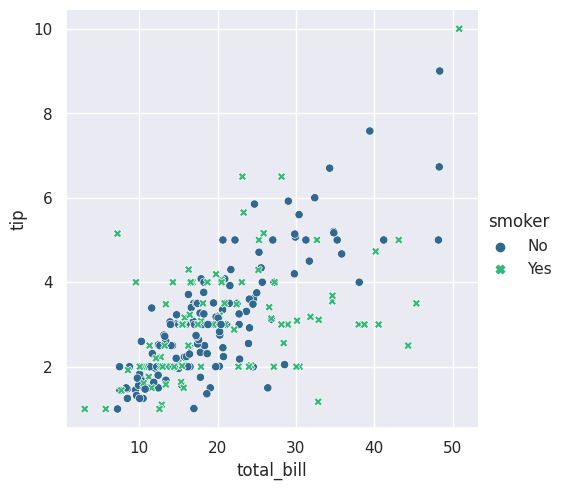

In [ ]:
sns.relplot(x="total_bill", y="tip", hue="smoker", style="smoker",
            data=df, palette = 'viridis');

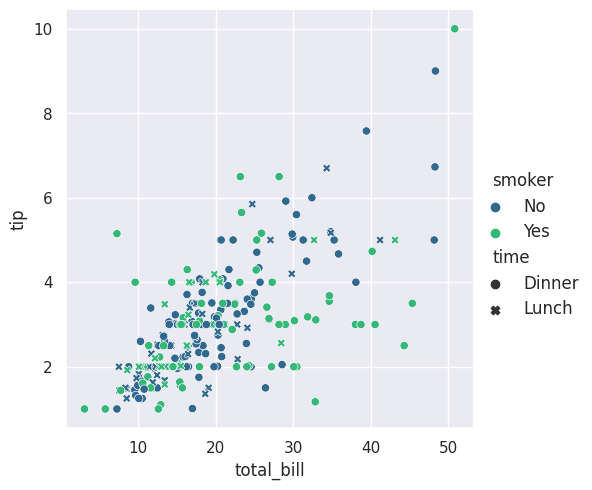

In [ ]:
sns.relplot(x="total_bill", y="tip", hue="smoker", style="time", data=df ,palette = 'viridis');

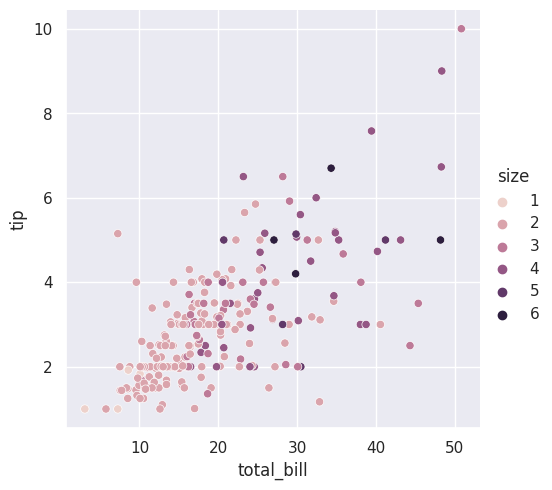

In [ ]:
sns.relplot(x="total_bill", y="tip", hue="size", data=df);

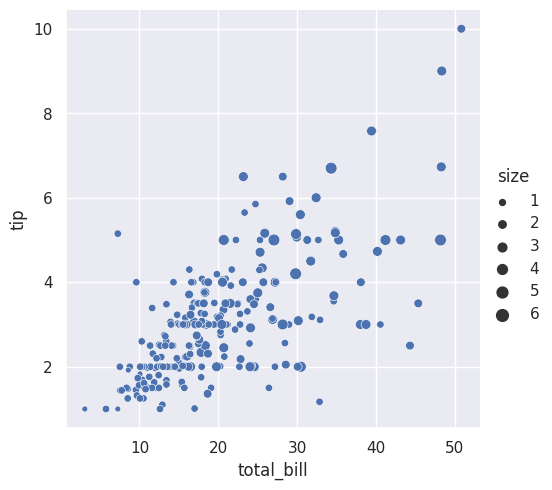

In [ ]:
sns.relplot(x="total_bill", y="tip", size="size", data=df);

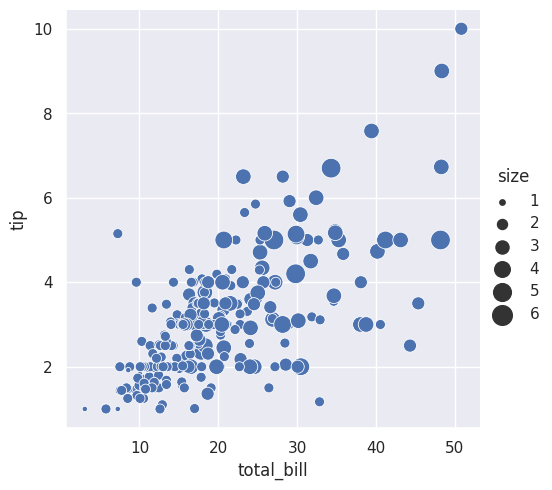

In [ ]:
sns.relplot(x="total_bill", y="tip", size="size", sizes=(15, 200), data=df);

## 2.Line Plots

Com alguns conjuntos de dados, você pode querer entender as mudanças em uma variável como uma função do tempo ou uma variável contínua semelhante. Nessa situação, uma boa opção é desenhar um gráfico linear. No mar, isso pode ser realizado pela função lineplot (), diretamente ou com relplot () configurando kind = "line":


### Agregação e Representação da Incerteza

Conjuntos de dados mais complexos terão várias medições para o mesmo valor da variável x. O comportamento padrão no marítimo é agregar as medições múltiplas em cada valor x traçando a média e o intervalo de confiança de 95% em torno da média:

In [ ]:
df=pd.read_csv("https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/fmri.csv")
df.head()

,subject,timepoint,event,region,signal
0,s13,18,stim,parietal,-0.017552
1,s5,14,stim,parietal,-0.080883
2,s12,18,stim,parietal,-0.081033
3,s11,18,stim,parietal,-0.046134
4,s10,18,stim,parietal,-0.037970


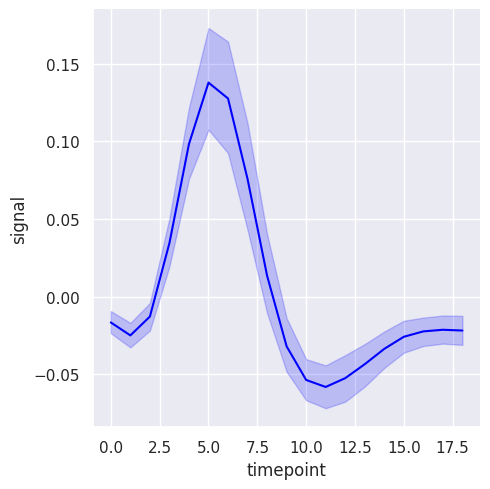

In [ ]:
sns.relplot(x="timepoint", y="signal", kind="line", data=df,color = 'blue');


Os intervalos de confiança são calculados usando bootstrap, que pode ser demorado para conjuntos de dados maiores. Portanto, é possível desativá-los:

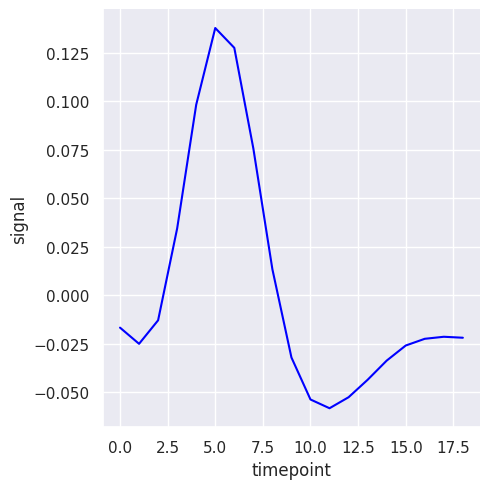

In [ ]:
sns.relplot(x="timepoint", y="signal", ci=None, kind="line",color='blue', data=df);


Outra boa opção, especialmente com dados maiores, é representar a dispersão da distribuição em cada ponto de tempo traçando o desvio padrão em vez de um intervalo de confiança:

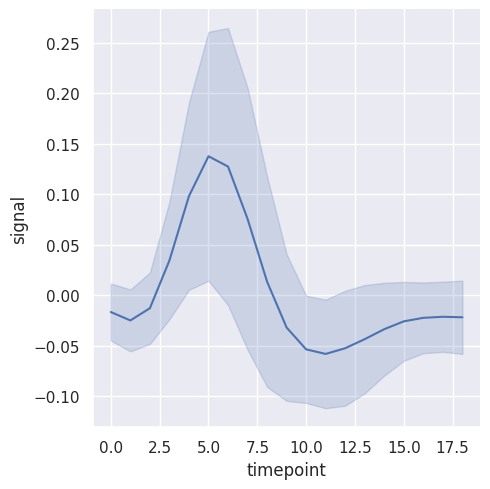

In [ ]:
sns.relplot(x="timepoint", y="signal", kind="line", ci="sd", data=df);

Para desligar completamente a agregação, defina o parâmetro do estimador como Nenhum. Isso pode produzir um efeito estranho quando os dados têm várias observações em cada ponto.

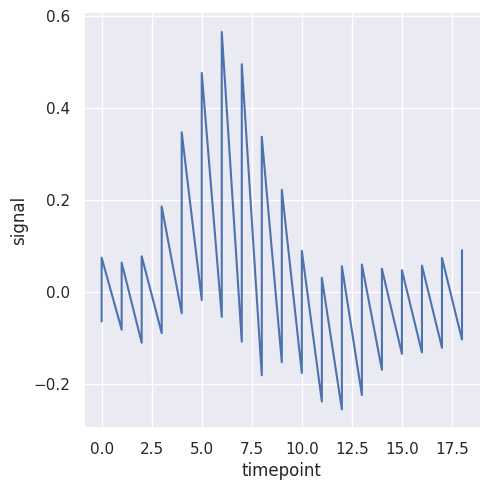

In [ ]:
sns.relplot(x="timepoint", y="signal", estimator=None, kind="line", data=df);


### Plotando subconjuntos de dados com mapeamentos semânticos

A função lineplot () tem a mesma flexibilidade que scatterplot (): ela pode mostrar até três variáveis ​​adicionais, modificando o matiz, o tamanho e o estilo dos elementos do gráfico.

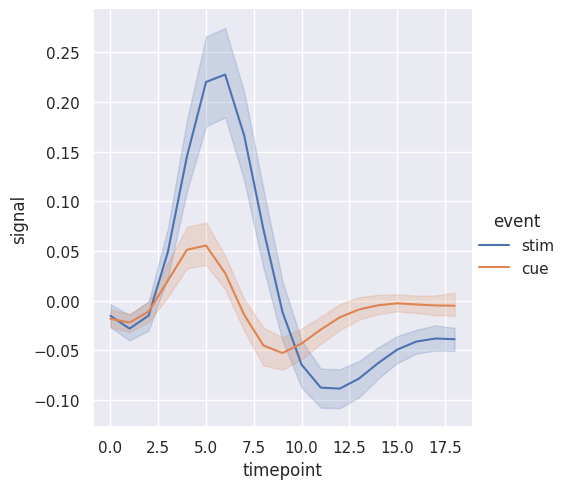

In [ ]:
sns.relplot(x="timepoint", y="signal", hue="event", kind="line", data=df);

Adicionar uma semântica de estilo a um gráfico de linha altera o padrão de traços na linha por padrão:

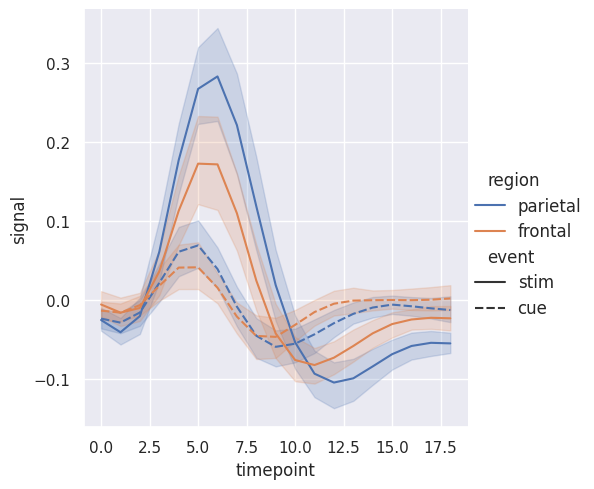

In [ ]:
sns.relplot(x="timepoint", y="signal", hue="region", style="event",
            kind="line", data=df);


> Mas você pode identificar subconjuntos pelos marcadores usados ​​em cada observação, seja junto com os travessões ou em vez deles:

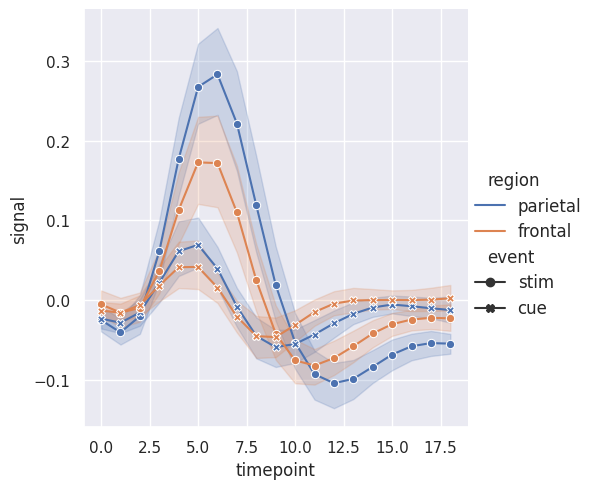

In [ ]:
sns.relplot(x="timepoint", y="signal", hue="region", style="event",
            dashes=False, markers=True, kind="line", data=df);

Mesmo quando você está examinando apenas as alterações em uma variável adicional, pode ser útil alterar a cor e o estilo das linhas. Isso pode tornar o gráfico mais acessível quando impresso em preto e branco ou visualizado por alguém com daltonismo:

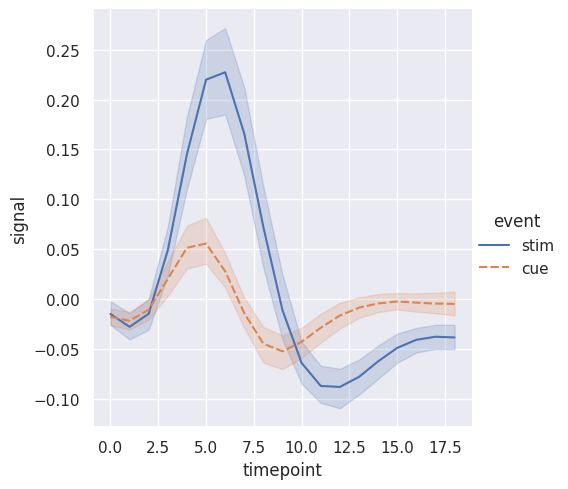

In [ ]:
sns.relplot(x="timepoint", y="signal", hue="event", style="event",
            kind="line", data=df);

O mapa de cores padrão e o tratamento da legenda no gráfico de linha () também dependem se a semântica do matiz é categórica ou numérica:

In [ ]:
df=pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/dots.csv')
df.head()

,align,choice,time,coherence,firing_rate
0,dots,T1,-80,0.0,33.189967
1,dots,T1,-80,3.2,31.691726
2,dots,T1,-80,6.4,34.279840
3,dots,T1,-80,12.8,32.631874
4,dots,T1,-80,25.6,35.060487



Pode acontecer que, embora a variável matiz seja numérica, ela seja mal representada por uma escala de cores linear. Esse é o caso aqui, onde os níveis da variável matiz são escalonados logaritmicamente. Você pode fornecer valores de cor específicos para cada linha, passando uma lista ou dicionário:

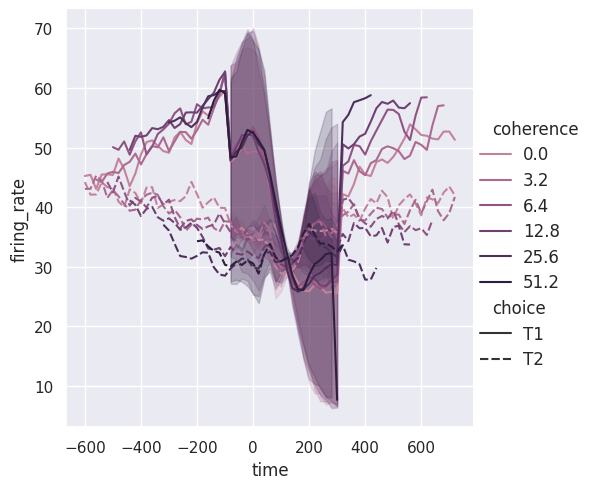

In [ ]:
palette = sns.cubehelix_palette(light=0.6, n_colors=6)
sns.relplot(x="time", y="firing_rate",
            hue="coherence", style="choice",
            palette=palette,
            kind="line", data=df);

### Plotando com dados de data

Os gráficos de linha costumam ser usados ​​para visualizar dados associados a datas e horas reais. Essas funções passam os dados em seu formato original para as funções matplotlib subjacentes e, assim, podem tirar proveito da capacidade do matplotlib de formatar datas em rótulos de escala. Mas toda essa formatação terá que ocorrer na camada matplotlib, e você deve consultar a documentação do matplotlib para ver como funciona:

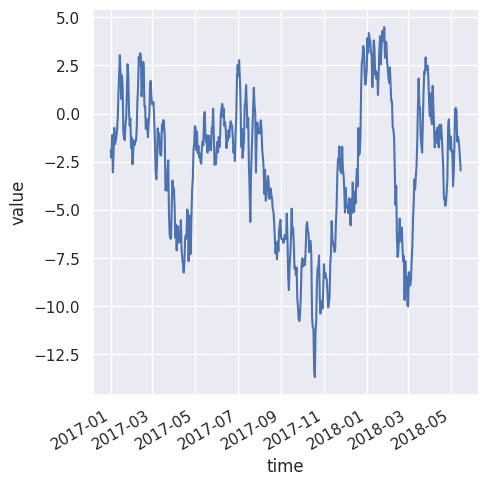

In [ ]:
df = pd.DataFrame(dict(time=pd.date_range("2017-1-1", periods=500),
                       value=np.random.randn(500).cumsum()))
g = sns.relplot(x="time", y="value", kind="line", data=df)
g.fig.autofmt_xdate()

### Facetes

Isso significa que você cria vários eixos e subconjuntos de dados em cada um deles:

In [ ]:
df = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/tips.csv')

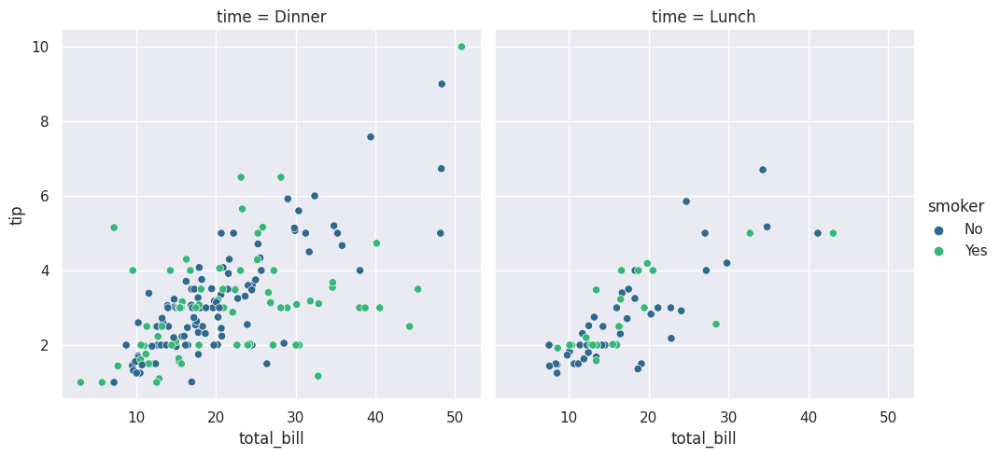

In [ ]:
sns.relplot(x="total_bill", y="tip", hue="smoker",
            col="time", data=df,palette='viridis');

> Você também pode mostrar a influência de duas variáveis ​​desta forma: uma facetando nas colunas e outra facetando nas linhas. Conforme você começa a adicionar mais variáveis ​​à grade, você pode querer diminuir o tamanho da figura. Lembre-se de que o tamanho do FacetGrid é parametrizado pela altura e proporção de cada faceta:

In [ ]:
df=pd.read_csv("https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/fmri.csv")

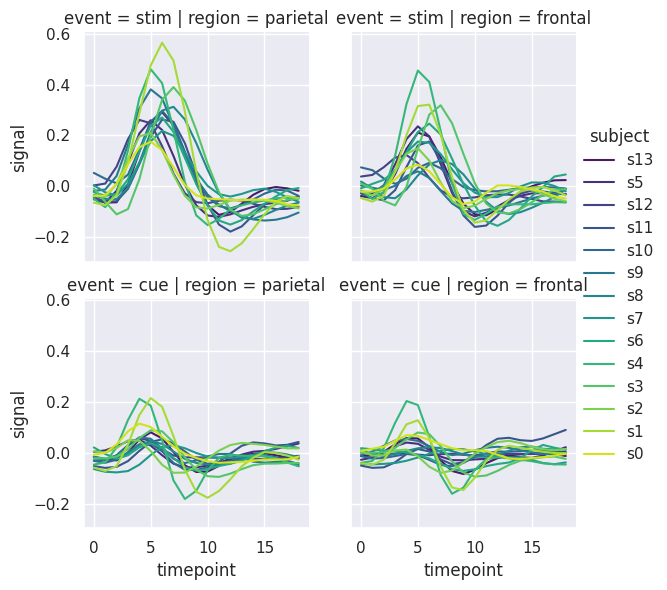

In [ ]:
sns.relplot(x="timepoint", y="signal", hue="subject",
            col="region", row="event",palette = 'viridis', height=3,
            kind="line", estimator=None, data=df);

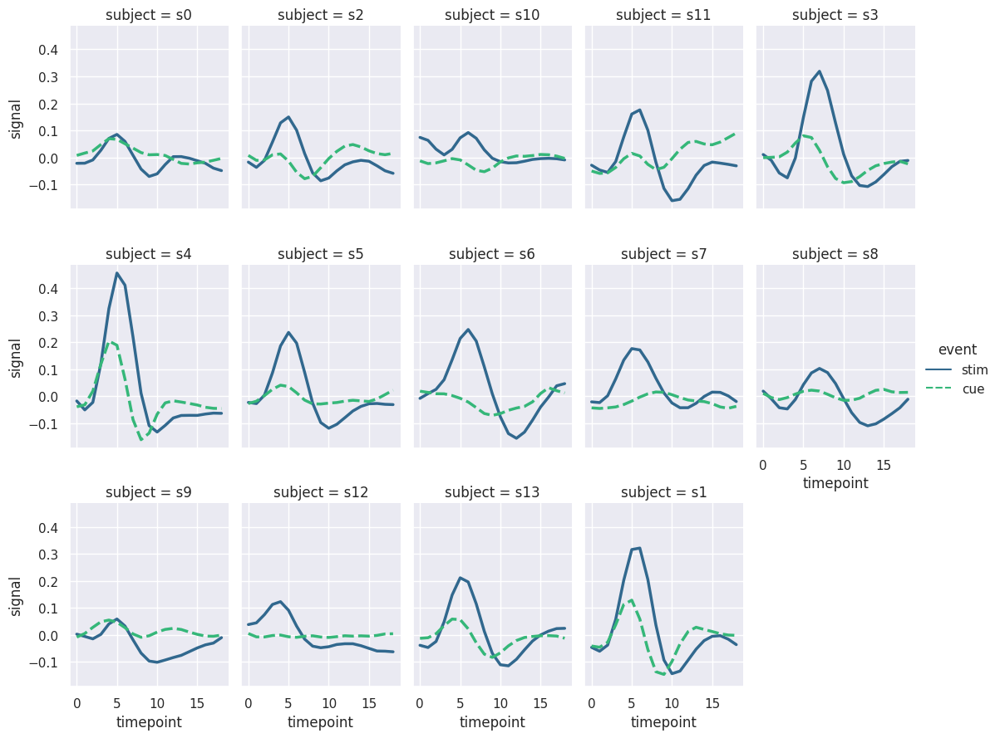

In [ ]:
sns.relplot(x="timepoint", y="signal", hue="event", style="event",
            col="subject", col_wrap=5,palette = 'viridis',
            height=3, aspect=.75, linewidth=2.5,
            kind="line", data=df.query("region == 'frontal'"));

# Dados categóricos

Se uma das variáveis ​​principais for “categórica” (dividida em grupos discretos), pode ser útil usar uma abordagem mais especializada para visualização. Existem duas maneiras de fazer esses gráficos. Existem várias funções de nível de eixo para traçar dados categóricos de diferentes maneiras e uma interface de nível de figura, catplot (), que fornece acesso unificado de nível superior a eles.

É útil pensar nos diferentes tipos de tramas categóricas como pertencentes a três famílias diferentes, que discutiremos em detalhes abaixo. Eles são:

> Gráficos de dispersão categóricos:

stripplot () (com kind = "strip"; o padrão)

swarmplot () (com kind = "swarm")

> Gráficos de distribuição categórica:

boxplot () (com tipo = "caixa")

violinplot () (com kind = "violin")

boxenplot () (com kind = "boxen")

> Gráficos de estimativa categórica:

pointplot () (com kind = "point")

barplot () (com kind = "bar")

countplot () (com kind = "count")

In [ ]:
sns.set(style="ticks", color_codes=True)

## Gráficos de dispersão categóricos

A representação padrão dos dados em catplot () usa um gráfico de dispersão.

In [ ]:
fmri=pd.read_csv("https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/fmri.csv")

In [ ]:
tips = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/tips.csv')

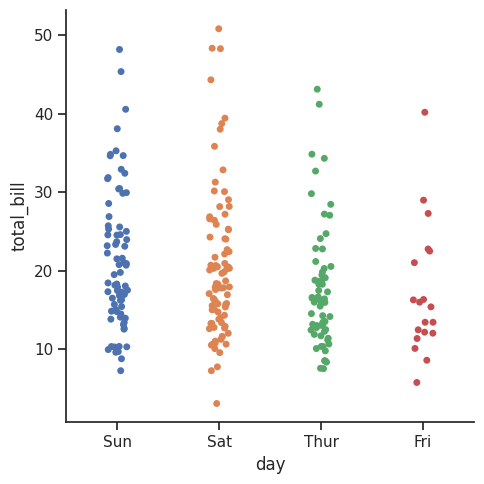

In [ ]:
sns.catplot(x="day", y="total_bill", data=tips, jitter = True);

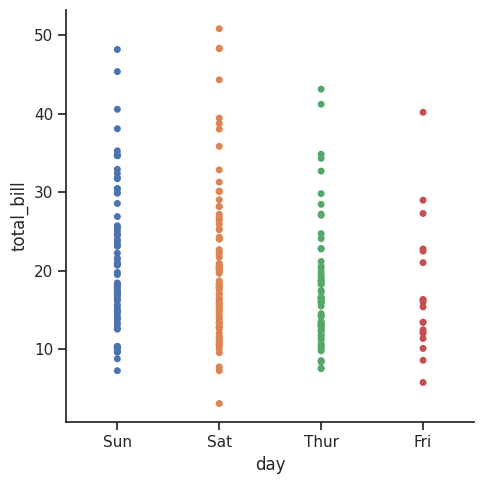

In [ ]:
sns.catplot(x="day", y="total_bill", data=tips, jitter = False);

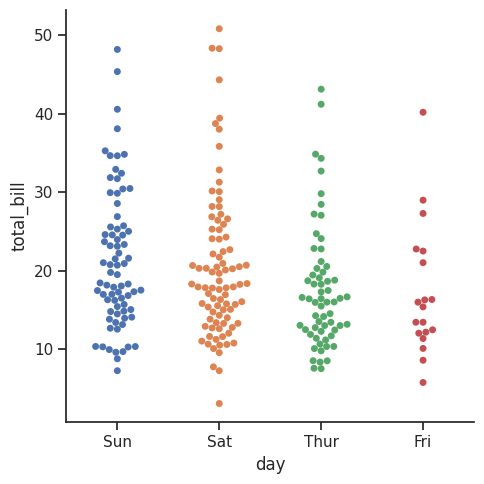

In [ ]:
sns.catplot(x="day", y="total_bill", kind="swarm", data=tips);

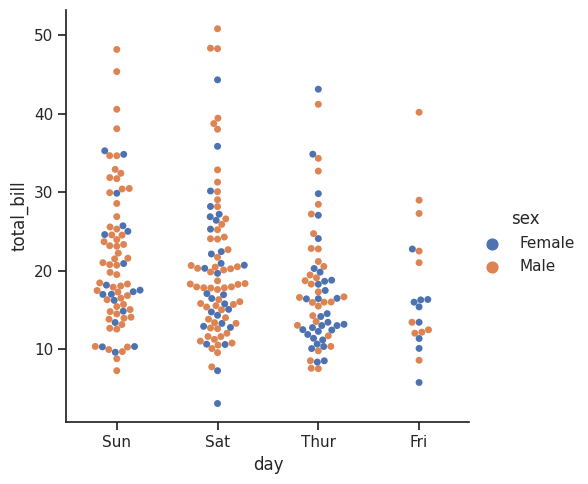

In [ ]:
sns.catplot(x="day", y="total_bill", hue="sex", kind="swarm", data=tips);

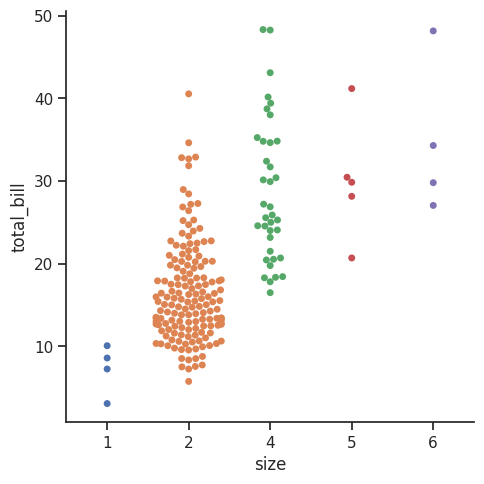

In [ ]:
sns.catplot(x="size", y="total_bill", kind="swarm",
            data=tips.query("size != 3"));

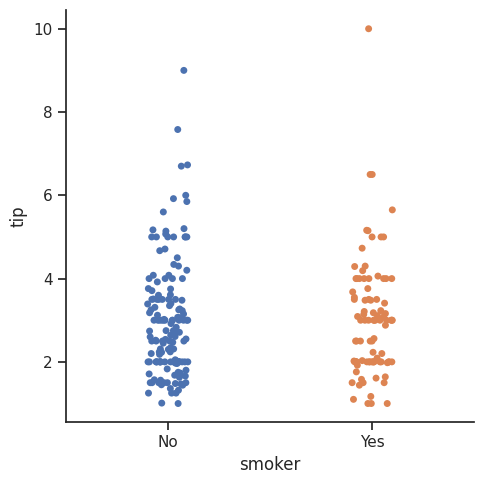

In [ ]:
sns.catplot(x="smoker", y="tip", order=["No", "Yes"], data=tips);

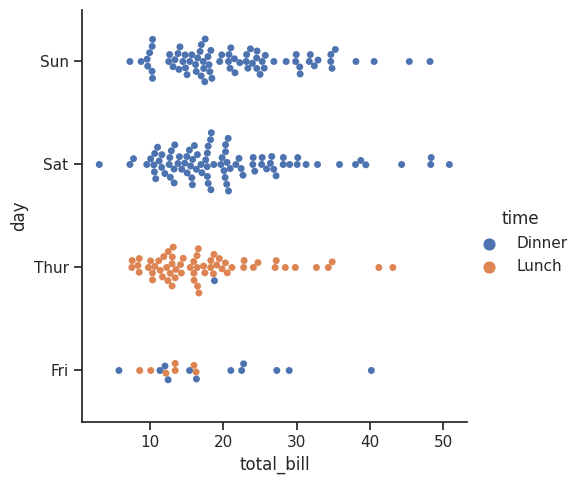

In [ ]:
sns.catplot(x="total_bill", y="day", hue="time", kind="swarm", data=tips);

## Distribuições de observações dentro das categorias

Conforme o tamanho do conjunto de dados aumenta, os gráficos de dispersão categóricos tornam-se limitados nas informações que podem fornecer sobre a distribuição de valores dentro de cada categoria. Quando isso acontece, existem várias abordagens para resumir as informações de distribuição de forma a facilitar comparações fáceis entre os níveis de categoria.

### Boxplots

Este tipo de gráfico mostra os três valores dos quartil da distribuição junto com os valores extremos. Os “bigodes” se estendem para pontos que ficam dentro de 1,5 IQRs do quartil inferior e superior e, em seguida, as observações que ficam fora dessa faixa são exibidas de forma independente. Isso significa que cada valor no boxplot corresponde a uma observação real nos dados.

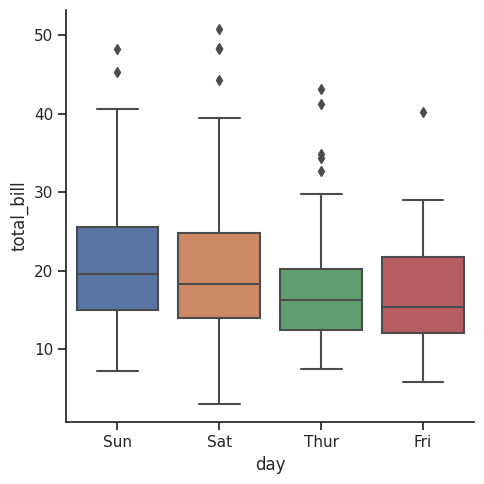

In [ ]:
sns.catplot(x="day", y="total_bill", kind="box", data=tips);

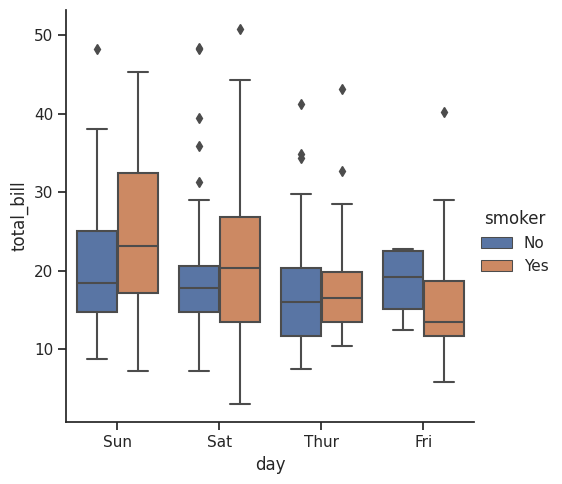

In [ ]:
sns.catplot(x="day", y="total_bill", hue="smoker", kind="box", data=tips);

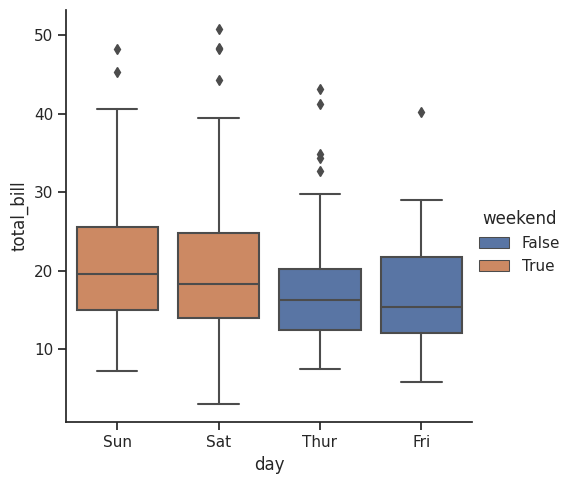

In [ ]:
tips["weekend"] = tips["day"].isin(["Sat", "Sun"])
sns.catplot(x="day", y="total_bill", hue="weekend",
            kind="box", dodge=False, data=tips);

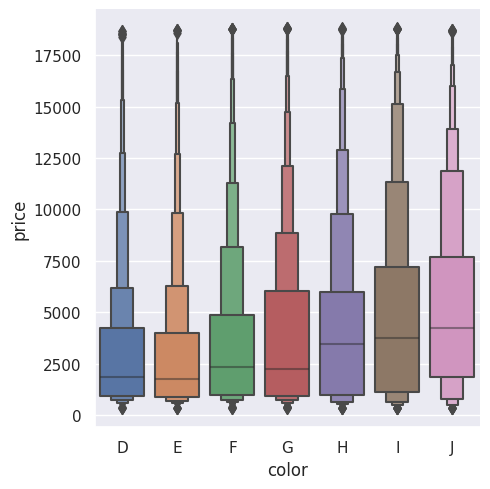

In [ ]:
diamonds = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/diamonds.csv')
sns.catplot(x="color", y="price", kind="boxen",
            data=diamonds.sort_values("color"));

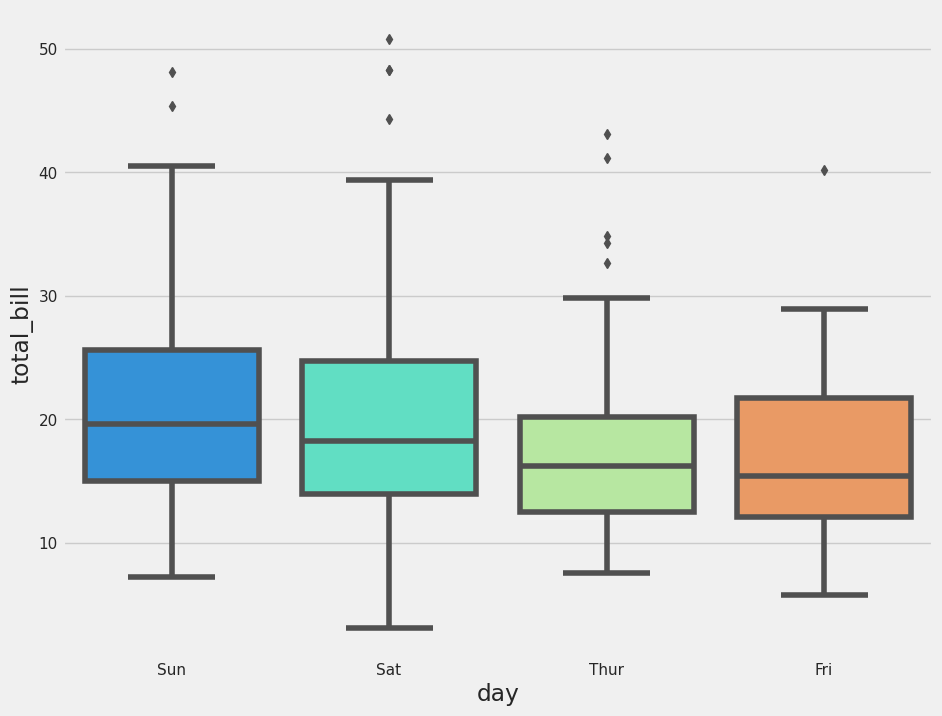

In [ ]:
plt.figure(figsize=(10,8))
sns.boxplot(x="day", y="total_bill", data=tips, palette='rainbow',linewidth=2.5)

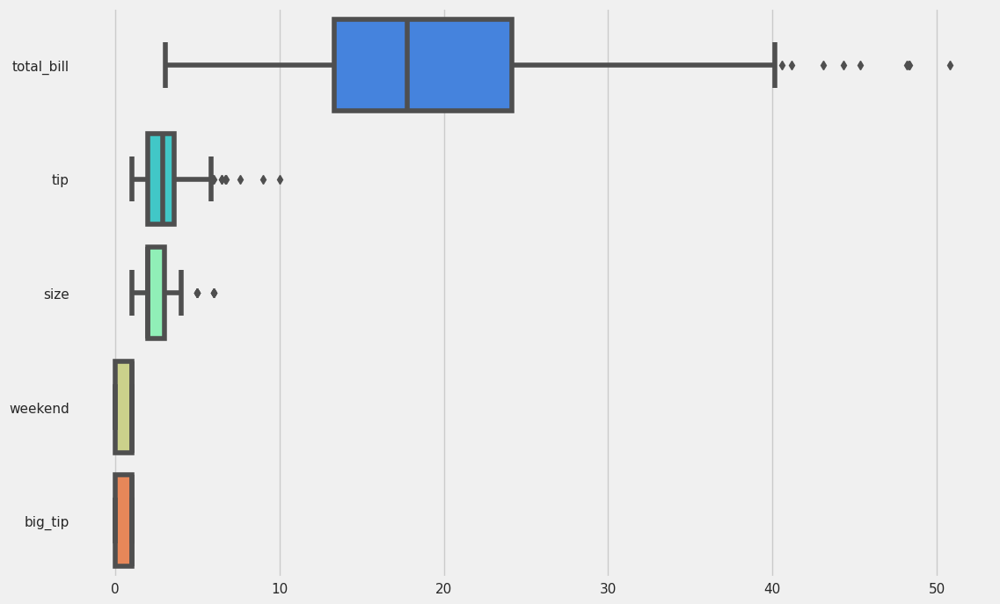

In [ ]:
# Can do entire dataframe with orient='h'
plt.figure(figsize=(12,8))
sns.boxplot(data=tips,palette='rainbow',orient='h');

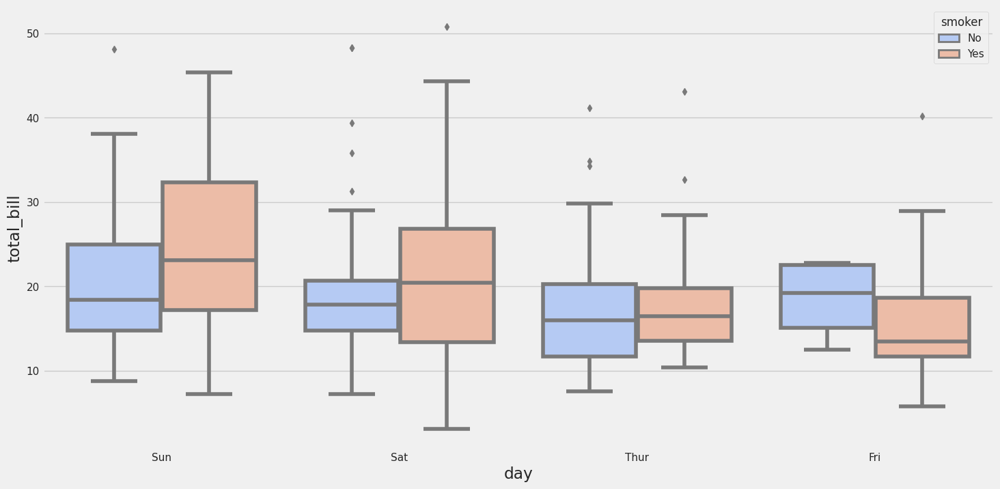

In [ ]:
plt.figure(figsize=(16,8))
sns.boxplot(x="day", y="total_bill", hue="smoker",data=tips, palette="coolwarm")

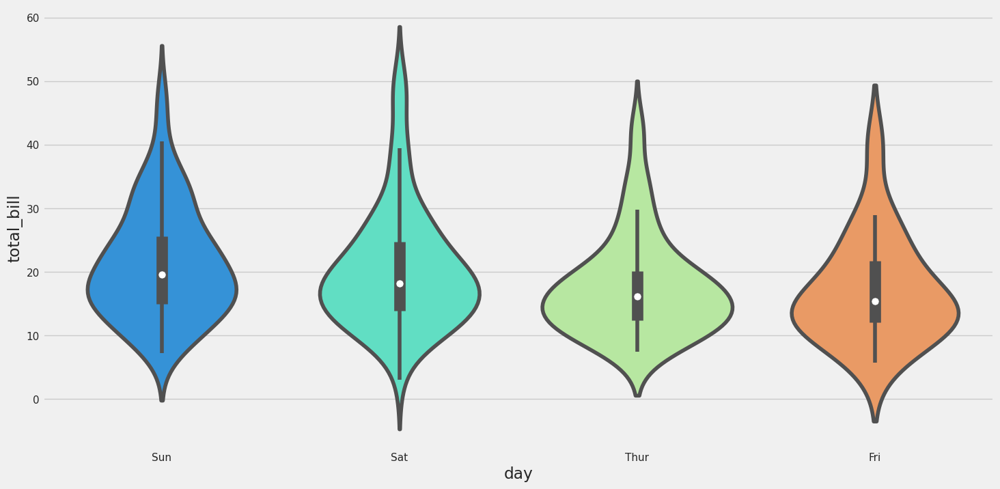

In [ ]:
plt.figure(figsize=(16,8))
sns.violinplot(x="day", y="total_bill", data=tips,palette='rainbow')


### Violinplots

Uma abordagem diferente é um violinplot (), que combina um boxplot com o procedimento de estimativa de densidade

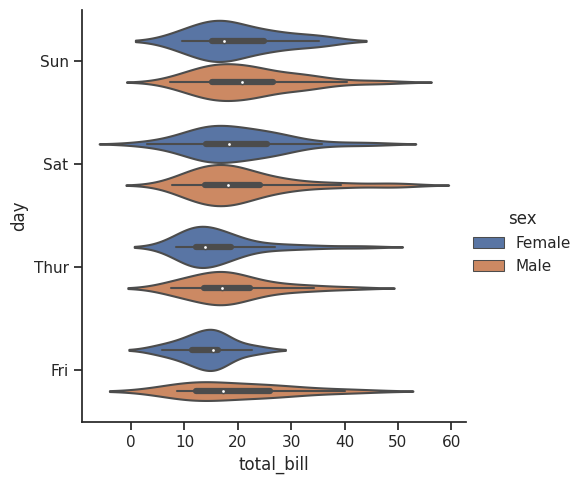

In [ ]:
sns.catplot(x="total_bill", y="day", hue="sex",
            kind="violin", data=tips);

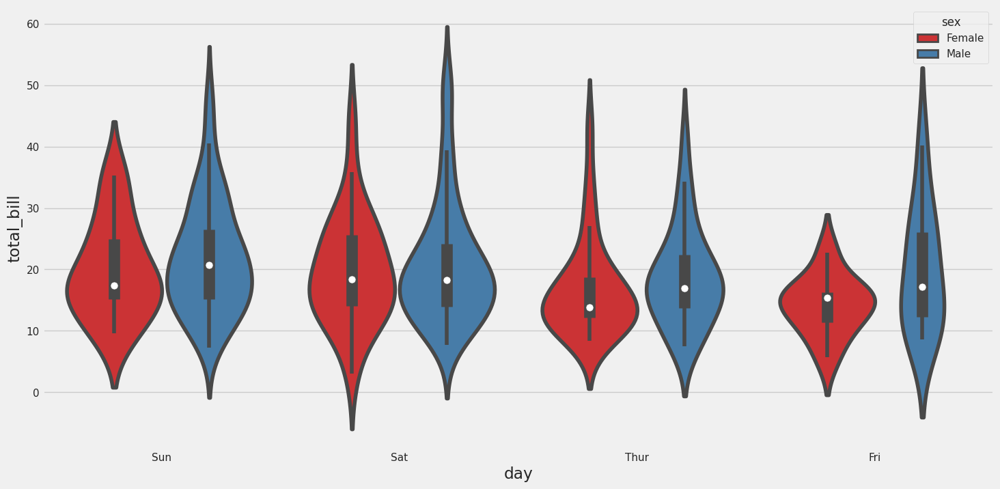

In [ ]:
plt.figure(figsize=(16,8))
sns.violinplot(x="day", y="total_bill", data=tips,hue='sex',palette='Set1')

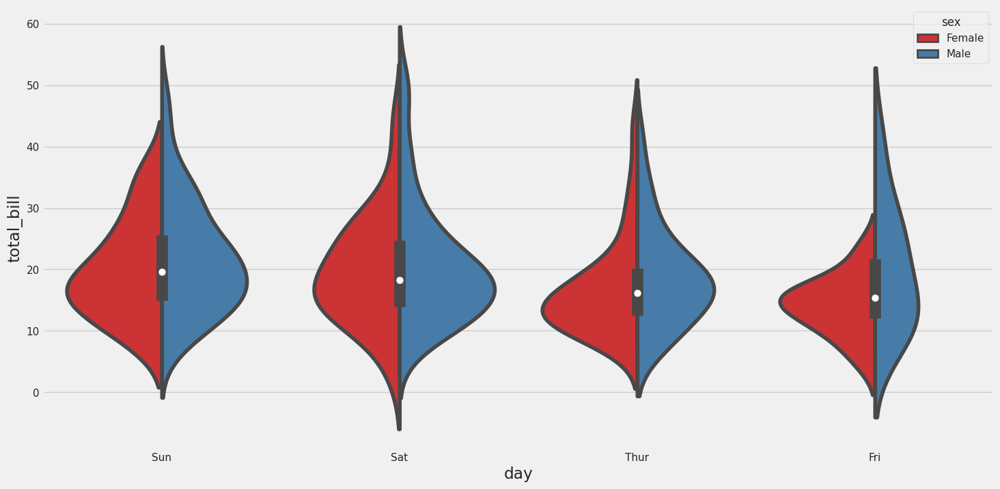

In [ ]:
plt.figure(figsize=(16,8))
sns.violinplot(x="day", y="total_bill", data=tips,hue='sex',split=True,palette='Set1')

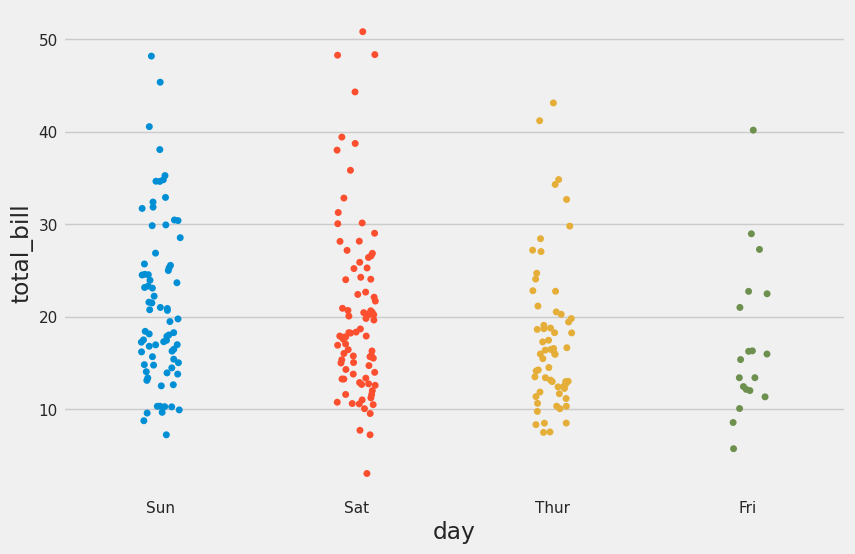

In [ ]:
plt.figure(figsize=(9,6))
sns.stripplot(x="day", y="total_bill", data=tips)

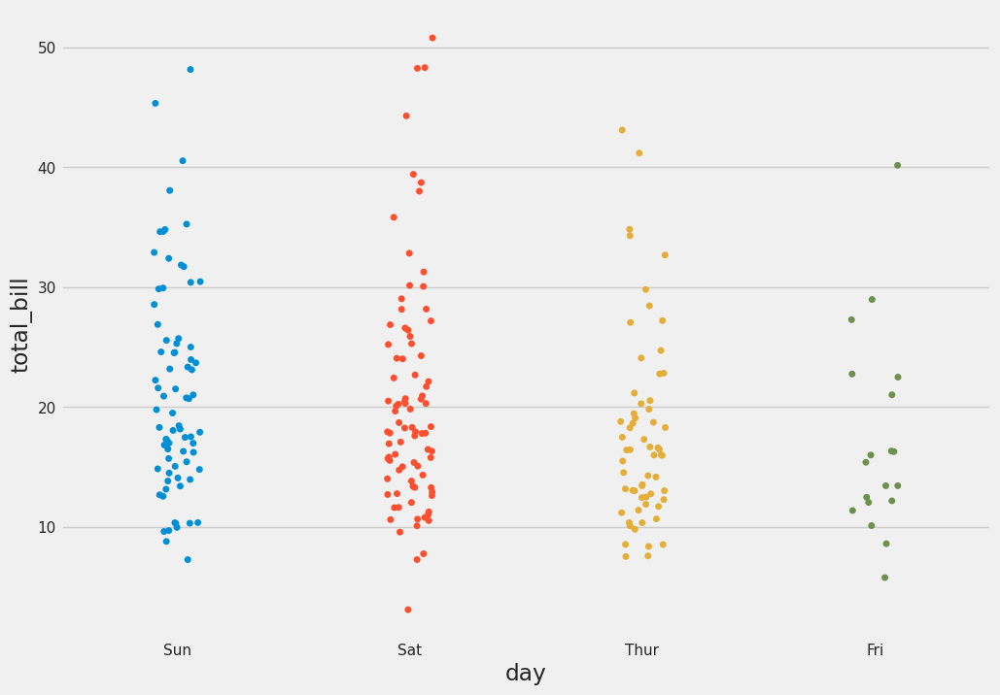

In [ ]:
plt.figure(figsize=(11,8))
sns.stripplot(x="day", y="total_bill", data=tips,jitter=True)

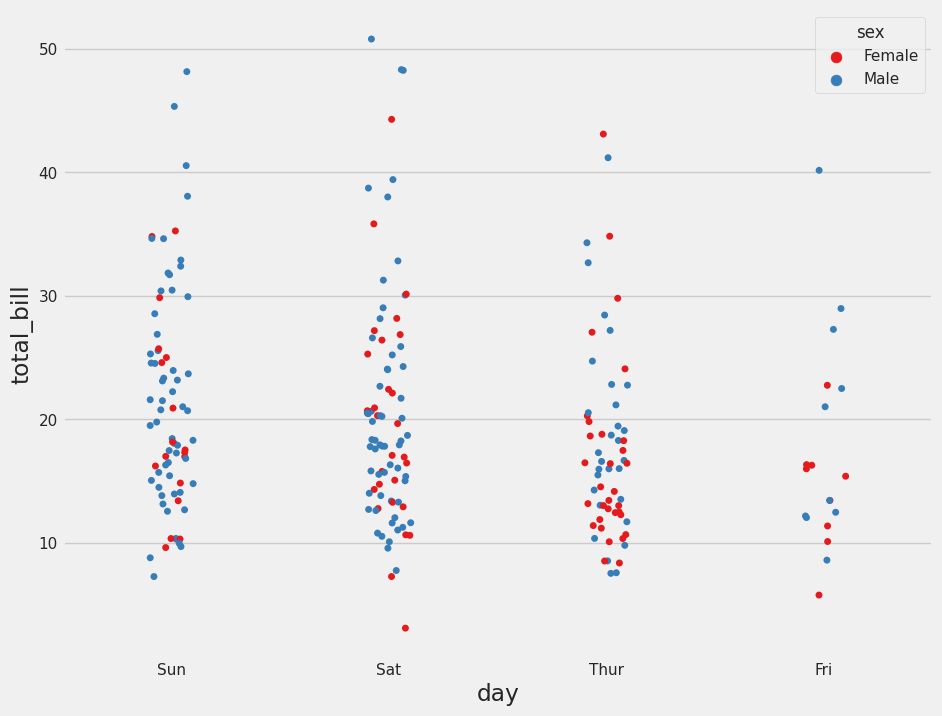

In [ ]:
plt.figure(figsize=(10,8))
sns.stripplot(x="day", y="total_bill", data=tips,jitter=True,hue='sex',palette='Set1')

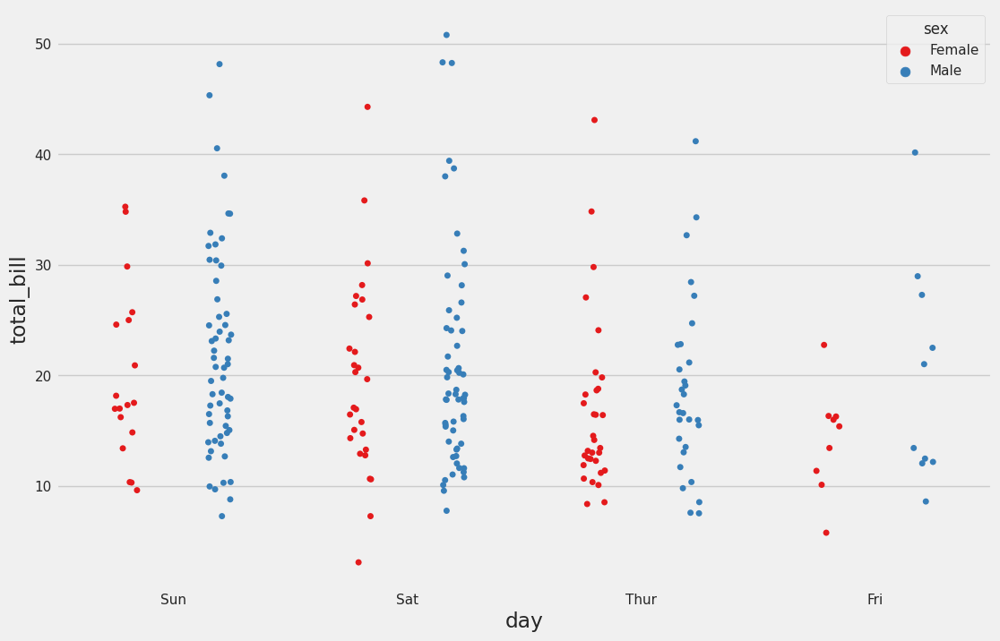

In [ ]:
plt.figure(figsize=(12,8))
sns.stripplot(x="day", y="total_bill", data=tips,jitter=True,hue='sex',palette='Set1',split=True)

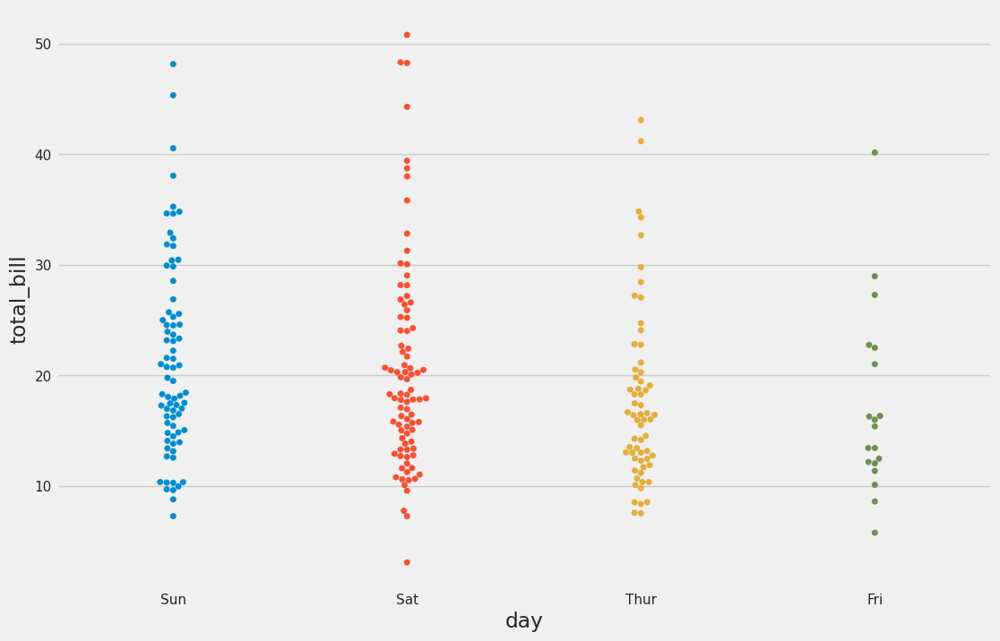

In [ ]:
plt.figure(figsize=(12,8))
sns.swarmplot(x="day", y="total_bill", data=tips)

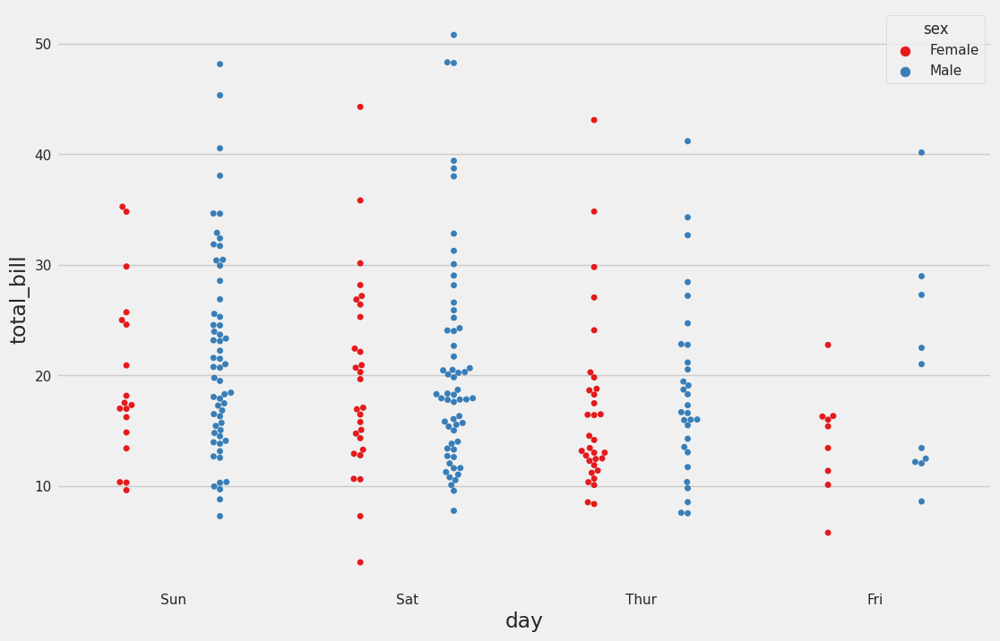

In [ ]:
plt.figure(figsize=(12,8))
sns.swarmplot(x="day", y="total_bill",hue='sex',data=tips, palette="Set1", split=True)

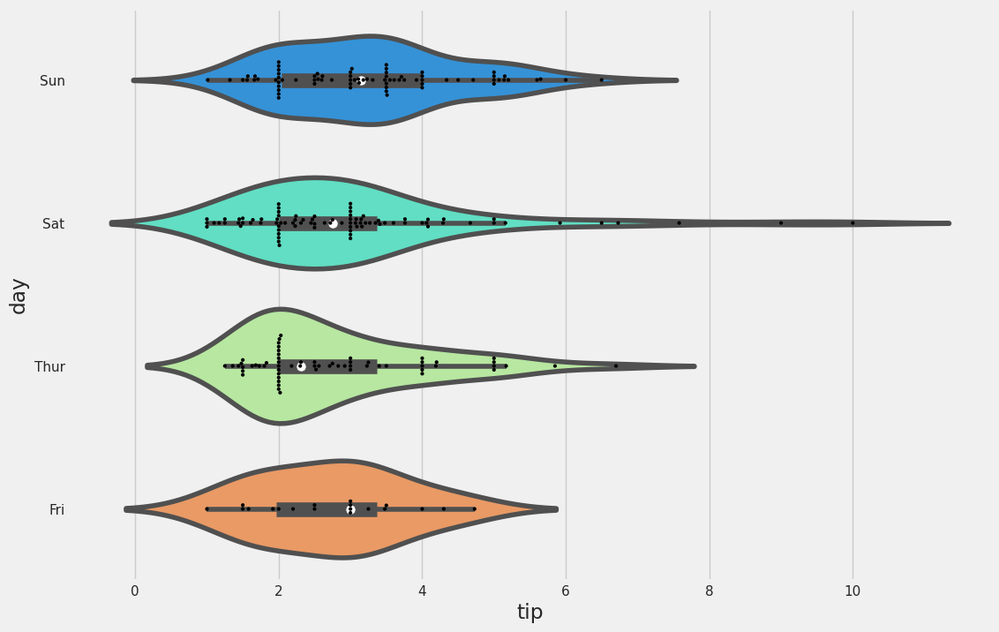

In [ ]:
plt.figure(figsize=(12,8))
sns.violinplot(x="tip", y="day", data=tips,palette='rainbow')
sns.swarmplot(x="tip", y="day", data=tips,color='black',size=3)

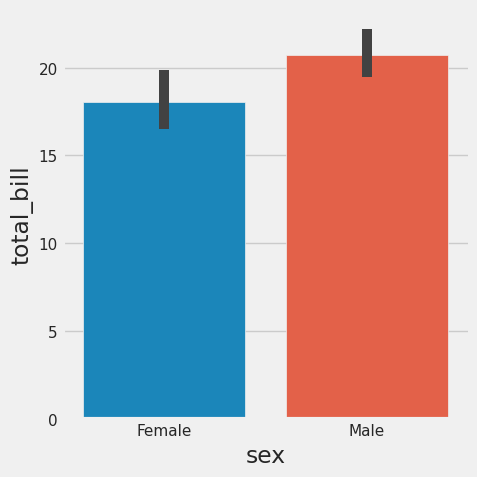

In [ ]:
sns.factorplot(x='sex',y='total_bill',data=tips,kind='bar')

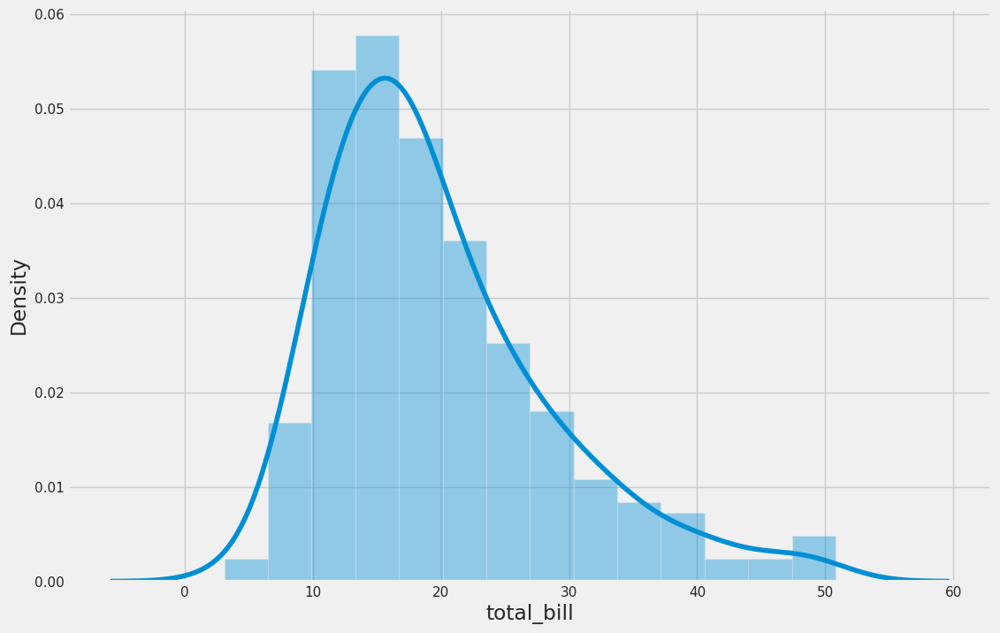

In [ ]:
plt.figure(figsize=(12,8))
sns.distplot(tips['total_bill'])
# Safe to ignore warnings

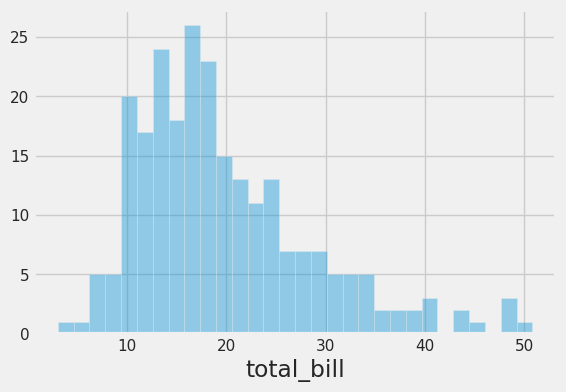

In [ ]:
sns.distplot(tips['total_bill'],kde=False,bins=30)

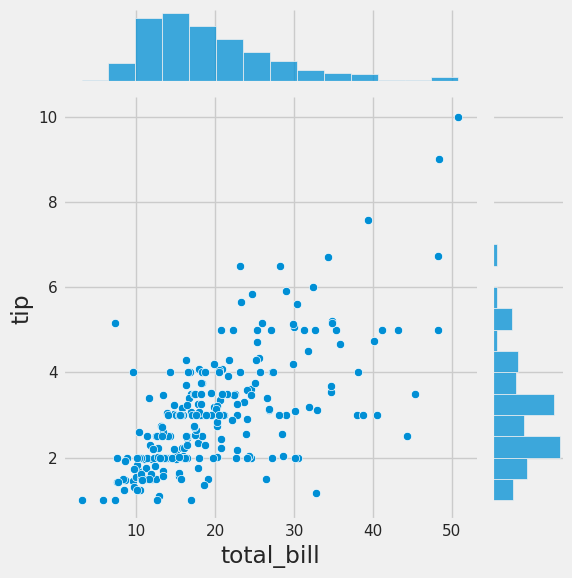

In [ ]:
sns.jointplot(x='total_bill',y='tip',data=tips,kind='scatter')

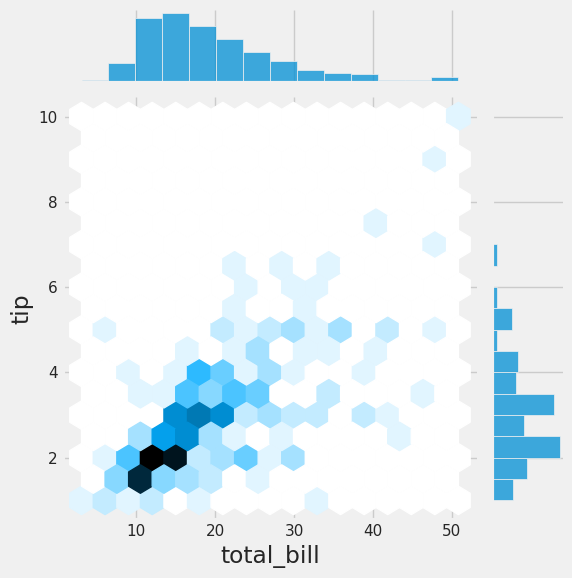

In [ ]:
sns.jointplot(x='total_bill',y='tip',data=tips,kind='hex')

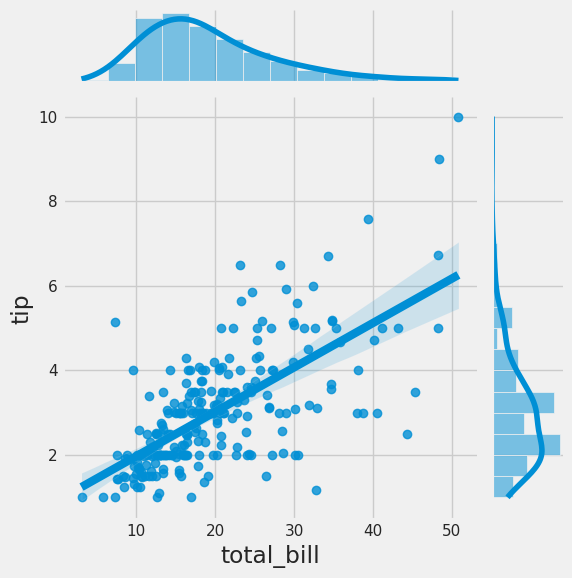

In [ ]:
sns.jointplot(x='total_bill',y='tip',data=tips,kind='reg')

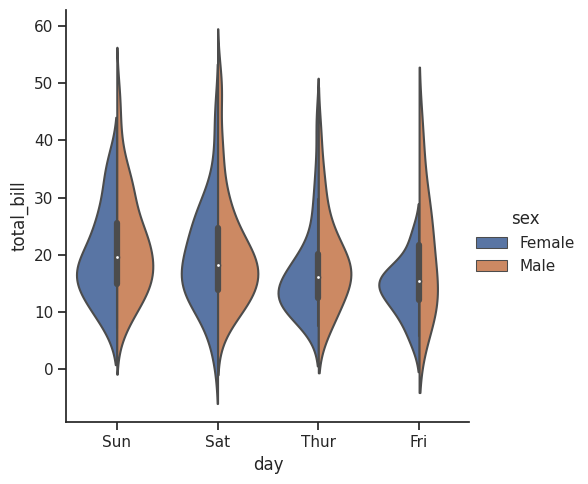

In [ ]:
sns.catplot(x="day", y="total_bill", hue="sex",
            kind="violin", split=True, data=tips);

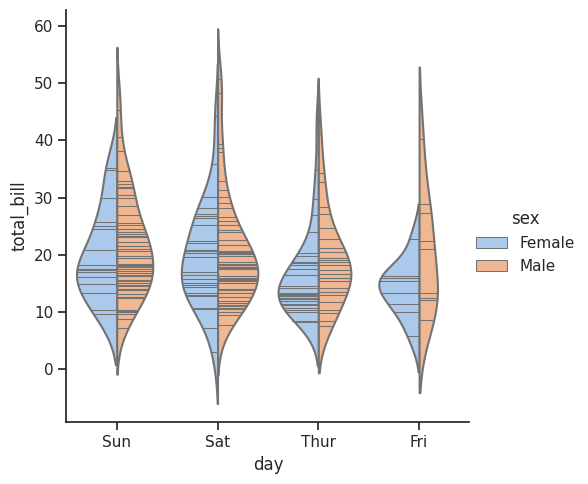

In [ ]:
sns.catplot(x="day", y="total_bill", hue="sex",
            kind="violin", inner="stick", split=True,
            palette="pastel", data=tips);

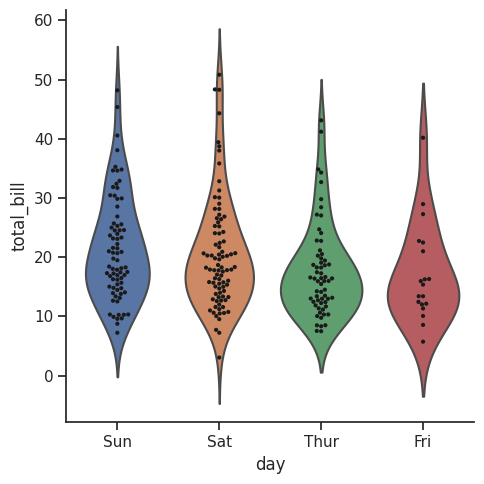

In [ ]:
g = sns.catplot(x="day", y="total_bill", kind="violin", inner=None, data=tips)
sns.swarmplot(x="day", y="total_bill", color="k", size=3, data=tips, ax=g.ax);

## Estimativa estatística dentro das categorias

Para outros aplicativos, em vez de mostrar a distribuição dentro de cada categoria, você pode querer mostrar uma estimativa da tendência central dos valores.

### Bar plots

Um estilo familiar de trama que atinge esse objetivo é uma trama de barras. No mar, a função barplot () opera em um conjunto de dados completo e aplica uma função para obter a estimativa (tomando a média por padrão). Quando há várias observações em cada categoria, ele também usa bootstrapping para calcular um intervalo de confiança em torno da estimativa, que é plotado usando barras de erro:

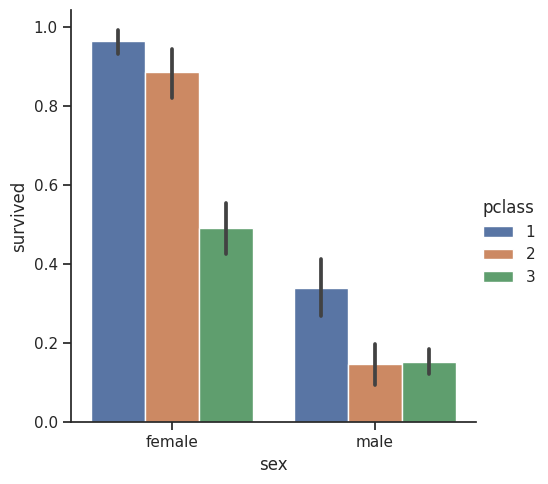

In [ ]:
titanic = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/titanic.csv')
sns.catplot(x="sex", y="survived", hue="pclass", kind="bar", data=titanic);

In [ ]:
titanic.head()

,pclass,survived,name,sex,age,sibsp,parch,ticket,fare,cabin,embarked,boat,body,home.dest
0,1,1,"Allen, Miss. Elisabeth Walton",female,29.00,0,0,24160,211.3375,B5,S,2,NaN,"St Louis, MO"
1,1,1,"Allison, Master. Hudson Trevor",male,0.92,1,2,113781,151.5500,C22 C26,S,11,NaN,"Montreal, PQ / Chesterville, ON"
2,1,0,"Allison, Miss. Helen Loraine",female,2.00,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
3,1,0,"Allison, Mr. Hudson Joshua Creighton",male,30.00,1,2,113781,151.5500,C22 C26,S,NaN,135.0,"Montreal, PQ / Chesterville, ON"
4,1,0,"Allison, Mrs. Hudson J C (Bessie Waldo Daniels)",female,25.00,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"


Gráficos de pontos
Um estilo alternativo para visualizar as mesmas informações é oferecido pela função pointplot (). Esta função também codifica o valor da estimativa com altura no outro eixo, mas em vez de mostrar uma barra inteira, ela plota a estimativa de ponto e o intervalo de confiança. Além disso, pointplot () conecta pontos da mesma categoria de matiz. Isso torna mais fácil ver como a relação principal está mudando em função da semântica do matiz, porque seus olhos são muito bons em captar as diferenças de inclinações:

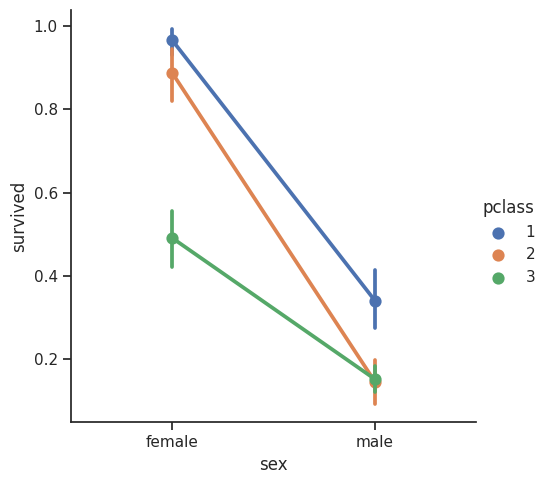

In [ ]:
sns.catplot(x="sex", y="survived", hue="pclass", kind="point", data=titanic);

> Embora as funções categóricas não tenham o estilo semântico das funções relacionais, ainda pode ser uma boa ideia variar o marcador e / ou estilo de linha junto com o matiz para fazer figuras que são acessíveis ao máximo e se reproduzem bem em preto e branco:

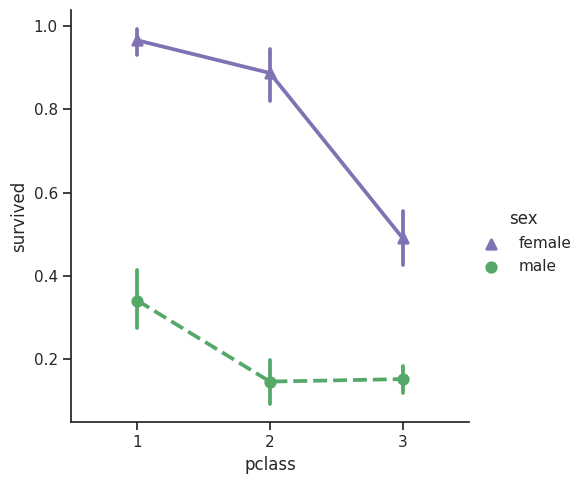

In [ ]:
sns.catplot(x="pclass", y="survived", hue="sex",
            palette={"male": "g", "female": "m"},
            markers=["^", "o"], linestyles=["-", "--"],
            kind="point", data=titanic);

## Traçando dados de “formato amplo”

Embora seja preferível usar dados de “formato longo” ou “organizados”, essas funções também podem ser aplicadas a dados de “formato amplo” em uma variedade de formatos, incluindo DataFrames pandas ou matrizes numpy bidimensionais. Esses objetos devem ser passados ​​diretamente para o parâmetro de dados:

In [ ]:
iris = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/Iris.csv')
iris.head(20)

,Id,SepalLengthCm,SepalWidthCm,PetalLengthCm,PetalWidthCm,Species
0,1,5.1,3.5,1.4,0.2,Iris-setosa
1,2,4.9,3.0,1.4,0.2,Iris-setosa
2,3,4.7,3.2,1.3,0.2,Iris-setosa
3,4,4.6,3.1,1.5,0.2,Iris-setosa
4,5,5.0,3.6,1.4,0.2,Iris-setosa
5,6,5.4,3.9,1.7,0.4,Iris-setosa
6,7,4.6,3.4,1.4,0.3,Iris-setosa
7,8,5.0,3.4,1.5,0.2,Iris-setosa
8,9,4.4,2.9,1.4,0.2,Iris-setosa
9,10,4.9,3.1,1.5,0.1,Iris-setosa


In [ ]:
sns.catplot(data=iris, orient="h", kind="box");

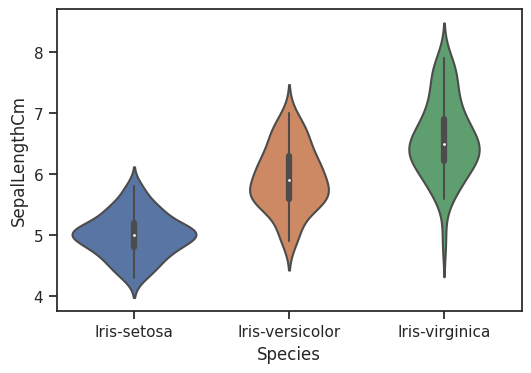

In [ ]:
sns.violinplot(x=iris.Species, y=iris.SepalLengthCm);

### Mostrando vários relacionamentos com facetas

Assim como relplot (), o fato de catplot () ser construído em um FacetGrid significa que é fácil adicionar variáveis ​​facetadas para visualizar relacionamentos de dimensões superiores:

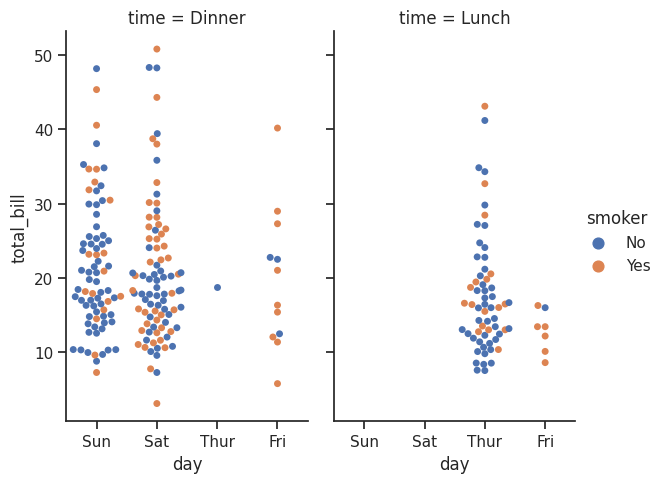

In [ ]:
sns.catplot(x="day", y="total_bill", hue="smoker",
            col="time", aspect=.6,
            kind="swarm", data=tips);

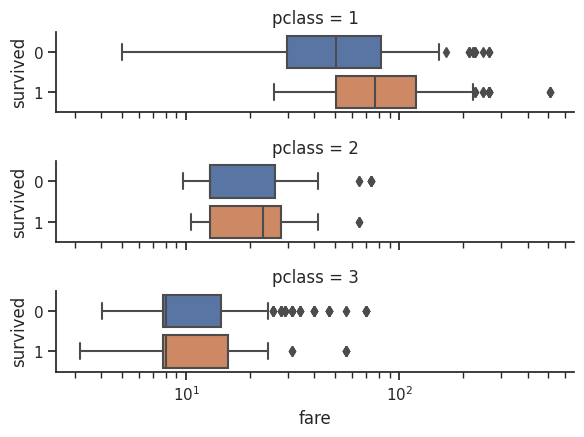

In [ ]:
g = sns.catplot(x="fare", y="survived", row="pclass",
                kind="box", orient="h", height=1.5, aspect=4,
                data=titanic.query("fare > 0"))
g.set(xscale="log");

In [ ]:
iris.columns

Index(['Id', 'SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm',
       'Species'],
      dtype='object')

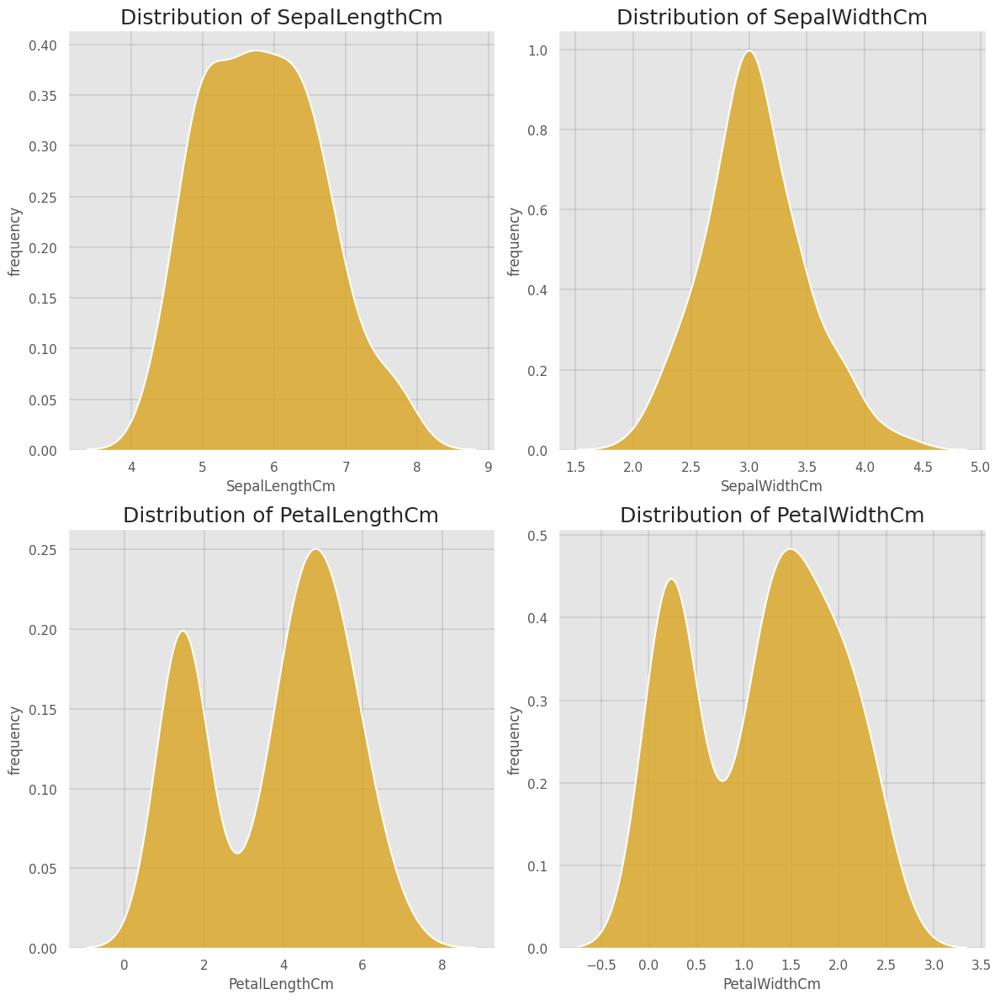

In [ ]:
f,ax=plt.subplots(2,2,figsize=(12,12))
#f.delaxes(ax[2,1])

for i,feature in enumerate(['SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm']):
    sns.distplot(iris[feature], ax=ax[i//2,i%2], kde_kws={"color":"white"}, hist=False )

    # Get the two lines from the ax[i//2,i%2]es to generate shading
    l1 = ax[i//2,i%2].lines[0]

    # Get the xy data from the lines so that we can shade
    x1 = l1.get_xydata()[:,0]
    y1 = l1.get_xydata()[:,1]
    ax[i//2,i%2].fill_between(x1,y1, color="goldenrod", alpha=0.8)

    #grid
    ax[i//2,i%2].grid(b=True, which='major', color='grey', linewidth=0.3)
    
    ax[i//2,i%2].set_title('Distribution of {}'.format(feature), fontsize=18)
    ax[i//2,i%2].set_ylabel('count', fontsize=12)
    ax[i//2,i%2].set_xlabel('Modality', fontsize=12)

    ax[i//2,i%2].set_ylabel("frequency", fontsize=12)
    ax[i//2,i%2].set_xlabel(str(feature), fontsize=12)
    
plt.tight_layout()
plt.show()

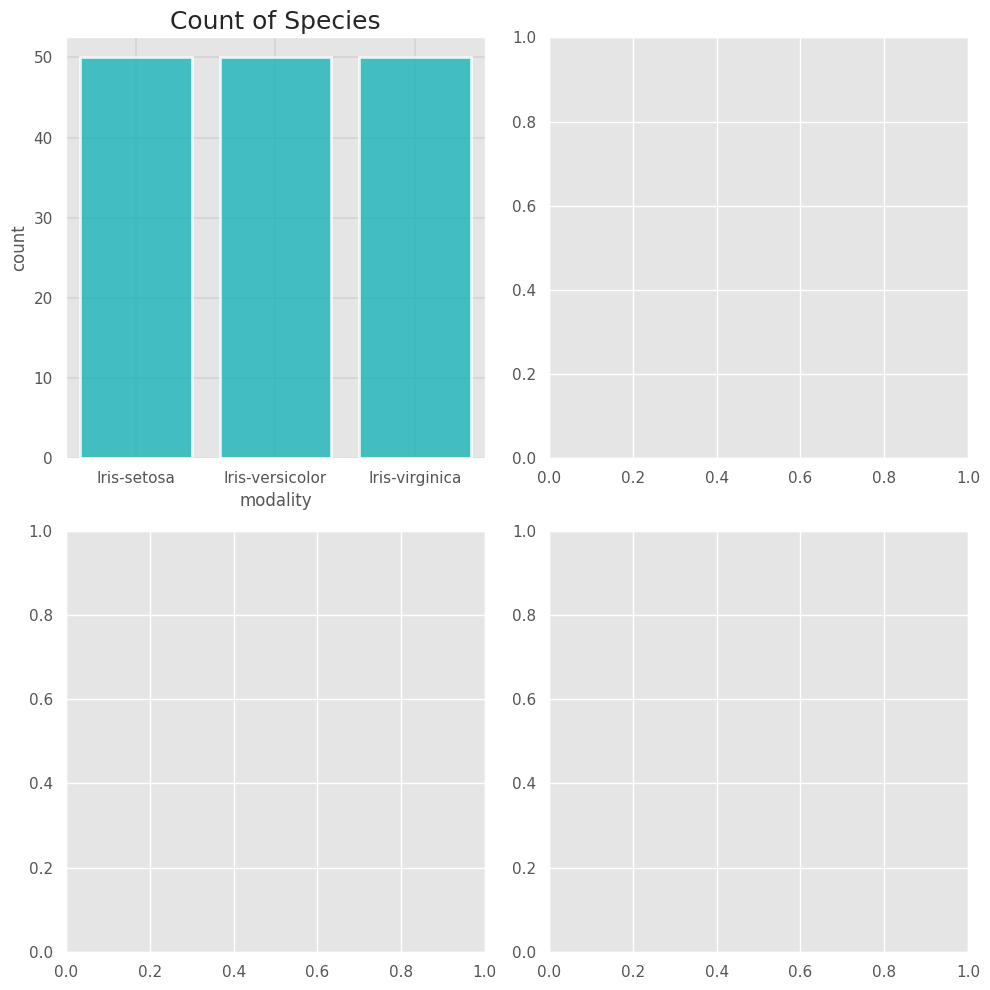

In [ ]:
f,ax=plt.subplots(2,2,figsize=(10,10))

for i,feature in enumerate(['Species']):
    colors = ['darkturquoise']
    sns.countplot(x=feature,data=iris,ax=ax[i//2,i%2], palette = colors, alpha=0.8, edgecolor=('white'), linewidth=2)
    ax[i//2,i%2].grid(b=True, which='major', color='grey', linewidth=0.2)
    ax[i//2,i%2].set_title('Count of {}'.format(feature), fontsize=18)
    ax[i//2,i%2].set_ylabel('count', fontsize=12)
    ax[i//2,i%2].set_xlabel('modality', fontsize=12)

plt.tight_layout()
plt.show()


# Distribution Visuals

Ao lidar com um conjunto de dados, muitas vezes a primeira coisa que você deseja fazer é ter uma noção de como as variáveis ​​são distribuídas.

In [ ]:
from scipy import stats
sns.set(color_codes=True)


## Plotando Distribuições Univariadas

A maneira mais conveniente de dar uma olhada rápida em uma distribuição univariada no mar é a função distplot (). Por padrão, isso desenhará um histograma e ajustará uma estimativa de densidade do kernel (KDE).

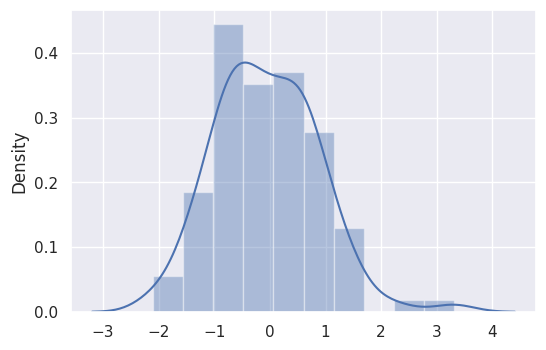

In [ ]:
x = np.random.normal(size=100)
sns.distplot(x);


## Histogramas

Os histogramas são provavelmente familiares e já existe uma função hist em matplotlib. Um histograma representa a distribuição de dados formando bins ao longo do intervalo dos dados e, em seguida, desenhando barras para mostrar o número de observações que caem em cada bin.

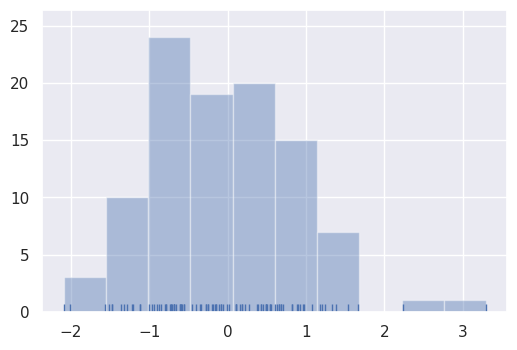

In [ ]:
sns.distplot(x, kde=False, rug=True);

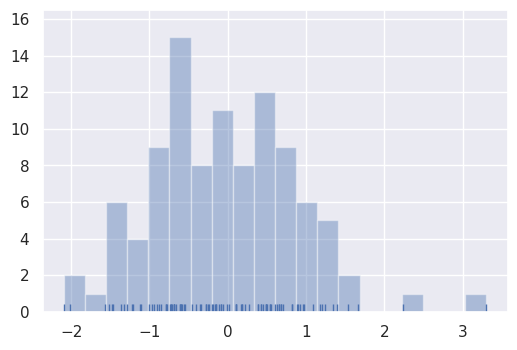

In [ ]:
sns.distplot(x, bins=20, kde=False, rug=True);

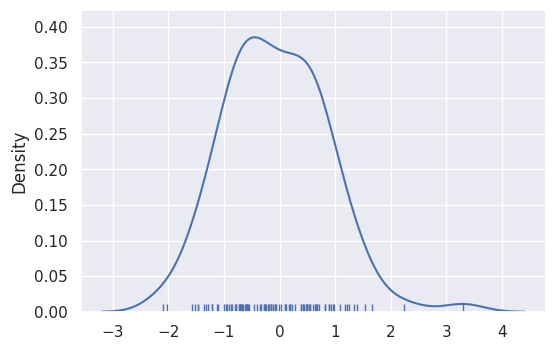

In [ ]:
sns.distplot(x, hist=False, rug=True);

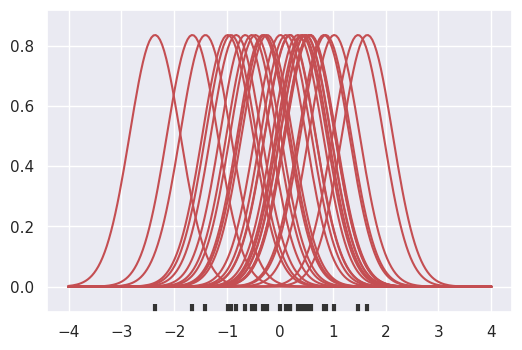

In [ ]:
x = np.random.normal(0, 1, size=30)
bandwidth = 1.06 * x.std() * x.size ** (-1 / 5.)
support = np.linspace(-4, 4, 200)

kernels = []
for x_i in x:

    kernel = stats.norm(x_i, bandwidth).pdf(support)
    kernels.append(kernel)
    plt.plot(support, kernel, color="r")

sns.rugplot(x, color=".2", linewidth=3);

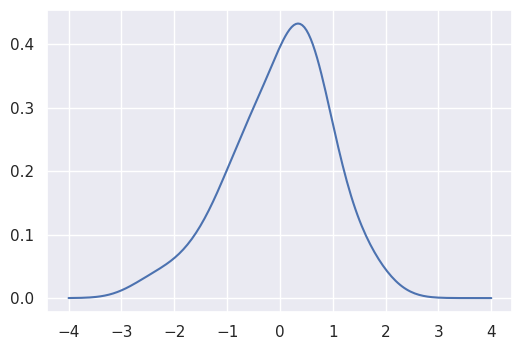

In [ ]:
from scipy.integrate import trapz
density = np.sum(kernels, axis=0)
density /= trapz(density, support)
plt.plot(support, density);

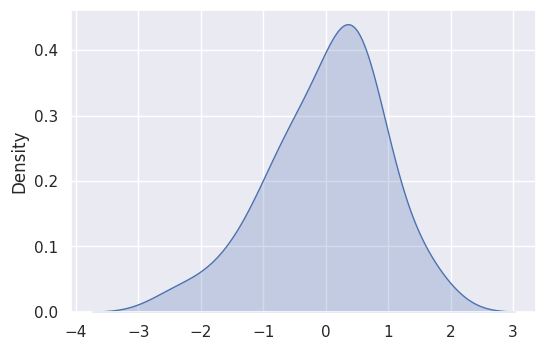

In [ ]:
sns.kdeplot(x, shade=True);

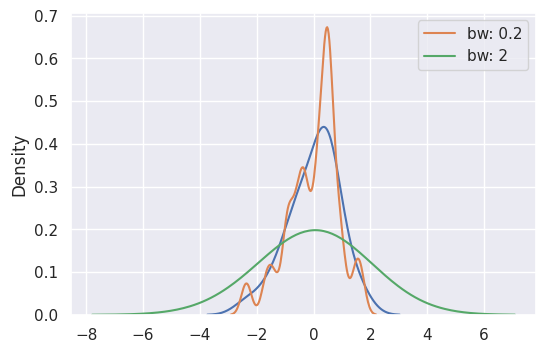

In [ ]:
sns.kdeplot(x)
sns.kdeplot(x, bw=.2, label="bw: 0.2")
sns.kdeplot(x, bw=2, label="bw: 2")
plt.legend();

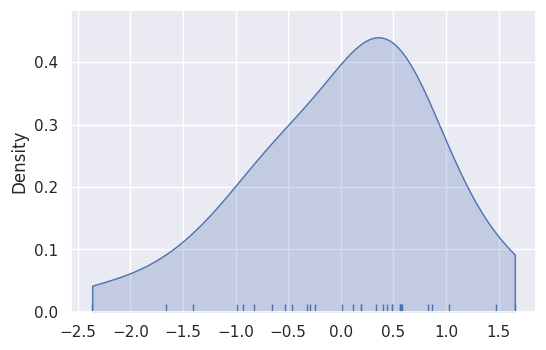

In [ ]:
sns.kdeplot(x, shade=True, cut=0)
sns.rugplot(x);

In [ ]:
plt.style.use("fivethirtyeight")

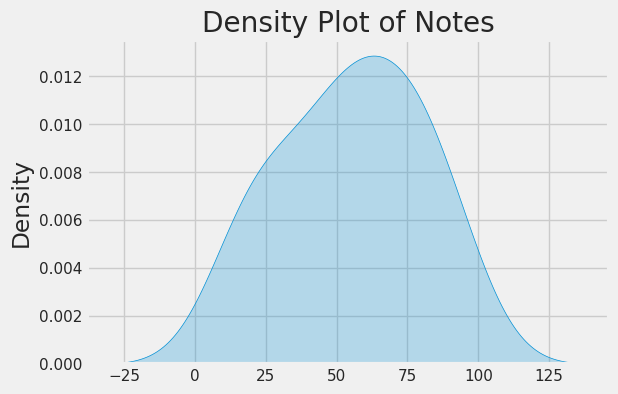

In [ ]:
notes = [30,74,94,14,55,47,63,28,88,44,53,18,66,74,81]
sns.kdeplot(data=notes, shade=True) # Setting shade=True colors the area below the curve

plt.title("Density Plot of Notes")

plt.show()

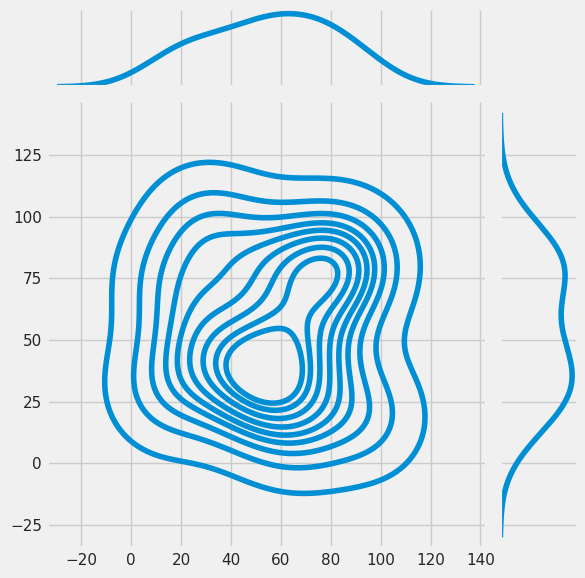

In [ ]:
first_exam_notes = [30,74,94,14,55,47,63,28,88,44,53,18,66,74,81]
final_exam_notes = [96,77,19,29,56,29,33,49,83,37,84,73,16,48,79]
sns.jointplot(x=first_exam_notes,y=final_exam_notes,kind="kde") # Setting shade=True colors the area below the curve

plt.show()

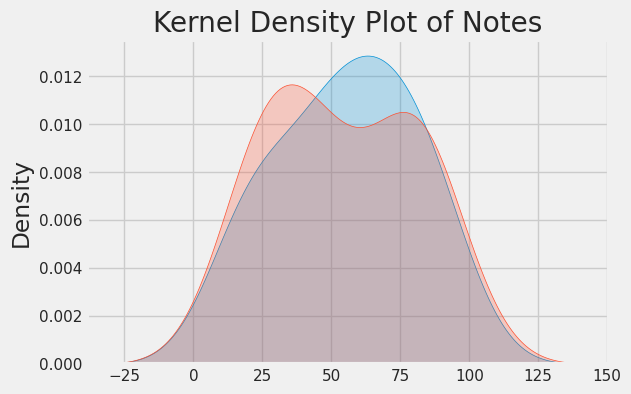

In [ ]:
sns.kdeplot(data=first_exam_notes,label="First Exam Notes", shade=True)
sns.kdeplot(data=final_exam_notes,label="Final Exam Notes", shade=True)

plt.title("Kernel Density Plot of Notes")

plt.show()

In [ ]:
mean, cov = [0, 1], [(1, .5), (.5, 1)]
data = np.random.multivariate_normal(mean, cov, 200)
df = pd.DataFrame(data, columns=["x", "y"])

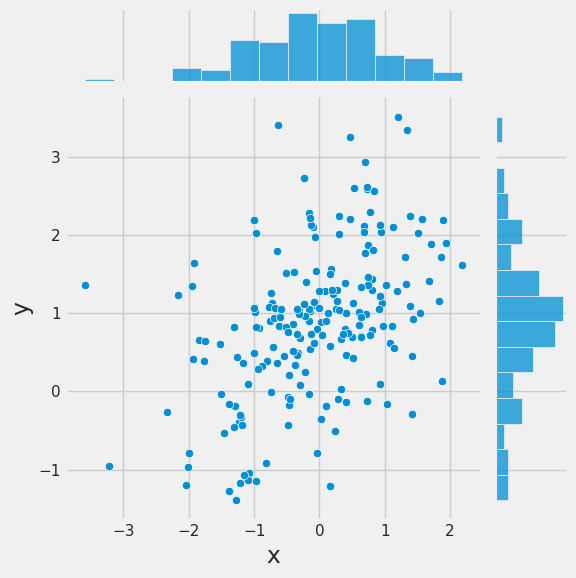

In [ ]:
sns.jointplot(x="x", y="y", data=df);

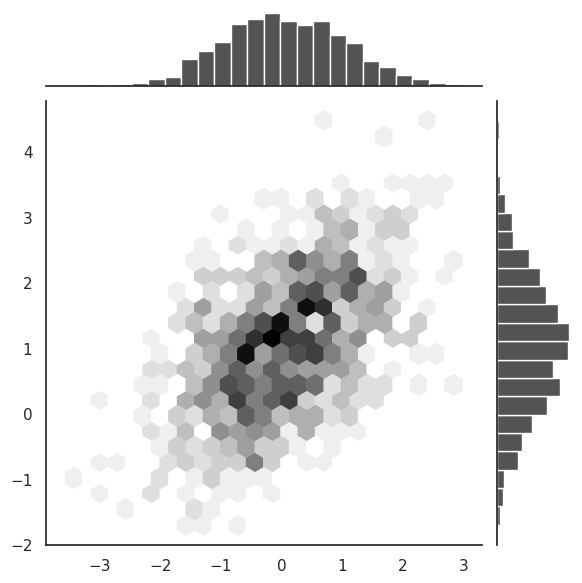

In [ ]:
x, y = np.random.multivariate_normal(mean, cov, 1000).T
with sns.axes_style("white"):
    sns.jointplot(x=x, y=y, kind="hex", color="k");

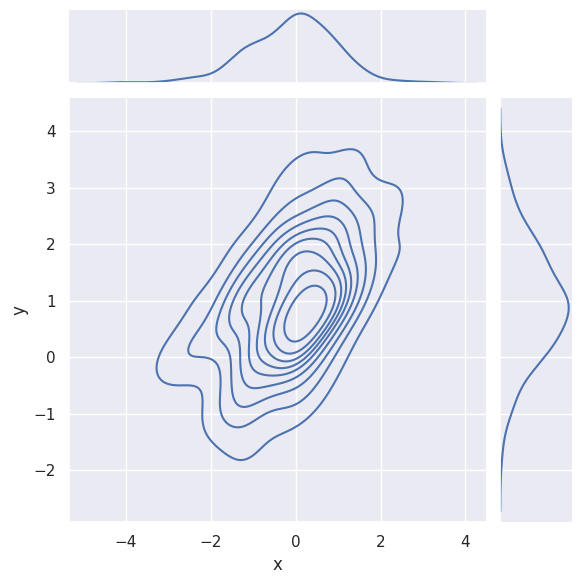

In [ ]:
sns.jointplot(x="x", y="y", data=df, kind="kde");

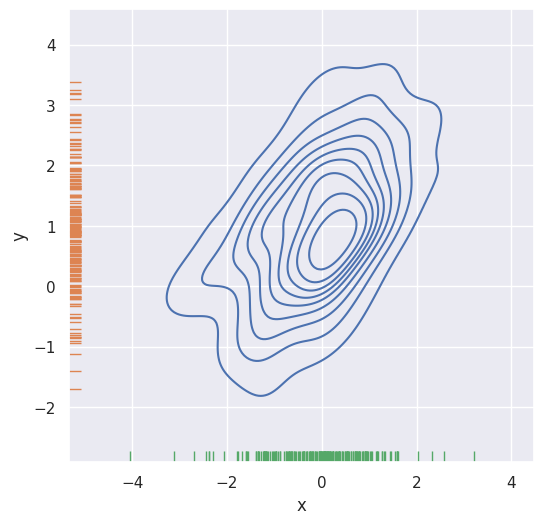

In [ ]:
f, ax = plt.subplots(figsize=(6, 6))
sns.kdeplot(df.x, df.y, ax=ax)
sns.rugplot(df.x, color="g", ax=ax)
sns.rugplot(df.y, vertical=True, ax=ax);

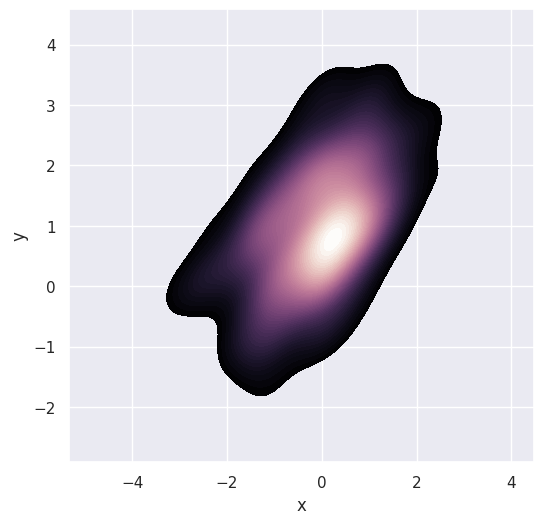

In [ ]:
f, ax = plt.subplots(figsize=(6, 6))
cmap = sns.cubehelix_palette(as_cmap=True, dark=0, light=1, reverse=True)
sns.kdeplot(df.x, df.y, cmap=cmap, n_levels=60, shade=True);

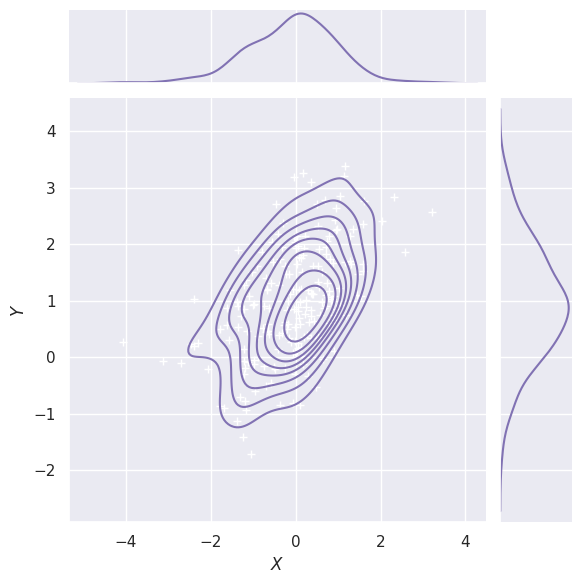

In [ ]:
g = sns.jointplot(x="x", y="y", data=df, kind="kde", color="m")
g.plot_joint(plt.scatter, c="w", s=30, linewidth=1, marker="+")
g.ax_joint.collections[0].set_alpha(0)
g.set_axis_labels("$X$", "$Y$");


## Relacionamentos de pares

Para plotar várias distribuições bivariadas de pares em um conjunto de dados, você pode usar a função pairplot (). Isso cria uma matriz de eixos e mostra a relação para cada par de colunas em um DataFrame. Por padrão, ele também desenha a distribuição univariada de cada variável nos eixos diagonais:

In [ ]:
iris = sns.load_dataset("iris")

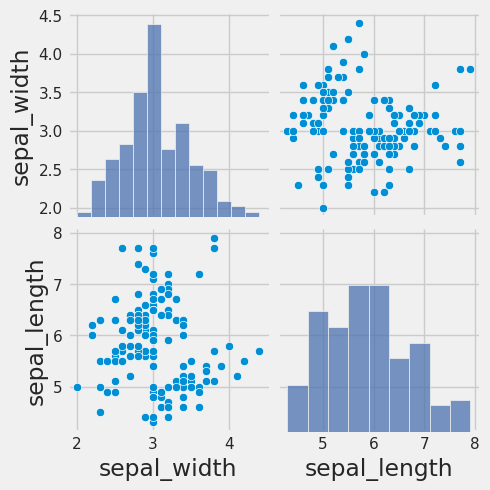

In [ ]:
sns.pairplot(data=iris, vars=["sepal_width", "sepal_length"])

plt.show()

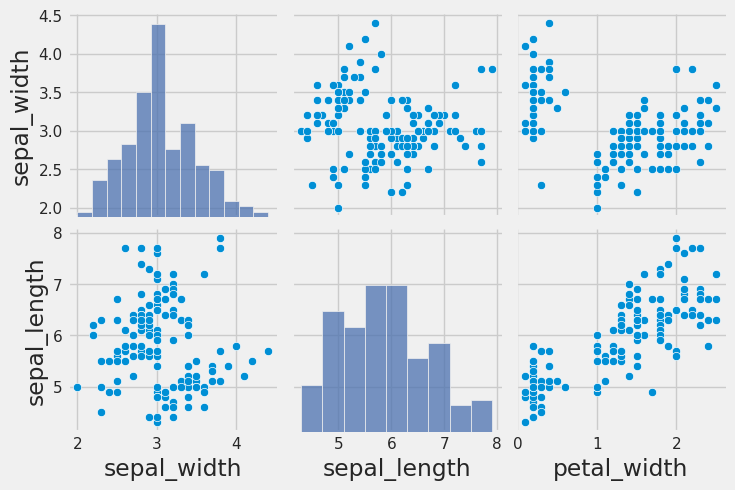

In [ ]:
sns.pairplot(data=iris, x_vars=["sepal_width", "sepal_length","petal_width"],
                        y_vars=["sepal_width", "sepal_length"])

plt.show()

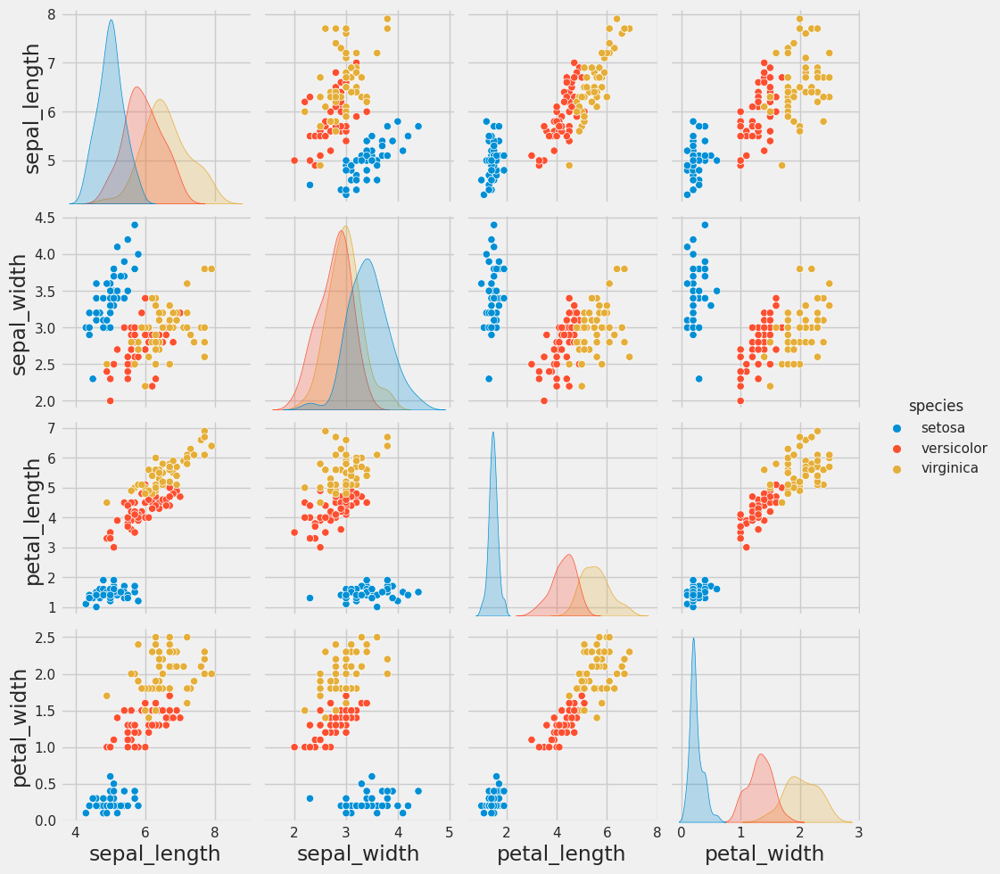

In [ ]:
sns.pairplot(iris,hue="species")

plt.show()

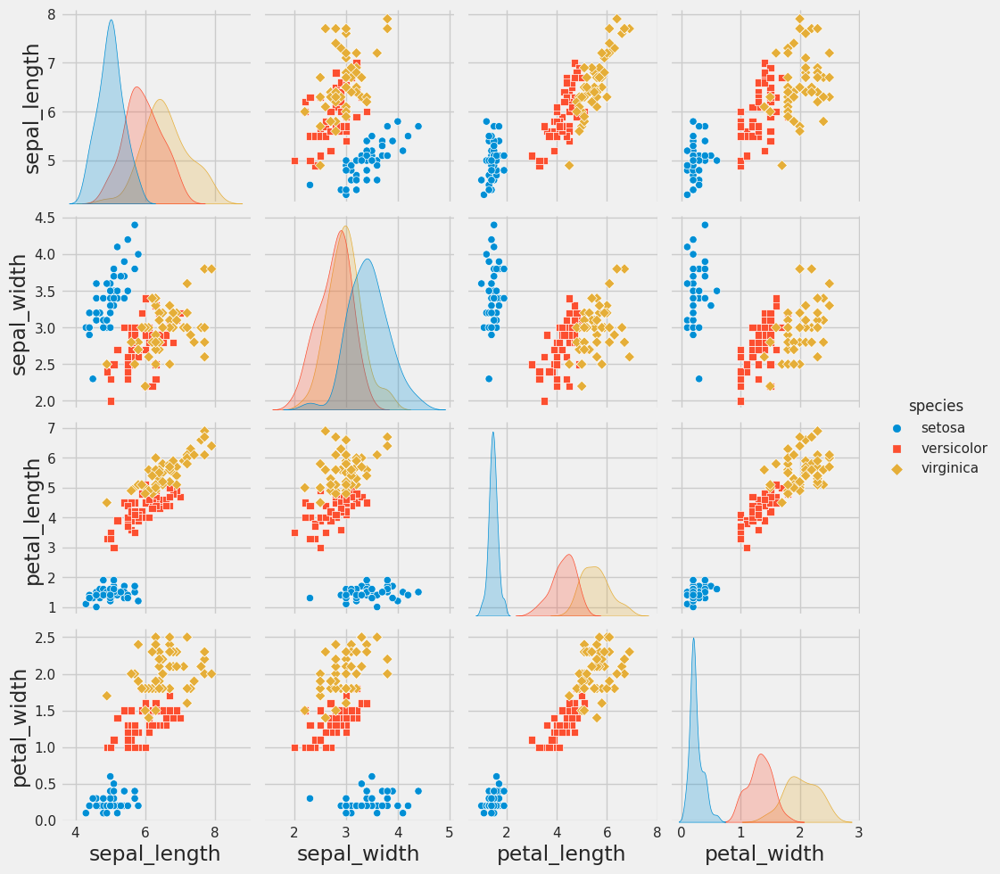

In [ ]:
sns.pairplot(iris,hue="species",markers=["o", "s", "D"])

plt.show()

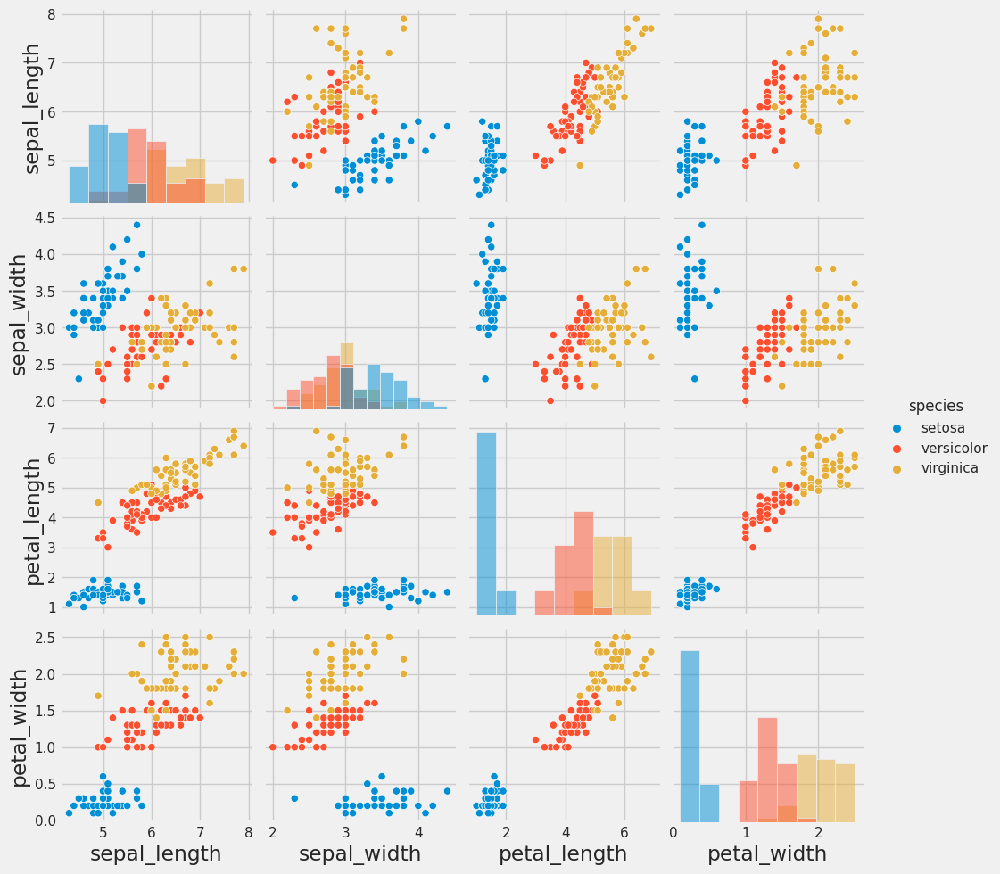

In [ ]:
sns.pairplot(iris,hue="species",diag_kind="hist")

plt.show()

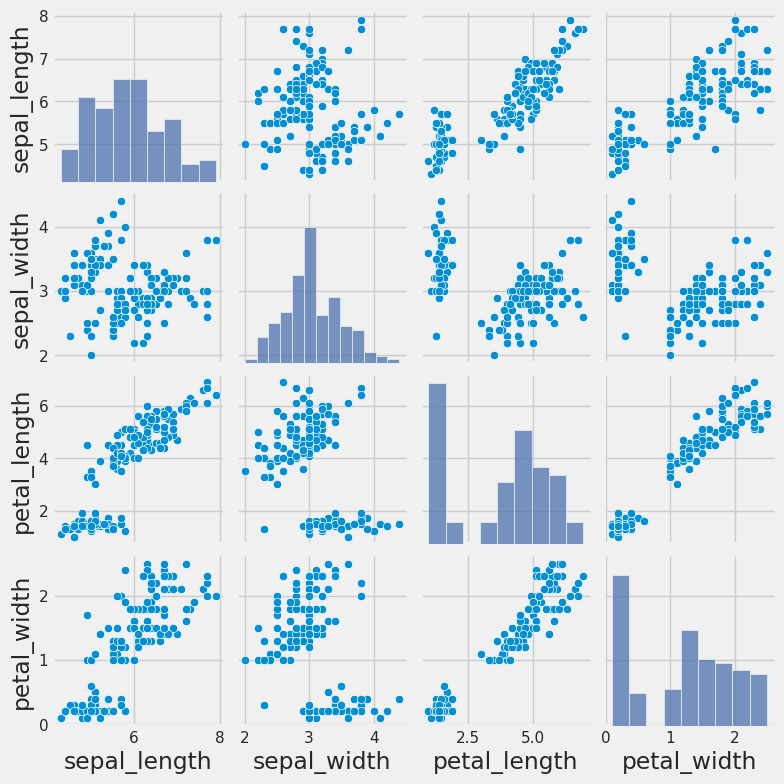

In [ ]:
sns.pairplot(iris,height=2)

plt.show()

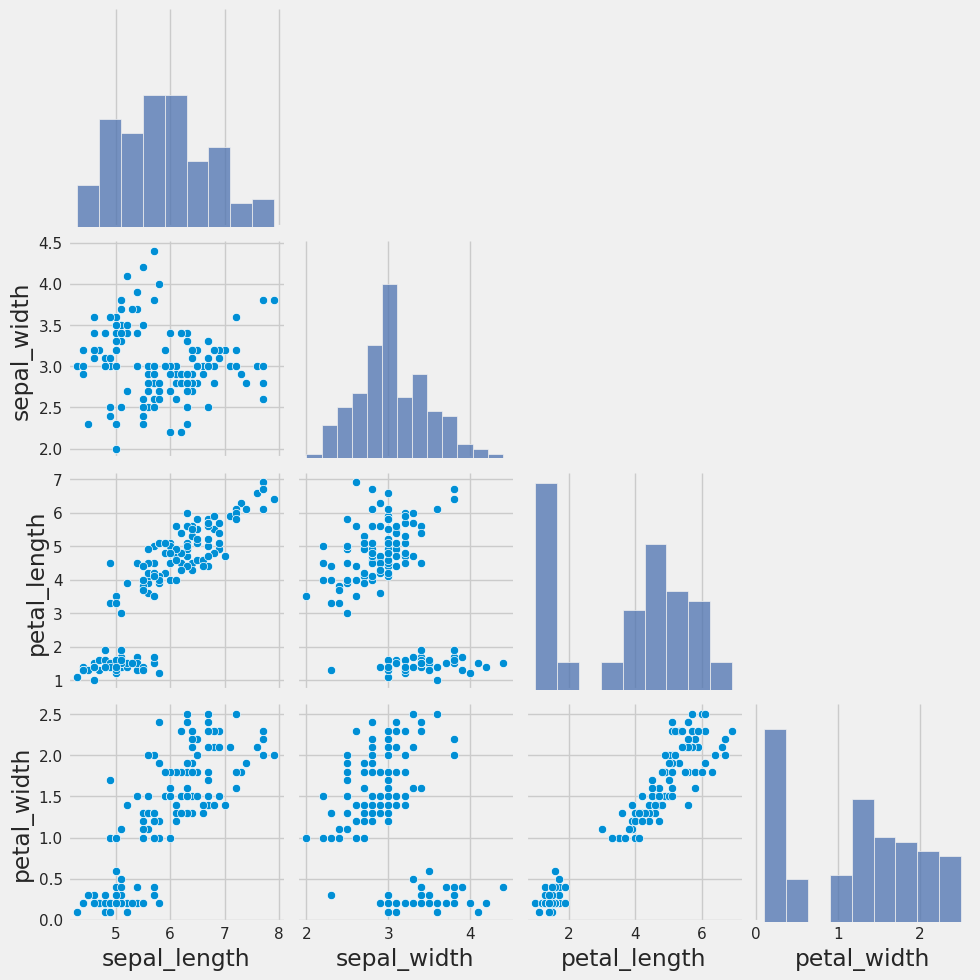

In [ ]:
sns.pairplot(iris,corner=True)

plt.show()

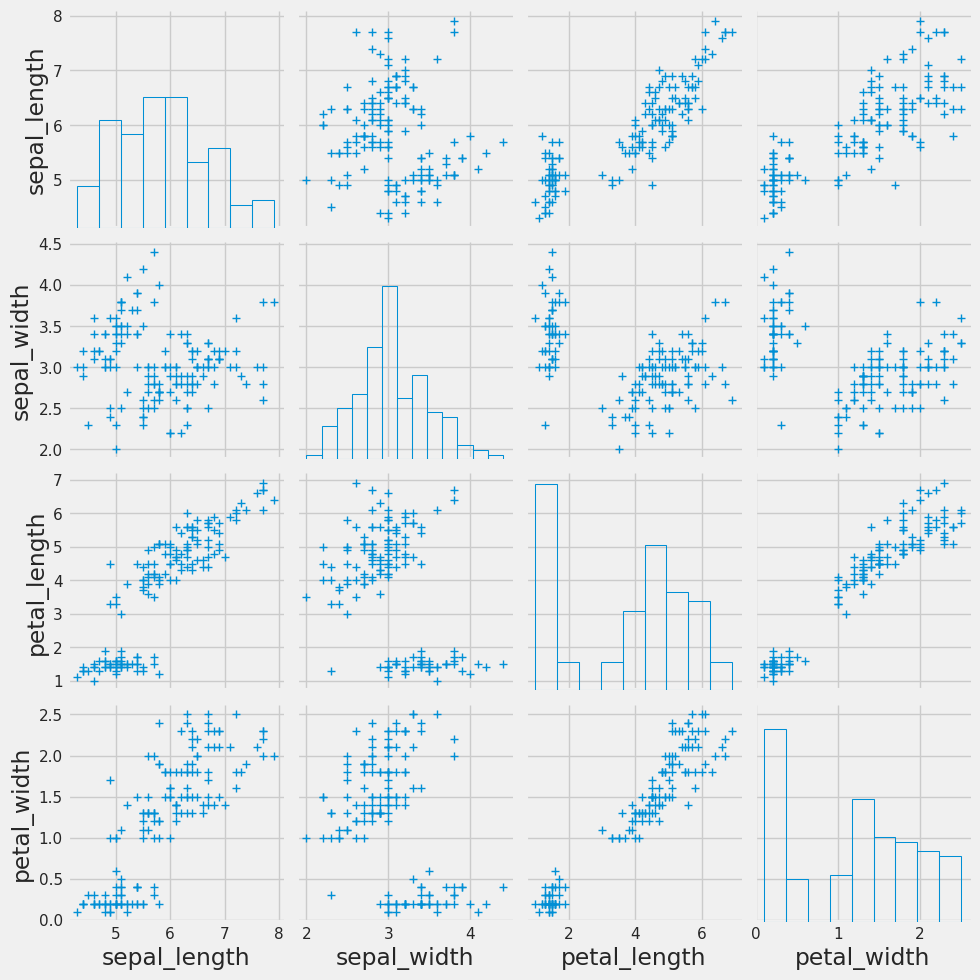

In [ ]:
sns.pairplot(data=iris,
            plot_kws={"marker":"+","linewidth":1},
            diag_kws={"fill":False})

plt.show()

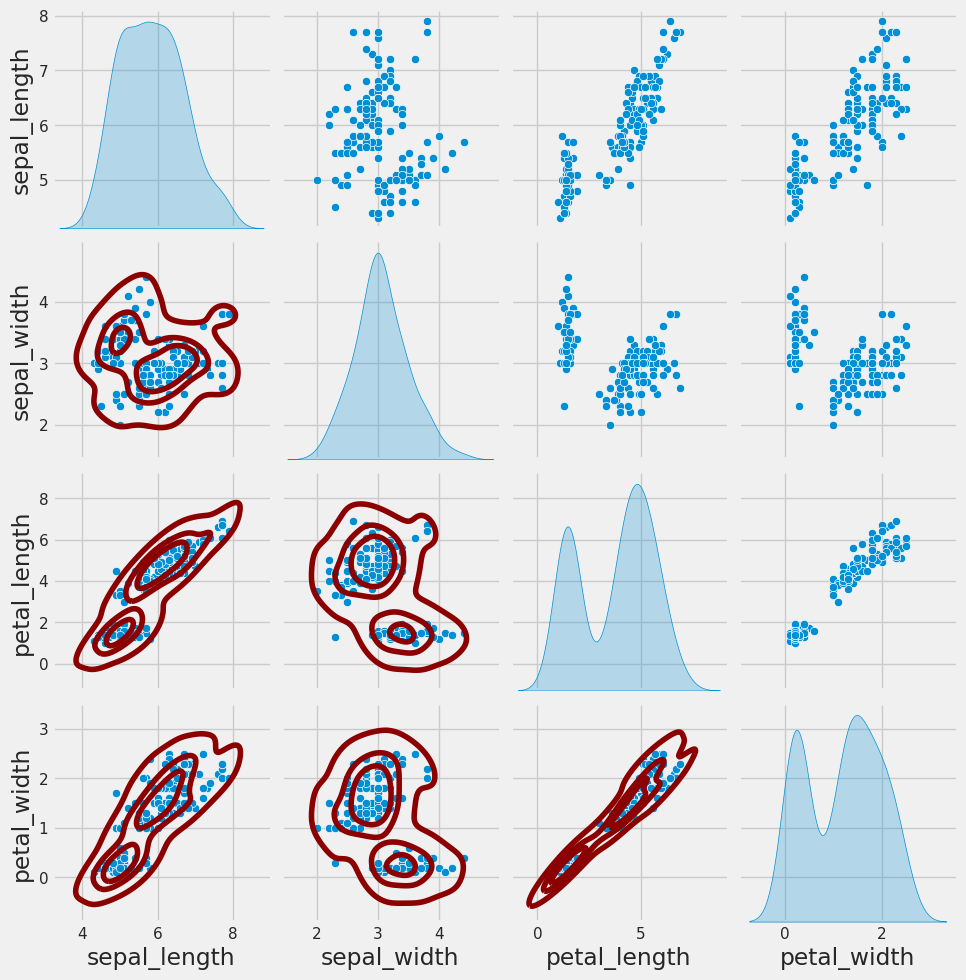

In [ ]:
ax=sns.pairplot(iris, diag_kind="kde")

ax.map_lower(sns.kdeplot, levels=4, color = "darkred")

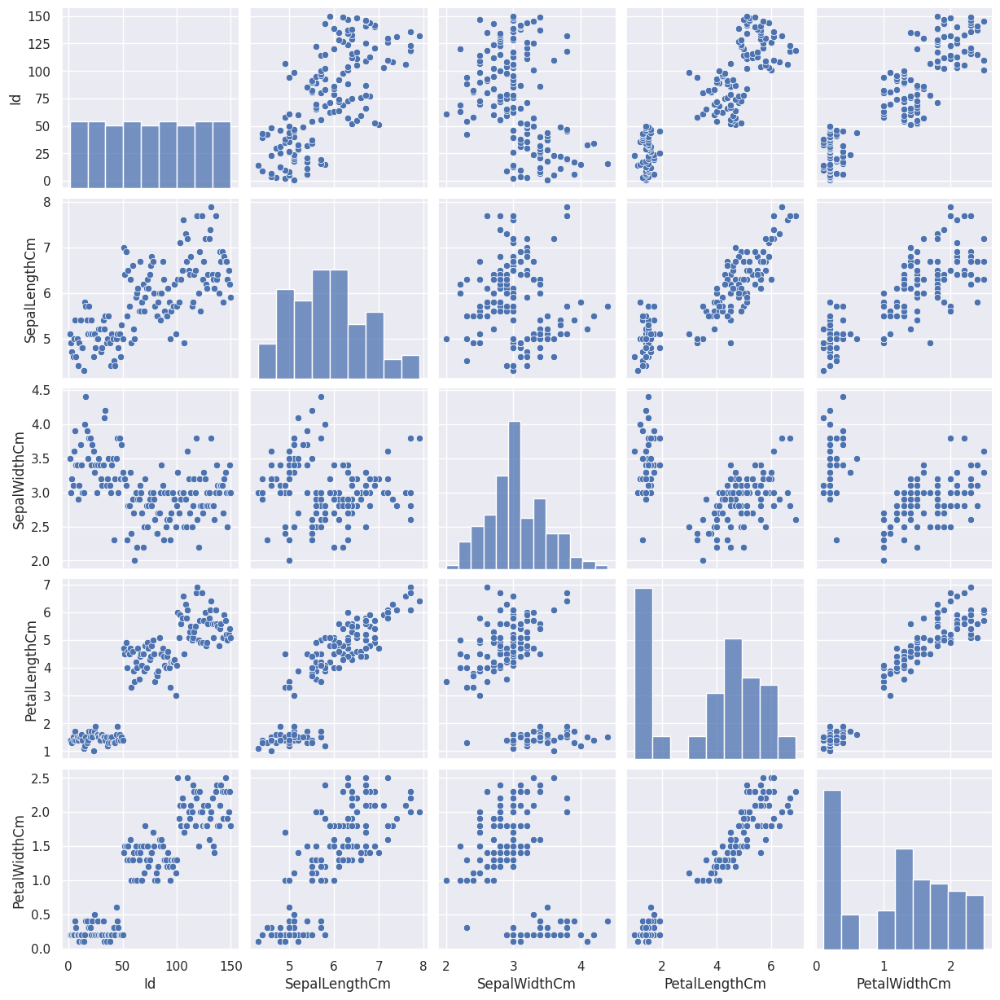

In [ ]:
sns.pairplot(iris);

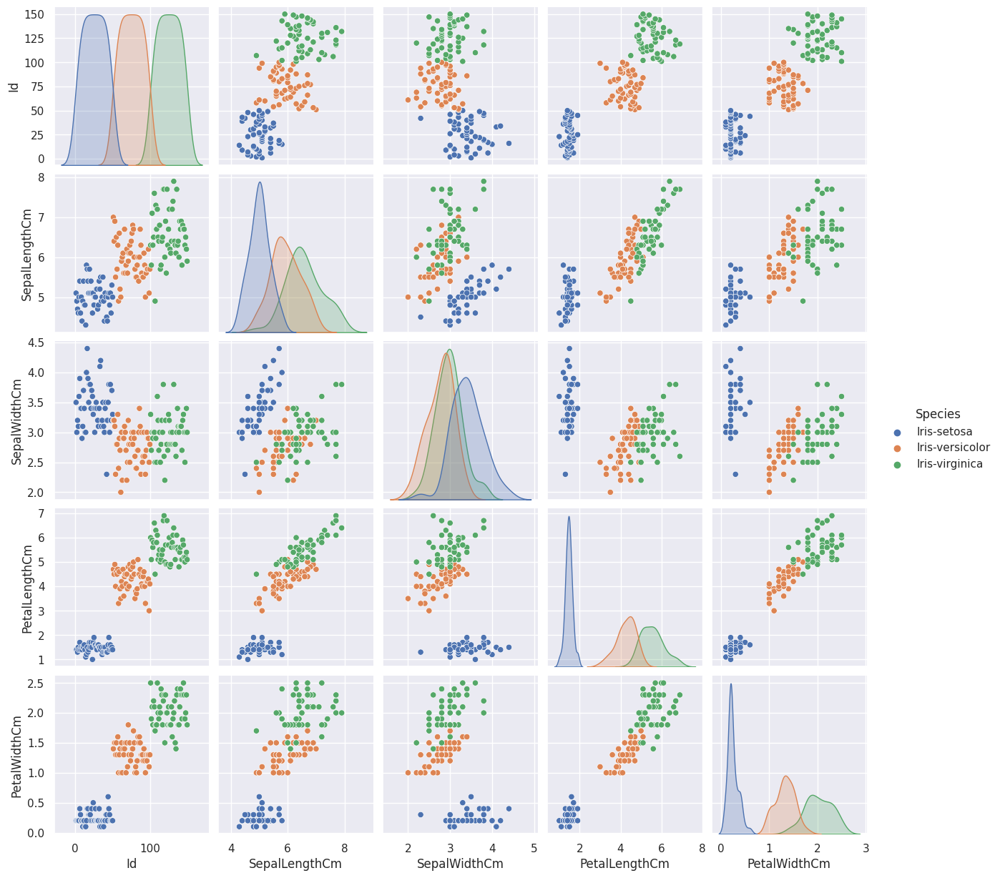

In [ ]:
sns.pairplot(iris, hue="Species");

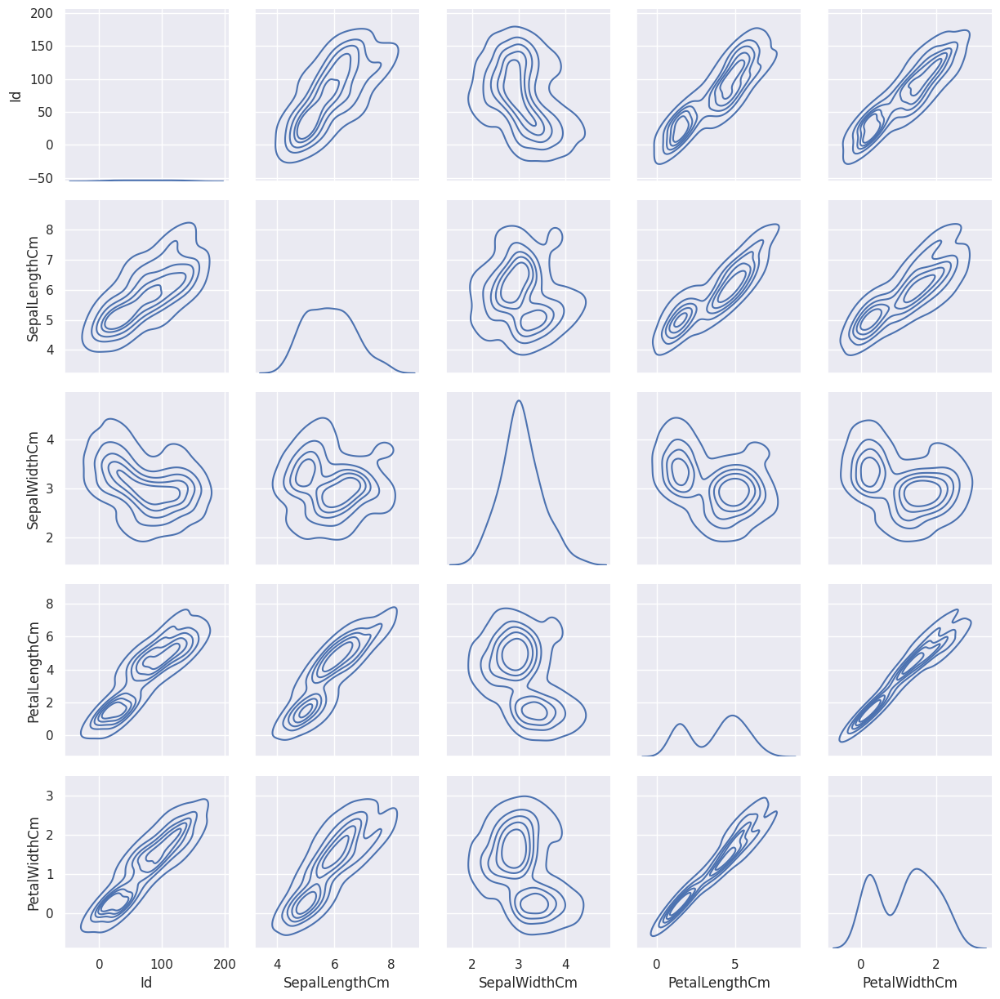

In [ ]:
g = sns.PairGrid(iris)
g.map_diag(sns.kdeplot)
g.map_offdiag(sns.kdeplot, n_levels=6);

## Heatmap

In [ ]:
flights = sns.load_dataset("flights")

NameError: ignored

In [ ]:
flights.head()

In [ ]:
flights = flights.pivot("month","year","passengers")

In [ ]:
flights

year,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960
month,,,,,,,,,,,,
Jan,112,115,145,171,196,204,242,284,315,340,360,417
Feb,118,126,150,180,196,188,233,277,301,318,342,391
Mar,132,141,178,193,236,235,267,317,356,362,406,419
Apr,129,135,163,181,235,227,269,313,348,348,396,461
May,121,125,172,183,229,234,270,318,355,363,420,472
Jun,135,149,178,218,243,264,315,374,422,435,472,535
Jul,148,170,199,230,264,302,364,413,465,491,548,622
Aug,148,170,199,242,272,293,347,405,467,505,559,606
Sep,136,158,184,209,237,259,312,355,404,404,463,508


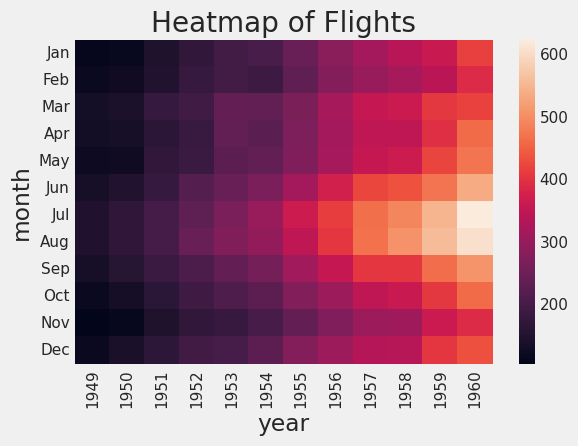

In [ ]:
sns.heatmap(flights)

plt.title("Heatmap of Flights")

plt.show()

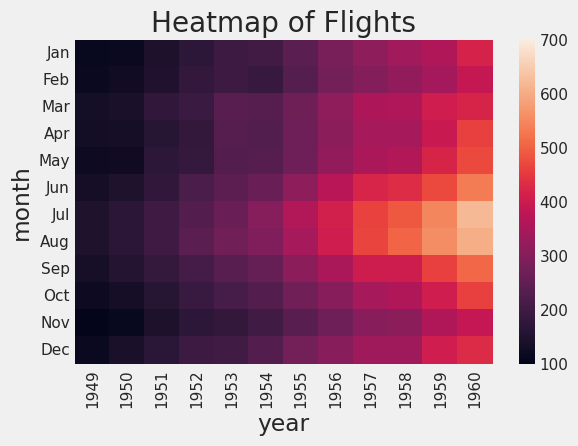

In [ ]:
sns.heatmap(flights, vmin=100,vmax=700)

plt.title("Heatmap of Flights")

plt.show()

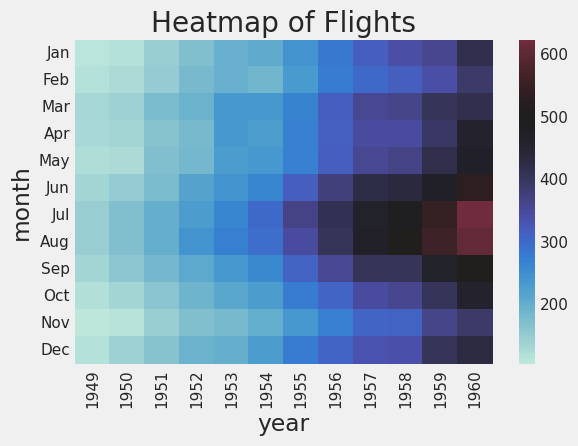

In [ ]:
sns.heatmap(flights, center=500)

plt.title("Heatmap of Flights")

plt.show()

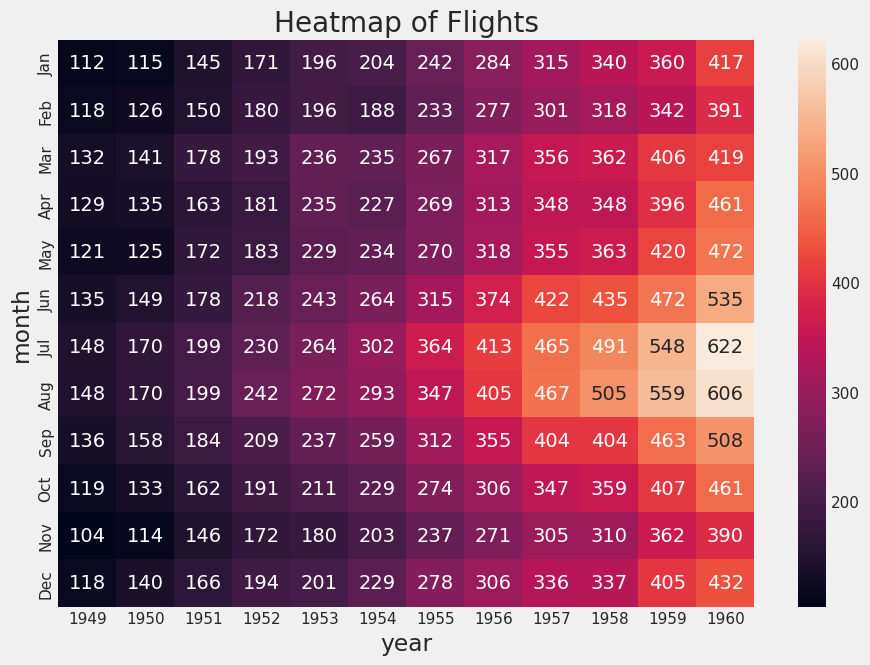

In [ ]:
plt.figure(figsize=(10,7))

sns.heatmap(flights, annot=True,fmt="d")

plt.title("Heatmap of Flights")

plt.show()

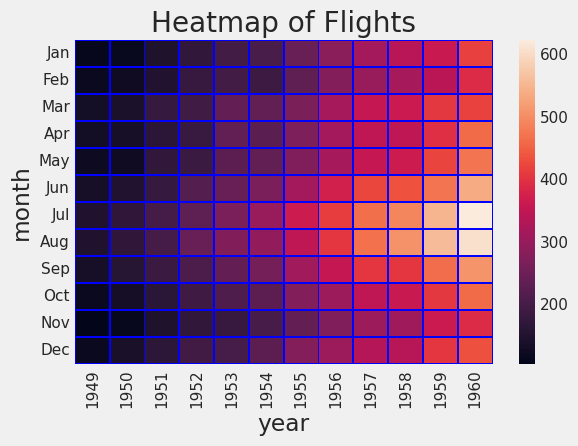

In [ ]:
sns.heatmap(flights, linewidths=0.5,linecolor="blue")

plt.title("Heatmap of Flights")

plt.show()

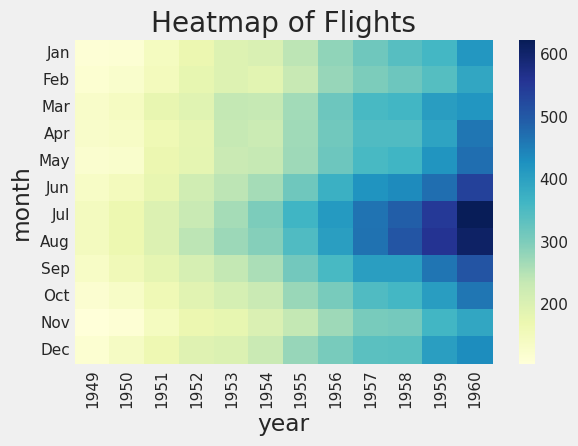

In [ ]:
sns.heatmap(flights, cmap="YlGnBu")

plt.title("Heatmap of Flights")

plt.show()

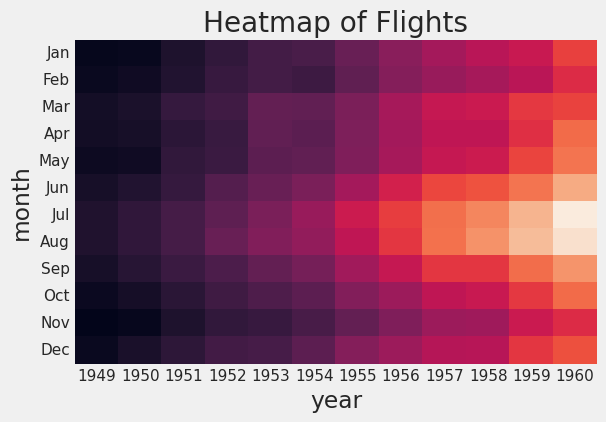

In [ ]:
sns.heatmap(flights, cbar=False)

plt.title("Heatmap of Flights")

plt.show()

In [ ]:
df.describe().T.style.bar(subset=['mean'], color='#205ff2')\
                            .background_gradient(subset=['std'], cmap='viridis')\
                             .background_gradient(subset=['50%'], cmap='mako')

In [ ]:
train.describe().T[1:].sort_values(by='mean',ascending=False).style.background_gradient(cmap='YlOrRd')

In [ ]:
test.describe().T[1:].sort_values(by='mean',ascending=False).style.background_gradient(cmap='YlOrRd')

##Dados Missing 

In [ ]:
custom_colors = ["#6b2fbb","#132ed1","#3f47fe","#d6e0f0","#117f2d","#50ef39","#38fedc","#71491e","#c51111","#ed54ba","#ef7d0d","#f5f557"]
customPalette = sns.set_palette(sns.color_palette(custom_colors))

In [ ]:
sns.palplot(sns.color_palette(custom_colors),size=0.8)
plt.tick_params(axis='both', labelsize=0, length = 0)

In [ ]:
missing_count = train_df.isna().sum()
missing_df = (pd.concat([missing_count.rename('Missing count'),
                     missing_count.div(len(train_df))
                          .rename('Missing ratio')],axis = 1)
             .loc[missing_count.ne(0)])

#color the background of cells in a dataframe depending on the value of the data in each column 
missing_df.style.background_gradient(cmap="cool")

In [ ]:
msno.bar(train_df,color=palette[2], sort="ascending", figsize=(10,5), fontsize=12)
plt.show()


# Relacionamentos lineares

Muitos conjuntos de dados contêm várias variáveis ​​quantitativas, e o objetivo de uma análise geralmente é relacionar essas variáveis ​​entre si. Discutimos anteriormente as funções que podem fazer isso mostrando a distribuição conjunta de duas variáveis. Pode ser muito útil, entretanto, usar modelos estatísticos para estimar uma relação simples entre dois conjuntos ruidosos de observações.

> Duas funções principais no seaborn são usadas para visualizar uma relação linear conforme determinado por meio de regressão. Essas funções, regplot () e lmplot () estão intimamente relacionadas e compartilham muito de sua funcionalidade principal.

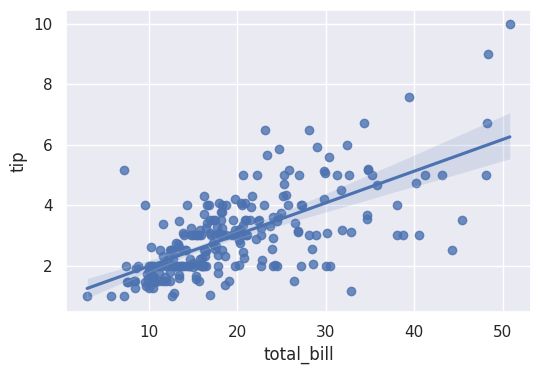

In [ ]:
sns.regplot(x="total_bill", y="tip", data=tips);

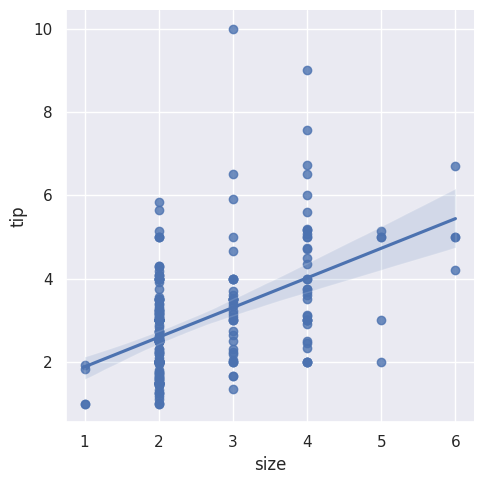

In [ ]:
sns.lmplot(x="size", y="tip", data=tips);

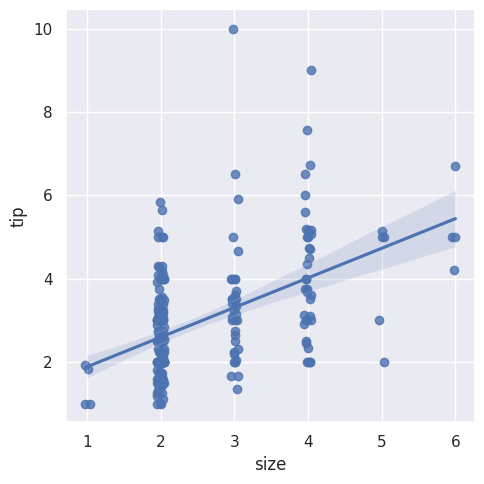

In [ ]:
sns.lmplot(x="size", y="tip", data=tips, x_jitter=.05);


Uma segunda opção é recolher as observações em cada compartimento discreto para traçar uma estimativa da tendência central junto com um intervalo de confiança:

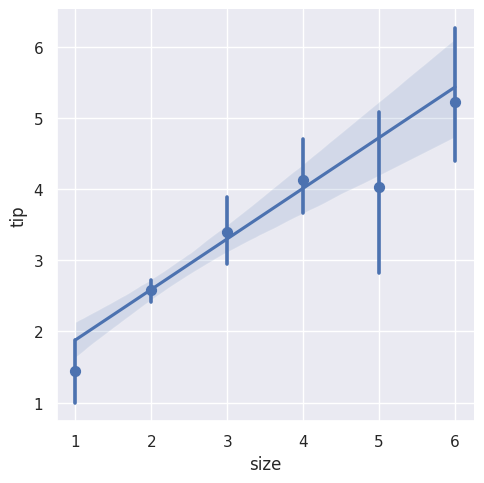

In [ ]:
sns.lmplot(x="size", y="tip", data=tips, x_estimator=np.mean)

## Adaptando-se a diferentes tipos de modelos

O modelo de regressão linear simples usado acima é muito simples de ajustar, no entanto, não é apropriado para alguns tipos de conjuntos de dados.

In [ ]:
anscombe = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/anscombe.csv')


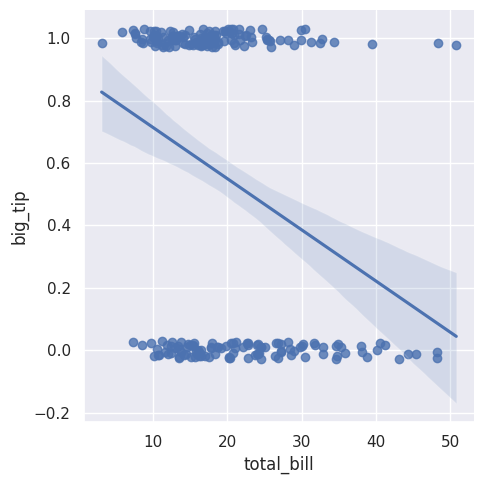

In [ ]:
tips["big_tip"] = (tips.tip / tips.total_bill) > .15
sns.lmplot(x="total_bill", y="big_tip", data=tips,
           y_jitter=.03);

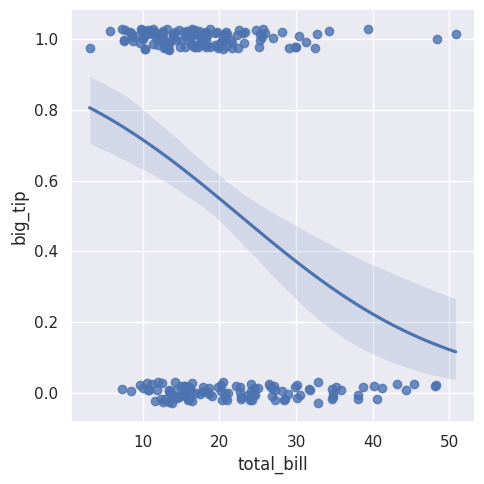

In [ ]:
sns.lmplot(x="total_bill", y="big_tip", data=tips,
           logistic=True, y_jitter=.03);

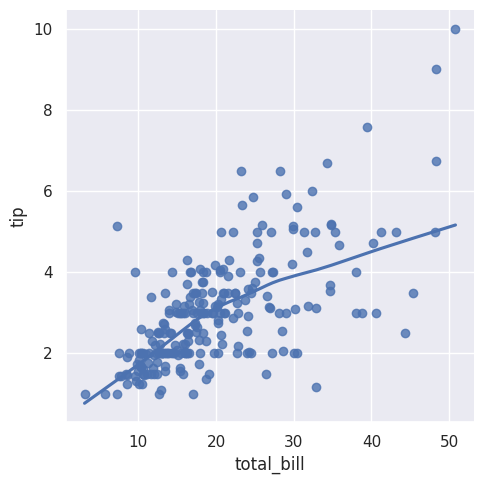

In [ ]:
sns.lmplot(x="total_bill", y="tip", data=tips,
           lowess=True);

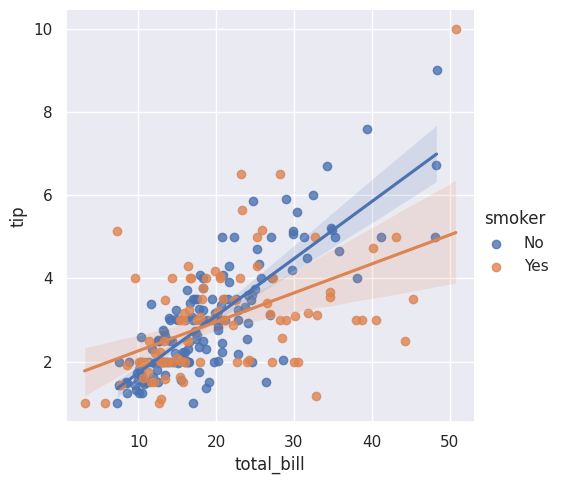

In [ ]:
sns.lmplot(x="total_bill", y="tip", hue="smoker", data=tips);

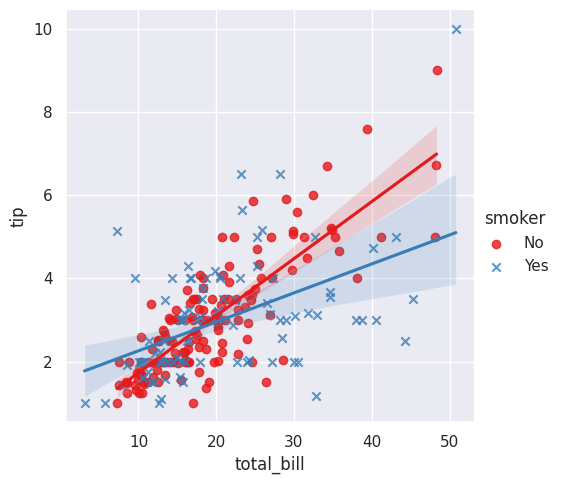

In [ ]:
sns.lmplot(x="total_bill", y="tip", hue="smoker", data=tips,
           markers=["o", "x"], palette="Set1");

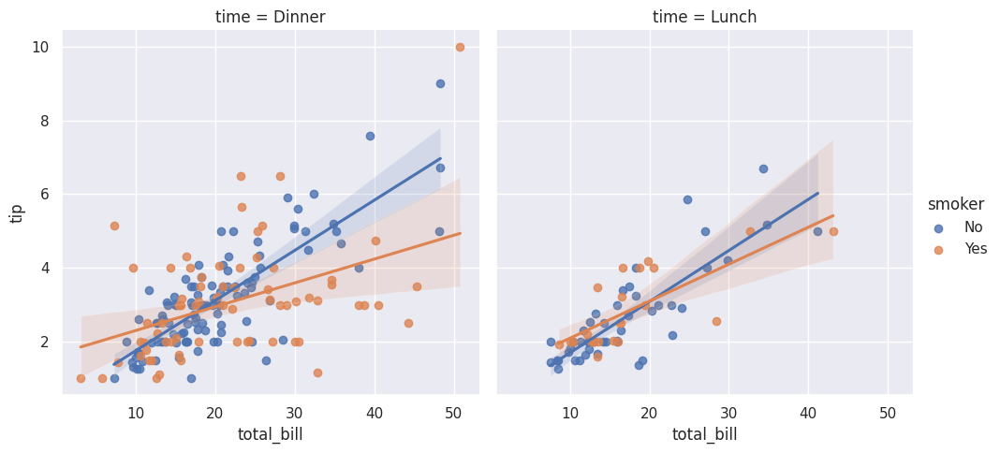

In [ ]:
sns.lmplot(x="total_bill", y="tip", hue="smoker", col="time", data=tips);

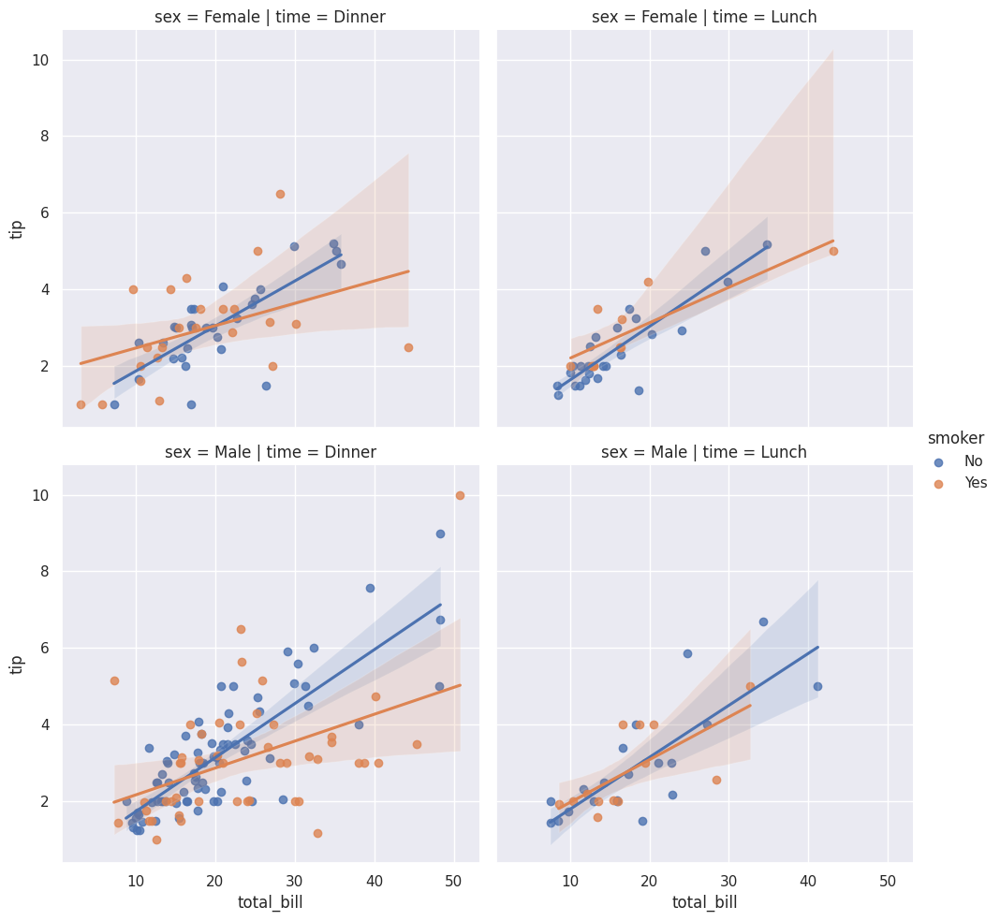

In [ ]:
sns.lmplot(x="total_bill", y="tip", hue="smoker",
           col="time", row="sex", data=tips);

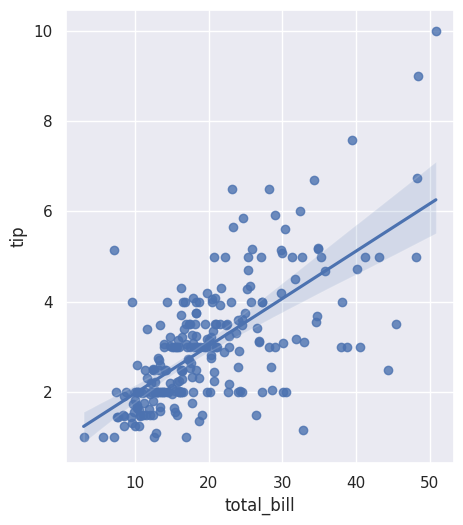

In [ ]:
f, ax = plt.subplots(figsize=(5, 6))
sns.regplot(x="total_bill", y="tip", data=tips, ax=ax);

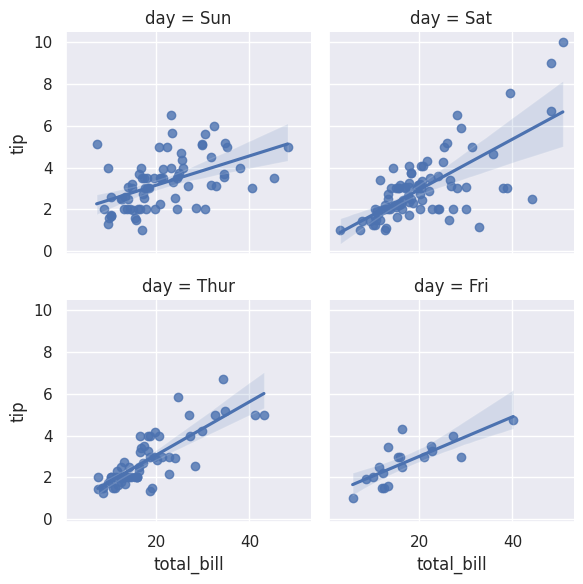

In [ ]:
sns.lmplot(x="total_bill", y="tip", col="day", data=tips,
           col_wrap=2, height=3);

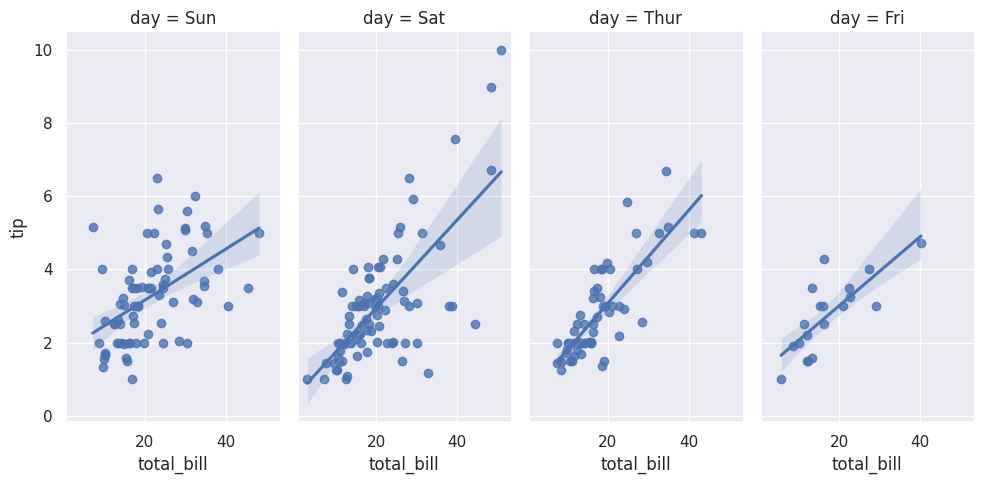

In [ ]:
sns.lmplot(x="total_bill", y="tip", col="day", data=tips,
           aspect=.5);

## Pequenos múltiplos condicionais

A classe FacetGrid é útil quando você deseja visualizar a distribuição de uma variável ou o relacionamento entre várias variáveis ​​separadamente dentro de subconjuntos de seu conjunto de dados. Um FacetGrid pode ser desenhado com até três dimensões: linha, coluna e matiz. Os dois primeiros têm correspondência óbvia com a matriz de eixos resultante; pense na variável de matiz como uma terceira dimensão ao longo de um eixo de profundidade, onde diferentes níveis são plotados com cores diferentes.

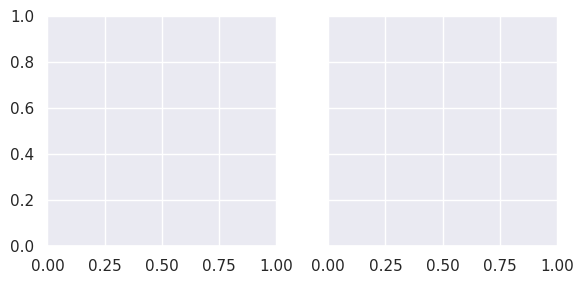

In [ ]:
g = sns.FacetGrid(tips, col="time")

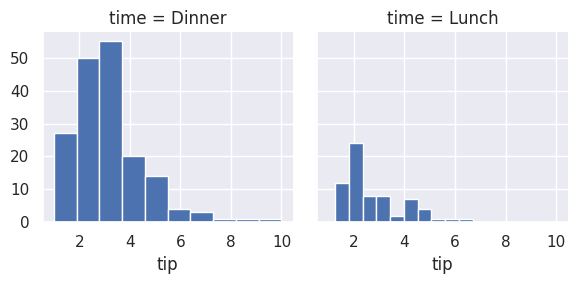

In [ ]:
g = sns.FacetGrid(tips, col="time")
g.map(plt.hist, "tip");

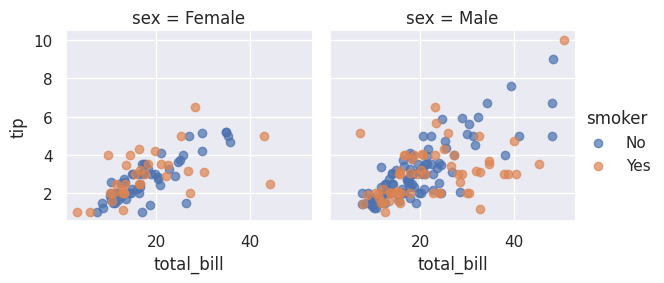

In [ ]:
g = sns.FacetGrid(tips, col="sex", hue="smoker")
g.map(plt.scatter, "total_bill", "tip", alpha=.7)
g.add_legend();

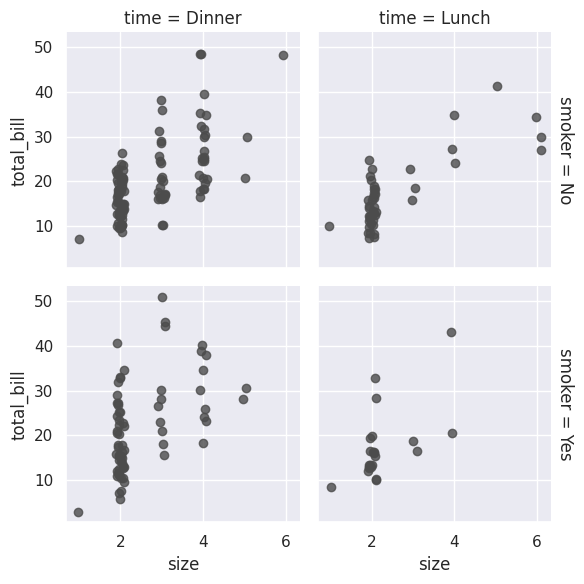

In [ ]:
g = sns.FacetGrid(tips, row="smoker", col="time", margin_titles=True)
g.map(sns.regplot, "size", "total_bill", color=".3", fit_reg=False, x_jitter=.1);

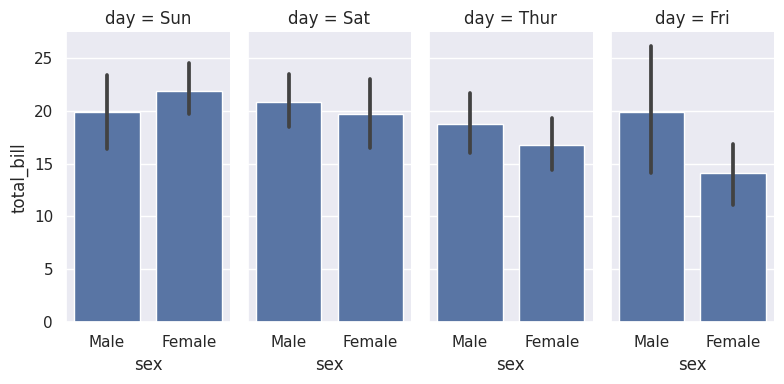

In [ ]:
g = sns.FacetGrid(tips, col="day", height=4, aspect=.5)
g.map(sns.barplot, "sex", "total_bill");

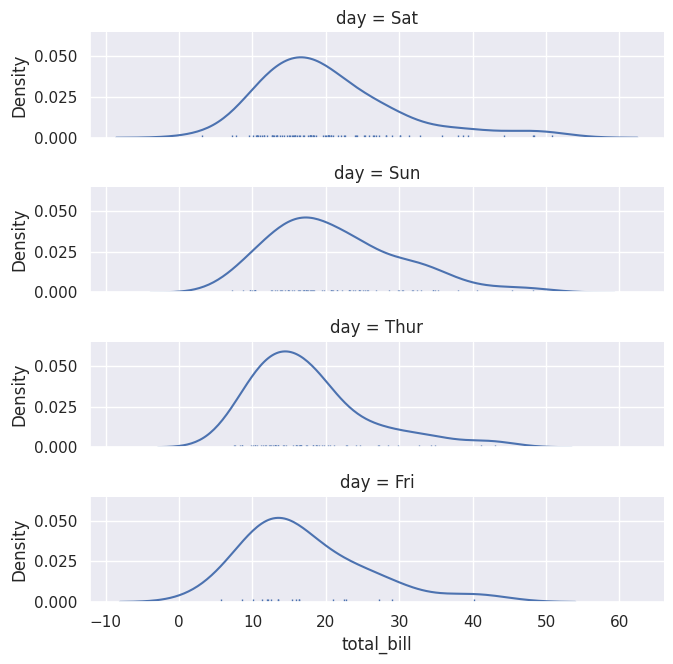

In [ ]:
ordered_days = tips.day.value_counts().index

g = sns.FacetGrid(tips, row="day", row_order=ordered_days,
                  height=1.7, aspect=4,)

g.map(sns.distplot, "total_bill", hist=False, rug=True);

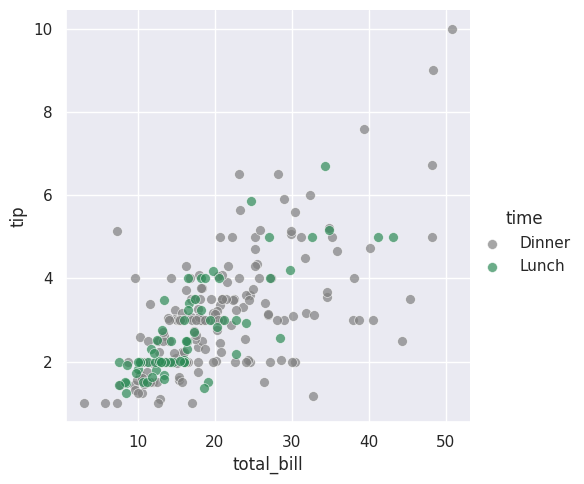

In [ ]:
pal = dict(Lunch="seagreen", Dinner="gray")
g = sns.FacetGrid(tips, hue="time", palette=pal, height=5)
g.map(plt.scatter, "total_bill", "tip", s=50, alpha=.7, linewidth=.5, edgecolor="white")
g.add_legend();

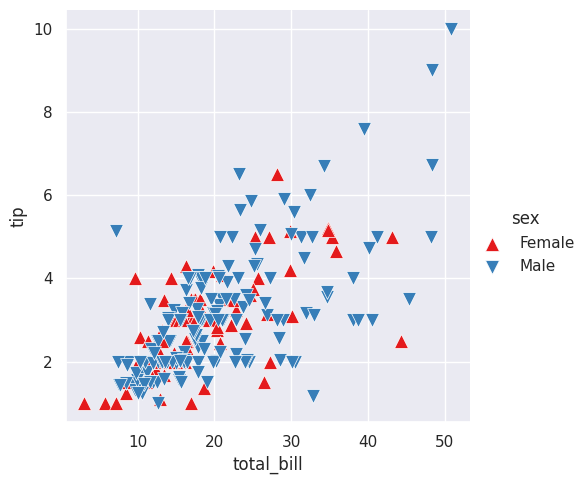

In [ ]:
g = sns.FacetGrid(tips, hue="sex", palette="Set1", height=5, hue_kws={"marker": ["^", "v"]})
g.map(plt.scatter, "total_bill", "tip", s=100, linewidth=.5, edgecolor="white")
g.add_legend();

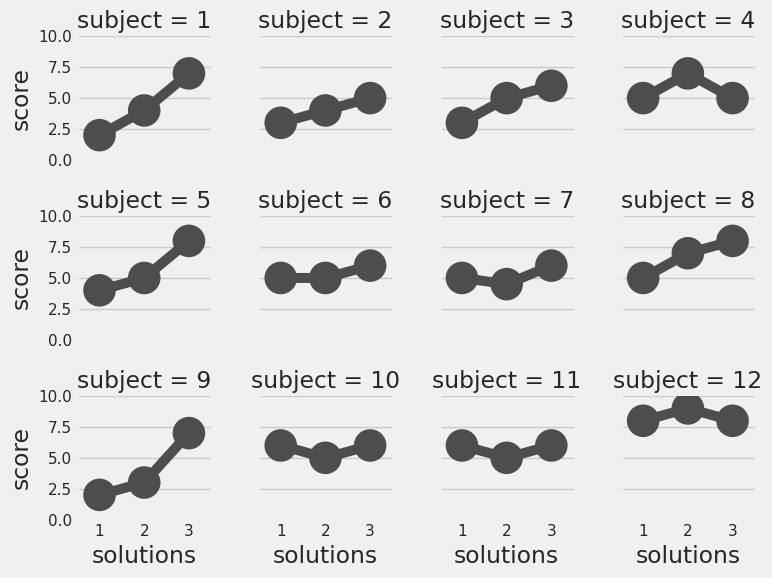

In [ ]:
attend = pd.read_csv('https://raw.githubusercontent.com/mwaskom/seaborn-data/master/attention.csv').query("subject <= 12")
g = sns.FacetGrid(attend, col="subject", col_wrap=4, height=2, ylim=(0, 10))
g.map(sns.pointplot, "solutions", "score", order=[1, 2, 3], color=".3", ci=None);

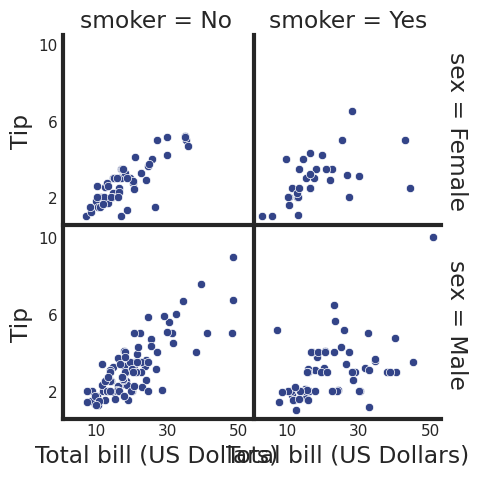

In [ ]:
with sns.axes_style("white"):
    g = sns.FacetGrid(tips, row="sex", col="smoker", margin_titles=True, height=2.5)
g.map(plt.scatter, "total_bill", "tip", color="#334488", edgecolor="white", lw=.5);
g.set_axis_labels("Total bill (US Dollars)", "Tip");
g.set(xticks=[10, 30, 50], yticks=[2, 6, 10]);
g.fig.subplots_adjust(wspace=.02, hspace=.02);

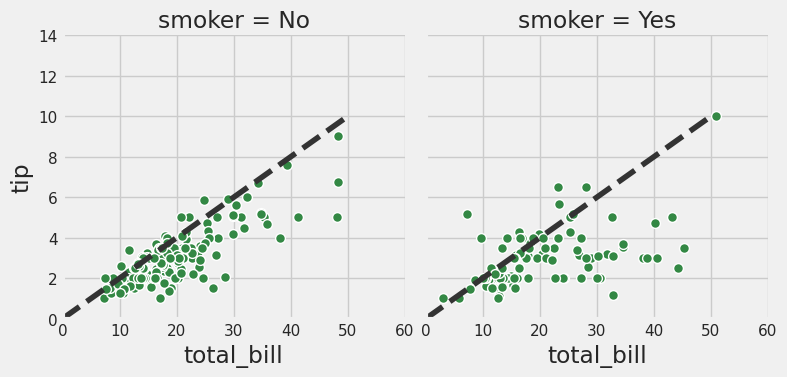

In [ ]:
g = sns.FacetGrid(tips, col="smoker", margin_titles=True, height=4)
g.map(plt.scatter, "total_bill", "tip", color="#338844", edgecolor="white", s=50, lw=1)
for ax in g.axes.flat:
    ax.plot((0, 50), (0, .2 * 50), c=".2", ls="--")
g.set(xlim=(0, 60), ylim=(0, 14));

## Usando funções personalizadas

Você não está limitado às funções matplotlib e seaborn existentes ao usar o FacetGrid. No entanto, para funcionar corretamente, qualquer função que você usar deve seguir algumas regras:

> Deve ser plotado nos eixos matplotlib “atualmente ativos”. Isso será verdadeiro para funções no namespace matplotlib.pyplot, e você pode chamar matplotlib.pyplot.gca () para obter uma referência aos eixos atuais se quiser trabalhar diretamente com seus métodos.

> Deve aceitar os dados que traça em argumentos posicionais. Internamente, o FacetGrid passará uma série de dados para cada um dos argumentos posicionais nomeados passados ​​para FacetGrid.map ().

> Deve ser capaz de aceitar argumentos de palavra-chave com cores e rótulos e, de preferência, fará algo útil com eles. Na maioria dos casos, é mais fácil pegar um dicionário genérico de ** kwargs e passá-lo para a função de plotagem subjacente.

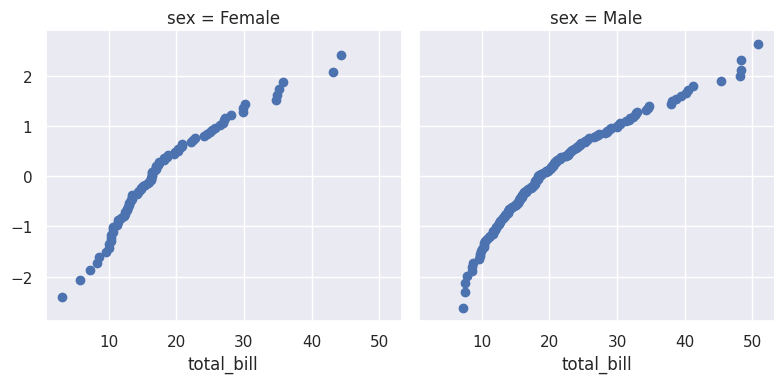

In [ ]:
from scipy import stats
def quantile_plot(x, **kwargs):
    qntls, xr = stats.probplot(x, fit=False)
    plt.scatter(xr, qntls, **kwargs)

g = sns.FacetGrid(tips, col="sex", height=4)
g.map(quantile_plot, "total_bill");

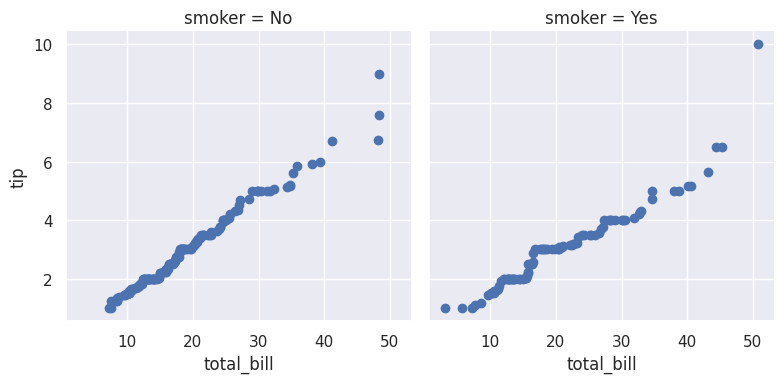

In [ ]:
def qqplot(x, y, **kwargs):
    _, xr = stats.probplot(x, fit=False)
    _, yr = stats.probplot(y, fit=False)
    plt.scatter(xr, yr, **kwargs)

g = sns.FacetGrid(tips, col="smoker", height=4)
g.map(qqplot, "total_bill", "tip");

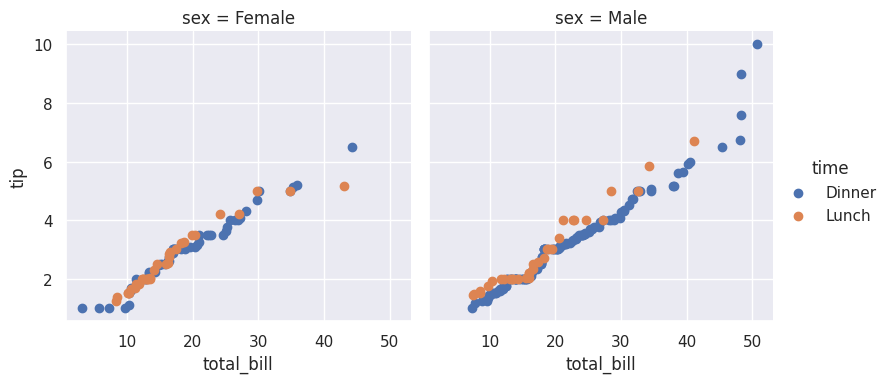

In [ ]:
g = sns.FacetGrid(tips, hue="time", col="sex", height=4)
g.map(qqplot, "total_bill", "tip")
g.add_legend();

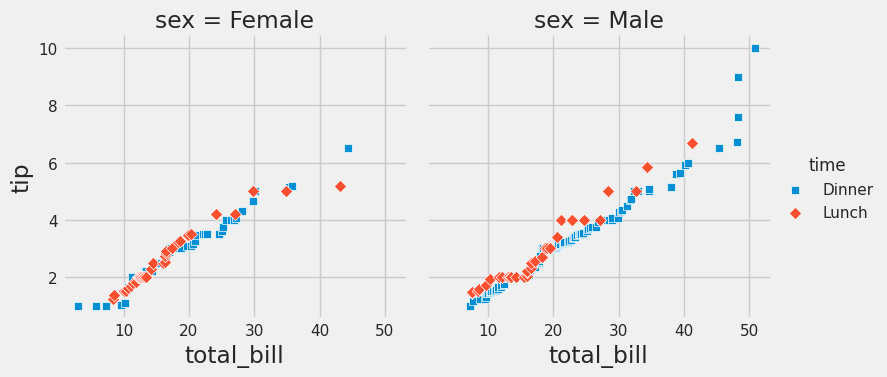

In [ ]:
g = sns.FacetGrid(tips, hue="time", col="sex", height=4,
                  hue_kws={"marker": ["s", "D"]})
g.map(qqplot, "total_bill", "tip", s=40, edgecolor="w")
g.add_legend();

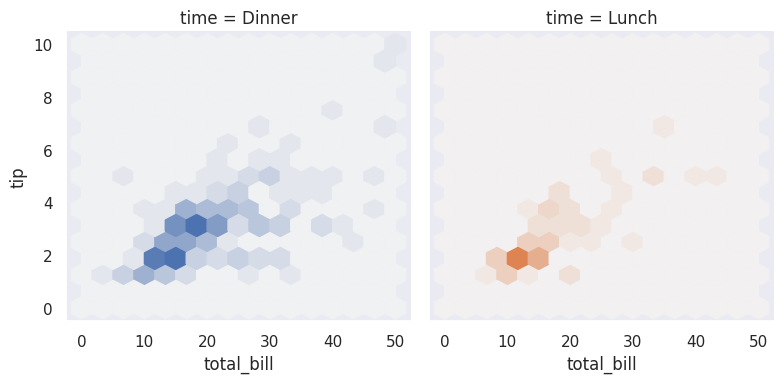

In [ ]:
def hexbin(x, y, color, **kwargs):
    cmap = sns.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=15, cmap=cmap, **kwargs)

with sns.axes_style("dark"):
    g = sns.FacetGrid(tips, hue="time", col="time", height=4)
g.map(hexbin, "total_bill", "tip", extent=[0, 50, 0, 10]);

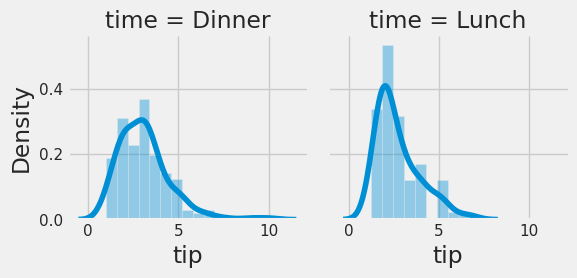

In [ ]:
ax= sns.FacetGrid(tips,col="time") #col argument takes the column we want.

ax.map(sns.distplot, "tip")

plt.show()

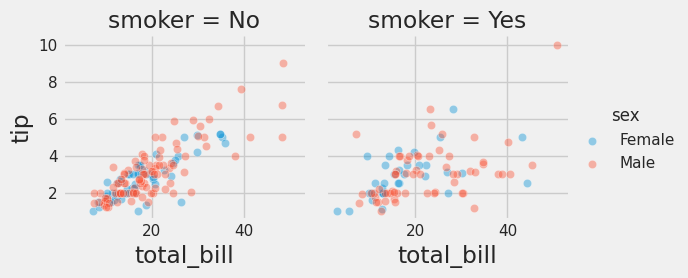

In [ ]:
g = sns.FacetGrid(tips, col="smoker", hue="sex")

g.map(sns.scatterplot, "total_bill", "tip", alpha=.4)

g.add_legend()

plt.show()

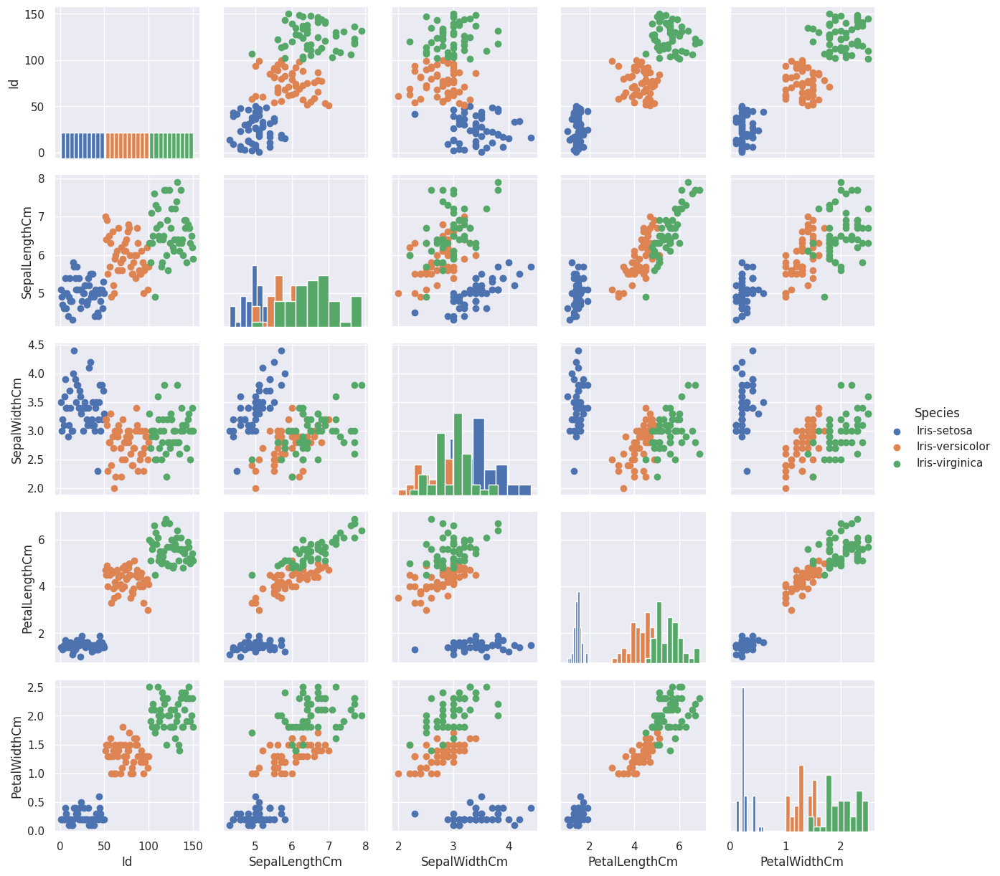

In [ ]:
g = sns.PairGrid(iris, hue="Species")
g.map_diag(plt.hist)
g.map_offdiag(plt.scatter)
g.add_legend();

In [ ]:
iris.head()

,Id,SepalLengthCm,SepalWidthCm,PetalLengthCm,PetalWidthCm,Species
0,1,5.1,3.5,1.4,0.2,Iris-setosa
1,2,4.9,3.0,1.4,0.2,Iris-setosa
2,3,4.7,3.2,1.3,0.2,Iris-setosa
3,4,4.6,3.1,1.5,0.2,Iris-setosa
4,5,5.0,3.6,1.4,0.2,Iris-setosa


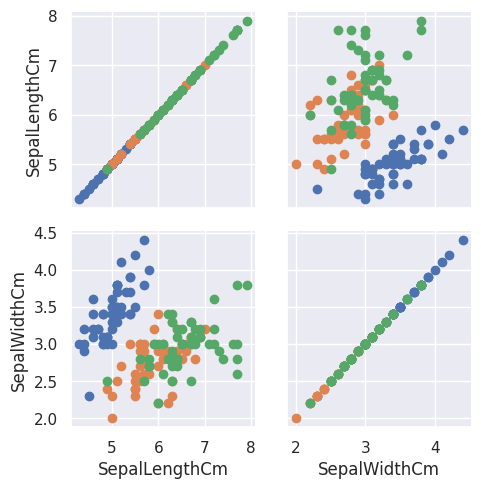

In [ ]:
g = sns.PairGrid(iris, vars=["SepalLengthCm", "SepalWidthCm"], hue="Species")
g.map(plt.scatter);

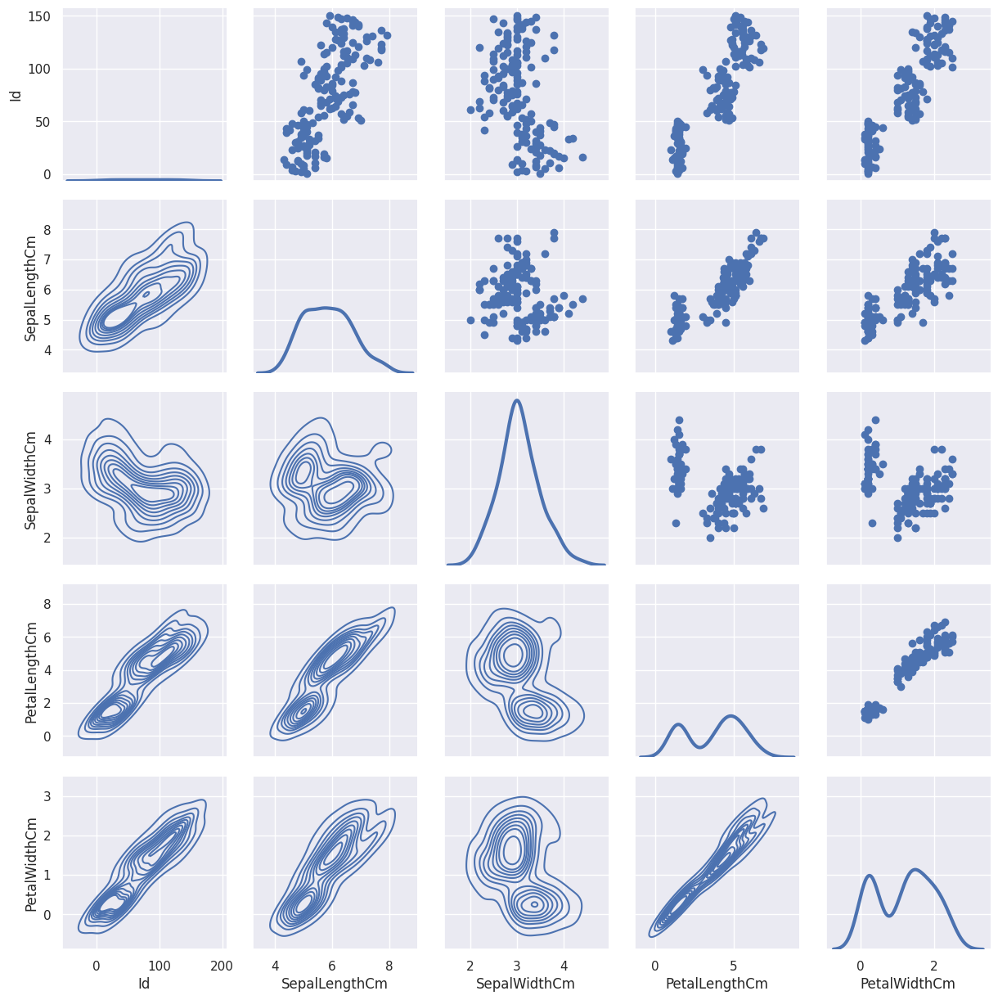

In [ ]:
g = sns.PairGrid(iris)
g.map_upper(plt.scatter)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=3, legend=False);

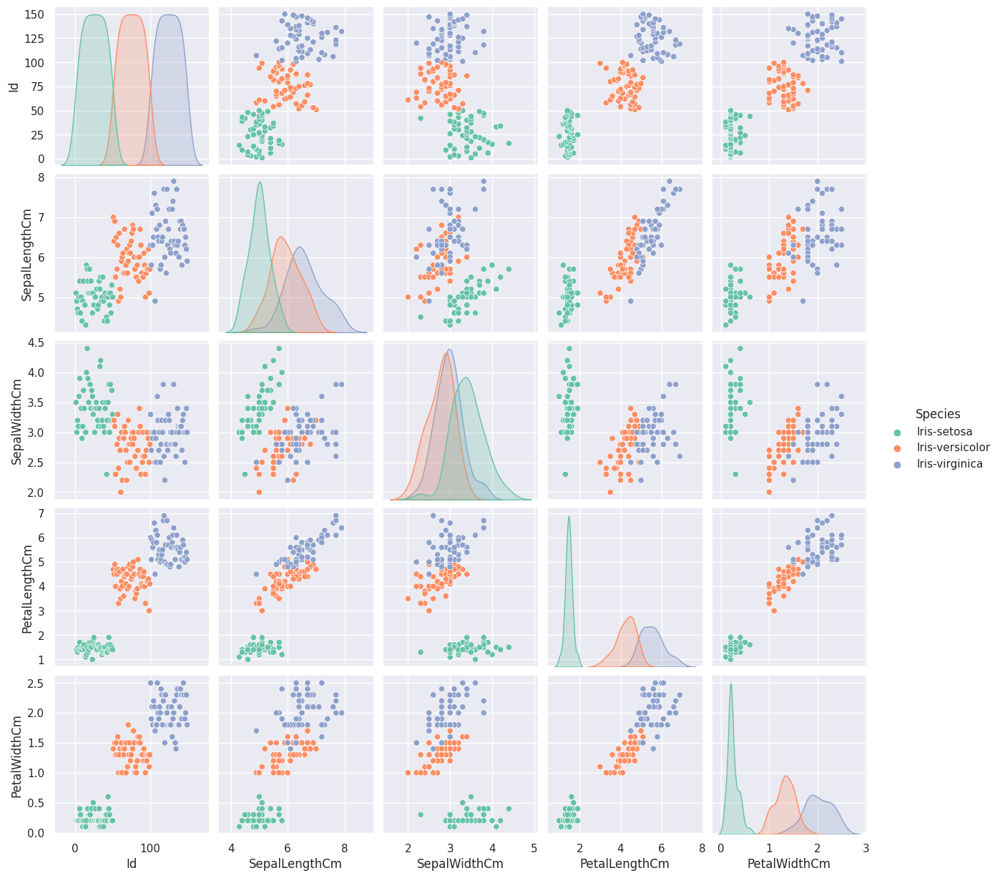

In [ ]:
g = sns.pairplot(iris, hue="Species", palette="Set2", diag_kind="kde", height=2.5)

In [ ]:
experience = [1,2,3,4,5,6,7,8]

data_scientists_salary = [6500, 9280, 12050, 13200, 16672, 21000, 23965, 29793]

genders = ["Men","Men","Women","Men","Women","Women","Women","Men"]

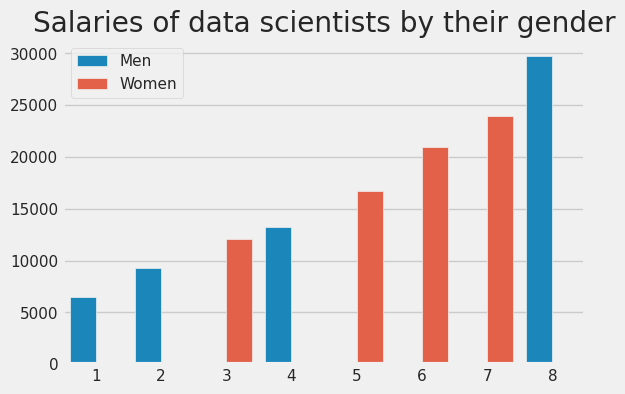

In [ ]:
sns.barplot(x=experience,y=data_scientists_salary,hue=genders)

plt.title("Salaries of data scientists by their gender")
plt.show()

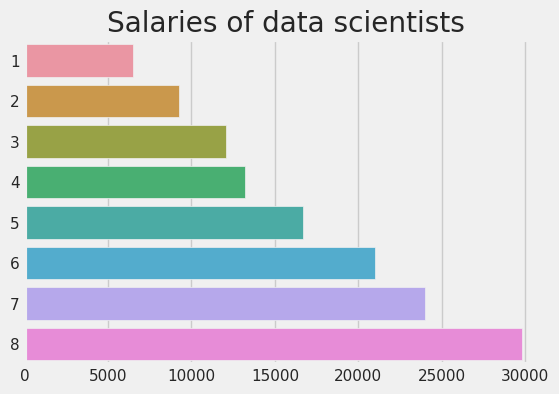

In [ ]:
sns.barplot(y=experience,x=data_scientists_salary,orient = 'h')

plt.title("Salaries of data scientists")
plt.show()

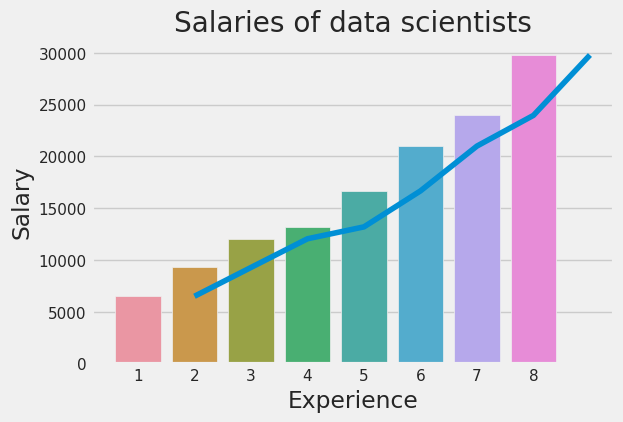

In [ ]:
sns.barplot(x=experience,y=data_scientists_salary)
sns.lineplot(x=experience,y=data_scientists_salary)

plt.title("Salaries of data scientists")
plt.xlabel("Experience")
plt.ylabel("Salary")
plt.show()

In [ ]:
df = pd.read_csv("https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/HRDataset_v14.csv")

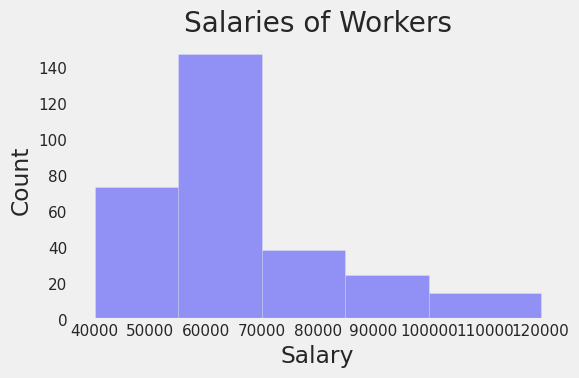

In [ ]:
plt.style.use("fivethirtyeight")

bins = [40000,55000,70000,85000,100000,120000]

sns.distplot(df.Salary,bins=bins,color="blue",kde=False)

plt.title("Salaries of Workers")
plt.xlabel("Salary")
plt.ylabel("Count")

plt.tight_layout()
plt.grid(False)
plt.show()

In [ ]:
fully_meets = df[df["PerformanceScore"]=="Fully Meets"]
exceeds = df[df["PerformanceScore"]=="Exceeds"]
needs_improvement = df[df["PerformanceScore"]=="Needs Improvement"]
pip = df[df["PerformanceScore"]=="PIP"]

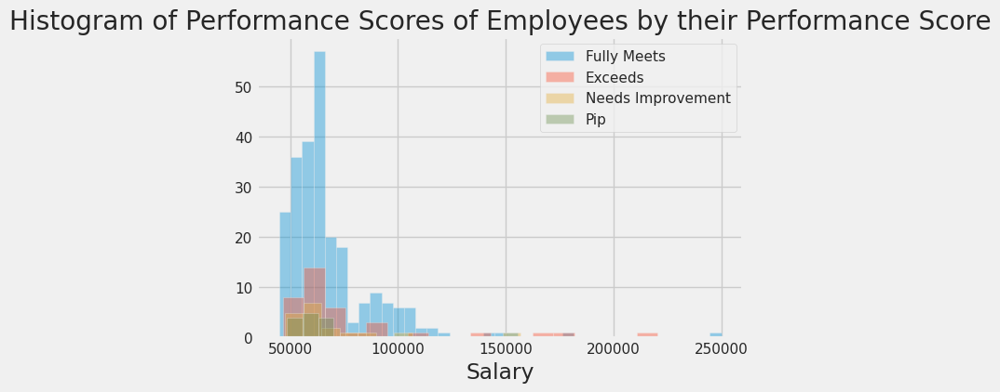

In [ ]:
sns.distplot(a= fully_meets["Salary"], label="Fully Meets", kde=False)
sns.distplot(a=exceeds["Salary"] , label="Exceeds", kde=False)
sns.distplot(a= needs_improvement["Salary"], label="Needs Improvement", kde=False)
sns.distplot(a=pip["Salary"], label="Pip", kde=False)

plt.title("Histogram of Performance Scores of Employees by their Performance Score")

plt.legend()

plt.show()

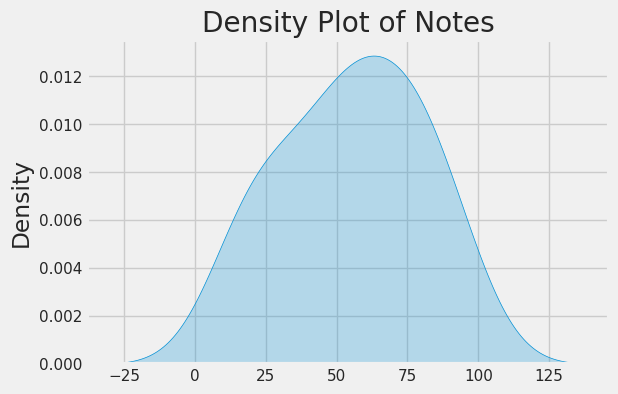

In [ ]:
notes = [30,74,94,14,55,47,63,28,88,44,53,18,66,74,81]
sns.kdeplot(data=notes, shade=True) # Setting shade=True colors the area below the curve

plt.title("Density Plot of Notes")

plt.show()

In [ ]:
first_exam_notes = [30,74,94,14,55,47,63,28,88,44,53,18,66,74,81]
final_exam_notes = [96,77,19,29,56,29,33,49,83,37,84,73,16,48,79]

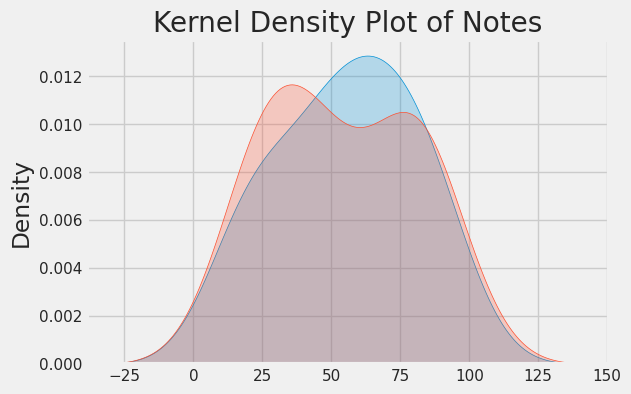

In [ ]:
sns.kdeplot(data=first_exam_notes,label="First Exam Notes", shade=True)
sns.kdeplot(data=final_exam_notes,label="Final Exam Notes", shade=True)

plt.title("Kernel Density Plot of Notes")

plt.show()

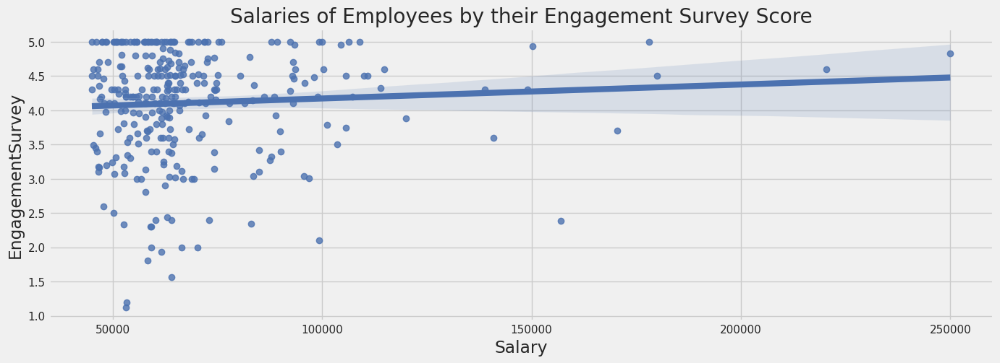

In [ ]:
plt.figure(figsize=(15,5))

sns.regplot(x=df.Salary,y=df.EngagementSurvey,color="b")

plt.title("Salaries of Employees by their Engagement Survey Score")
plt.show()

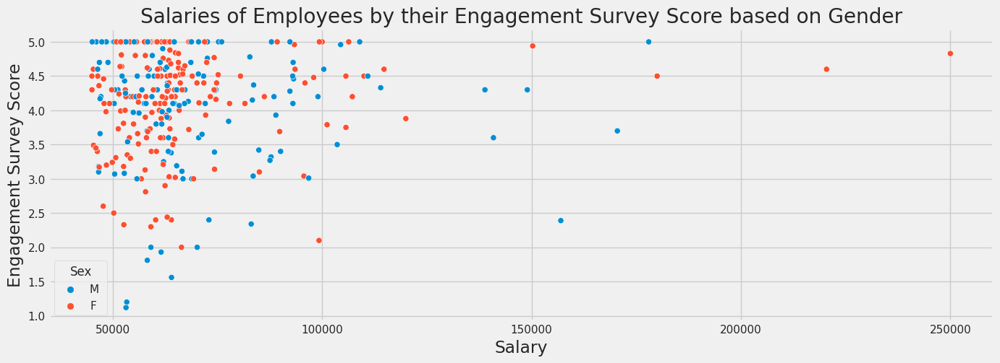

In [ ]:
plt.figure(figsize=(15,5))

sns.scatterplot(x=df.Salary,y=df.EngagementSurvey,hue=df.Sex)

plt.xlabel("Salary")
plt.ylabel("Engagement Survey Score")

plt.title("Salaries of Employees by their Engagement Survey Score based on Gender")
plt.show()

<Figure size 1000x1000 with 0 Axes>

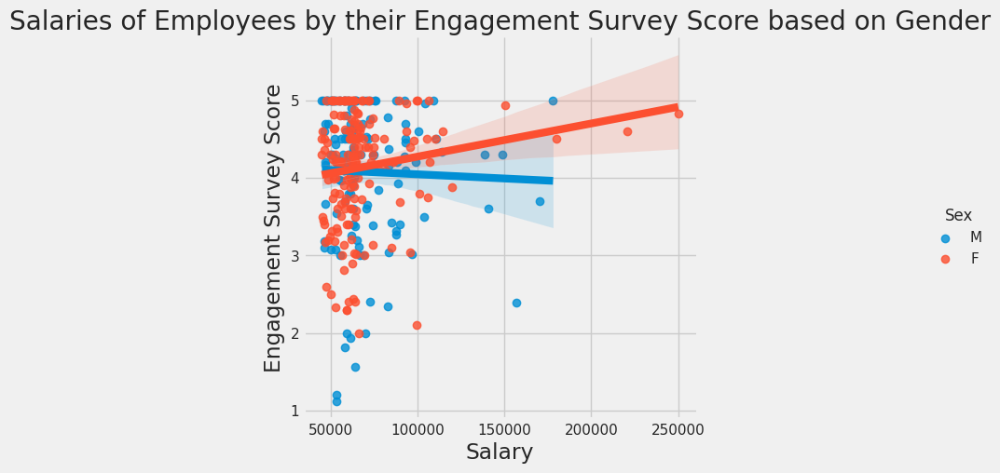

In [ ]:
plt.figure(figsize=(10,10))

sns.lmplot(x="Salary",y="EngagementSurvey",hue="Sex",data=df)

plt.xlabel("Salary")
plt.ylabel("Engagement Survey Score")

plt.title("Salaries of Employees by their Engagement Survey Score based on Gender")
plt.show()

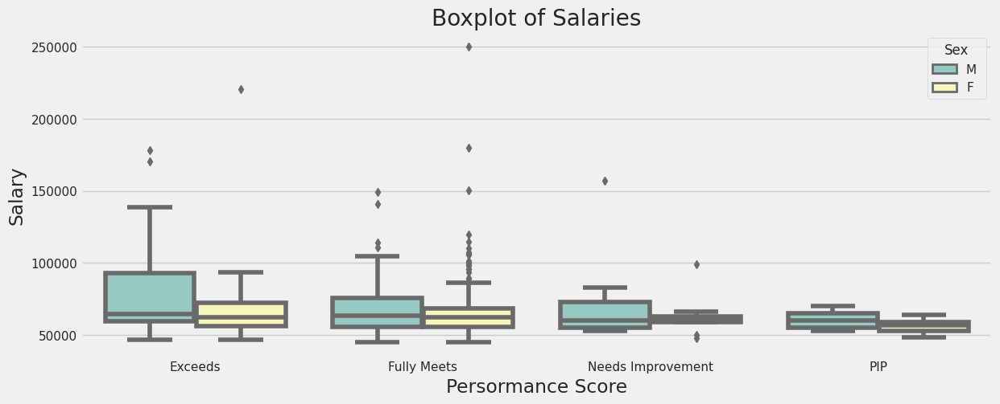

In [ ]:
plt.figure(figsize=(13,5))

sns.boxplot(x="PerformanceScore", y="Salary",hue="Sex",data=df, palette="Set3")

plt.title("Boxplot of Salaries")
plt.ylabel("Salary")
plt.xlabel("Persormance Score")

plt.show()

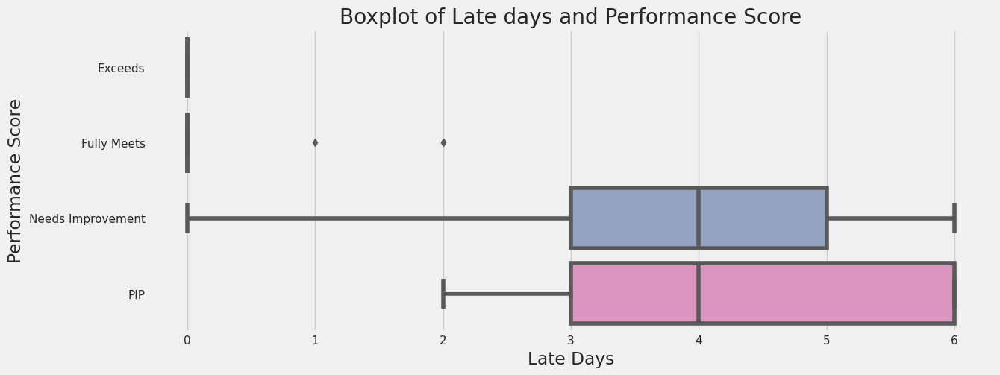

In [ ]:
plt.figure(figsize=(13,5))

sns.boxplot(x="DaysLateLast30",y="PerformanceScore",data=df, palette="Set2",orient="h")

plt.title("Boxplot of Late days and Performance Score")
plt.ylabel("Performance Score")
plt.xlabel("Late Days")

plt.show()

In [263]:
import os
import numpy as np
import pandas as pd

from scipy.stats import shapiro
from scipy.stats import levene
import missingno
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_style('whitegrid')

import warnings
warnings.filterwarnings('ignore')

In [264]:

diabetes = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/diabetes.csv',
                       na_values = {'Glucose':0,
                                    'BloodPressure':0,
                                    'SkinThickness':0,
                                    'Insulin':0,
                                    'BMI':0})
df = diabetes.copy()
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.0,NaN,33.6,0.627,50,1
1,1,85.0,66.0,29.0,NaN,26.6,0.351,31,0
2,8,183.0,64.0,NaN,NaN,23.3,0.672,32,1
3,1,89.0,66.0,23.0,94.0,28.1,0.167,21,0
4,0,137.0,40.0,35.0,168.0,43.1,2.288,33,1


In [ ]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

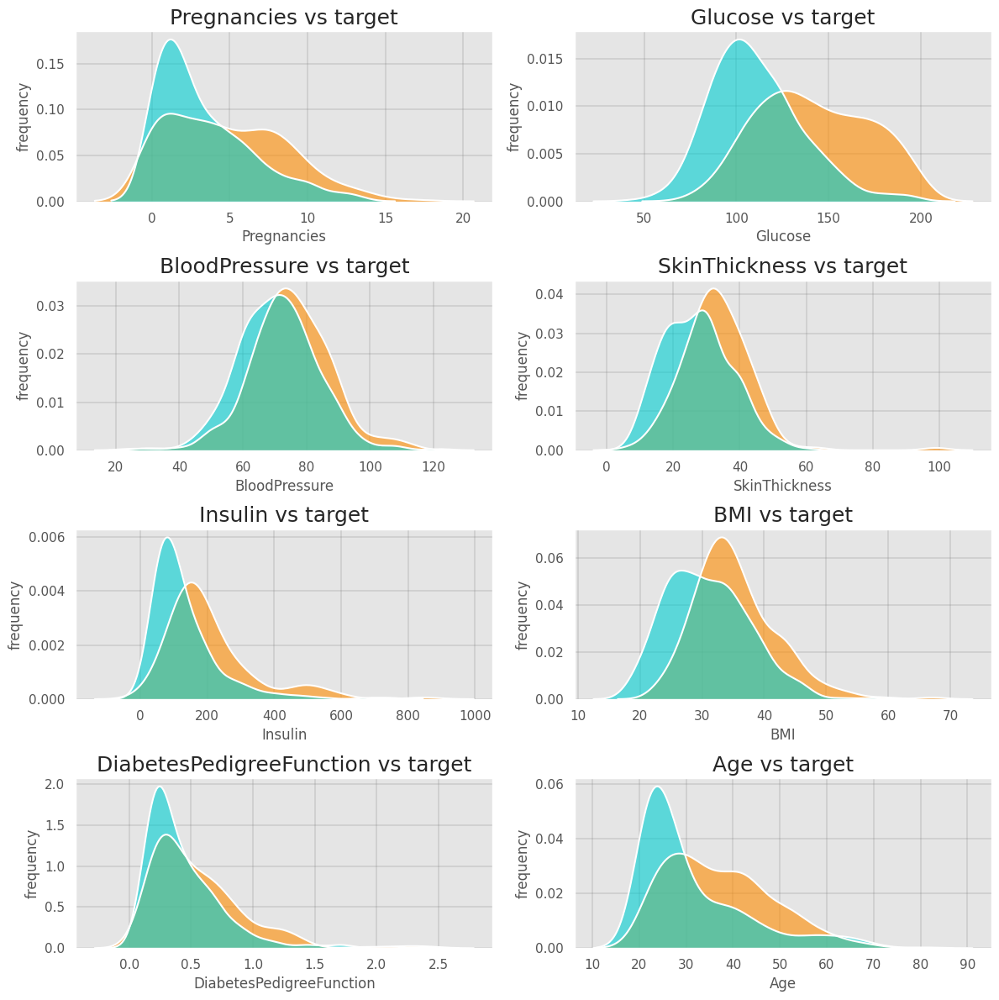

In [ ]:
f,ax=plt.subplots(4,2,figsize=(12,12))
#f.delaxes(ax[2,1])

for i,feature in enumerate(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']):
    sns.distplot(df[df['Outcome']==0][(feature)], ax=ax[i//2,i%2], kde_kws={"color":"white"}, hist=False )
    sns.distplot(df[df['Outcome']==1][(feature)], ax=ax[i//2,i%2], kde_kws={"color":"white"}, hist=False )

    # Get the two lines from the ax[i//2,i%2]es to generate shading
    l1 = ax[i//2,i%2].lines[0]
    l2 = ax[i//2,i%2].lines[1]

    # Get the xy data from the lines so that we can shade
    x1 = l1.get_xydata()[:,0]
    y1 = l1.get_xydata()[:,1]
    x2 = l2.get_xydata()[:,0]
    y2 = l2.get_xydata()[:,1]
    ax[i//2,i%2].fill_between(x2,y2, color="darkorange", alpha=0.6)
    ax[i//2,i%2].fill_between(x1,y1, color="darkturquoise", alpha=0.6)

    #grid
    ax[i//2,i%2].grid(b=True, which='major', color='grey', linewidth=0.3)
    
    ax[i//2,i%2].set_title('{} vs target'.format(feature), fontsize=18)
    ax[i//2,i%2].set_ylabel('count', fontsize=12)
    ax[i//2,i%2].set_xlabel('Modality', fontsize=12)

    #sns.despine(ax[i//2,i%2]=ax[i//2,i%2], left=True)
    ax[i//2,i%2].set_ylabel("frequency", fontsize=12)
    ax[i//2,i%2].set_xlabel(str(feature), fontsize=12)

plt.tight_layout()
plt.show()

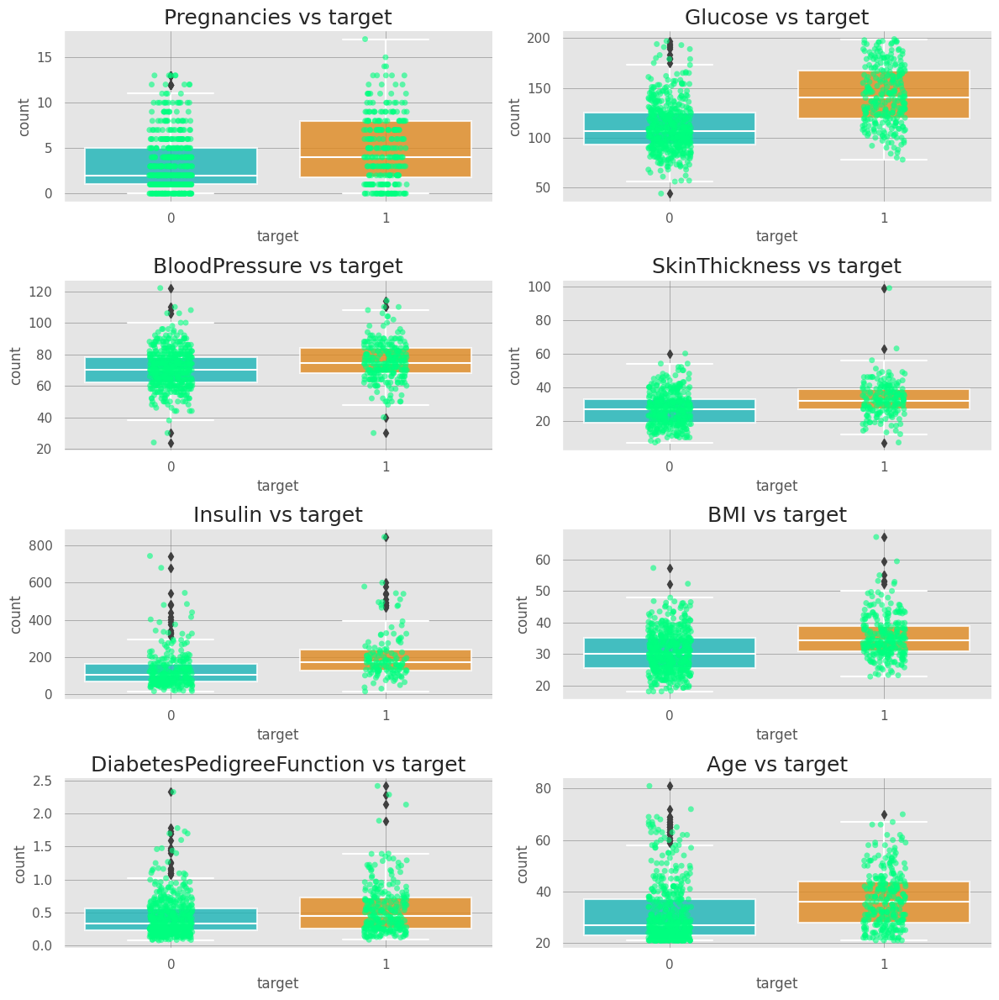

In [ ]:
f,ax=plt.subplots(4,2,figsize=(12,12))
#f.delaxes(ax[2,1])
colors=['darkturquoise','darkorange']
for i,feature in enumerate(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']):
    sns.boxplot(x='Outcome', y=feature, data=df , ax=ax[i//2,i%2], palette=colors, boxprops=dict(alpha=0.8))
    sns.stripplot(y=feature, x='Outcome', 
                          data=df,
                          ax=ax[i//2,i%2],
                          jitter=True, marker='o',
                          alpha=0.6, 
                          color="springgreen")

    ax[i//2,i%2].grid(b=True, which='major', color='grey', linewidth=0.2)
    ax[i//2,i%2].set_title('Count of {}'.format(feature), fontsize=18)
    ax[i//2,i%2].set_ylabel('count', fontsize=12)
    ax[i//2,i%2].set_xlabel('Modality', fontsize=12)
    
    sns.despine()
    ax[i//2,i%2].grid(b=True, which='major', color='grey', linewidth=0.4)

    ax[i//2,i%2].set_title(str(feature)+' '+'vs'+' '+'target', fontsize=18)
    ax[i//2,i%2].set_ylabel("count", fontsize=12)
    ax[i//2,i%2].set_xlabel(('target'), fontsize=12)

    plt.setp(ax[i//2,i%2].artists, edgecolor = 'white')
    plt.setp(ax[i//2,i%2].lines, color='white')

plt.tight_layout()
plt.show()

In [ ]:
def scatterplot(var1,var2,var3,var4):
    f,(ax1,ax2)=plt.subplots(1,2,figsize=(15,5))
    #f.delaxes(ax[2,1])
    
    colors = ['darkturquoise','darkorange']
    ax1 = sns.scatterplot(x = df[var1], y = df[var2], hue = "Outcome",
                        data = df,  ax=ax1, palette=colors, alpha=0.8, edgecolor="white",linewidth=0.1)
    ax1.grid(b=True, which='major', color='lightgrey', linewidth=0.2)
    ax1.set_title(str(var1)+' '+'vs'+' '+str(var2)+' '+'vs target', fontsize=18)
    ax1.set_xlabel(str(var1), fontsize=12)
    ax1.set_ylabel(str(var2), fontsize=12)

    ax2 = sns.scatterplot(x = df[var3], y = df[var4], hue = "Outcome",
                        data = df,  ax=ax2, palette=colors, alpha=0.8, edgecolor="white",linewidth=0.1)
    ax2.grid(b=True, which='major', color='lightgrey', linewidth=0.2)
    ax2.set_title(str(var3)+' '+'vs'+' '+str(var4)+' '+'vs target', fontsize=18)
    ax2.set_xlabel(str(var1), fontsize=12)
    ax2.set_ylabel(str(var2), fontsize=12)

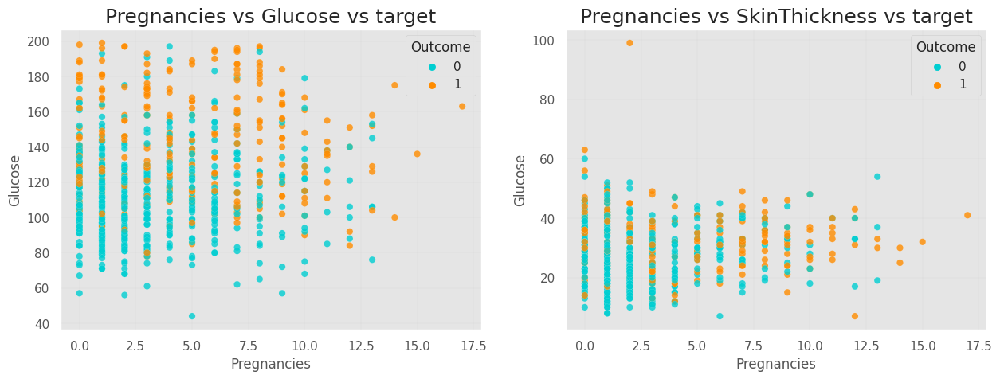

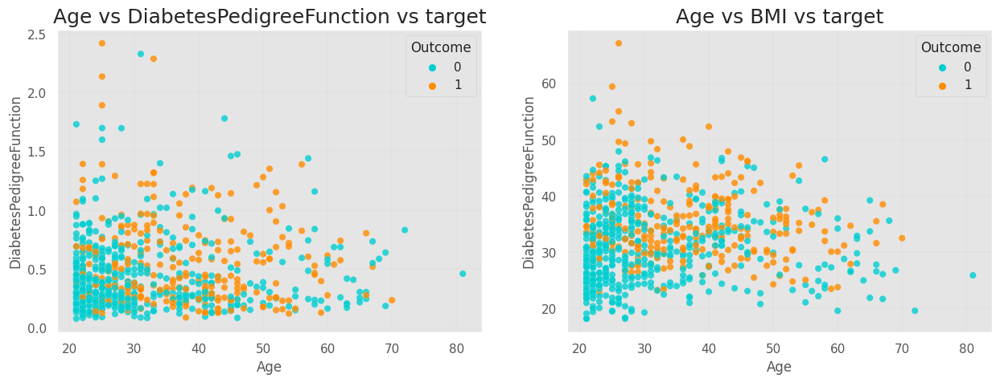

In [ ]:
scatterplot('Pregnancies','Glucose','Pregnancies', 'SkinThickness')
scatterplot('Age','DiabetesPedigreeFunction','Age', 'BMI')

IndexError: ignored

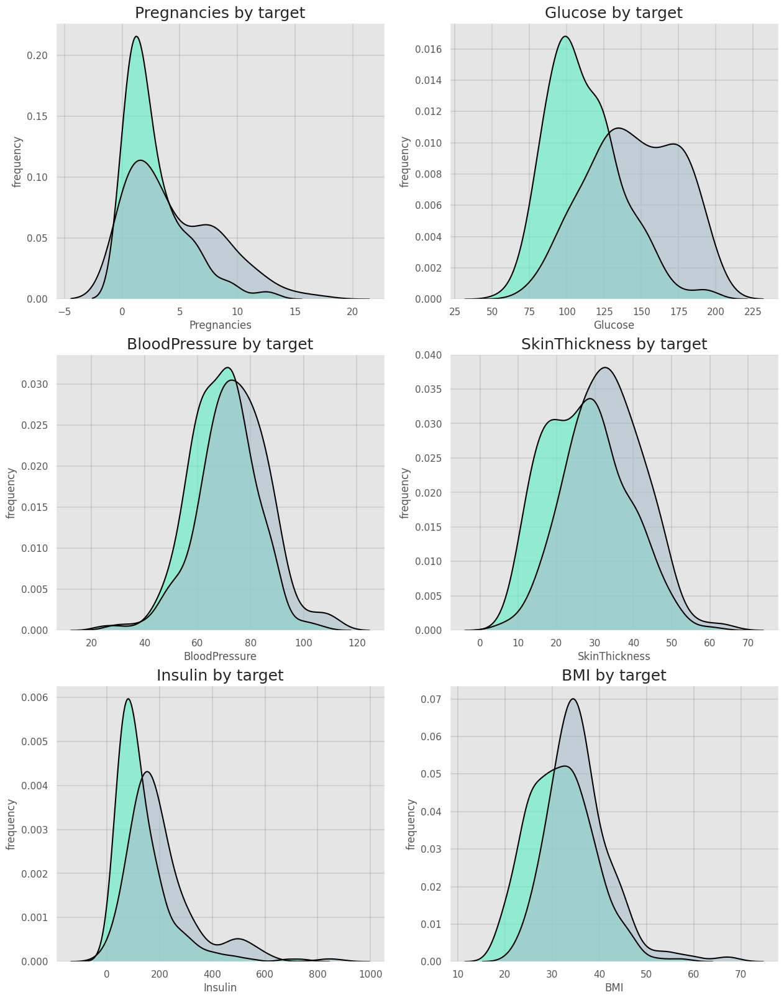

In [ ]:
f,ax=plt.subplots(3,2,figsize=(15,20))
#f.delaxes(ax)
col = list(df)
col = [e for e in col if e not in ('Outcome')]

for i,feature in enumerate(col):
    sns.distplot(df[df['Outcome']==1].dropna()[(feature)], ax=ax[i//2,i%2], kde_kws={"color":"black"}, hist=False )
    sns.distplot(df[df['Outcome']==0].dropna()[(feature)], ax=ax[i//2,i%2], kde_kws={"color":"black"}, hist=False )

    # Get the two lines from the ax[i//2,i%2]es to generate shading
    l1 = ax[i//2,i%2].lines[0]
    l2 = ax[i//2,i%2].lines[1]

    # Get the xy data from the lines so that we can shade
    x1 = l1.get_xydata()[:,0]
    y1 = l1.get_xydata()[:,1]
    x2 = l2.get_xydata()[:,0]
    y2 = l2.get_xydata()[:,1]
    ax[i//2,i%2].fill_between(x2,y2, color="#5CF0C5", alpha=0.6)
    ax[i//2,i%2].fill_between(x1,y1, color="#A9BFCB", alpha=0.6)

    #grid
    ax[i//2,i%2].grid(b=True, which='major', color='grey', linewidth=0.3)
    
    ax[i//2,i%2].set_title('{} by target'.format(feature), fontsize=18)
    ax[i//2,i%2].set_ylabel('count', fontsize=12)
    ax[i//2,i%2].set_xlabel('Modality', fontsize=12)

    #sns.despine(ax[i//2,i%2]=ax[i//2,i%2], left=True)
    ax[i//2,i%2].set_ylabel("frequency", fontsize=12)
    ax[i//2,i%2].set_xlabel(str(feature), fontsize=12)

plt.tight_layout()
plt.show()

In [ ]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

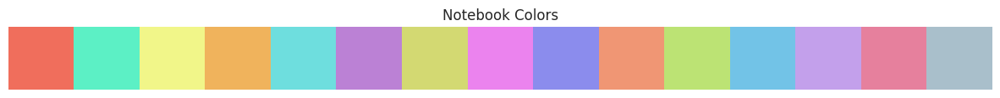

In [ ]:
colors = ['#F06E5C','#5CF0C5','#F1F689','#F0B35C','#6EDEDE',
          '#BB81D5','#D3D972','#EB83EE','#8B8CED','#F09674',
          '#BCE374','#72C3E7','#C3A0EB','#E6809D','#A9BFCB']

sns.palplot(sns.color_palette(colors))
plt.title('Notebook Colors', size = 12)
plt.axis('off')
plt.show()

### Definição das Variáveis

In [ ]:
def grab_col_names(dataframe, cat_th=10, car_th=20):
    
    # cat_cols, cat_but_car
    cat_cols = [col for col in dataframe.columns if dataframe[col].dtypes == "O"]
    num_but_cat = [col for col in dataframe.columns if dataframe[col].nunique() < cat_th and
                   dataframe[col].dtypes != "O"]
    cat_but_car = [col for col in dataframe.columns if dataframe[col].nunique() > car_th and
                   dataframe[col].dtypes == "O"]
    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]

    # num_cols
    num_cols = [col for col in dataframe.columns if dataframe[col].dtypes != "O"]
    num_cols = [col for col in num_cols if col not in num_but_cat]

    print(f"Observations: {dataframe.shape[0]}")
    print(f"Variables: {dataframe.shape[1]}")
    print(f'cat_cols: {len(cat_cols)}')
    print(f'num_cols: {len(num_cols)}')
    print(f'cat_but_car: {len(cat_but_car)}')
    print(f'num_but_cat: {len(num_but_cat)}')
    return cat_cols, num_cols, cat_but_car

cat_cols, num_cols, cat_but_car = grab_col_names(df)

In [ ]:
binary_cols = [col for col in df.columns if df[col].dtype not in [int, float]
               and df[col].nunique() == 2]

In [ ]:
def rare_analyser(dataframe, cat_cols):
    for col in cat_cols:
        print(col, ":", len(dataframe[col].value_counts()))
        print(pd.DataFrame({"COUNT": dataframe[col].value_counts(),
                            "RATIO": dataframe[col].value_counts() / len(dataframe)}), end="\n\n\n")

rare_analyser(df, cat_cols)

In [ ]:
scaler = StandardScaler() #RobustScaler - StandardScaler
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [ ]:
test_size = 0.2
random_state = 42
X_train, X_test, Y_train, Y_test = train_test_split(x,
                                                    y,
                                                    test_size  = test_size,
                                                    random_state = random_state)

### Geométria Descritiva

In [ ]:
def desc_stats(dataframe):
    desc = dataframe.describe().T
    desc_df = pd.DataFrame(index= [col for col in dataframe.columns], 
                           columns= desc.columns,
                           data= desc)
    
    f,ax = plt.subplots(figsize=(10,
                                 desc_df.shape[0]*0.78))
    sns.heatmap(desc_df,
                annot=True,
                cmap = "Reds",
                fmt= '.2f',
                ax=ax,
                linewidths = 2.6,
                cbar = False,
                annot_kws={"size": 14})
    plt.xticks(size = 18)
    plt.yticks(size = 14,
               rotation = 0)
    plt.title("Descriptive Statistics", size = 16)
    plt.show()
    
desc_stats(df[num_cols])

### Correlações

In [ ]:
def pearson_corr(dataframe):
    sns.set_style("white")
    matrix = np.triu(dataframe.corr(method="pearson"))
    f,ax=plt.subplots(figsize = (matrix.shape[0]*0.75,
                                 matrix.shape[1]*0.75))
    sns.heatmap(dataframe.corr(method="pearson"),
                annot= True,
                fmt = ".2f",
                ax=ax,
                vmin = -1,
                vmax = 1,
                mask = matrix,
                cmap = "coolwarm",
                linewidth = 0.4,
                linecolor = "white",
                annot_kws={"size": 12})
    plt.xticks(rotation=80,size=14)
    plt.yticks(rotation=0,size=14)
    plt.title('Pearson Correlation Map', size = 14)
    plt.show()
    
pearson_corr(df)

In [ ]:
def spearman_corr(dataframe):
    sns.set_style("white")
    matrix = np.triu(dataframe.corr(method="spearman"))
    f,ax=plt.subplots(figsize = (matrix.shape[0]*0.75,
                                 matrix.shape[1]*0.75))
    sns.heatmap(dataframe.corr(method = "spearman"),
                annot= True,
                fmt = ".2f",
                ax=ax,
                vmin = -1,
                vmax = 1,
                mask = matrix,
                cmap = "coolwarm",
                linewidth = 0.4,
                linecolor = "white",
                annot_kws={"size": 12})
    plt.xticks(rotation=80,size=14)
    plt.yticks(rotation=0,size=14)
    plt.title('Spearman Rank Correlation Map', size = 14)
    plt.show()
    
spearman_corr(df)

### Missing 

In [ ]:
msno.bar(df)
plt.show()

In [ ]:
msno.matrix(df)
plt.show()

In [ ]:
msno.heatmap(df)
plt.show()

In [ ]:
#Understand the  dataset.
#get the size of dataframe
print ("Rows     : " , df.shape[0])  #get number of rows/observations
print ("Columns  : " , df.shape[1]) #get number of columns
print ("#"*40,"\n","Features : \n\n", df.columns.tolist()) #get name of columns/features
missing_df = pd.DataFrame({
    "Missing": df.isnull().sum(),
    "Missing %": round((df.isnull().sum()/ df.isna().count()*100), 2)
})
display(missing_df.sort_values(by='Missing', ascending=False))

Rows     :  768
Columns  :  9
######################################## 
 Features : 

 ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome']


,Missing,Missing %
Insulin,374,48.70
SkinThickness,227,29.56
BloodPressure,35,4.56
BMI,11,1.43
Glucose,5,0.65
Pregnancies,0,0.00
DiabetesPedigreeFunction,0,0.00
Age,0,0.00
Outcome,0,0.00


In [ ]:
#get the size of dataframe
print ("Rows     : " , df.shape[0])  #get number of rows/observations
print ("Columns  : " , df.shape[1]) #get number of columns
print ("#"*40,"\n","Features : \n\n", df.columns.tolist()) #get name of columns/features
print ("#"*40,"\nMissing values :\n\n", df.isnull().sum().sort_values(ascending=False))
print( "#"*40,"\nPercent of missing :\n\n", round(df.isna().sum() / df.isna().count() * 100, 2).sort_values(ascending=False)) # looking at columns with most Missing Values

Rows     :  768
Columns  :  9
######################################## 
 Features : 

 ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome']
######################################## 
Missing values :

 Insulin                     374
SkinThickness               227
BloodPressure                35
BMI                          11
Glucose                       5
Outcome                       0
Age                           0
DiabetesPedigreeFunction      0
Pregnancies                   0
dtype: int64
######################################## 
Percent of missing :

 Insulin                     48.70
SkinThickness               29.56
BloodPressure                4.56
BMI                          1.43
Glucose                      0.65
Outcome                      0.00
Age                          0.00
DiabetesPedigreeFunction     0.00
Pregnancies                  0.00
dtype: float64


In [ ]:
#get the size of dataframe
print ("Rows     : " , df.shape[0])  #get number of rows/observations
print ("Columns  : " , df.shape[1]) #get number of columns
print ("#"*40,"\n","Features : \n\n", df.columns.tolist()) #get name of columns/features
print ("#"*40,"\nMissing values :\n\n", df.isnull().sum().sort_values(ascending=False))
print( "#"*40,"\nPercent of missing :\n\n", round(df.isna().sum() / df.isna().count() * 100, 2)) # looking at columns with most Missing Values
print ("#"*40,"\nUnique values :  \n\n", df.nunique())  #  count of unique values

Rows     :  768
Columns  :  9
######################################## 
 Features : 

 ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome']
######################################## 
Missing values :

 Insulin                     374
SkinThickness               227
BloodPressure                35
BMI                          11
Glucose                       5
Outcome                       0
Age                           0
DiabetesPedigreeFunction      0
Pregnancies                   0
dtype: int64
######################################## 
Percent of missing :

 Pregnancies                  0.00
Glucose                      0.65
BloodPressure                4.56
SkinThickness               29.56
Insulin                     48.70
BMI                          1.43
DiabetesPedigreeFunction     0.00
Age                          0.00
Outcome                      0.00
dtype: float64
########################################

In [ ]:
#get the size of dataframe
print ("Rows     : " , df.shape[0])  #get number of rows/observations
print ("Columns  : " , df.shape[1]) #get number of columns
print ("#"*40,"\n","Features : \n\n", df.columns.tolist()) #get name of columns/features
print ("#"*40,"\nMissing values :\n\n", df.isnull().sum().sort_values(ascending=False))
print( "#"*40,"\nPercent of missing :\n\n", round(df.isna().sum() / df.isna().count() * 100, 2)) # looking at columns with most Missing Values
print ("#"*40,"\nUnique values :  \n\n", df.nunique())  #  count of unique values

Rows     :  768
Columns  :  9
######################################## 
 Features : 

 ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome']
######################################## 
Missing values :

 Insulin                     374
SkinThickness               227
BloodPressure                35
BMI                          11
Glucose                       5
Outcome                       0
Age                           0
DiabetesPedigreeFunction      0
Pregnancies                   0
dtype: int64
######################################## 
Percent of missing :

 Pregnancies                  0.00
Glucose                      0.65
BloodPressure                4.56
SkinThickness               29.56
Insulin                     48.70
BMI                          1.43
DiabetesPedigreeFunction     0.00
Age                          0.00
Outcome                      0.00
dtype: float64
########################################

In [ ]:
#check shape and missing values  
print("#"*40,"\nTrain")
print(f'There are {df.shape[0]} rows and {df.shape[1]} columns') # fstring 
#display(missing_df.sort_values(by='Missing', ascending=False))
print(f'There are {df.isnull().sum().mean()} missing values')

######################################## 
Train
There are 768 rows and 9 columns
There are 72.44444444444444 missing values


In [265]:
df.describe().T.style.bar(subset=['mean'], color='#FF595E')\
                           .background_gradient(subset=['50%'], cmap='PiYG') # highlight median

,count,mean,std,min,25%,50%,75%,max
Pregnancies,768.000000,3.845052,3.369578,0.000000,1.000000,3.000000,6.000000,17.000000
Glucose,763.000000,121.686763,30.535641,44.000000,99.000000,117.000000,141.000000,199.000000
BloodPressure,733.000000,72.405184,12.382158,24.000000,64.000000,72.000000,80.000000,122.000000
SkinThickness,541.000000,29.153420,10.476982,7.000000,22.000000,29.000000,36.000000,99.000000
Insulin,394.000000,155.548223,118.775855,14.000000,76.250000,125.000000,190.000000,846.000000
BMI,757.000000,32.457464,6.924988,18.200000,27.500000,32.300000,36.600000,67.100000
DiabetesPedigreeFunction,768.000000,0.471876,0.331329,0.078000,0.243750,0.372500,0.626250,2.420000
Age,768.000000,33.240885,11.760232,21.000000,24.000000,29.000000,41.000000,81.000000
Outcome,768.000000,0.348958,0.476951,0.000000,0.000000,0.000000,1.000000,1.000000


In [266]:
df.describe().T.style.bar(subset=['mean'], color='#205ff2')\
                            .background_gradient(subset=['std'], cmap='viridis')\
                             .background_gradient(subset=['50%'], cmap='mako')

,count,mean,std,min,25%,50%,75%,max
Pregnancies,768.000000,3.845052,3.369578,0.000000,1.000000,3.000000,6.000000,17.000000
Glucose,763.000000,121.686763,30.535641,44.000000,99.000000,117.000000,141.000000,199.000000
BloodPressure,733.000000,72.405184,12.382158,24.000000,64.000000,72.000000,80.000000,122.000000
SkinThickness,541.000000,29.153420,10.476982,7.000000,22.000000,29.000000,36.000000,99.000000
Insulin,394.000000,155.548223,118.775855,14.000000,76.250000,125.000000,190.000000,846.000000
BMI,757.000000,32.457464,6.924988,18.200000,27.500000,32.300000,36.600000,67.100000
DiabetesPedigreeFunction,768.000000,0.471876,0.331329,0.078000,0.243750,0.372500,0.626250,2.420000
Age,768.000000,33.240885,11.760232,21.000000,24.000000,29.000000,41.000000,81.000000
Outcome,768.000000,0.348958,0.476951,0.000000,0.000000,0.000000,1.000000,1.000000


ValueError: ignored

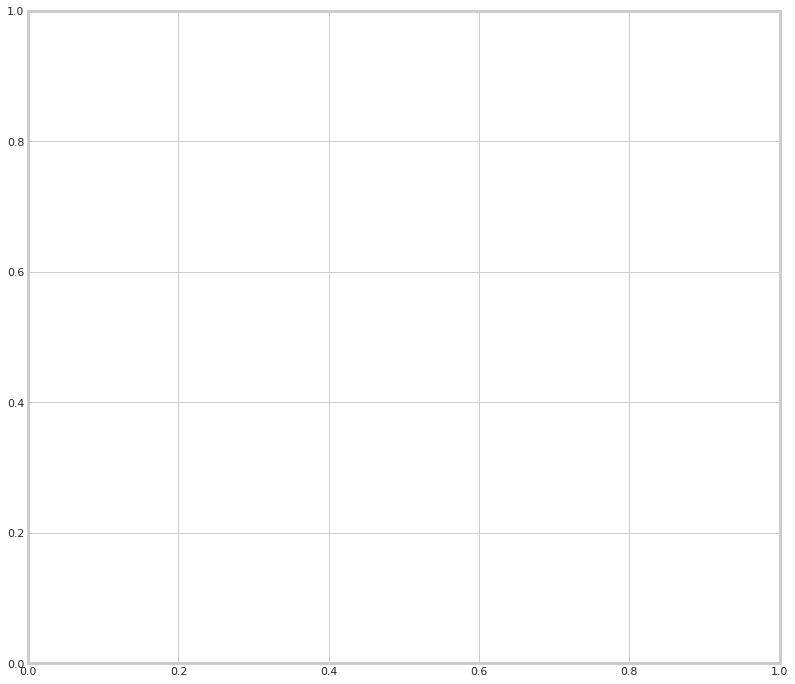

In [267]:
desc = df.describe().T
df1 = pd.DataFrame(index=[], 
                   columns= ["count","mean","std","min",
                             "25%","50%","75%","max"], data= desc )

f,ax = plt.subplots(figsize=(12,12))

sns.heatmap(df1, annot=True,cmap = "Blues", fmt= '.0f',
            ax=ax,linewidths = 5, cbar = False,
            annot_kws={"size": 16})

plt.xticks(size = 18)
plt.yticks(size = 12, rotation = 0)
plt.ylabel("Variables")
plt.title("Descriptive Statistics", size = 16)
plt.show()

In [268]:
for col in cat_cols:
    print(f"Feature: {col}")
    print("-"*40)
    display(pd.DataFrame({"Counts": df[col].value_counts(dropna=False)}).sort_values(by='Counts', ascending=False))

NameError: ignored

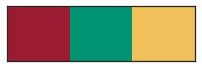

In [271]:
sns.palplot(['#9b1b30', '#009473', '#f0c05a'])

In [274]:
def dist_box(data):
 # function plots a combined graph for univariate analysis of continous variable 
 #to check spread, central tendency , dispersion and outliers  
    Name=data.name.upper()
    fig,(ax_box,ax_dis)  =plt.subplots(nrows=2,sharex=True,gridspec_kw = {"height_ratios": (.25, .75)},figsize=(8, 5))
    mean=data.mean()
    median=data.median()
    mode=data.mode().tolist()[0]
    sns.set_theme(style="white")
    fig.suptitle("SPREAD OF DATA FOR "+ Name  , fontsize=18, fontweight='bold')
    sns.boxplot(x=data,showmeans=True, orient='h',color="#f0c05a",ax=ax_box)
    ax_box.set(xlabel='')
     # just trying to make visualisation better. This will set background to white
    sns.despine(top=True,right=True,left=True) # to remove side line from graph
    sns.distplot(data,kde=False,color='#9b1b30',ax=ax_dis)
    ax_dis.axvline(mean, color='r', linestyle='--',linewidth=2)
    ax_dis.axvline(median, color='g', linestyle='-',linewidth=2)
    plt.legend({'Mean':mean,'Median':median})

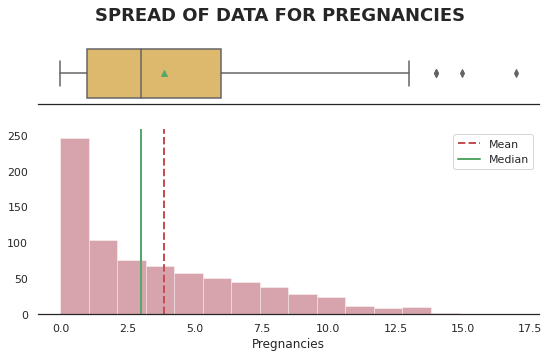

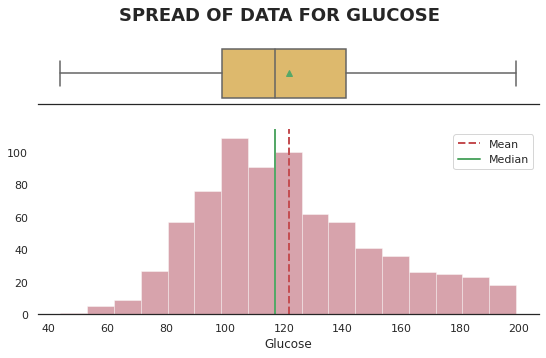

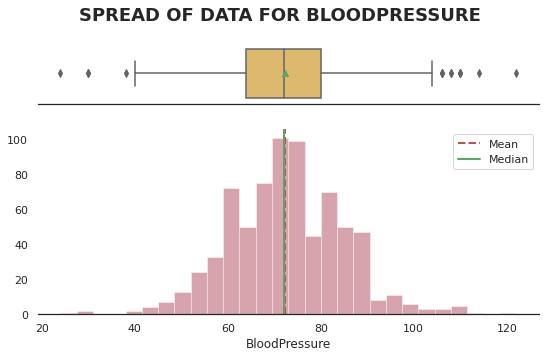

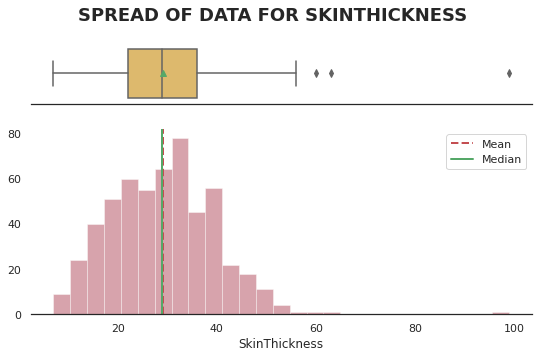

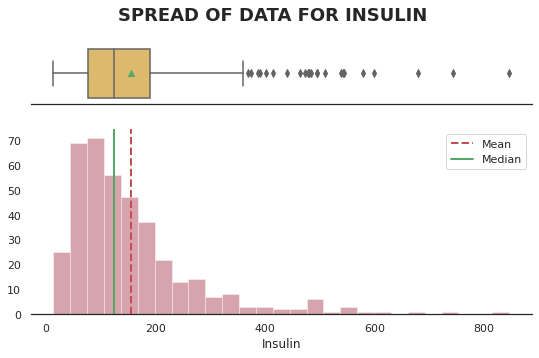

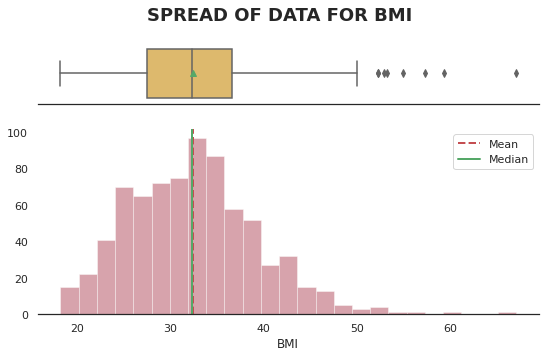

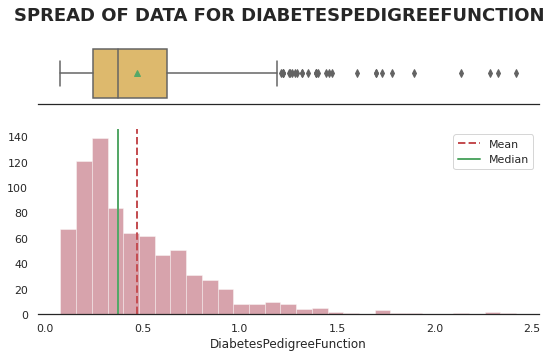

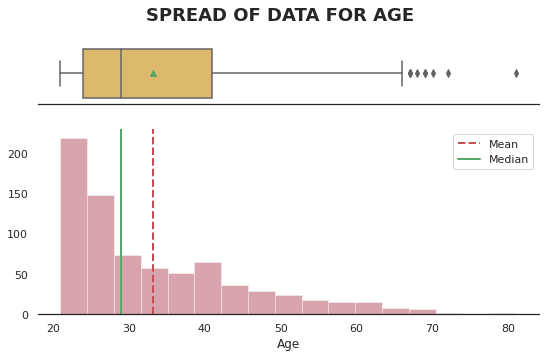

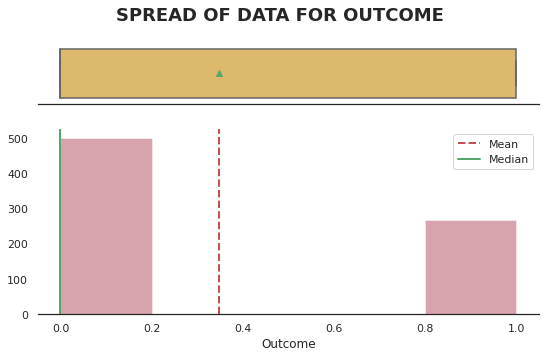

In [275]:
#select all quantitative columns for checking the spread
list_col=  df.select_dtypes(include='number').columns.to_list()
for i in range(len(list_col)):
    dist_box(df[list_col[i]])

In [ ]:
def dist_box(data):
 # function plots a combined graph for univariate analysis of continous variable 
 #to check spread, central tendency , dispersion and outliers  
    Name=data.name.upper()
    fig,(ax_box,ax_dis)  =plt.subplots(nrows=2,sharex=True,gridspec_kw = {"height_ratios": (.25, .75)},figsize=(8, 5))
    mean=data.mean()
    median=data.median()
    mode=data.mode().tolist()[0]
    sns.set_theme(style="white")
    fig.suptitle("SPREAD OF DATA FOR "+ Name  , fontsize=18, fontweight='bold')
    sns.boxplot(x=data,showmeans=True, orient='h',color="violet",ax=ax_box)
    ax_box.set(xlabel='')
     # just trying to make visualisation better. This will set background to white
    sns.despine(top=True,right=True,left=True) # to remove side line from graph
    sns.distplot(data,kde=False,color='blue',ax=ax_dis)
    ax_dis.axvline(mean, color='r', linestyle='--',linewidth=2)
    ax_dis.axvline(median, color='g', linestyle='-',linewidth=2)
    ax_dis.axvline(mode, color='y', linestyle='-',linewidth=2)
    plt.legend({'Mean':mean,'Median':median,'Mode':mode})

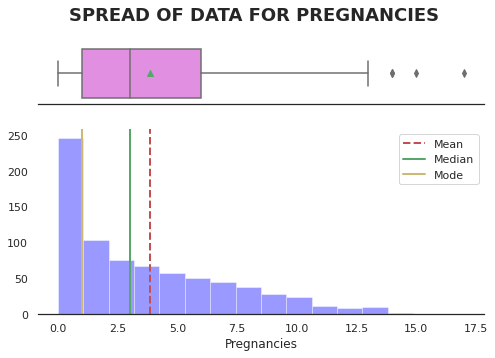

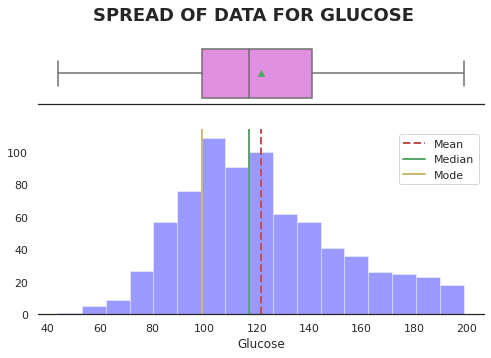

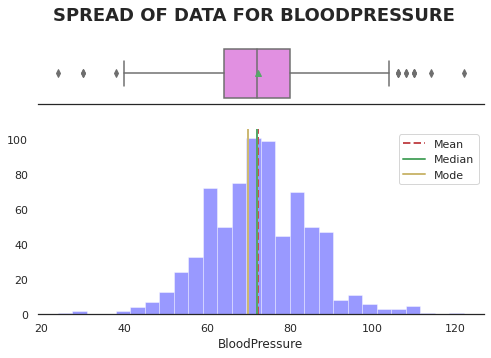

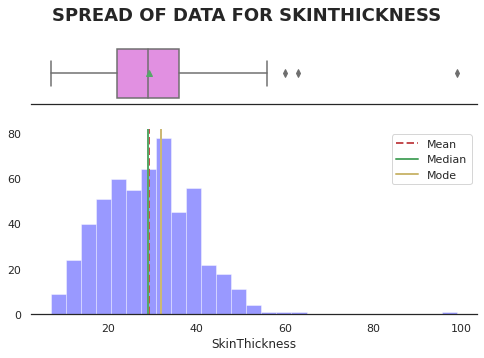

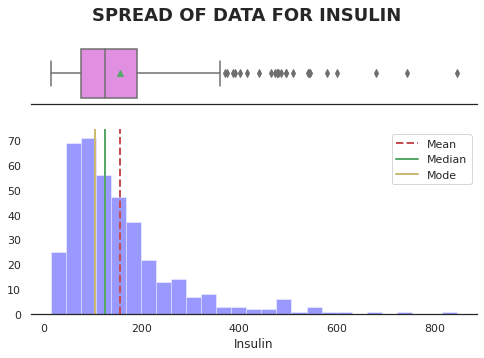

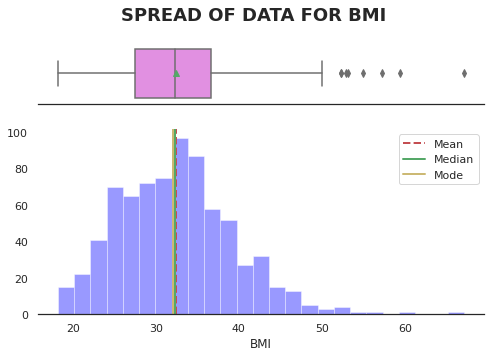

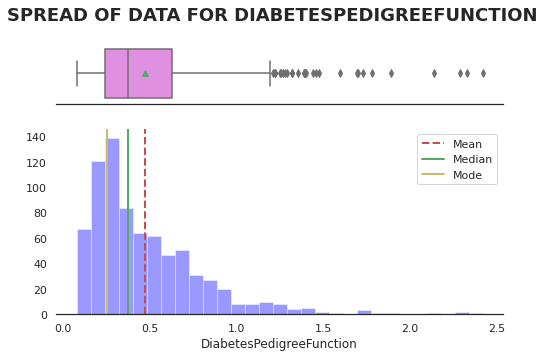

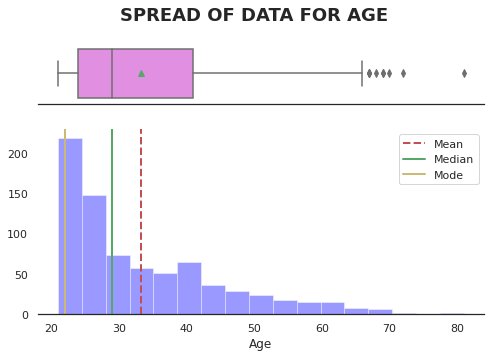

In [ ]:
#select all quantitative columns for checking the spread
list_col=  ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']
for i in range(len(list_col)):
    dist_box(df[list_col[i]])

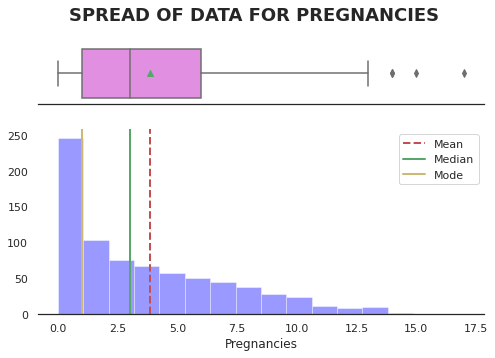

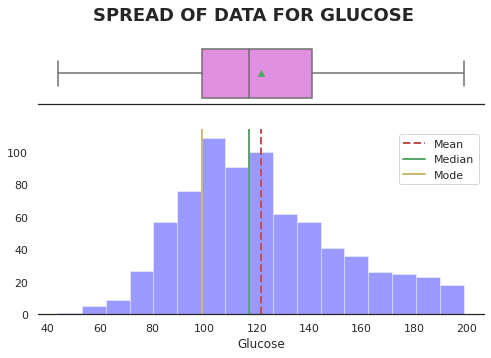

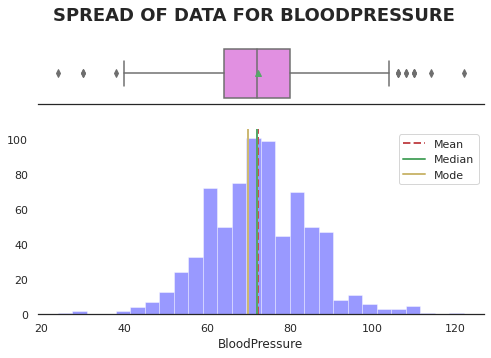

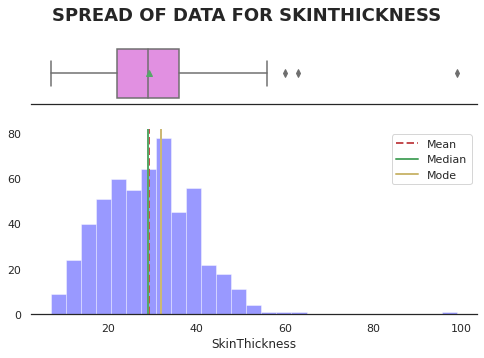

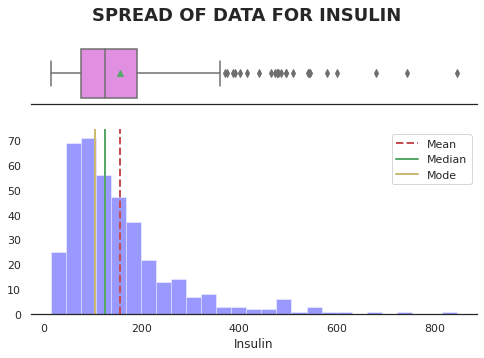

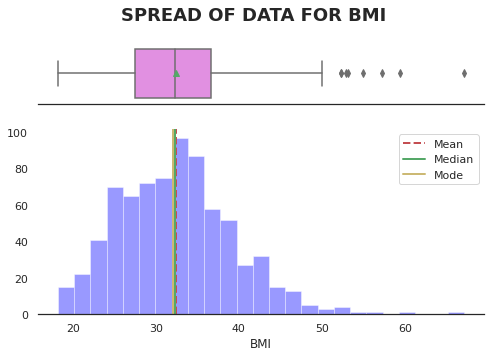

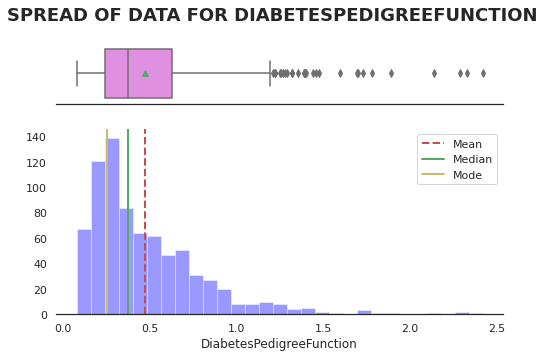

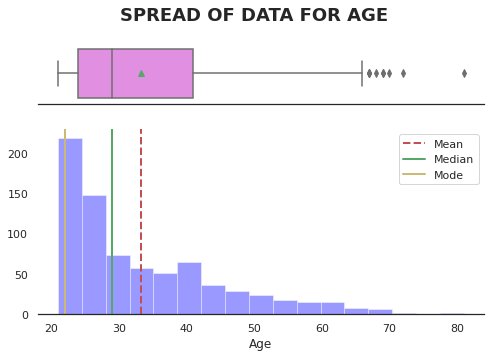

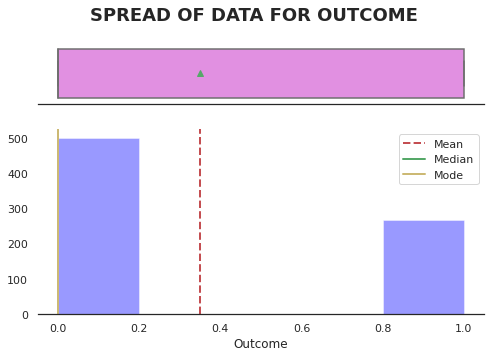

In [ ]:
#select all quantitative columns for checking the spread
list_col=  df.select_dtypes([np.number]).columns
for i in range(len(list_col)):
    dist_box(df[list_col[i]])

In [ ]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

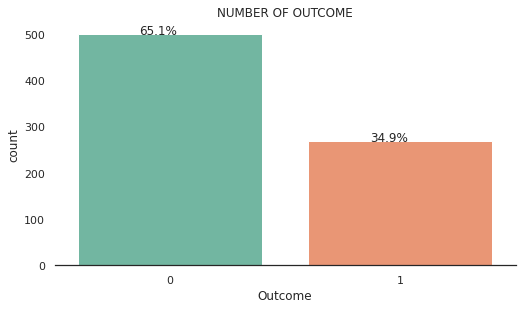

In [ ]:
# Making a list of all categorical variables
cat_columns = ['Outcome']
title=['Number of Outcome']
plt.figure(figsize=(14,20))

sns.set_theme(style="white") # just trying to make visualisation better. This will set background to white
#list_palette=['Blues_r','Greens_r','Purples_r','Reds_r','Blues_r','Greens_r','Purples_r','Reds_r','Blues_r']

for i, variable in enumerate(cat_columns):
                     plt.subplot(5,2,i+1)
                     order = df[variable].value_counts(ascending=False).index   
                     #sns.set_palette(list_palette[i]) # to set the palette
                     sns.set_palette('Set2')
                     ax=sns.countplot(x=df[variable], data=df )
                     sns.despine(top=True,right=True,left=True) # to remove side line from graph
                     for p in ax.patches:
                           percentage = '{:.1f}%'.format(100 * p.get_height()/len(df[variable]))
                           x = p.get_x() + p.get_width() / 2 - 0.05
                           y = p.get_y() + p.get_height()
                           plt.annotate(percentage, (x, y),ha='center')
                     plt.tight_layout()
                     plt.title(title[i].upper())

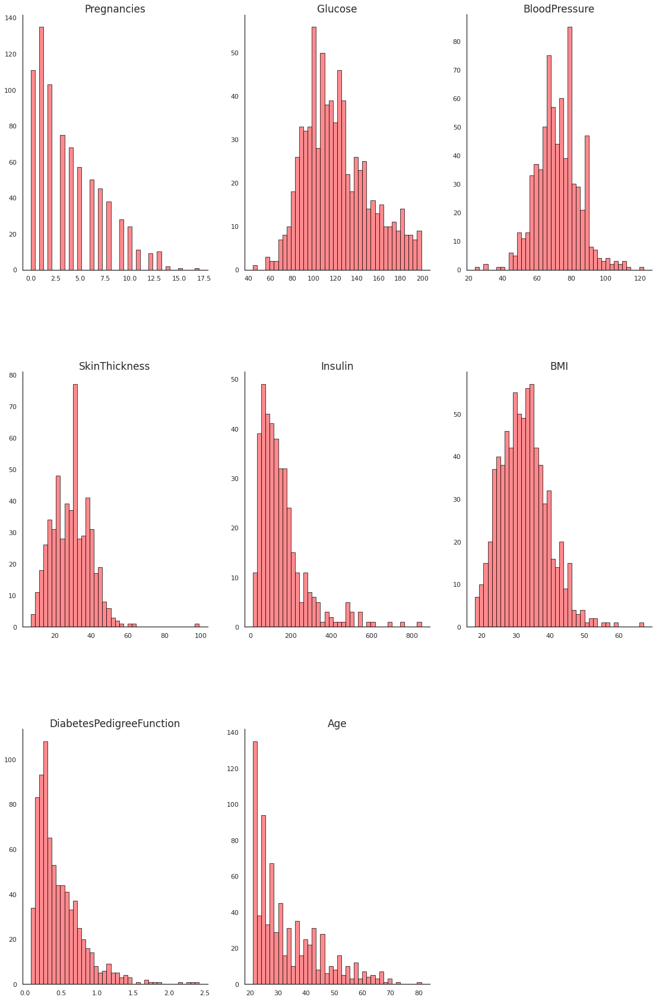

In [ ]:
cols = 3
rows = len(num_cols) // cols+1
fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(19,30), sharex=False) #subplot with all rows
plt.subplots_adjust(hspace = 0.4)
i=0

for r in np.arange(0, rows, 1):
    for c in np.arange(0, cols, 1):
        if i >= len(num_cols):
            axs[r, c].set_visible(False)
        else:
            axs[r,c].hist(df[num_cols[i]].values,
                                   color="#FF595E",
                                   edgecolor="black",
                                   alpha=0.7,
                                   label="Train Dataset",bins=40)
            axs[r, c].set_title(num_cols[i], fontsize=17, pad=4)
            axs[r, c].tick_params(axis="y", labelsize=11)
            axs[r, c].tick_params(axis="x", labelsize=11)
            axs[r,c].spines['right'].set_visible(False)
            axs[r,c].spines['top'].set_visible(False)

        i+=1

plt.show();

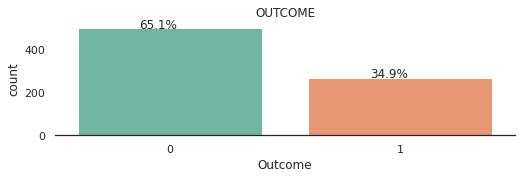

In [ ]:
 #Making a list of all categorical variables

plt.figure(figsize=(14,20))

sns.set_theme(style="white")
for i, variable in enumerate(cat_cols):
                     plt.subplot(9,2,i+1)
                     order = df[variable].value_counts(ascending=False).index   
                     #sns.set_palette(list_palette[i]) # to set the palette
                     sns.set_palette('Set2')
                     ax=sns.countplot(x=df[variable], data=df )
                     sns.despine(top=True,right=True,left=True) # to remove side line from graph
                     for p in ax.patches:
                           percentage = '{:.1f}%'.format(100 * p.get_height()/len(df[variable]))
                           x = p.get_x() + p.get_width() / 2 - 0.05
                           y = p.get_y() + p.get_height()
                           plt.annotate(percentage, (x, y),ha='center')
                     plt.tight_layout()
                     plt.title(cat_cols[i].upper())

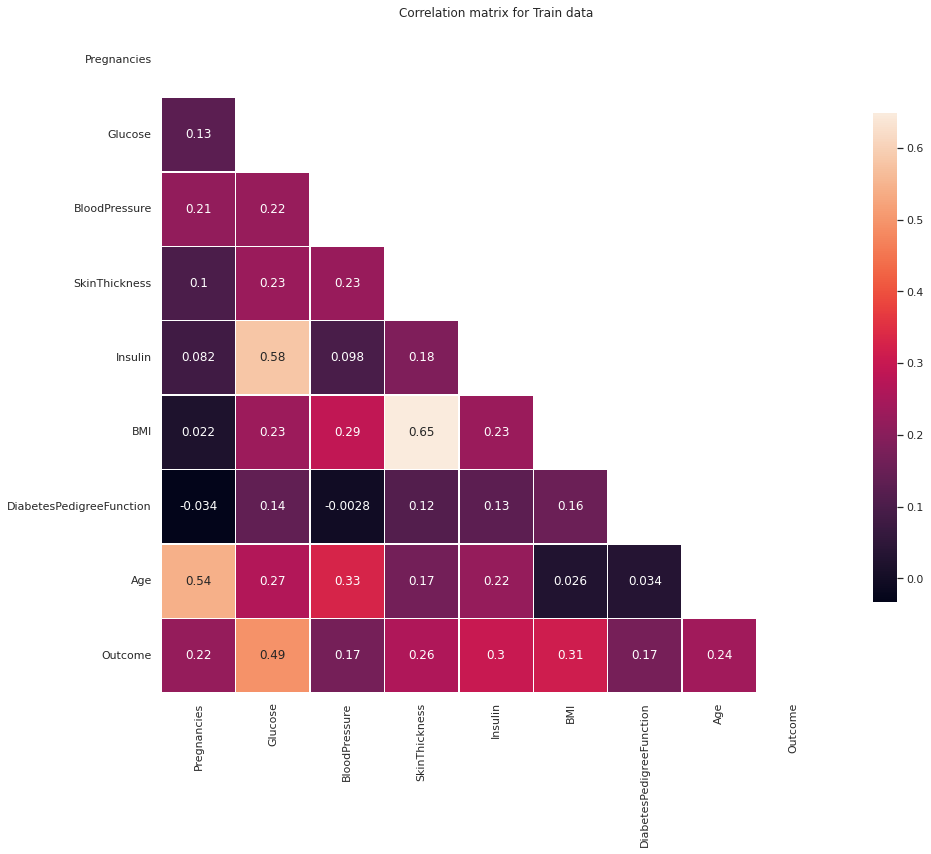

In [ ]:
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype = bool))

plt.figure(figsize = (15, 15))
plt.title('Correlation matrix for Train data')
sns.heatmap(corr, mask = mask,annot=True,  linewidths = .5,square=True,cbar_kws={"shrink": .60})
plt.show()

In [ ]:
#check correlation with target varaiable
loss_corr=corr['Outcome'].sort_values(ascending=False).head(10).to_frame()

cm = sns.light_palette("pink", as_cmap=True)

loss = loss_corr.style.background_gradient(cmap=cm)
loss

,Outcome
Outcome,1.000000
Glucose,0.494650
BMI,0.313680
Insulin,0.303454
SkinThickness,0.259491
Age,0.238356
Pregnancies,0.221898
DiabetesPedigreeFunction,0.173844
BloodPressure,0.170589


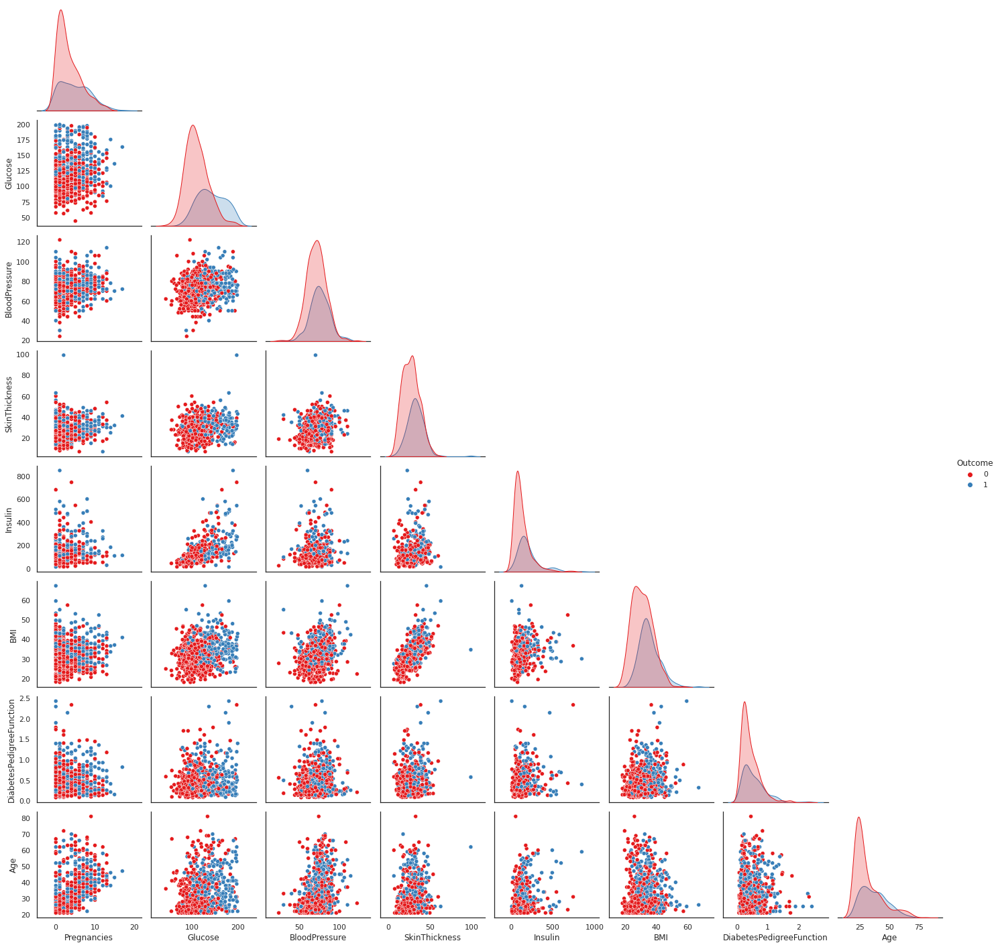

In [ ]:
sns.set_palette(sns.color_palette("Set1", 8))
sns.pairplot(df, hue="Outcome",corner=True)
plt.show()

In [ ]:
## Function to plot stacked bar chart
def stacked_plot(x):
    sns.set_palette(sns.color_palette("tab20", 8))
    tab1 = pd.crosstab(x,df['Outcome'],margins=True)
    display(tab1)
    tab = pd.crosstab(x,df['Outcome'],normalize='index')
    tab.plot(kind='bar',stacked=True,figsize=(9,5))
    plt.xticks(rotation=360)
    #labels=["No","Yes"]
    plt.legend(loc='lower left', frameon=False,)
    plt.legend(loc="upper left",title=" ",bbox_to_anchor=(1,1))
    sns.despine(top=True,right=True,left=True) # to remove side line from graph
    #plt.legend(labels)
    plt.show()

Outcome,0,1,All
Outcome,,,
0,500,0,500
1,0,268,268
All,500,268,768


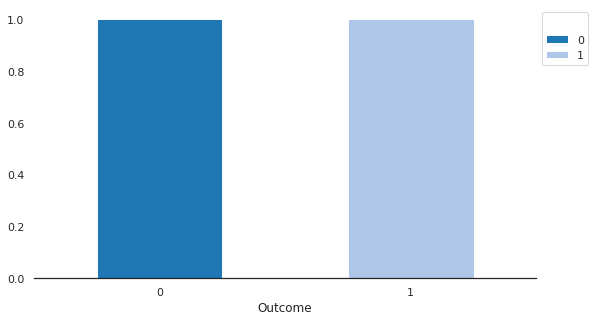

KeyError: ignored

In [ ]:
cat_cols.append("cat_cols")
for i, variable in enumerate(cat_cols):
       stacked_plot(df[variable])

In [ ]:
Q1 = df.quantile(0.25)             #To find the 25th percentile and 75th percentile.
Q3 = df.quantile(0.75)

IQR = Q3 - Q1                      #Inter Quantile Range (75th perentile - 25th percentile)

lower=Q1-1.5*IQR                   #Finding lower and upper bounds for all values. All values outside these bounds are outliers
upper=Q3+1.5*IQR

In [ ]:
((df.select_dtypes(include=['float64','int64'])<lower) | (df.select_dtypes(include=['float64','int64'])>upper)).sum()/len(df)*100

Pregnancies                 0.520833
Glucose                     0.000000
BloodPressure               1.822917
SkinThickness               0.390625
Insulin                     3.125000
BMI                         1.041667
DiabetesPedigreeFunction    3.776042
Age                         1.171875
Outcome                     0.000000
dtype: float64

In [ ]:
df[df['DiabetesPedigreeFunction'] > upper.DiabetesPedigreeFunction].sort_values(by='DiabetesPedigreeFunction',ascending=False ).head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
445,0,180.0,78.0,63.0,14.0,59.4,2.420,25,1
228,4,197.0,70.0,39.0,744.0,36.7,2.329,31,0
4,0,137.0,40.0,35.0,168.0,43.1,2.288,33,1
370,3,173.0,82.0,48.0,465.0,38.4,2.137,25,1
45,0,180.0,66.0,39.0,NaN,42.0,1.893,25,1


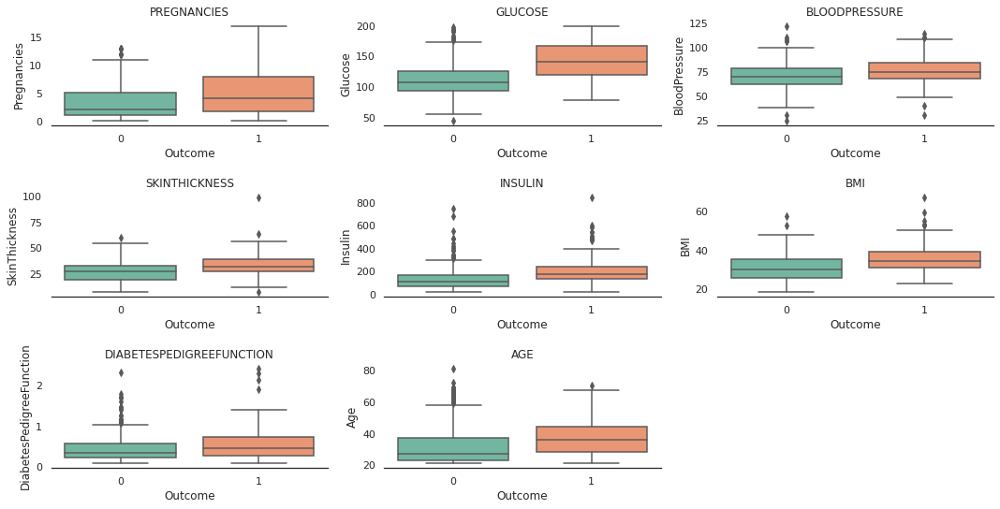

In [ ]:
numeric_columns = ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']
plt.figure(figsize=(15,25))

sns.set_palette(sns.color_palette("Set2", 8))
for i, variable in enumerate(numeric_columns):
        plt.subplot(10,3,i+1)
        
        sns.boxplot(x='Outcome',y= df[variable], data=df)     
        sns.despine(top=True,right=True,left=True) # to remove side line from graph
        plt.tight_layout()
        plt.title(variable.upper())

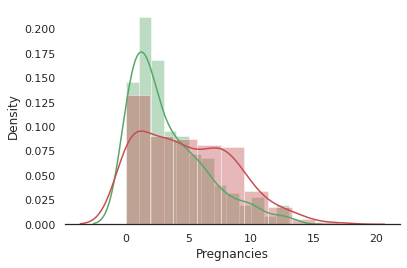

In [ ]:
sns.distplot( df[df['Outcome'] == 0]['Pregnancies'], color = 'g')
sns.distplot( df[df['Outcome'] == 1]['Pregnancies'], color = 'r')
sns.despine(top=True,right=True,left=True) # to remove side line from graph

In [ ]:
## Function to plot stacked bar chart
def stacked_plot(x):
    sns.set_palette(sns.color_palette("Set2", 8))
    tab1 = pd.crosstab(x,df['Outcome'],margins=True)
    print(tab1)
    print('-'*120)
    tab = pd.crosstab(x,df['Outcome'],normalize='index')
    tab.plot(kind='bar',stacked=True,figsize=(7,4))
    plt.xticks(rotation=360)
    labels=["No","Yes"]
    plt.legend(loc='lower left', frameon=False,)
    plt.legend(loc="upper left", labels=labels,title="Borrowed Loan",bbox_to_anchor=(1,1))
    sns.despine(top=True,right=True,left=True) # to remove side line from graph
    #plt.legend(labels)
    plt.show()

Outcome        0    1  All
Pregnancies               
0             73   38  111
1            106   29  135
2             84   19  103
3             48   27   75
4             45   23   68
5             36   21   57
6             34   16   50
7             20   25   45
8             16   22   38
9             10   18   28
10            14   10   24
11             4    7   11
12             5    4    9
13             5    5   10
14             0    2    2
15             0    1    1
17             0    1    1
All          500  268  768
------------------------------------------------------------------------------------------------------------------------


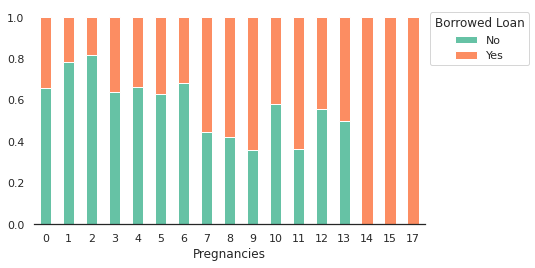

In [ ]:
cat_columns=['Pregnancies']
for i, variable in enumerate(cat_columns):
       stacked_plot(df[variable])

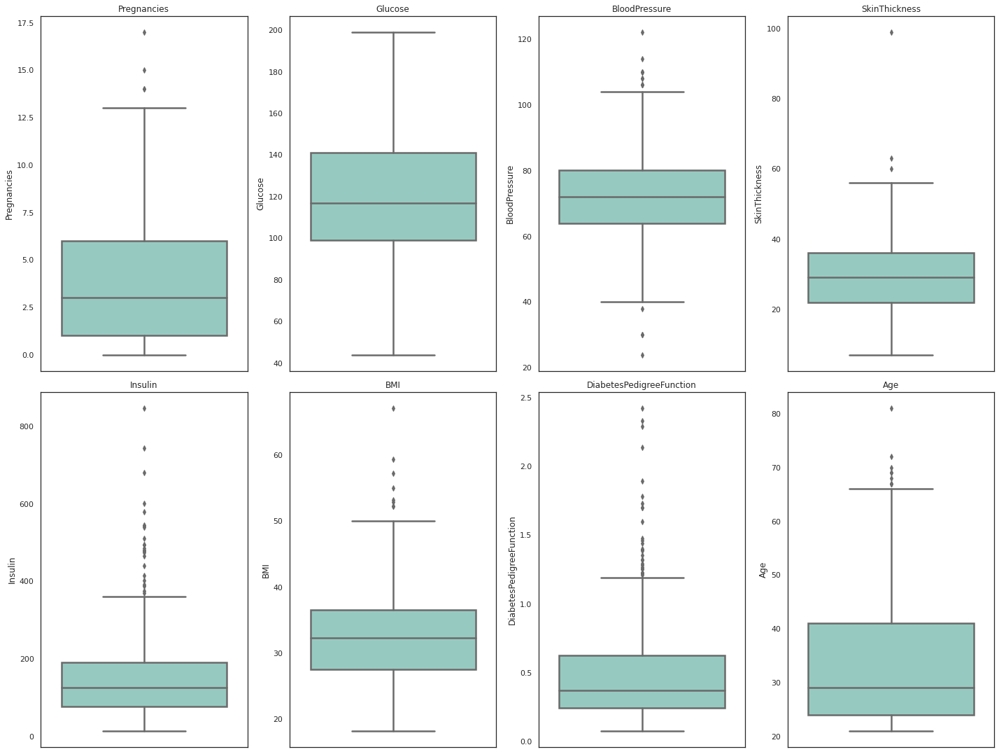

In [ ]:
numeric_columns =['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']
# outlier detection using boxplot
plt.figure(figsize=(20,30))

for i, variable in enumerate(numeric_columns):
                     plt.subplot(4,4,i+1)
                     #plt.boxplot(df[variable],whis=1.5)
                     sns.boxplot(y= df[variable], data=df, palette="Set3", linewidth=2.5)
                     plt.tight_layout()
                     plt.title(variable)

plt.show()

In [ ]:
### Function to plot distributions and Boxplots of customers
def plot(x,target='Outcome'):
    fig,axs = plt.subplots(2,2,figsize=(12,10))
    axs[0, 0].set_title(f'Distribution of {x} \n of a customer who had Not taken Product',fontsize=12,fontweight='bold')
    sns.distplot(df[(df[target] == 0)][x],ax=axs[0,0],color='teal')
    axs[0, 1].set_title(f"Distribution of {x}\n of a customer who had taken Product",fontsize=12,fontweight='bold')
    sns.distplot(df[(df[target] == 1)][x],ax=axs[0,1],color='orange')
    axs[1,0].set_title(f'Boxplot of {x} w.r.t Product taken',fontsize=12,fontweight='bold')
    
    line = plt.Line2D((.1,.9),(.5,.5), color='grey', linewidth=1.5,linestyle='--')
    fig.add_artist(line)
   
    sns.boxplot(df[target],df[x],ax=axs[1,0],palette='gist_rainbow',showmeans=True)
    axs[1,1].set_title(f'Boxplot of {x} w.r.t Product Taken - Without outliers',fontsize=12,fontweight='bold')
    sns.boxplot(df[target],df[x],ax=axs[1,1],showfliers=False,palette='gist_rainbow',showmeans=True) #turning off outliers from boxplot
    sns.despine(top=True,right=True,left=True) # to remove side line from graph
    plt.tight_layout(pad=4)
    plt.show()

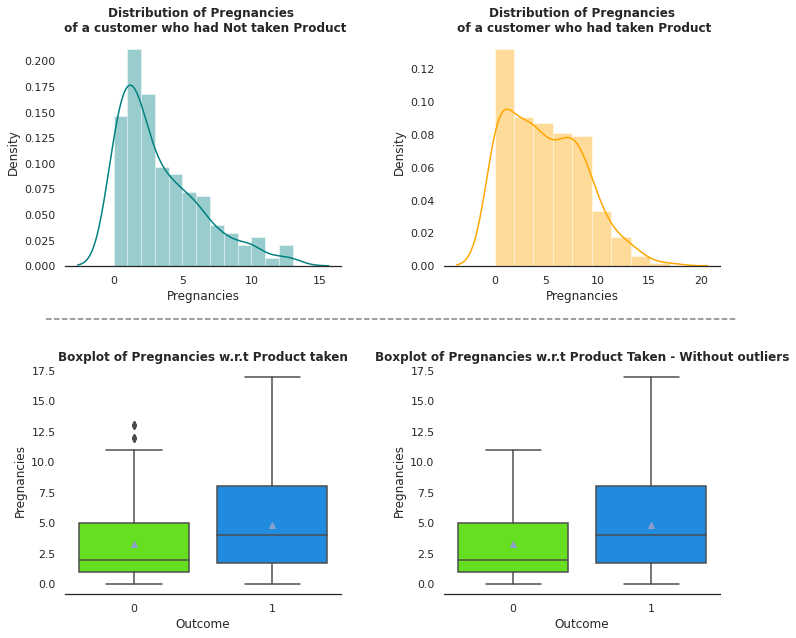

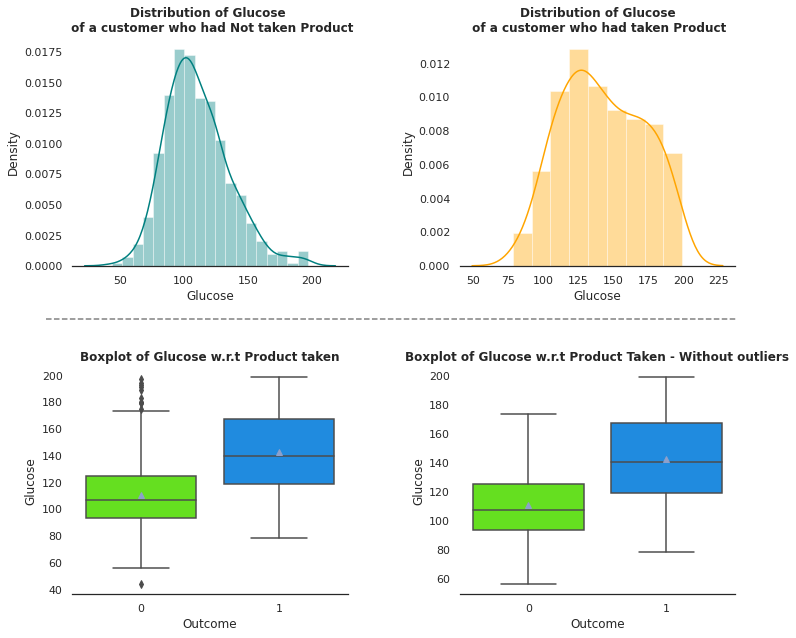

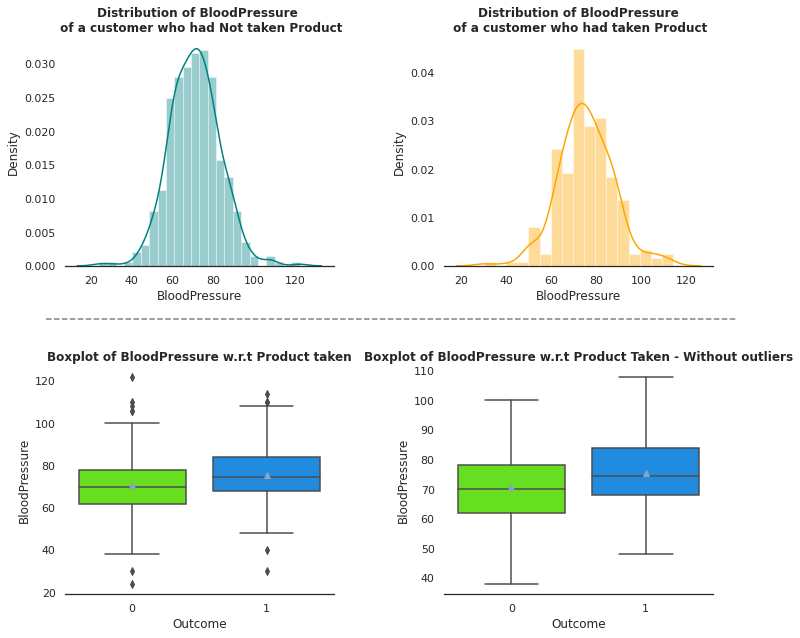

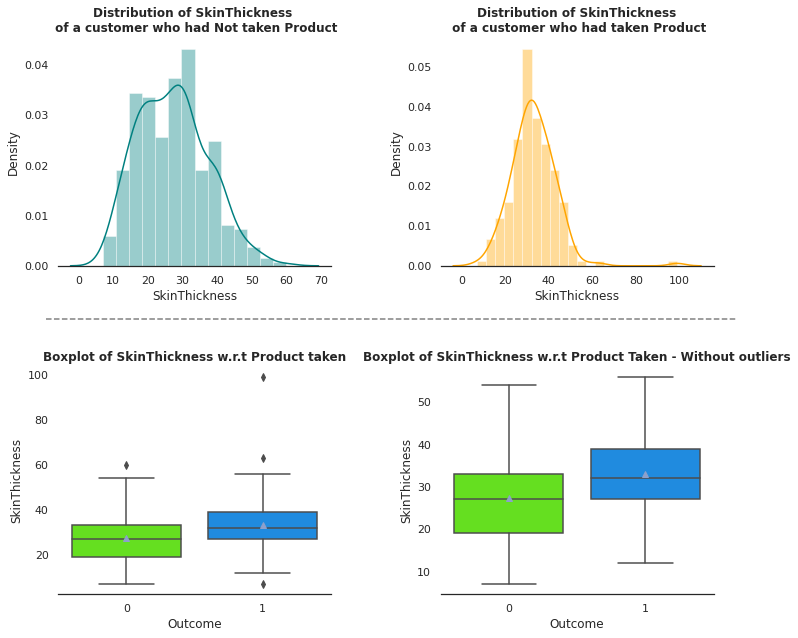

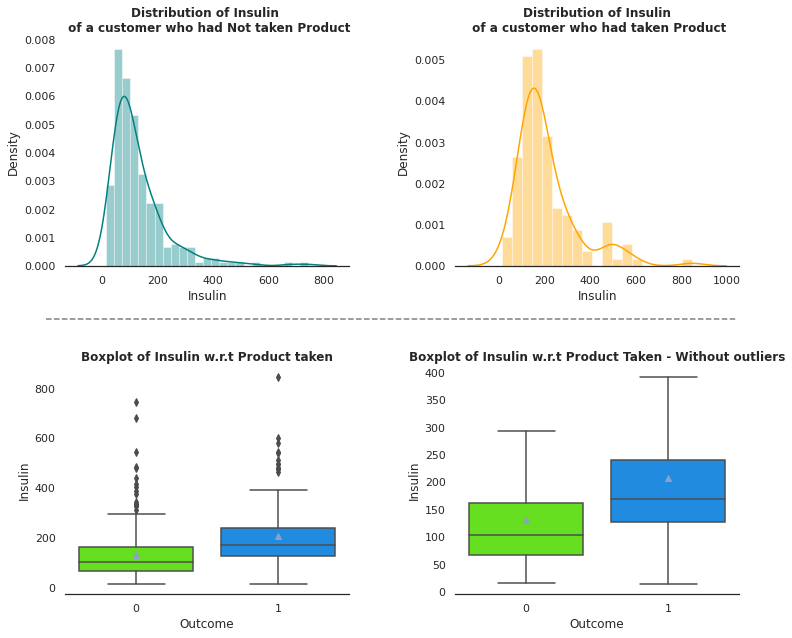

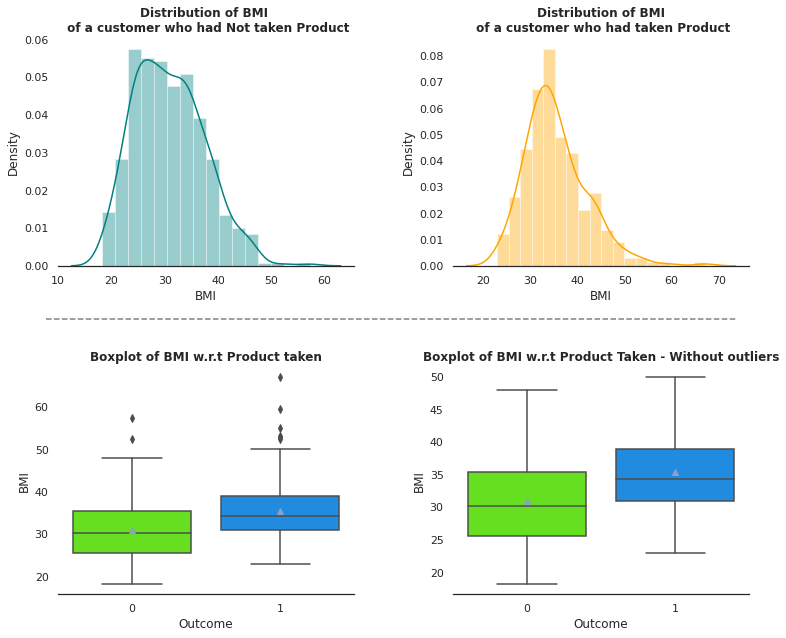

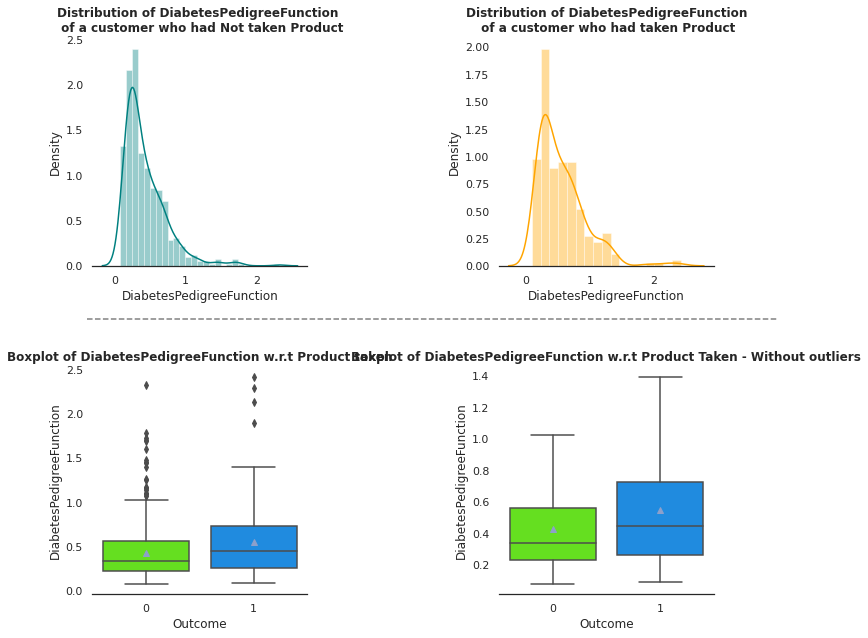

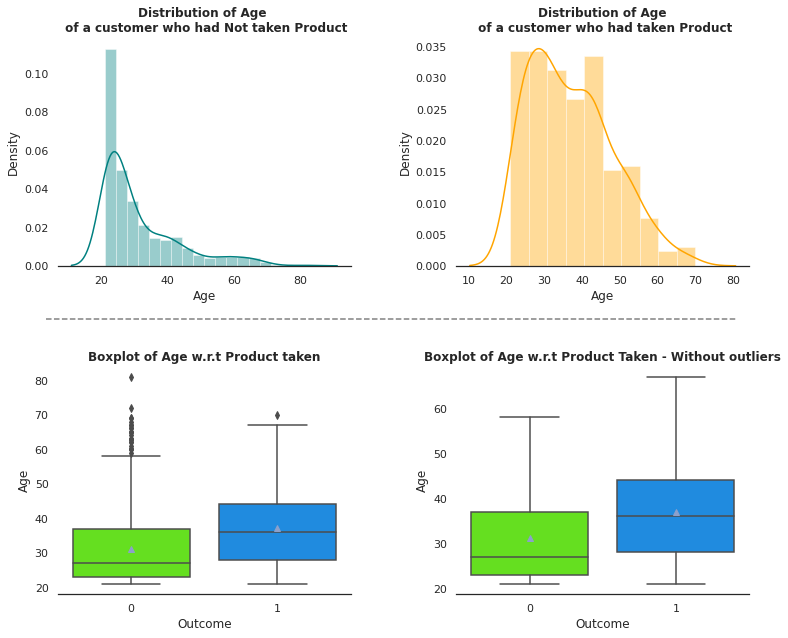

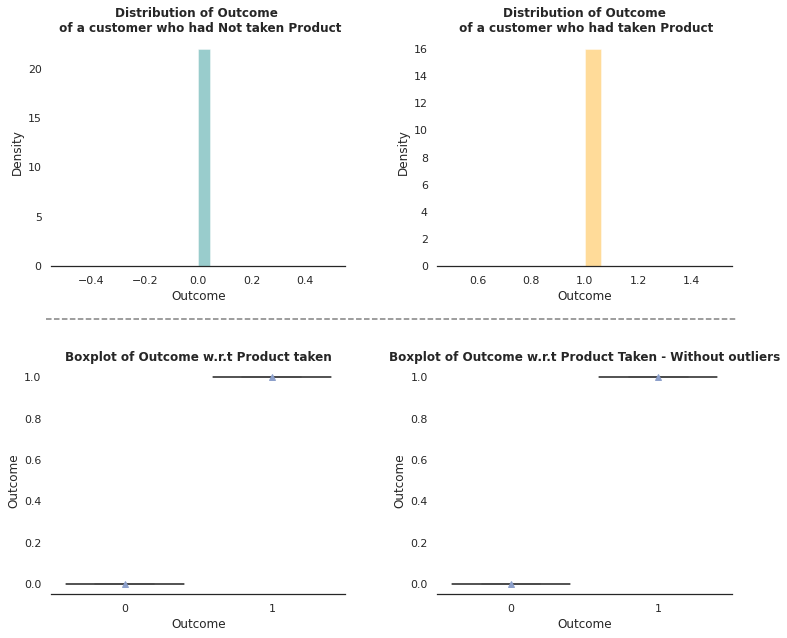

In [ ]:
#select all quantitative columns for checking the spread
#list_col=  ['Age','DurationOfPitch','MonthlyIncome']
list_col=df.select_dtypes(include='number').columns.to_list()
#print(list_col)
#plt.figure(figsize=(14,23))
for j in range(len(list_col)):
   plot(list_col[j])

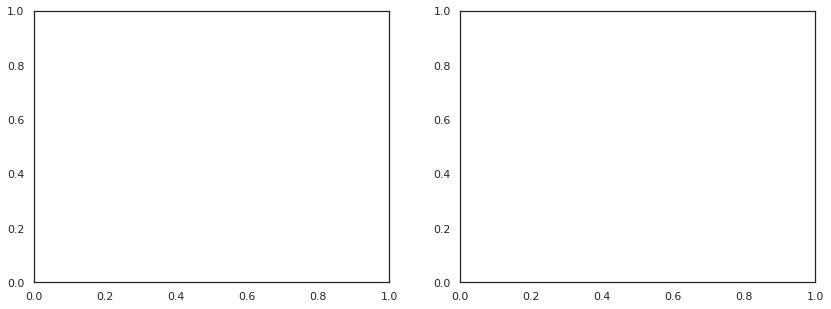

In [ ]:
#get all category datatype 
list_col=  df.select_dtypes(['category']).columns
fig1, axes1 =plt.subplots(1,2,figsize=(14, 5))
for i in range(len(list_col)):
    order = df[list_col[i]].value_counts(ascending=False).index # to display bar in ascending order
    axis=sns.countplot(x=list_col[i], data=df , order=order,ax=axes1[i],palette='viridis').set(title=list_col[i].upper())
    bar_perc(axes1[i],df[list_col[i]])

IndexError: ignored

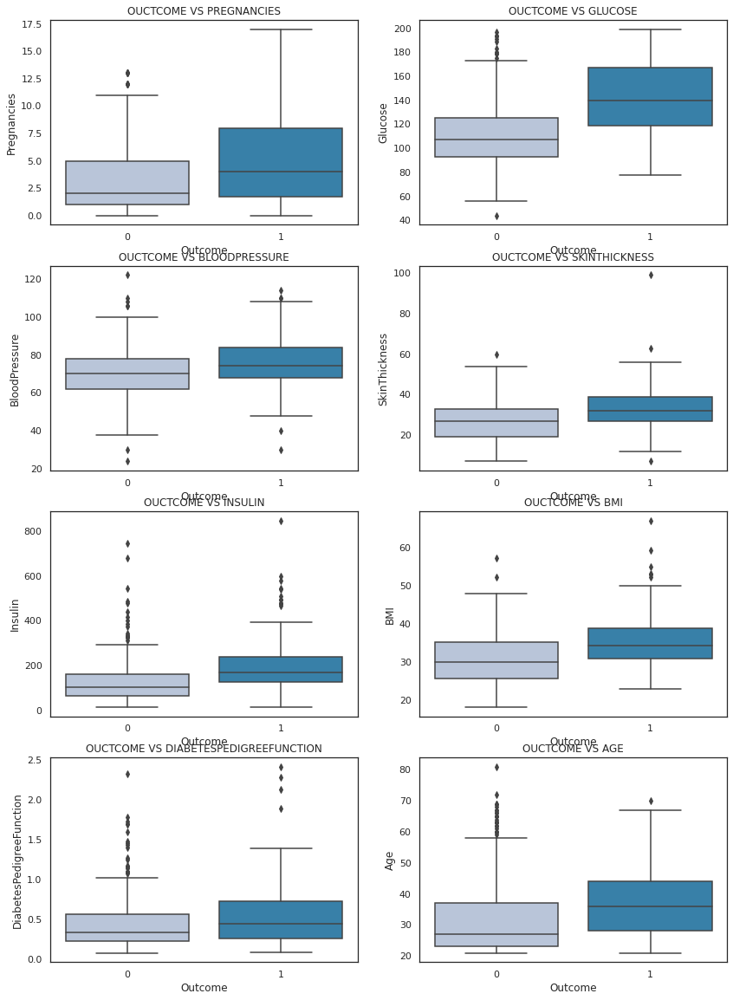

In [ ]:
#Sex vs all numerical variable
fig1, axes1 =plt.subplots(4,2,figsize=(14, 20))
#select all quantitative columns for checking the spread
list_col=  df.select_dtypes([np.number]).columns
for i in range(len(list_col)):
    row=i//2
    col=i%2
    ax=axes1[row,col]
    sns.boxplot(y=df[list_col[i]],x=df['Outcome'],ax=ax,palette="PuBu", orient='v').set(title='OUCTCOME VS '+ list_col[i].upper())

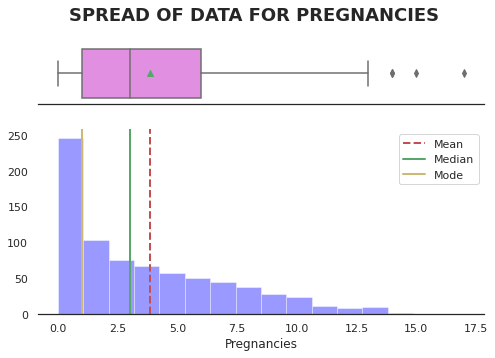

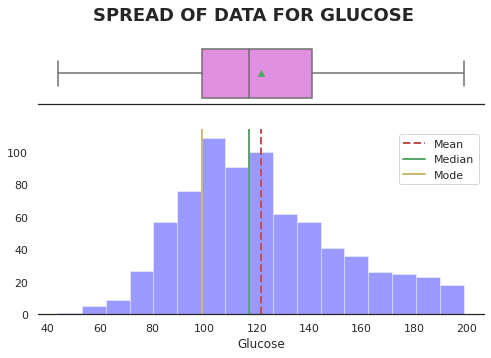

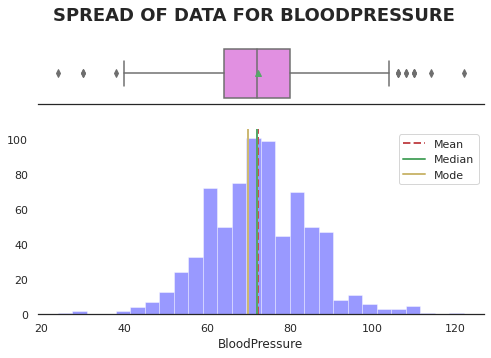

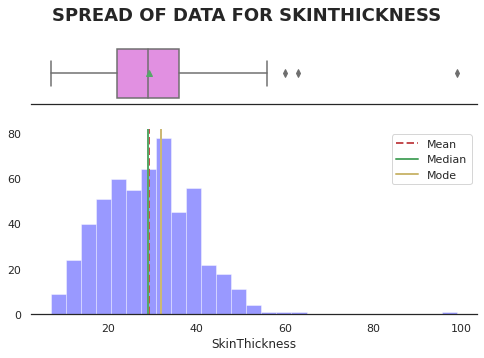

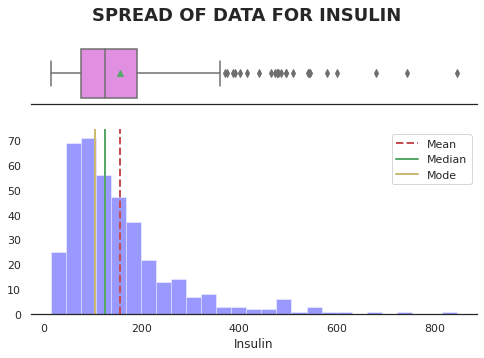

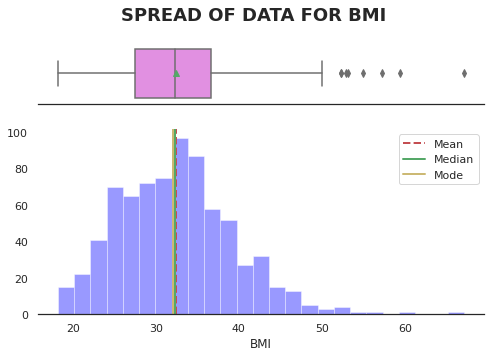

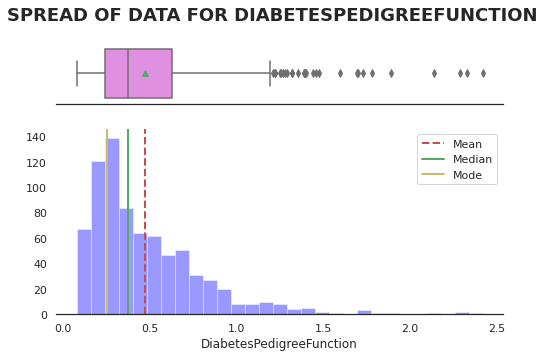

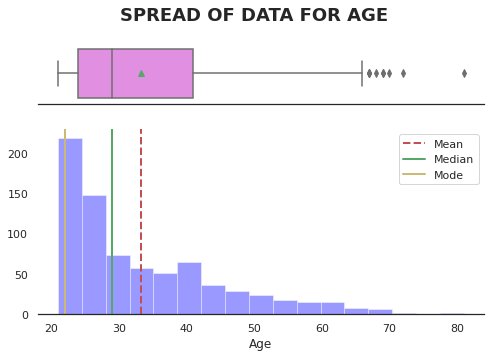

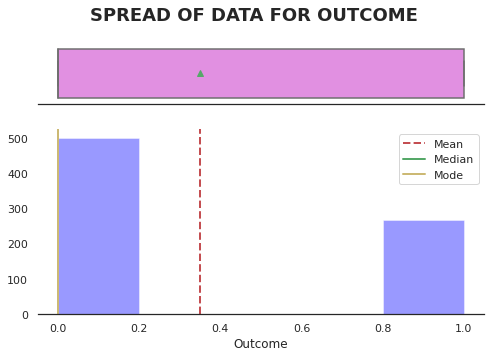

In [ ]:
list_col= df.select_dtypes(include='number').columns.to_list()
for i in range(len(list_col)):
    dist_box(df[list_col[i]])

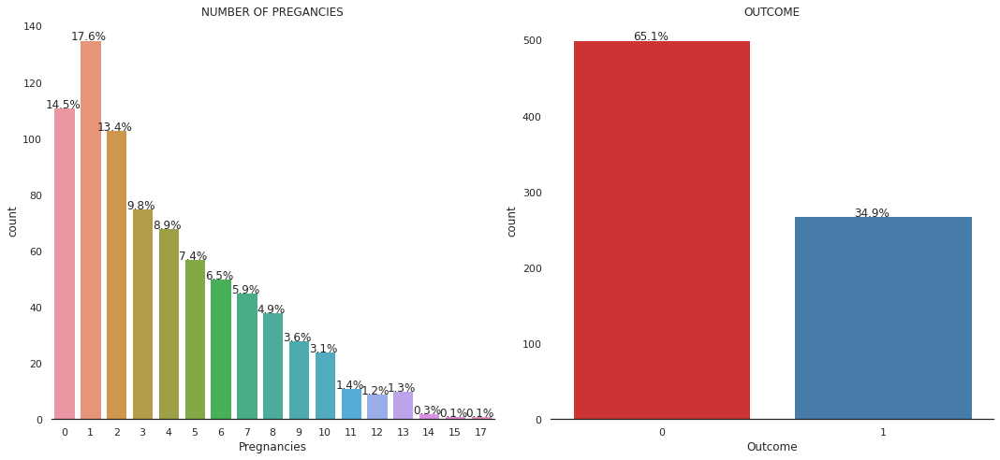

In [ ]:
# Making a list of all categorical variables
cat_columns = ['Pregnancies','Outcome']
title=['Number of Pregancies','Outcome']
plt.figure(figsize=(15,7))

sns.set_theme(style="white") # just trying to make visualisation better. This will set background to white
for i, variable in enumerate(cat_columns):
                     plt.subplot(1,2,i+1)
                     order = df[variable].value_counts(ascending=False).index   
                     #sns.set_palette(list_palette[i]) # to set the palette
                     sns.set_palette('Set1')
                     ax=sns.countplot(x=df[variable], data=df )
                     sns.despine(top=True,right=True,left=True) # to remove side line from graph
                     for p in ax.patches:
                           percentage = '{:.1f}%'.format(100 * p.get_height()/len(df[variable]))
                           x = p.get_x() + p.get_width() / 2 - 0.05
                           y = p.get_y() + p.get_height()
                           plt.annotate(percentage, (x, y),ha='center')
                     plt.tight_layout()
                     plt.title(title[i].upper())

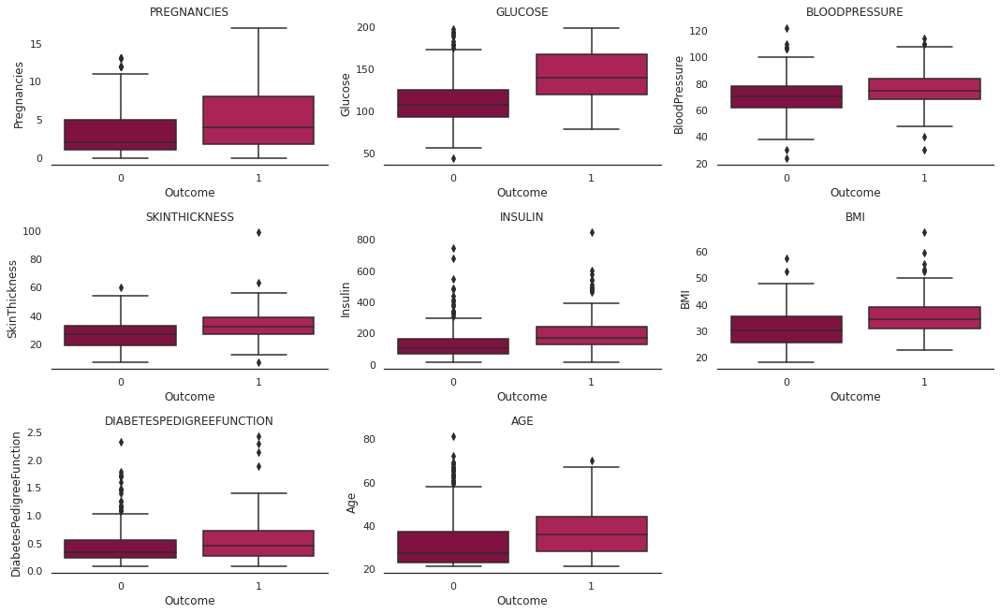

In [277]:
numeric_columns = ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin','BMI', 'DiabetesPedigreeFunction', 'Age',]
plt.figure(figsize=(15,30))

sns.set_palette(sns.color_palette("PuRd_r", 8))
for i, variable in enumerate(numeric_columns):
        plt.subplot(10,3,i+1)
        
        sns.boxplot(x='Outcome',y= df[variable], data=df)     
        sns.despine(top=True,right=True,left=True) # to remove side line from graph
        plt.tight_layout()
        plt.title(variable.upper())

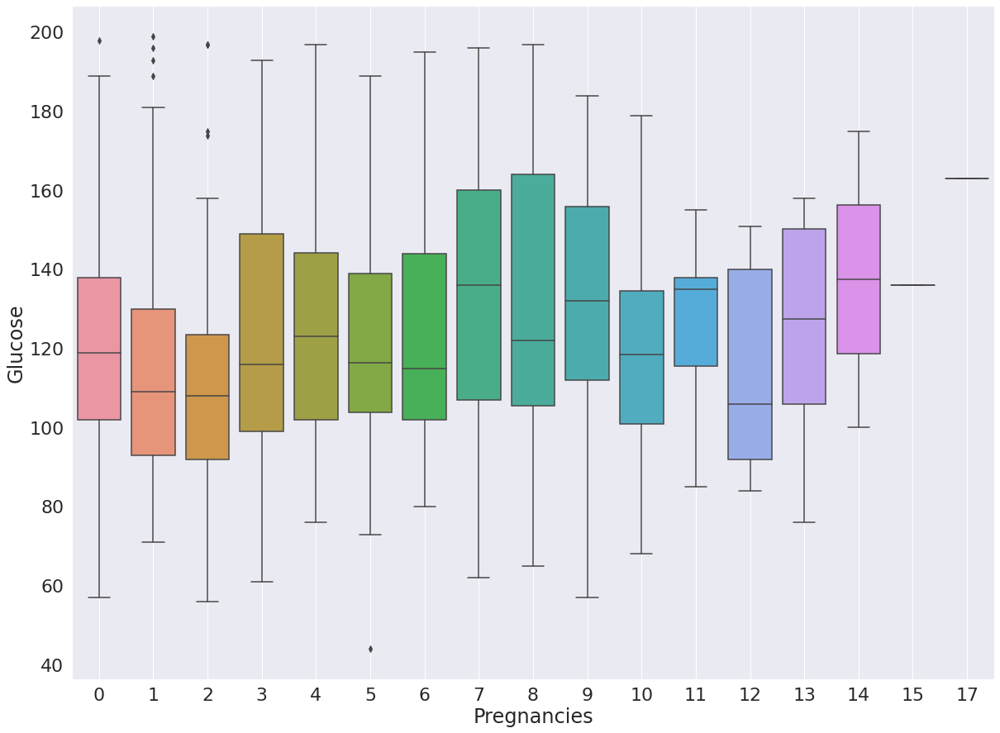

In [ ]:
#Price and band 
plt.figure(figsize=(20,15))
sns.set(font_scale=2)
sns.boxplot(x='Pregnancies', y='Glucose', data=df)
plt.grid()

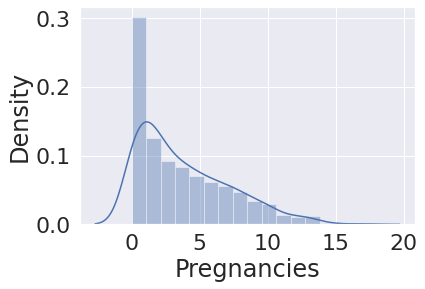

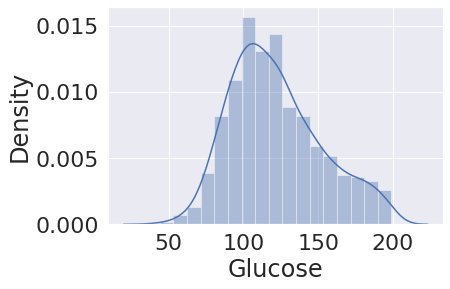

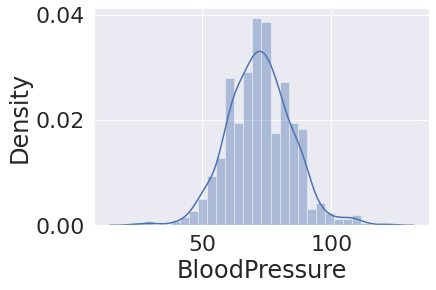

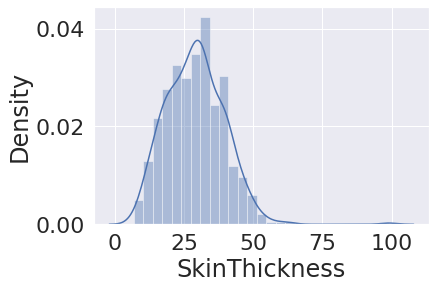

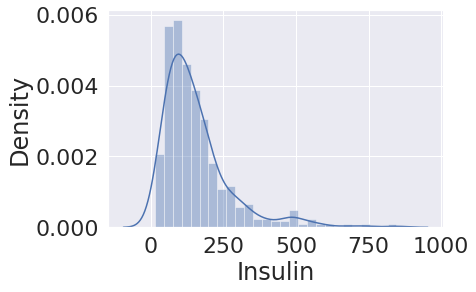

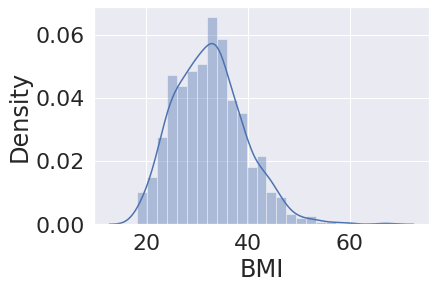

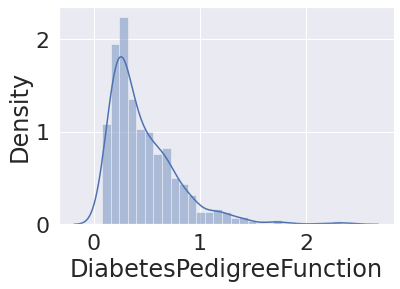

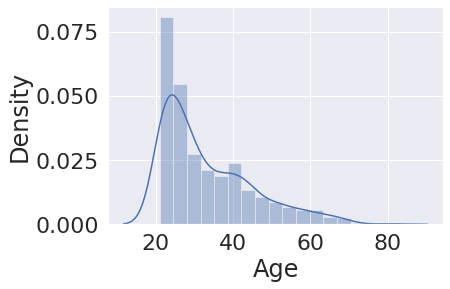

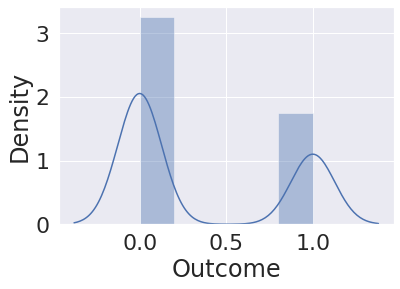

In [ ]:
# check distrubution if skewed. If distrubution is skewed , it is advice to use log transform
cols_to_log = df.select_dtypes(include=np.number).columns.tolist()
for colname in cols_to_log:
    sns.distplot(df[colname], kde=True)
    plt.show()

In [ ]:
def dist_box_violin(data):
 # function plots a combined graph for univariate analysis of continous variable 
 #to check spread, central tendency , dispersion and outliers  
    Name=data.name.upper()
    fig, axes =plt.subplots(1,3,figsize=(17, 7))
    fig.suptitle("SPREAD OF DATA FOR "+ Name  , fontsize=18, fontweight='bold')
    sns.distplot(data,kde=False,color='Blue',ax=axes[0])
    axes[0].axvline(data.mean(), color='y', linestyle='--',linewidth=2)
    axes[0].axvline(data.median(), color='r', linestyle='dashed', linewidth=2)
    axes[0].axvline(data.mode()[0],color='g',linestyle='solid',linewidth=2)
    axes[0].legend({'Mean':data.mean(),'Median':data.median(),'Mode':data.mode()})
    sns.boxplot(x=data,showmeans=True, orient='h',color="purple",ax=axes[1])
    #just exploring violin plot
    sns.violinplot(data,ax=axes[2],showmeans=True)

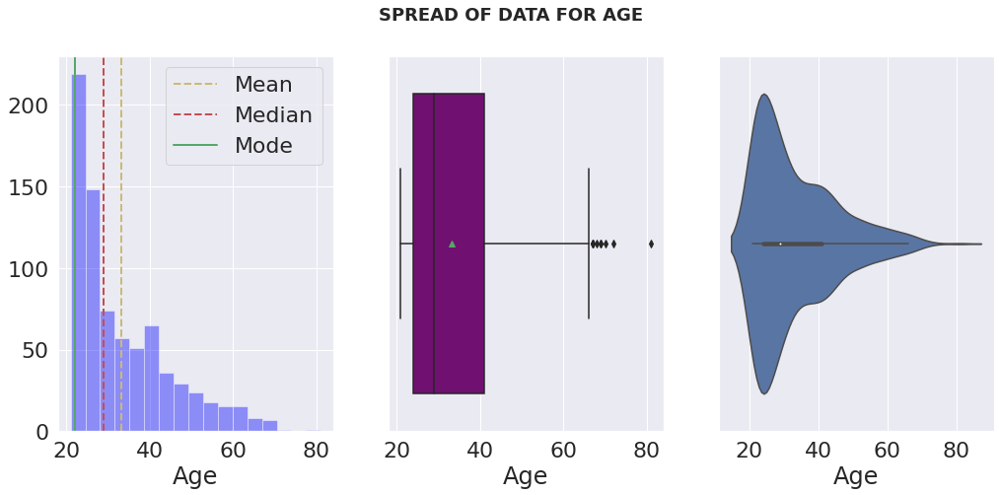

In [ ]:
dist_box_violin(df.Age)

In [ ]:
# Function to create barplots that indicate percentage for each category.
def bar_perc(plot, feature):
    '''
    plot
    feature: 1-d categorical feature array
    '''
    total = len(feature) # length of the column
    for p in plot.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total) # percentage of each class of the category
        x = p.get_x() + p.get_width() / 2 - 0.05 # width of the plot
        y = p.get_y() + p.get_height()           # hieght of the plot
        plot.annotate(percentage, (x, y), size = 12) # annotate the percentage

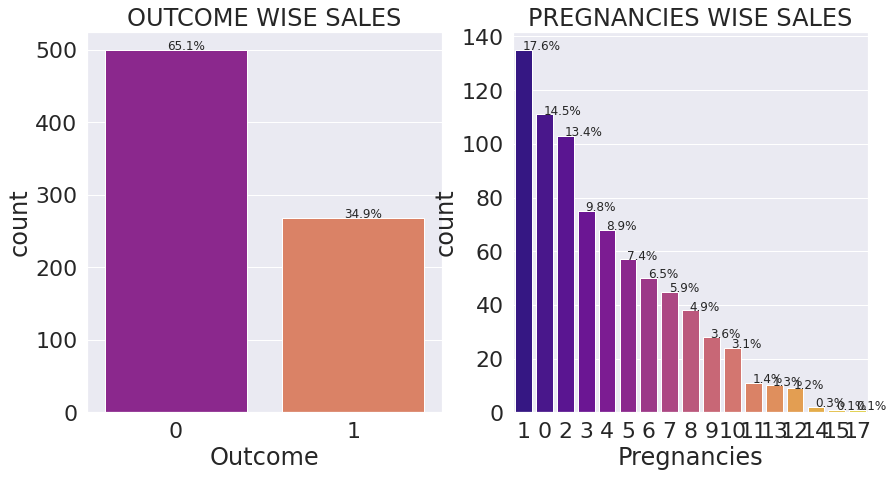

In [ ]:
fig1, axes1 =plt.subplots(1,2,figsize=(14, 7))
list_col=["Outcome", "Pregnancies"]
j=0
for i in range(len(list_col)):
    order = df[list_col[i]].value_counts(ascending=False).index # to display bar in ascending order
    axis=sns.countplot(x=list_col[i], data=df , order=order,ax=axes1[i],palette='plasma').set(title=list_col[i].upper() + ' WISE SALES')
    bar_perc(axes1[i],df[list_col[i]])

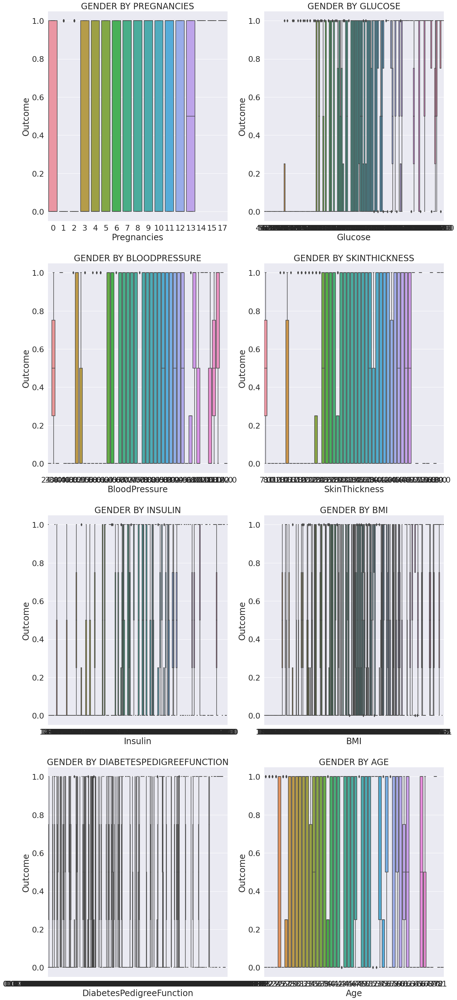

In [ ]:

fig1, axes1 =plt.subplots(4,2,figsize=(20, 50))
list1_col=['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']
# to plot graph side by side.
for i in range(len(list1_col)):
    row=i//2
    col=i%2
    ax=axes1[row,col]
    sns.boxplot(df[list1_col[i]],df['Outcome'],ax=ax).set(title='GENDER BY ' + list1_col[i].upper()) 

In [ ]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")

from collections import Counter
import warnings
warnings.filterwarnings("ignore")

In [ ]:
df = pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/winequality-red.csv')
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


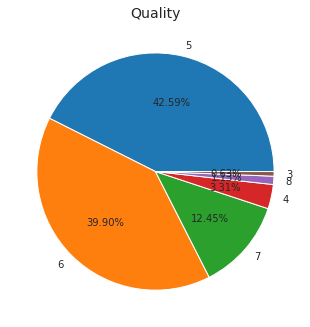

In [ ]:
quality = df["quality"].value_counts()

fig = plt.figure(figsize=(12,12))

ax1 = plt.subplot2grid((2,2),(0,0))

plt.pie(x= quality, autopct="%.2f%%", labels=quality.keys(), pctdistance=0.6)
plt.title('Quality', size = 14)
plt.show()

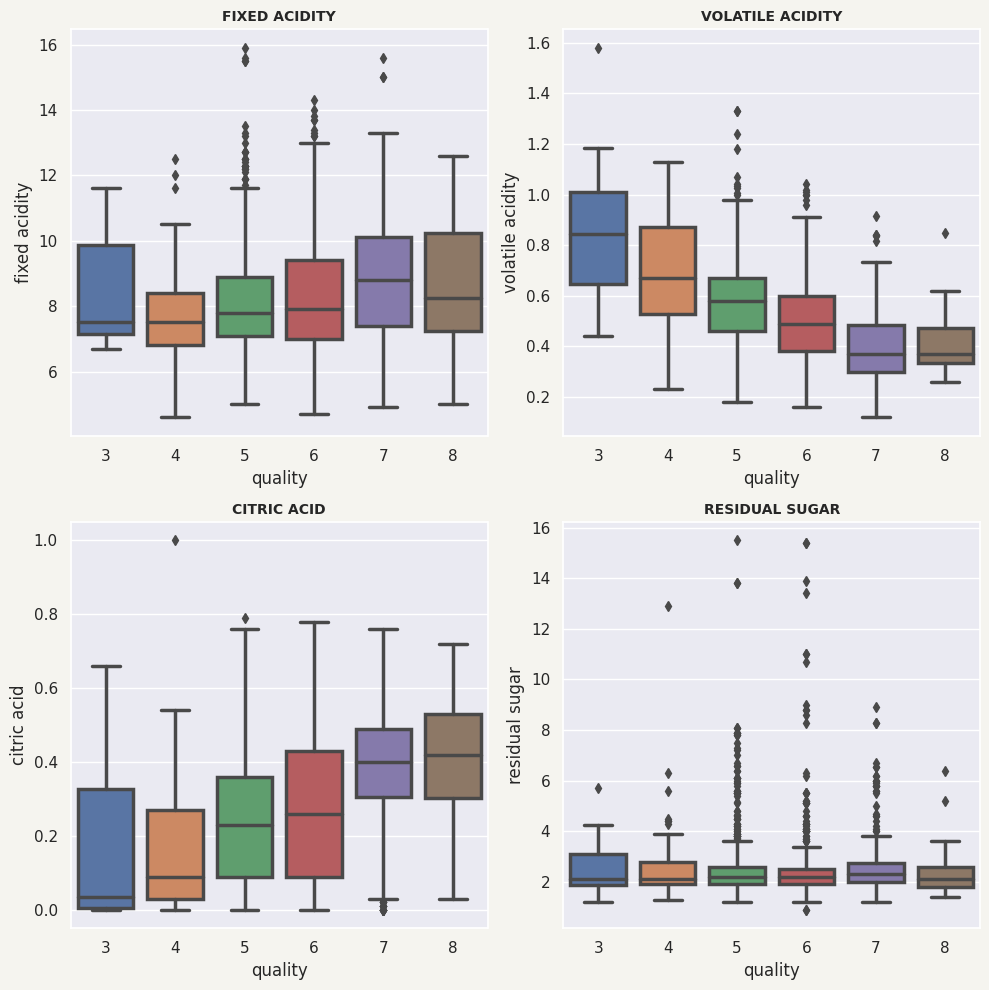

In [ ]:
#plt.rcParams["font.family"] = "serif"
#plt.rcParams['figure.dpi'] = 100
#background_color='#F5F4EF'
sns.set_style('darkgrid')
fig = plt.figure(figsize=(10,10), facecolor=background_color)
for index,column in enumerate(list(df.columns[0:4])):
    plt.subplot(2,2,index+1)
    sns.boxplot(y = df.loc[:, column], x = df["quality"], linewidth=2.5)
    plt.title(column.upper(), size = 10, fontweight='bold')
fig.tight_layout()

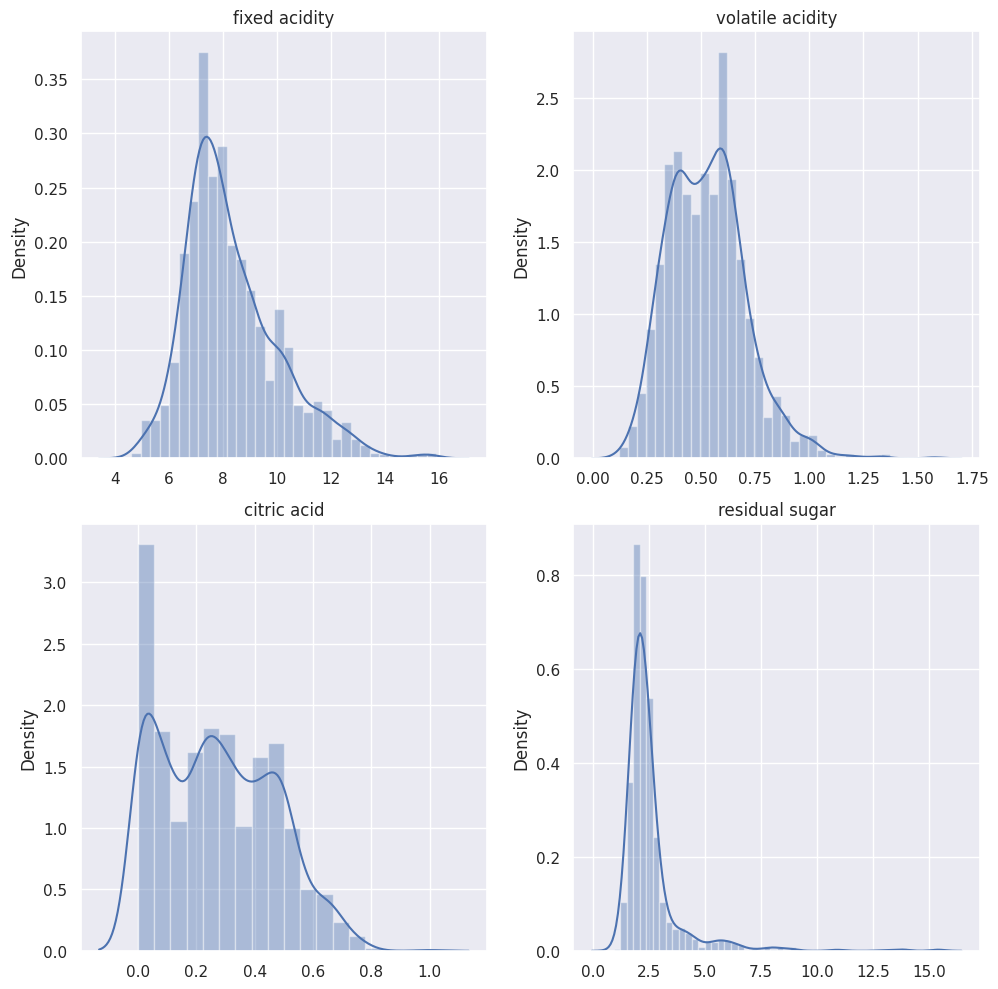

In [ ]:
fig = plt.figure(figsize=(10,10))
for index,column in enumerate(list(df.columns[0:4])):
    plt.subplot(2,2,index+1)
    sns.distplot(x = df.loc[:, column])
    plt.title(column, size = 12)
fig.tight_layout()

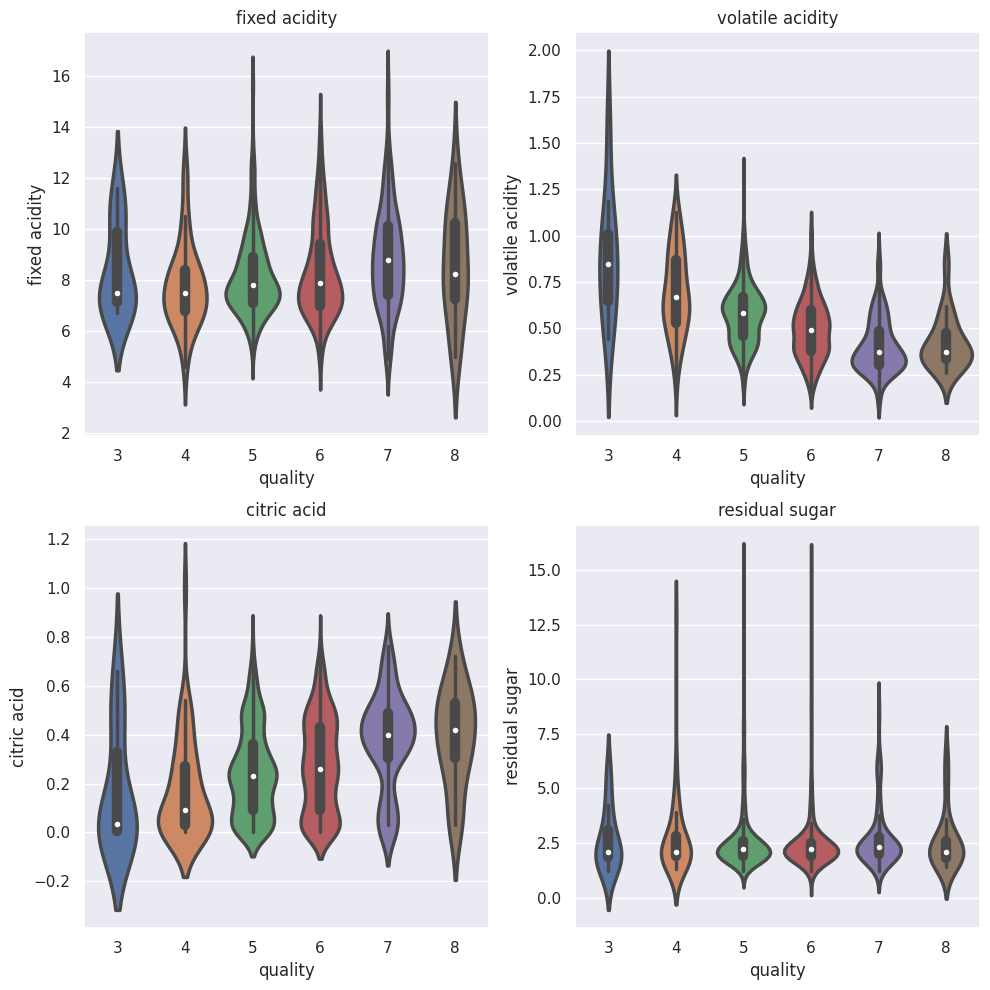

In [ ]:
fig = plt.figure(figsize=(10,10))
for index,column in enumerate(list(df.columns[0:4])):
    plt.subplot(2,2,index+1)
    sns.violinplot(y = df.loc[:, column], x = df["quality"], linewidth=2.5)
    plt.title(column, size = 12)
fig.tight_layout()

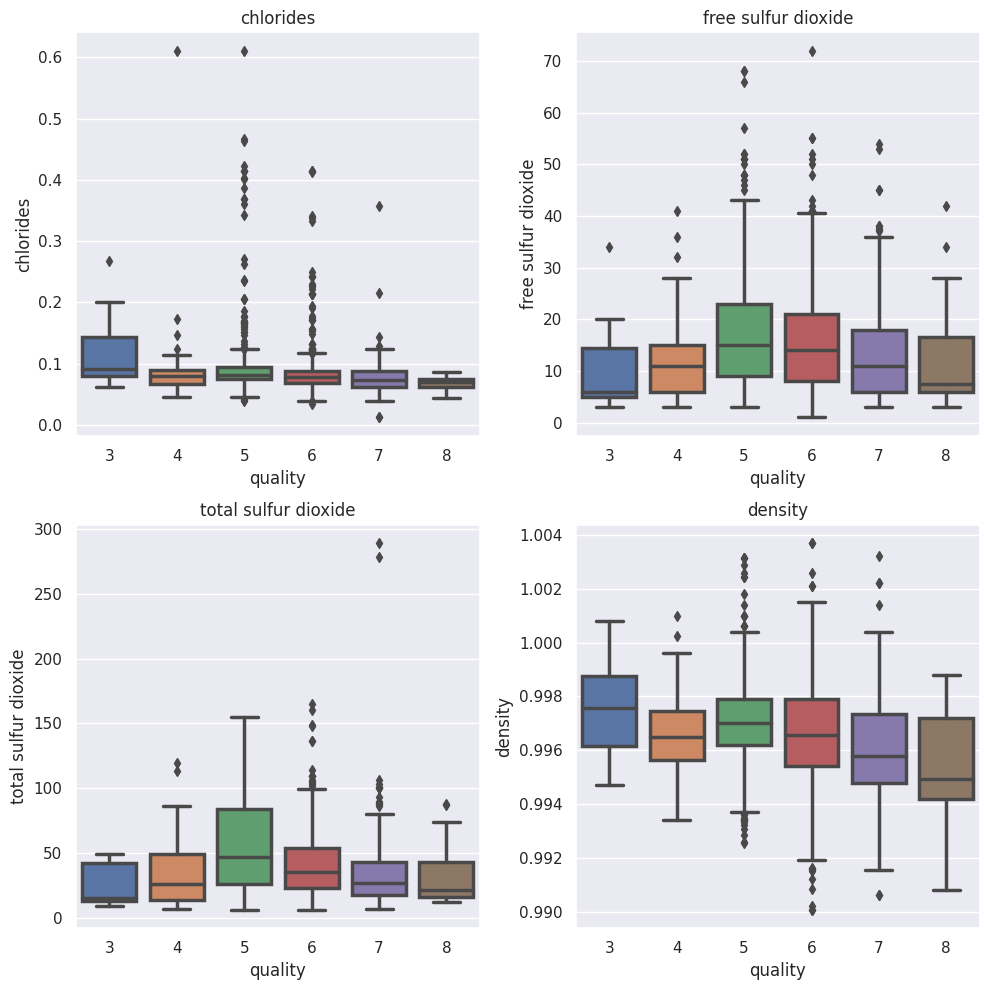

In [ ]:
fig = plt.figure(figsize=(10,10))
for index,column in enumerate(list(df.columns[4:8])):
    plt.subplot(2,2,index+1)
    sns.boxplot(y = df.loc[:, column], x = df["quality"], linewidth=2.5)
    plt.title(column, size = 12)
fig.tight_layout()

In [ ]:
fig = plt.figure(figsize=(10,10))
for index,column in enumerate(list(df.columns[4:8])):
    plt.subplot(2,2,index+1)
    sns.distplot(x = df.loc[:, column])
    plt.title(column, size = 12)
fig.tight_layout()

In [ ]:
fig = plt.figure(figsize=(10,10))
for index,column in enumerate(list(df.columns[4:8])):
    plt.subplot(2,2,index+1)
    sns.violinplot(y = df.loc[:, column], x = df["quality"], linewidth=2.5)
    plt.title(column, size = 12)
fig.tight_layout()

In [ ]:
fig = plt.figure(figsize=(15,5))
for index,column in enumerate(list(df.columns[8:11])):
    plt.subplot(1,3,index+1)
    sns.boxplot(y = df.loc[:, column], x = df["quality"], linewidth=2.5)
    plt.title(column, size = 12)
fig.tight_layout()

In [ ]:
fig = plt.figure(figsize=(15,5))
for index,column in enumerate(list(df.columns[8:11])):
    plt.subplot(1,3,index+1)
    sns.distplot(x = df.loc[:, column])
    plt.title(column, size = 12)
fig.tight_layout()

In [ ]:
fig = plt.figure(figsize=(15,5))
for index,column in enumerate(list(df.columns[8:11])):
    plt.subplot(1,3,index+1)
    sns.violinplot(y = df.loc[:, column], x = df["quality"], linewidth=2.5)
    plt.title(column, size = 12)
fig.tight_layout()

In [ ]:
f,ax=plt.subplots(figsize = (10,10))
sns.heatmap(df.corr(),annot= True,fmt = ".2f",
            vmin = -1,
            vmax = 1,
            ax=ax,cmap = 'coolwarm')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title('Correlation Map', size = 14)
plt.show()

### Matriz de Confusão

In [ ]:
f,ax=plt.subplots(figsize = (10,10))
sns.heatmap(df.corr(),annot= True,fmt = ".2f",
            vmin = -1,
            vmax = 1,
            ax=ax,cmap = 'coolwarm')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title('Correlation Map', size = 14)
plt.show()

In [ ]:
cm = confusion_matrix(y_test, y_pred_lda)

df1 = pd.DataFrame(columns=["0","1","2","3"], index= ["0","1","2","3"], data= cm )

f,ax = plt.subplots(figsize=(6,6))

sns.heatmap(df1, annot=True,cmap="Greens", fmt= '.0f',ax=ax,
            linewidths = 5, cbar = False,annot_kws={"size": 16})
plt.xlabel("Predicted Label")
plt.xticks(size = 12)
plt.yticks(size = 12, rotation = 0)
plt.ylabel("True Label")
plt.title("Confusion Matrix", size = 12)
plt.show()

### Data Frame de Predição

In [ ]:
pr = pd.DataFrame(columns=["y_pred","y_test"], index= None)
pr["y_pred"] = y_pred
pr["y_test"] = y_test
predictions = []
for i in range(0,pr.shape[0]):
    if pr.iloc[i,0] == pr.iloc[i,1]:
        predictions.append("True")
    else:
        predictions.append("False")
pr["prediction"] = predictions
pr.head(15)

#################### QUALITY #####################
   quality      Ratio
5      681  42.589118
6      638  39.899937
7      199  12.445278
4       53   3.314572
8       18   1.125704
3       10   0.625391
##################################################


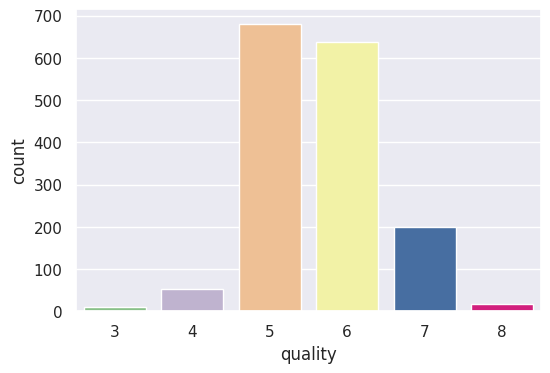

In [ ]:
cat_cols = [col for col in df.columns if df[col].dtypes == 'O']
num_but_cat = [col for col in df.columns if df[col].nunique() < 10 and df[col].dtypes != 'O']
cat_but_car = [col for col in df.columns if df[col].nunique() > 20 and df[col].dtypes == 'O']
cat_cols = cat_cols + num_but_cat
cat_cols = [col for col in cat_cols if col not in cat_but_car]

def cat_summary(dataframe, col_name, plot=False):
    print(pd.DataFrame({col_name: dataframe[col_name].value_counts(),
                        "Ratio": 100 * dataframe[col_name].value_counts() / len(dataframe)}))
    print("#"*50)
    if plot:
        sns.countplot(x=dataframe[col_name], data=dataframe,palette='Accent')
        plt.show()
        
for i in cat_cols:
    print((' '+i.upper()+' ').center(50,'#'))
    cat_summary(df,i,plot=True)

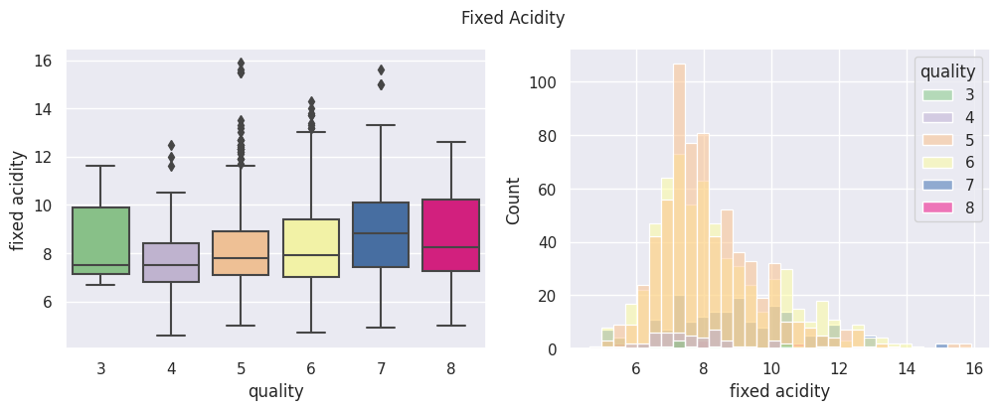

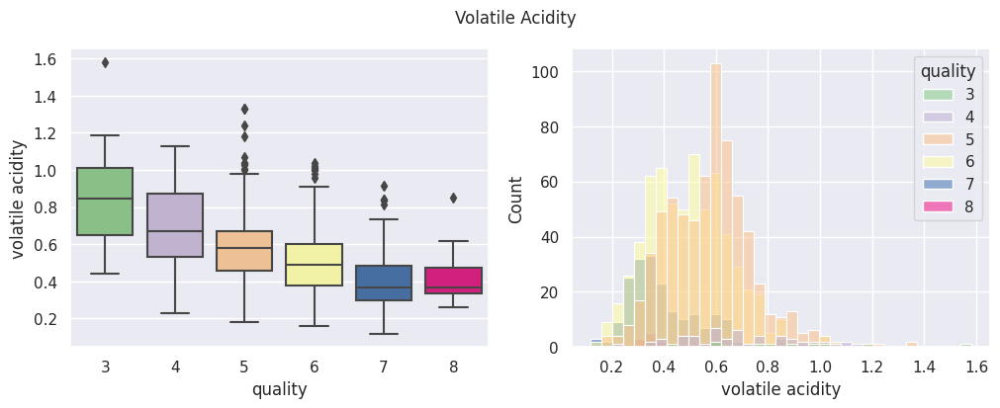

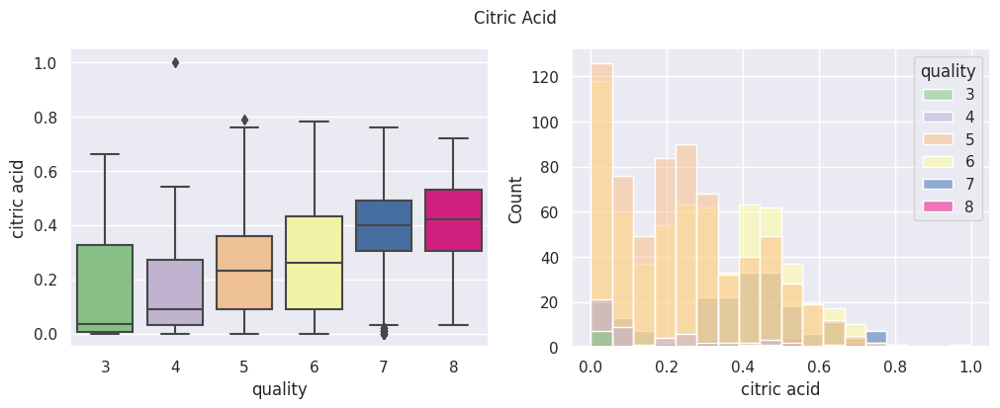

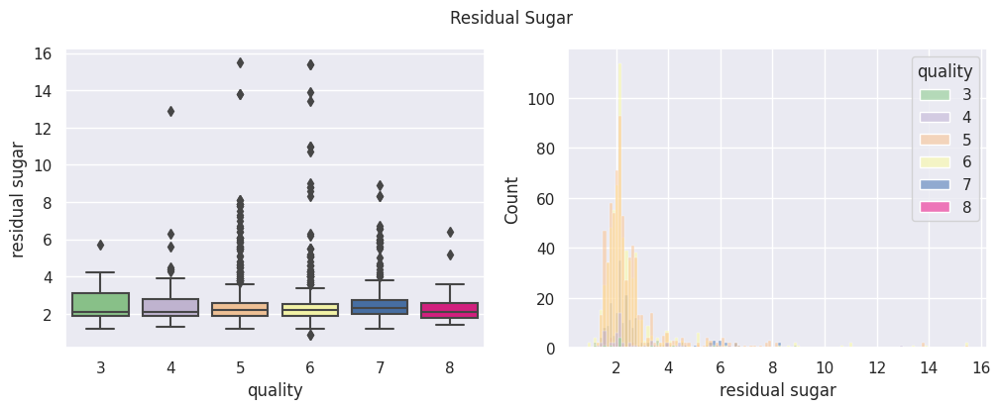

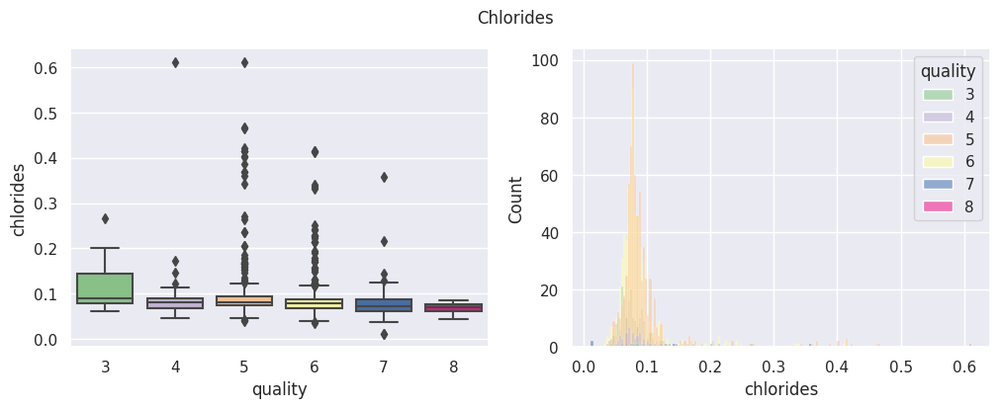

...

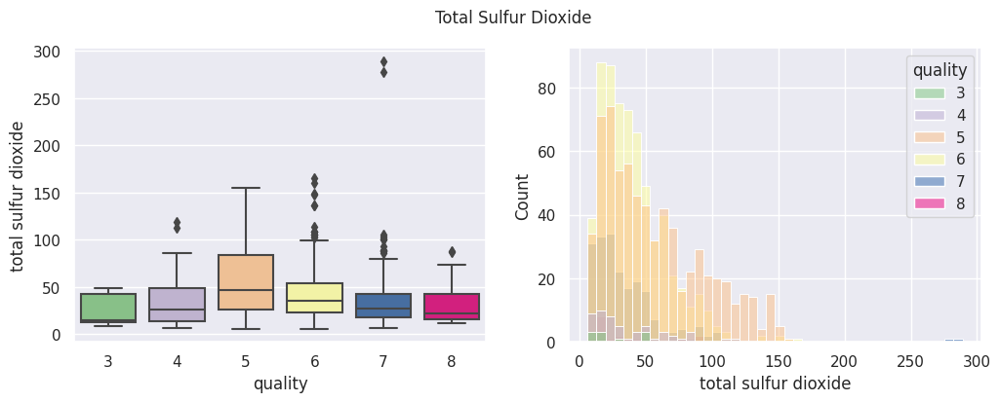

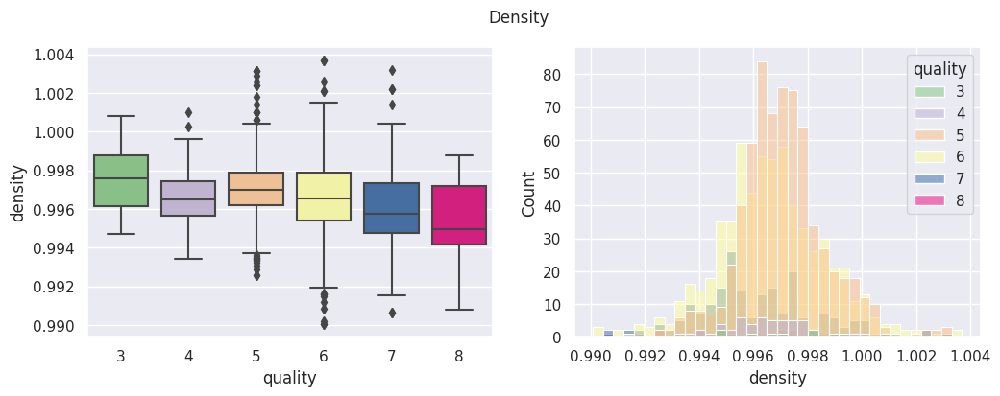

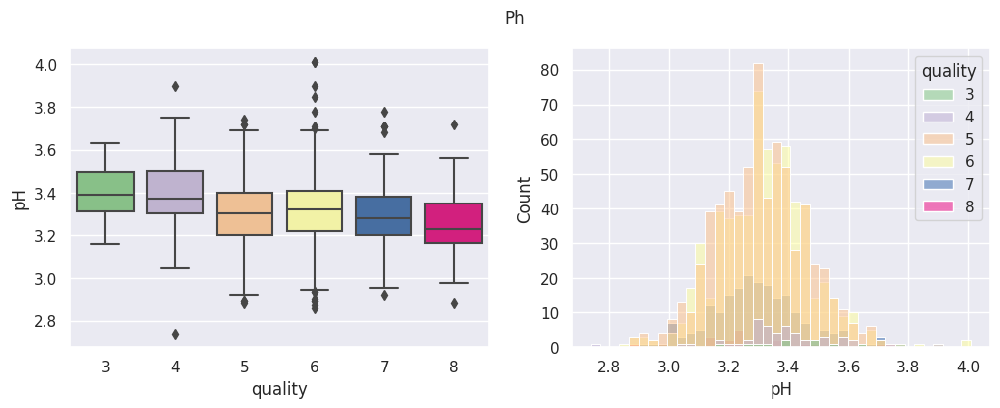

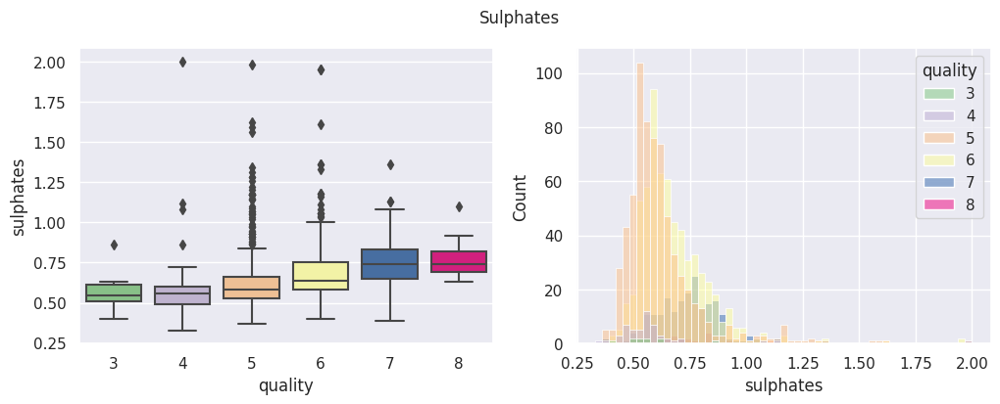

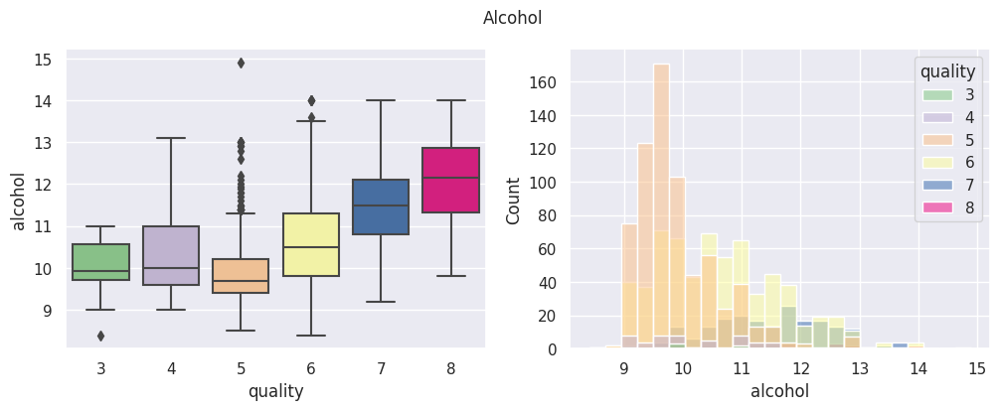

In [ ]:
num_cols = [col for col in df.columns if col not in cat_cols and df[col].dtypes != 'O']
for i in num_cols:
    fig, axes = plt.subplots(1, 2,figsize=(12,4))
    fig.suptitle(i.title(),size=12)
    sns.boxplot(ax=axes[0],y=i,x='quality',data=df,palette='Accent')
    sns.histplot(ax=axes[1],x=i,hue='quality',data=df,palette='Accent')
    plt.show()

In [ ]:
# Select the columns to display
cols = df.columns
cols = list(cols)
cols.remove('area')
cols.remove('floor')

fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(15, 10),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    col = cols[i]
    sns.boxplot(x=col,y='total (R$)', data = df, ax = ax)
    ax.set_title(f"Boxplot: Price distribution depending on the {col.capitalize()}")
plt.tight_layout()
plt.show()

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(15, 12))
fig.suptitle('Iris species features comparison', fontsize = 20)

feature = ["SepalLengthCm","SepalWidthCm","PetalLengthCm","PetalWidthCm"]
for i, ax in enumerate(axes.flat):
    sns.violinplot(ax=ax, x = 'Species', y = feature[i], data = df)
    ax.set_title(feature[i], fontsize = 15)
plt.show() 

In [ ]:
import missingno as msno
msno.matrix(df)
plt.show()

In [ ]:
# missingno bar plot
msno.bar(data_missingno)
plt.show()

In [ ]:
fig=plt.gcf()
fig.set_size_inches(10,7)
fig=sns.boxplot(x='Species',y='SepalLengthCm',data=iris)
fig=sns.stripplot(x='Species',y='SepalLengthCm',data=iris,jitter=True,edgecolor='gray')

In [ ]:
sns.set(style="darkgrid")
sc=iris[iris.Species=='Iris-setosa'].plot(kind='scatter',x='SepalLengthCm',y='SepalWidthCm',color='red',label='Setosa')
iris[iris.Species=='Iris-versicolor'].plot(kind='scatter',x='SepalLengthCm',y='SepalWidthCm',color='green',label='Versicolor',ax=sc)
iris[iris.Species=='Iris-virginica'].plot(kind='scatter',x='SepalLengthCm',y='SepalWidthCm',color='orange', label='virginica', ax=sc)
sc.set_xlabel('Sepal Length in cm')
sc.set_ylabel('Sepal Width in cm')
sc.set_title('Sepal Length Vs Sepal Width')
sc=plt.gcf()
sc.set_size_inches(10,6)

In [ ]:
from math import pi
categories = list(iris)[:4]
N = len(categories)
angles = [ n / float(N)*2*pi for n in range(N)]
angles = angles + angles[:1]
plt.figure(figsize = (10,10))
ax = plt.subplot(111,polar = True)
ax.set_theta_offset(pi/2)
ax.set_theta_direction(-1)
plt.xticks(angles[:-1],categories)
ax.set_rlabel_position(0)
plt.yticks([0,2,4,6],["0","2","4","6"],color= "red", size = 7)
plt.ylim(0,6)

values = iris.loc[0].drop("Species").values.flatten().tolist()
values = values + values[:1]
ax.plot(angles,values,linewidth = 1,linestyle="solid",label ="setosa" )
ax.fill(angles,values,"b",alpha=0.1)

values = iris.loc[1].drop("Species").values.flatten().tolist()
values = values + values[:1]
ax.plot(angles,values,linewidth = 1,linestyle="solid",label ="versicolor" )
ax.fill(angles,values,"orange",alpha=0.1)
plt.legend(loc = "upper left",bbox_to_anchor = (0.1,0.1))
plt.show()

In [ ]:
#iris['SepalLengthCm'] = iris['SepalLengthCm'].astype('category')
#iris.head()
#iris.plot.area(y='SepalLengthCm',alpha=0.4,figsize=(12, 6));
iris.plot.area(y=['SepalLengthCm','SepalWidthCm','PetalLengthCm','PetalWidthCm'],alpha=0.4,figsize=(12, 6));

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_val, pred, normalize='true')
sns.heatmap(cm, annot=True, cmap="YlOrRd")
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.show()

In [ ]:
sb.displot(data=data,x='price',hue='cut',kind='kde',height=6,multiple="fill",clip=(0,None),palette="ch:rot=-.25,hue=1,light=.75")

In [ ]:
sb.jointplot(x=y_test,y=lin_pred,kind='reg',line_kws={"color": "red"})
plt.title('actual vs predicted output')
plt.show()

In [ ]:
ax=plt.figure(figsize=(11,8)).add_axes([0,0,1,1])
sns.set_style('white')
sns.countplot(y='activity_description',data=companies_foreign)
for rect in ax.patches:
    ax.text (rect.get_width(), rect.get_y() + rect.get_height() / 2,
             "%i"% rect.get_width(),fontsize=13 )

plt.title('Sectors of Companies',fontsize=14, weight='bold')
plt.xlabel('Number of Companies Registered',fontsize=14)
plt.ylabel('Sectors',fontsize=14)
plt.show()

In [ ]:
for i in wine.columns:
    if i!='quality':
        sns.boxplot(data=wine,x='quality',y=i)
        plt.show()

In [1]:
# General tools
import pandas as pd
import numpy as np
import os, math
from collections import Counter

# Plotting
import missingno
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
morancolor=sns.color_palette(["#6f2205","#a36c22","#eacc97","#dee8ec","#93b0d0","#99998f","#cbb796","#f8a73f","#db5c01","#1b1612"])
sns.set_theme(style="whitegrid", palette=morancolor)
plt.rcParams['font.family']='serif'
plt.rcParams['figure.dpi'] =100 # high resolution

In [191]:
df=pd.read_csv('https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/00-seabortitanictrain.csv')

In [192]:
def barplot(df,lst,target,w=16,h=6,cut=3,hspace=.5,wspace=.25,color=None):
    f=plt.figure(figsize=(w,h))
    f.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.barplot(x=df[col],y=df[target],color=color)
        plt.xlabel(col,fontweight='bold')
        sns.despine(left=1,bottom=1,right=1,top=1)

In [193]:
def kdeplot(df,lst,target,w=16,h=5.5,cut=3,hspace=.5,wspace=.25,yscale='linear'):
    f=plt.figure(figsize=(w,h))
    f.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        data=df.dropna(subset=[col,target],how='any')
        sns.kdeplot(data[col],cut=0,color="#eacc97",multiple='stack')
        sns.kdeplot(data[col],hue=data[target],cut=0)
        plt.yscale(yscale)
        plt.xlabel(col,fontweight='bold')
        sns.despine(left=1,bottom=1,right=1,top=1)

In [194]:
def stackedbar(train,x,y,h=2.5,w=7):
    sub=pd.crosstab(train[x],train[y])
    sub.div(sub.sum(1),0).plot(kind='bar',stacked=True,figsize=(w,h))
    plt.legend(loc='upper right',bbox_to_anchor=(1.22,1.03))
    plt.xticks(rotation=0)

In [195]:
def violinplot(combine,y,x,target,h=3.5,w=10,scale='count',fontsize=15,title=None):
    plt.figure(figsize=(w,h))
    sns.violinplot(data=combine,x=x,y=y,hue=target,cut=0,split=True,scale=scale)
    sns.despine(top=1,bottom=1,right=1,left=1)
    if title==None: plt.title(f'{y} distribution by {x}',fontweight='bold',fontsize=fontsize)
    else: plt.title(title,fontweight='bold',fontsize=fontsize)
    plt.hlines([0,10],xmin=-1,xmax=3,ls='--') # children under 10 yrs
    plt.show()

In [196]:
def countandrate(df,x,hue,target='Survived'):
    f,ax=plt.subplots(1,2,figsize=(10,3.5))
    sns.countplot(x=df[x],hue=df[hue],ax=ax[0])
    ax[0].set_title(f'# of passengers by {x} and {hue}',fontweight='bold',fontsize=15)
    sns.barplot(x=df[x],hue=df[hue],y=df[target],ax=ax[1])
    ax[1].set_title(f'{target} by {x} and {hue}',fontweight='bold',fontsize=13)
    sns.despine(top=1,bottom=1,left=1,right=1)

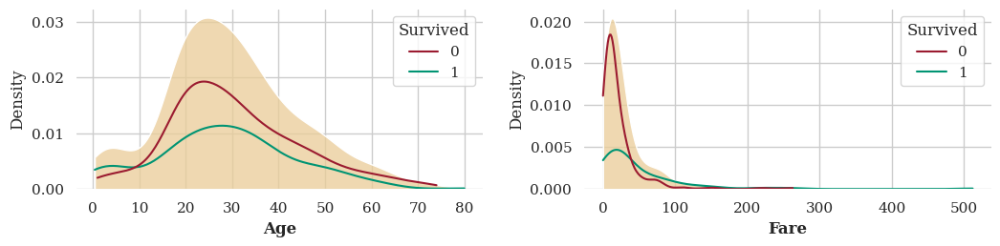

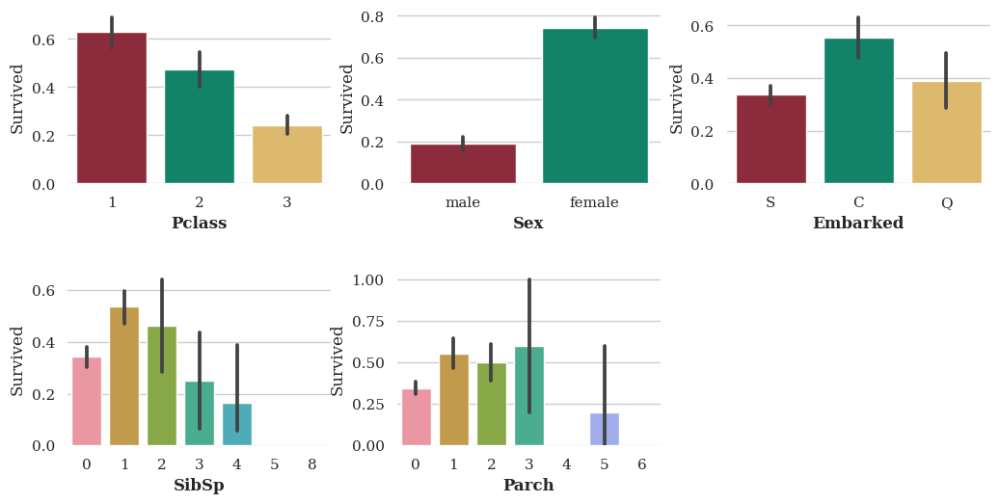

In [197]:
catcol=['Pclass','Sex','Embarked','SibSp','Parch']
kdeplot(df,['Age','Fare'],'Survived',h=2.5,cut=2,w=11)
barplot(df,catcol,'Survived',h=6,w=11)

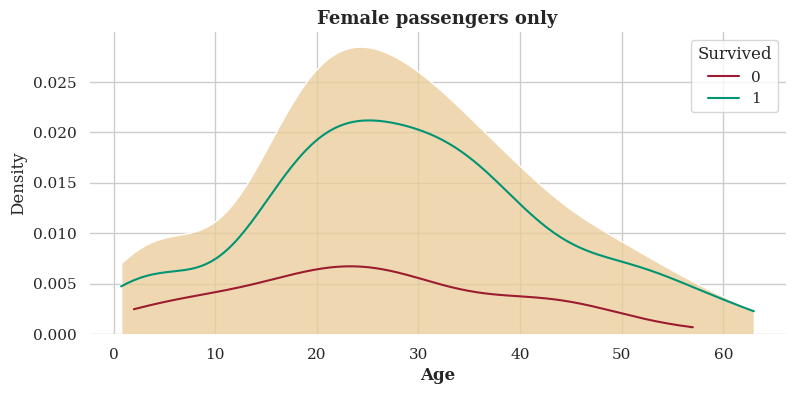

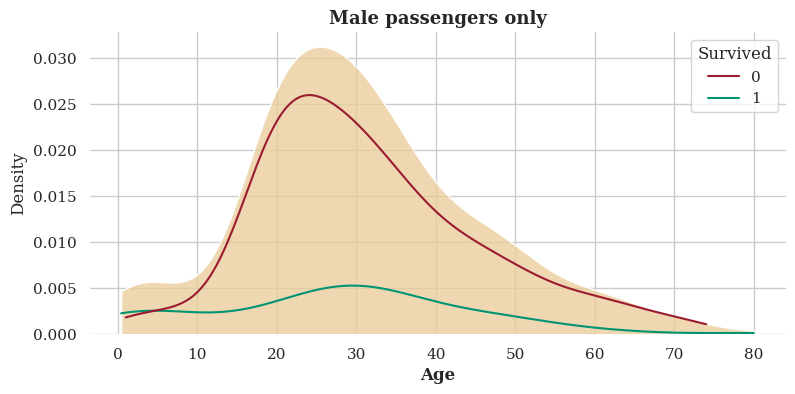

In [198]:
for i,sex in enumerate(['female','male']):
    kdeplot(df[df.Sex==sex],['Age'],'Survived',cut=1,w=8,h=4)
    plt.title(f'{sex.capitalize()} passengers only',fontweight='bold',fontsize=13)

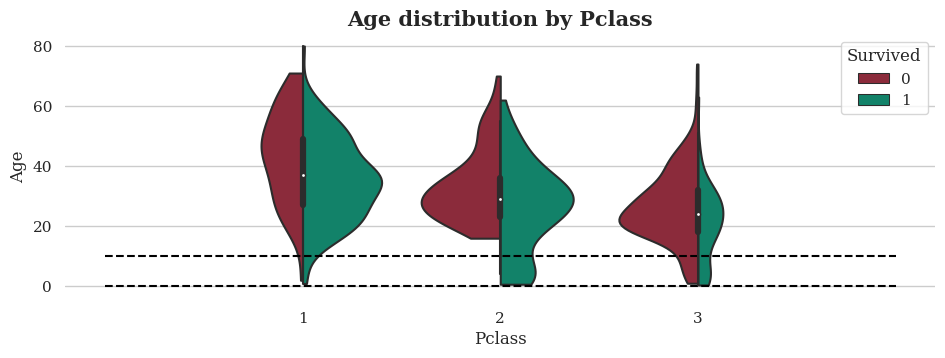

In [199]:
violinplot(df,'Age','Pclass','Survived',scale='count')

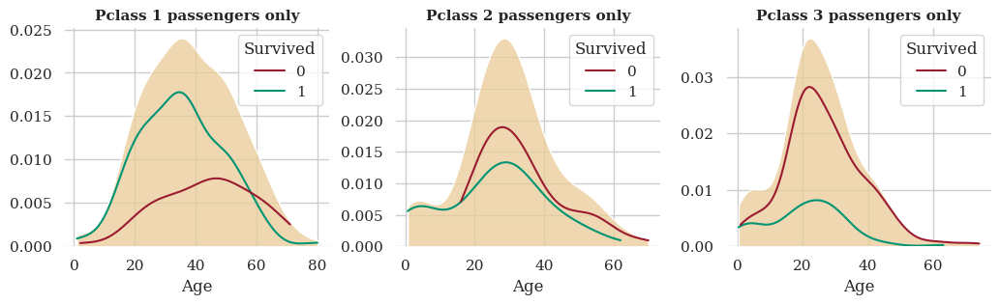

In [200]:
f=plt.figure(figsize=(11,3))
for i in range(1,4):
    f.add_subplot(1,3,i)
    sns.kdeplot(data=df[df.Pclass==i].dropna(subset=['Age','Survived']),x='Age',hue='Survived',cut=0)
    sns.kdeplot(data=df[df.Pclass==i].dropna(subset=['Age','Survived']),x='Age',multiple='stack',color="#eacc97",cut=0)
    plt.title(f"Pclass {i} passengers only",fontweight='bold',fontsize=11)
    plt.ylabel('')
    sns.despine(top=1,bottom=1,left=1,right=1)
plt.subplots_adjust(wspace=.25,hspace=.5)

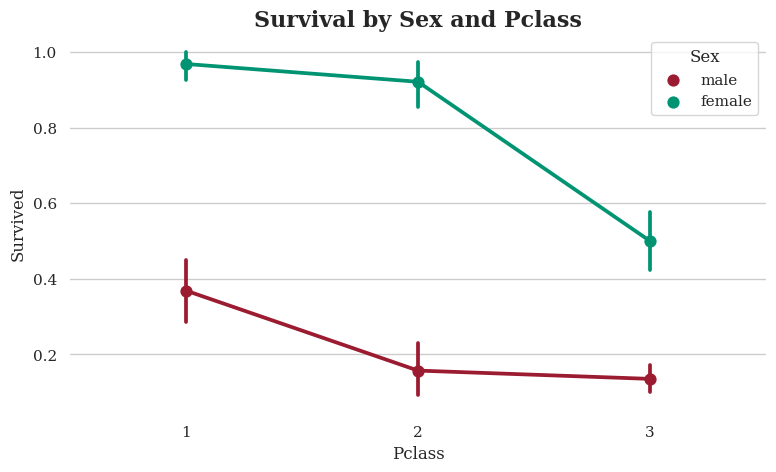

In [201]:
plt.figure(figsize=(8,5))
sns.pointplot(df.Pclass,df.Survived,hue=df.Sex)
plt.title('Survival by Sex and Pclass',fontweight='bold',fontsize=16)
sns.despine(top=1,bottom=1,left=1,right=1);

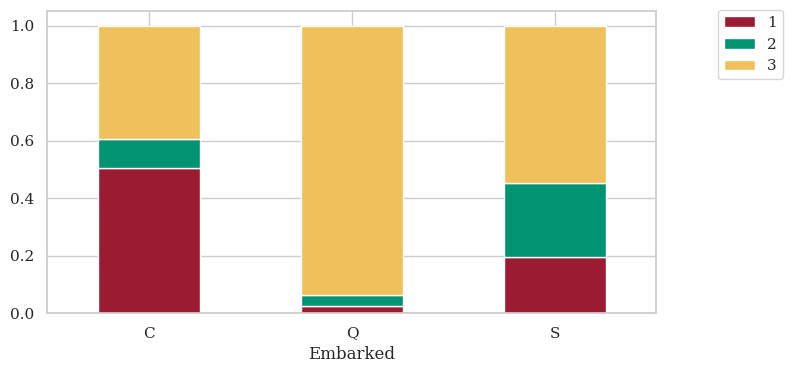

In [202]:
stackedbar(df,'Embarked','Pclass',h=4)

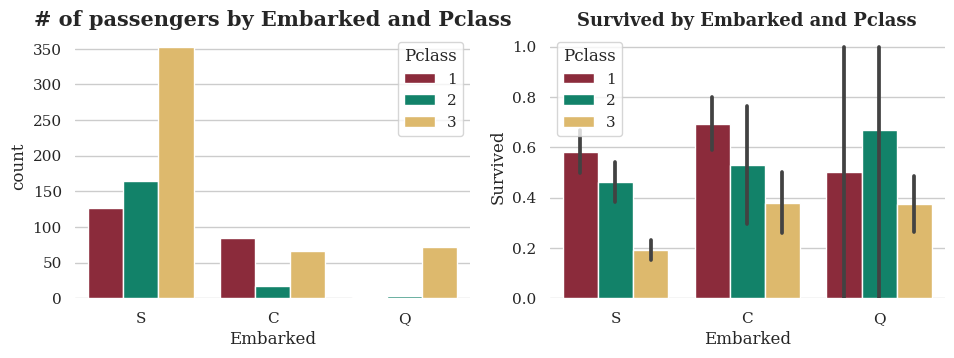

In [203]:
countandrate(df,'Embarked','Pclass')

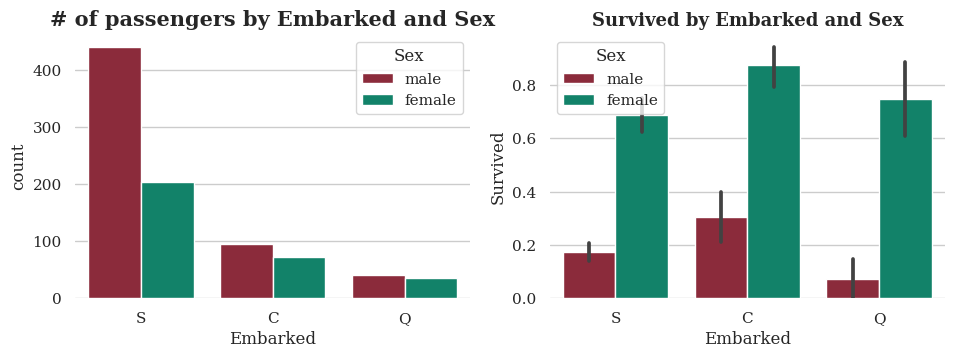

In [204]:
countandrate(df,'Embarked','Sex')

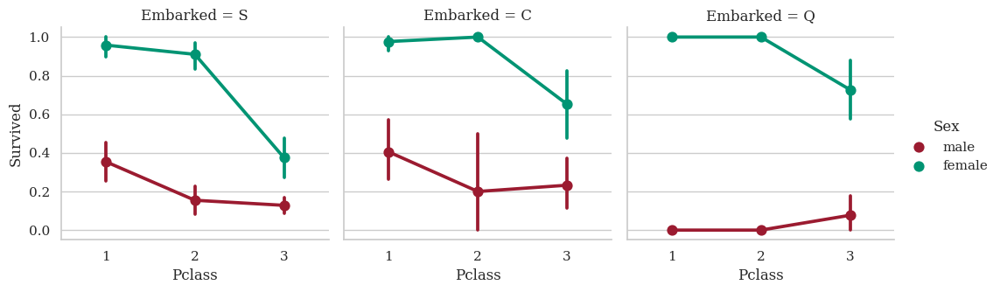

In [205]:
sns.catplot(data=df,col="Embarked",x="Pclass",y="Survived",hue="Sex",height=3.5,kind='point')
plt.show()

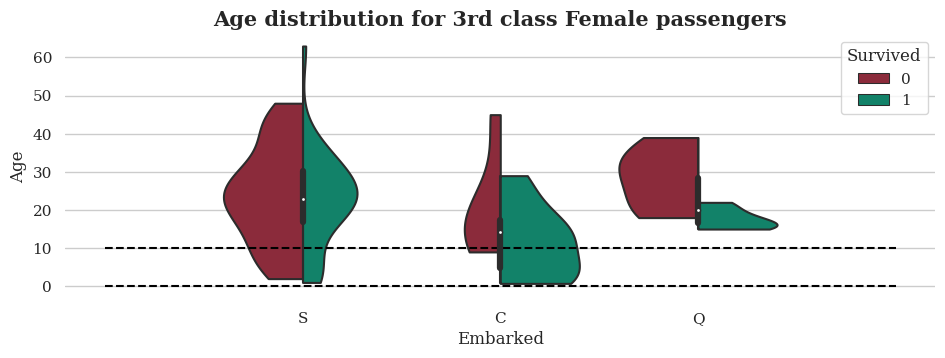

In [206]:
violinplot(df[(df.Pclass==3)&(df.Sex=='female')],'Age','Embarked','Survived',scale='count',
          title='Age distribution for 3rd class Female passengers')

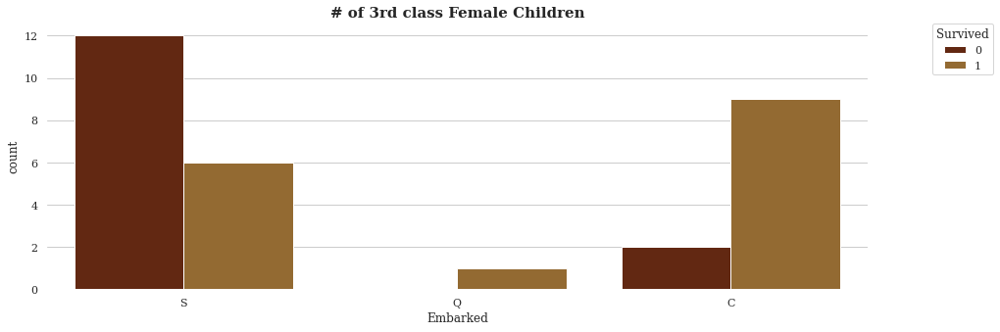

In [27]:
f,ax=plt.subplots(figsize=(15,5))
sns.countplot(data=df[(df.Sex=='female')&(df.Pclass==3)&(df.Age<16)],x='Embarked',hue='Survived')
ax.set_title('# of 3rd class Female Children',fontweight='bold',fontsize=15)
plt.legend(title='Survived',loc='upper right',bbox_to_anchor=(1.16,1.02))
sns.despine(top=1,bottom=1,left=1,right=1)

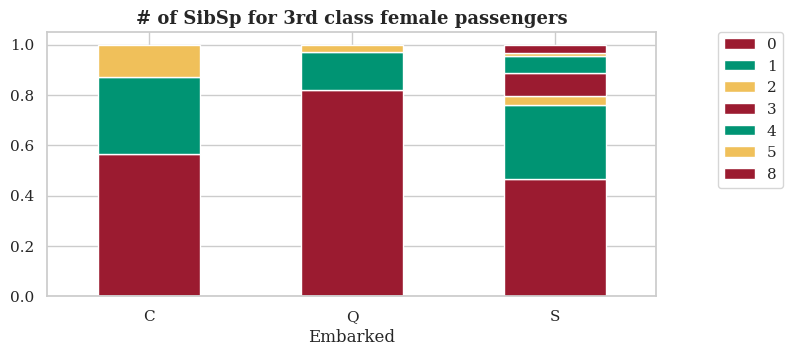

In [207]:
stackedbar(df[(df.Sex=="female")&(df.Pclass==3)],"Embarked","SibSp",h=3.5)
plt.title('# of SibSp for 3rd class female passengers',fontsize=13,fontweight='bold')
plt.show()

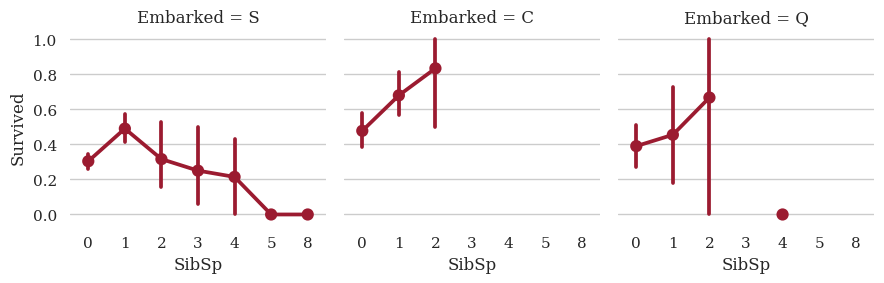

In [208]:

sns.catplot(data=df,x='SibSp',y='Survived',col='Embarked',kind='point',height=3)
sns.despine(top=1,bottom=1,left=1,right=1)


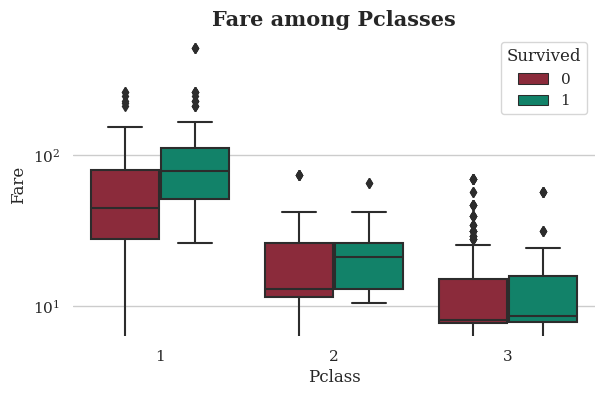

In [209]:

sns.boxplot(df.Pclass,df.Fare,hue=df.Survived)
sns.despine(top=1,bottom=1,right=1,left=1)
plt.title('Fare among Pclasses',fontweight='bold',fontsize=15)
plt.yscale('log')

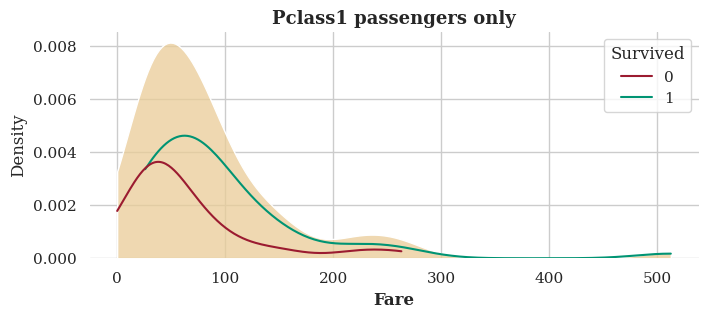

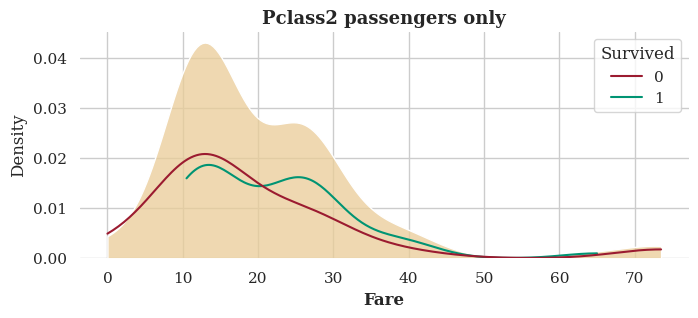

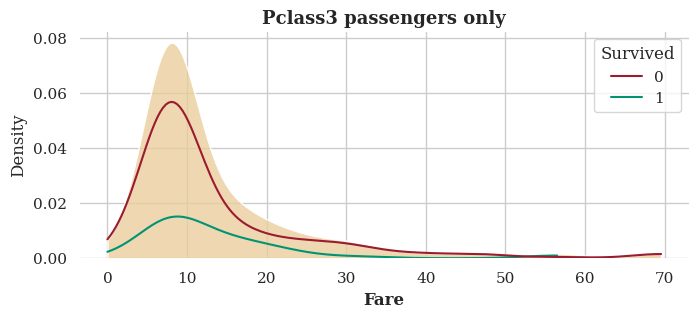

In [210]:
for i in range(1,4):
    kdeplot(df[df.Pclass==i],['Fare'],'Survived',cut=1,w=7,h=3)
    plt.title(f'Pclass{i} passengers only',fontweight='bold',fontsize=13)

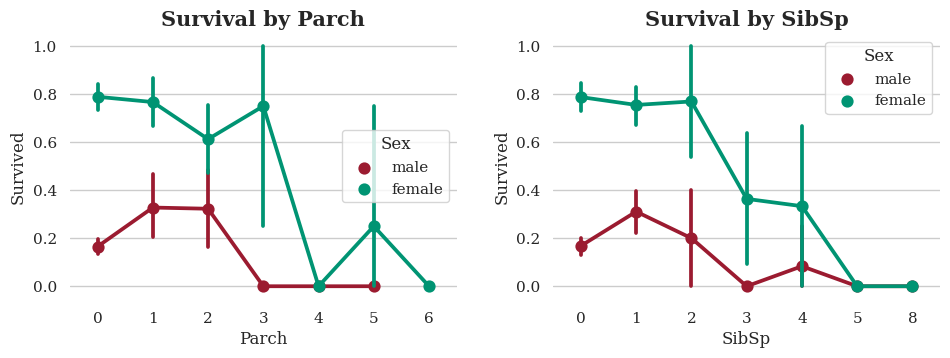

In [211]:
f=plt.figure(figsize=(10,3.5))
plt.subplots_adjust(wspace=.25)
for j,i in enumerate(['Parch','SibSp']):
    f.add_subplot(1,2,j+1)
    sns.pointplot(data=df,x=i,y='Survived',hue='Sex')
    plt.title(f'Survival by {i}',fontweight='bold',fontsize=15)
    sns.despine(top=1,bottom=1,left=1,right=1)

In [40]:
# Plotting
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
morancolor=sns.color_palette(['#6a2202', '#bc7201', '#e5ab09', '#22180d', '#0f1a26','#241c24', '#745656', '#c7b44f', '#977f48', '#392c23'])
plt.style.use("fivethirtyeight")
sns.set_palette(morancolor)

plt.rcParams['font.family']='serif'
plt.rcParams['figure.dpi'] =100 # high resolution

# Manage warnings
import warnings
warnings.filterwarnings('ignore')

In [235]:
# Plotting
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
morancolor=sns.color_palette(['#9b1b30', '#009473', '#f0c05a','#6a2202', '#bc7201', '#e5ab09', '#22180d', '#0f1a26','#241c24', '#745656', '#c7b44f', '#977f48', '#392c23'])
plt.style.use("fivethirtyeight")
sns.set_palette(morancolor)

plt.rcParams['font.family']='serif'
plt.rcParams['figure.dpi'] =100 # high resolution

# Manage warnings
import warnings
warnings.filterwarnings('ignore')

In [236]:
df=pd.read_csv("https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/00-seaborndiabetes.csv")
df.drop_duplicates(inplace=True)
df.dropna(how='all',inplace=True)
df.sample(3)

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
531,0,107,76,0,0,45.3,0.686,24,0
615,3,106,72,0,0,25.8,0.207,27,0
286,5,155,84,44,545,38.7,0.619,34,0


In [237]:
df=df.rename(columns={"DiabetesPedigreeFunction":"Dpf"})

In [238]:
def despine():
    sns.despine(top=1,bottom=1,right=1,left=1)
    
def title(title,fontsize=13):
    plt.title(title,fontweight='bold',fontsize=fontsize)

In [239]:
from scipy.stats import skew
def kdeall(df,lst,h=4,w=10,cut=3,hspace=.5,wspace=.25,meanskew=True,kdecut=0,legendsize=10,xlabelsize=13,loc='best'):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        if meanskew==True:
            sns.kdeplot(df.dropna(subset=[col])[col],cut=kdecut,label=f'Skewness: {skew(df.dropna(subset=[col])[col]):.2f}',lw=3)
            plt.axvline(df.dropna(subset=[col])[col].mean(),label='mean',color='#22180d',lw=1.5)
            plt.axvline(df.dropna(subset=[col])[col].median(),label='median',ls='--',color='#22180d',lw=1.5)
            plt.legend(fontsize=legendsize,loc=loc)
        else: sns.kdeplot(df.dropna(subset=[col])[col],cut=kdecut,lw=3)
        sns.rugplot(df.dropna(subset=[col])[col])
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold',fontsize=xlabelsize)

In [240]:
def kde2(df,lst,target,h=4,w=10,cut=3,hspace=.5,wspace=.25,xlabel=12):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        ax=f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.kdeplot(data=df.dropna(subset=[col,target]),x=col,hue=target,cut=0)
        sns.rugplot(data=df.dropna(subset=[col,target]),x=col,hue=target)
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold',fontsize=xlabel)

In [241]:
def boxall(df,lst,hspace=.5,wspace=.25,cut=3,h=7,w=10,target=None):
    f=plt.figure(figsize=(w,h))
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        if target==None: sns.boxplot(y=df[col],showmeans=True)
        else: sns.boxplot(x=df[target],y=df[col],showmeans=True)
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold')
        sns.despine(top=1,bottom=1,left=1,right=1)
    plt.subplots_adjust(hspace=hspace,wspace=wspace)

In [242]:
def barall(df,lst,target,hspace=.5,wspace=.25,cut=3,h=7,w=10,color=None):
    f=plt.figure(figsize=(w,h))
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.barplot(y=df[target],x=df[col],color=color)
        plt.xlabel(col,fontweight='bold')
        sns.despine(top=1,bottom=1,left=1,right=1)
    plt.subplots_adjust(hspace=hspace,wspace=wspace)

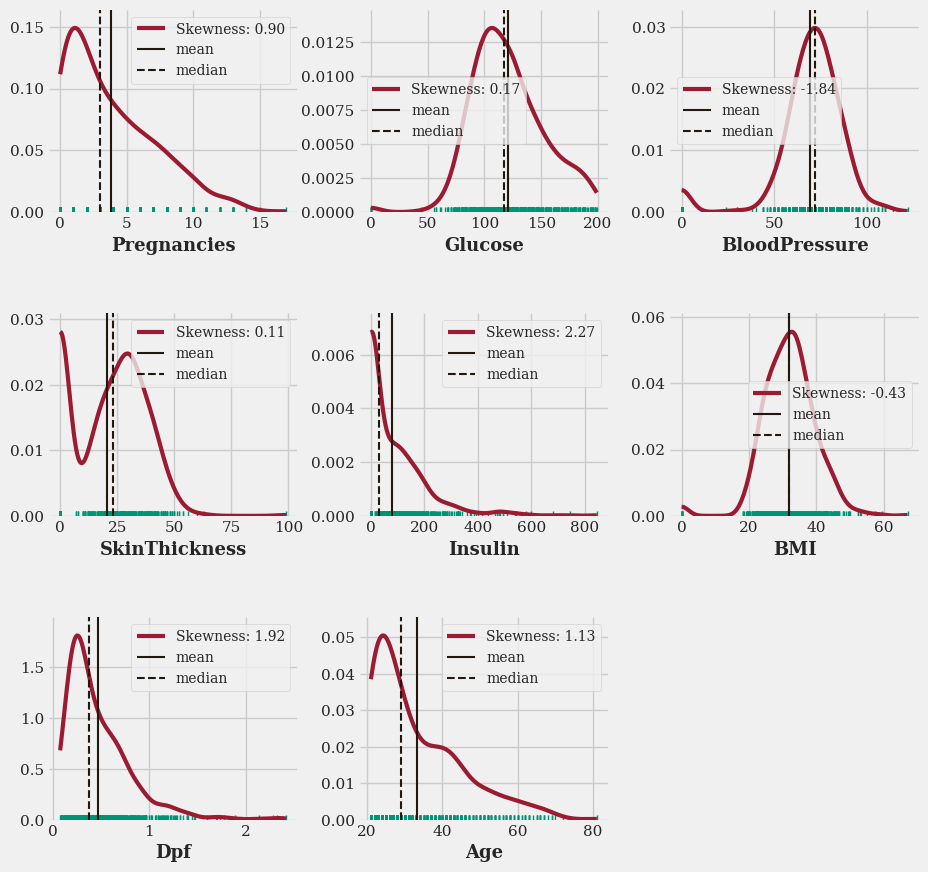

In [243]:
numcol=df.columns.tolist()[:-1]
kdeall(df,numcol,h=10)

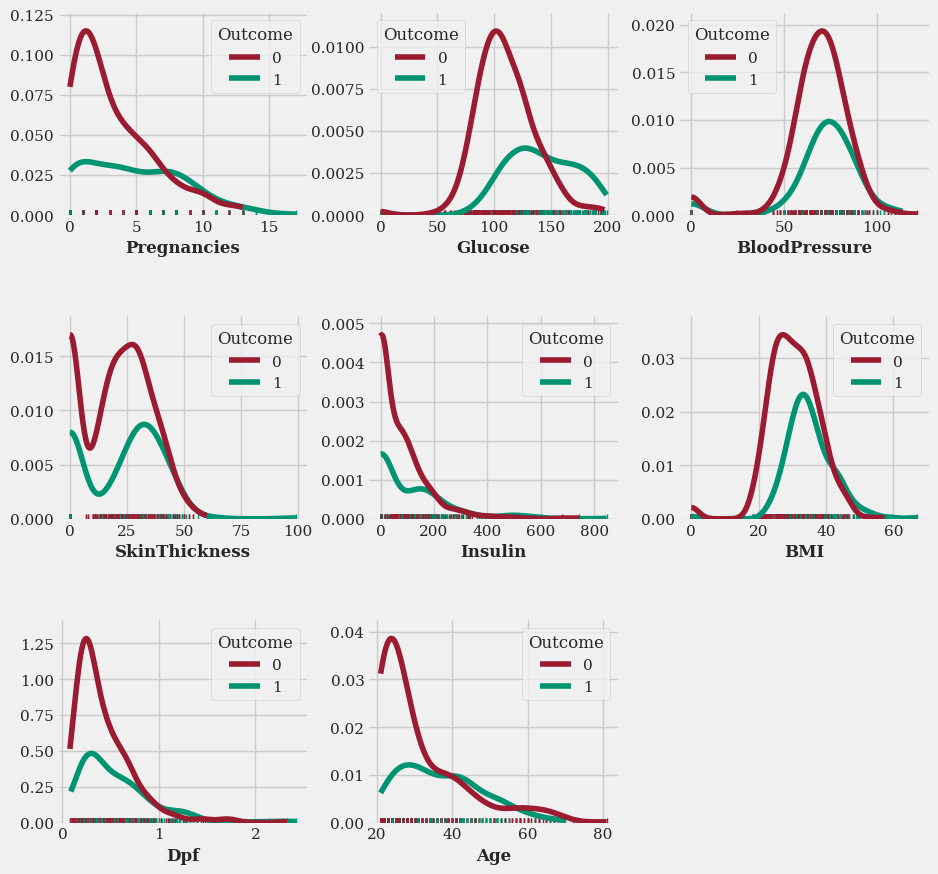

In [244]:
kde2(df,numcol,h=10,target='Outcome')

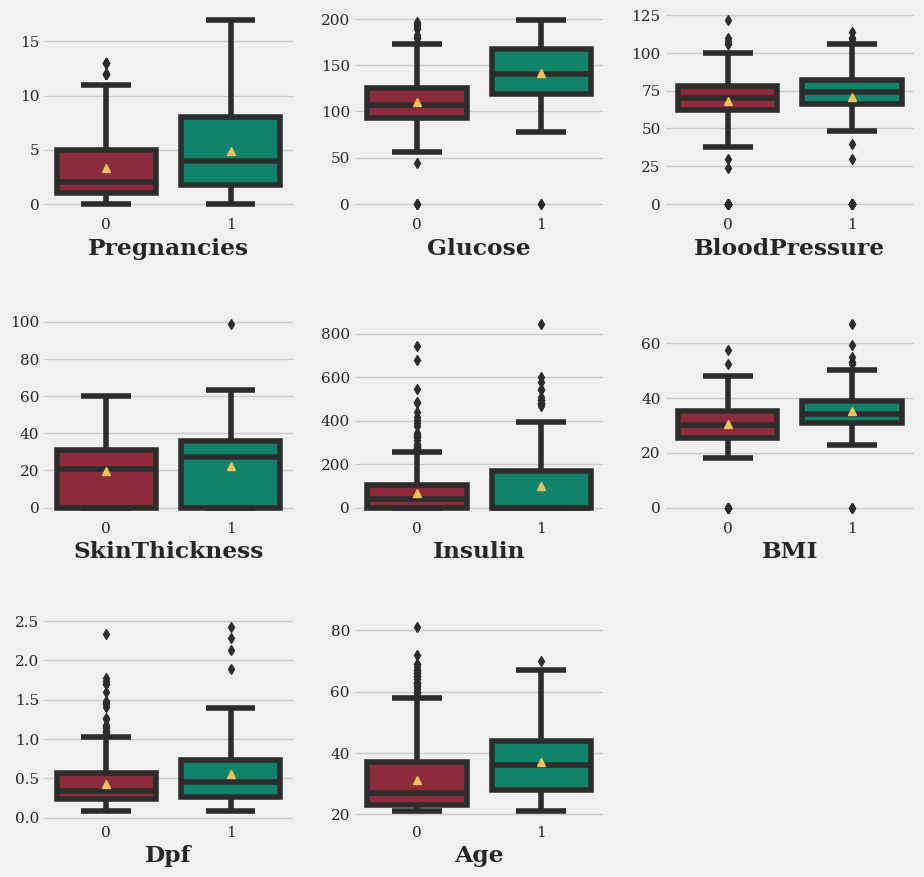

In [245]:
boxall(df,numcol,h=10,cut=3,w=10,target='Outcome')

In [53]:
mostimp=["Glucose","BMI","Age"]
df.describe()[mostimp]

,Glucose,BMI,Age
count,768.000000,768.000000,768.000000
mean,120.894531,31.992578,33.240885
std,31.972618,7.884160,11.760232
min,0.000000,0.000000,21.000000
25%,99.000000,27.300000,24.000000
50%,117.000000,32.000000,29.000000
75%,140.250000,36.600000,41.000000
max,199.000000,67.100000,81.000000


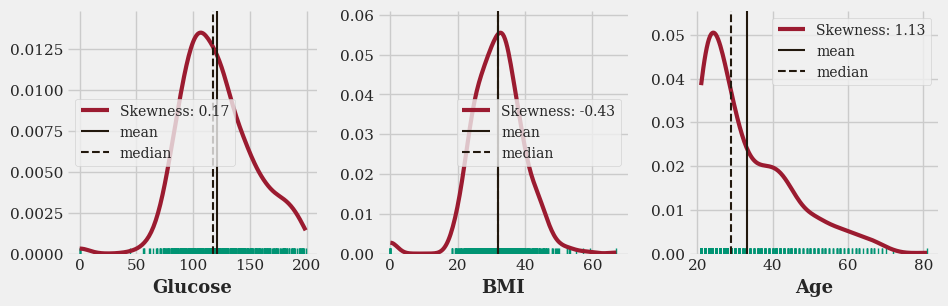

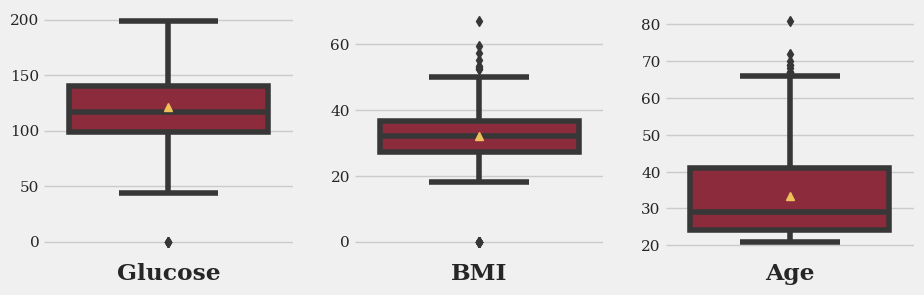

In [246]:
kdeall(df,mostimp,h=3,cut=3)
boxall(df,mostimp,h=3,cut=3)

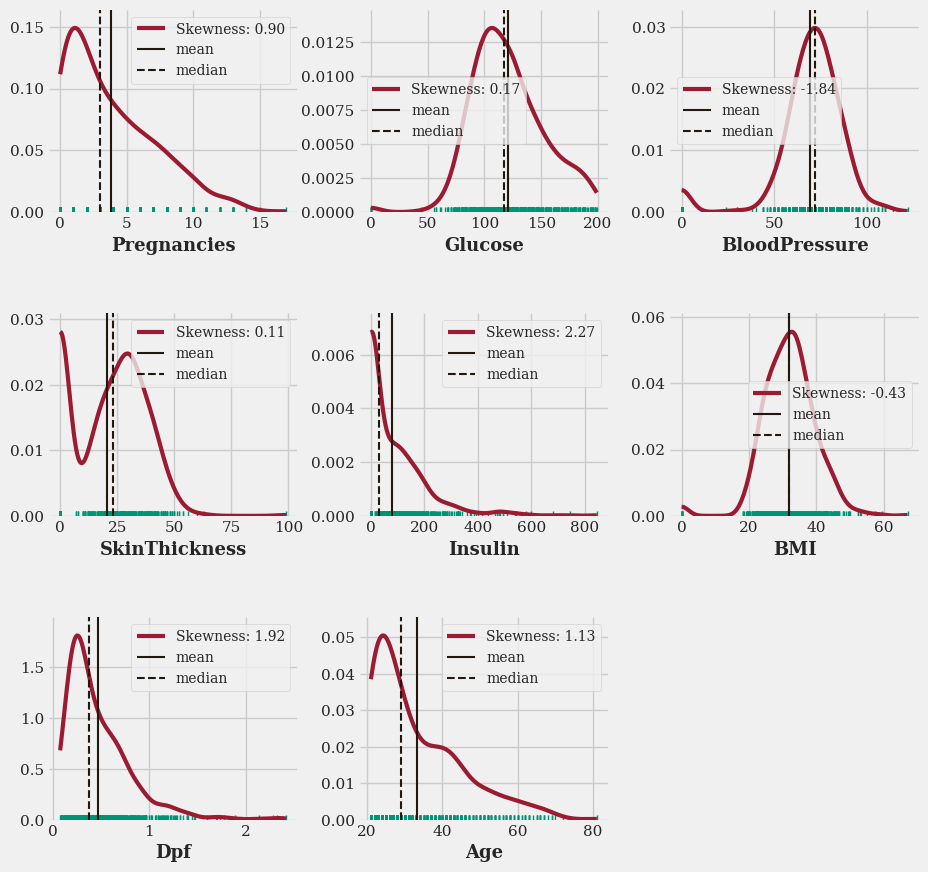

In [234]:
kdeall(df,numcol,h=10)

In [247]:
df=pd.read_csv("https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/00-seabornwater_potability.csv")
df.dropna(how='all',inplace=True)
df.drop_duplicates(inplace=True)
df.shape

(3276, 10)

In [248]:
def despine():
    sns.despine(top=1,bottom=1,right=1,left=1)
    
def title(title,fontsize=13):
    plt.title(title,fontweight='bold',fontsize=fontsize)

In [249]:
def countall(df,lst,h=4,w=10,cut=3,hspace=.5,wspace=.25,annotsize=10):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        ax=f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.countplot(df[col])
        for p in ax.patches:
            ax.annotate(f"{p.get_height()/df[col].shape[0]*100:.2f}%",xy=[p.get_x(),p.get_height()],fontsize=annotsize)
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold')

In [250]:
from scipy.stats import skew
def kdeall(df,lst,h=4,w=10,cut=3,hspace=.5,wspace=.25,meanskew=True,kdecut=0,legendsize=10,xlabelsize=13,loc='best'):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        if meanskew==True:
            sns.kdeplot(df.dropna(subset=[col])[col],cut=kdecut,label=f'Skewness: {skew(df.dropna(subset=[col])[col]):.2f}',lw=3)
            plt.axvline(df.dropna(subset=[col])[col].mean(),label='mean',color='#22180d',lw=1.5)
            plt.axvline(df.dropna(subset=[col])[col].median(),label='median',ls='--',color='#22180d',lw=1.5)
            plt.legend(fontsize=legendsize,loc=loc)
        else: sns.kdeplot(df.dropna(subset=[col])[col],cut=kdecut,lw=3)
        sns.rugplot(df.dropna(subset=[col])[col])
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold',fontsize=xlabelsize)

In [251]:
def pointall(df,lst,target,h=4,w=10,cut=3,hspace=.5,wspace=.25,annotsize=10,choose=1):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        ax=f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        if choose==1: sns.pointplot(x=df[target],y=df[col],lw=3)
        else: sns.pointplot(x=df[col],y=df[target],lw=3)
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold')

In [252]:
def histall(df,lst,target,h=4,w=10,cut=3,hspace=.5,wspace=.25,xlabel=12):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        ax=f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.histplot(data=df.dropna(subset=[col,target]),x=col,hue=target)
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold',fontsize=xlabel)

In [253]:
def boxall(df,lst,h=4,w=10,cut=3,hspace=.5,wspace=.25,annotsize=10,target=None):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        ax=f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        if target==None: sns.boxplot(df[col])
        else: sns.boxplot(df[target],df[col])
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold')

In [254]:
def kdesmall(x):
    sns.kdeplot(df[x],hue=df.Potability,lw=3,cut=0)
    title(f'Distribution of {x}')

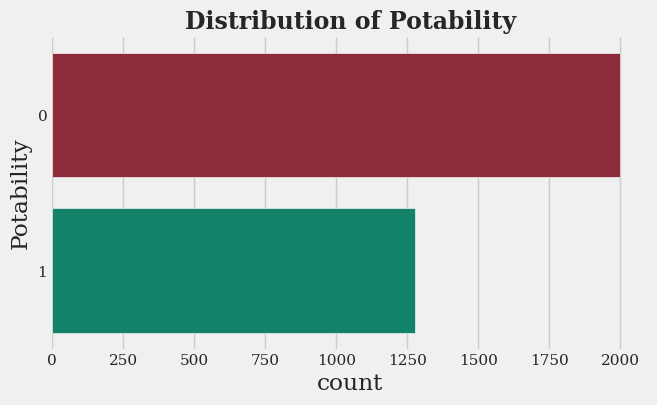

In [255]:
sns.catplot(data=df,y="Potability",kind='count',height=4,aspect=1.7)
despine()
title('Distribution of Potability',fontsize=17)

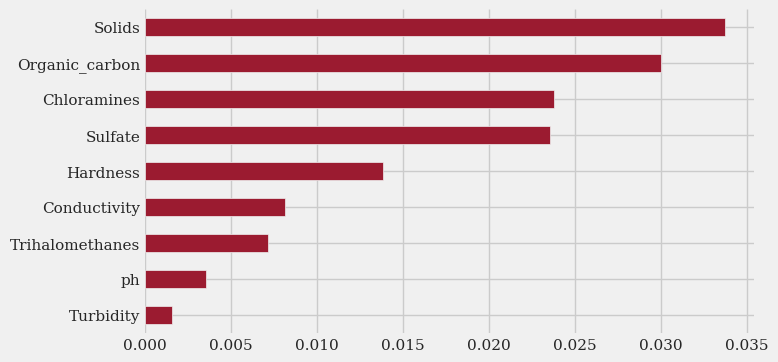

In [256]:
df.corr().Potability.abs().sort_values(ascending=False)[1:][::-1].plot(kind='barh',figsize=(7,4))
plt.yticks(fontsize=11)
despine()

In [257]:
col=df.corr().Potability.abs().sort_values(ascending=False)[1:].index.tolist()
col

['Solids',
 'Organic_carbon',
 'Chloramines',
 'Sulfate',
 'Hardness',
 'Conductivity',
 'Trihalomethanes',
 'ph',
 'Turbidity']

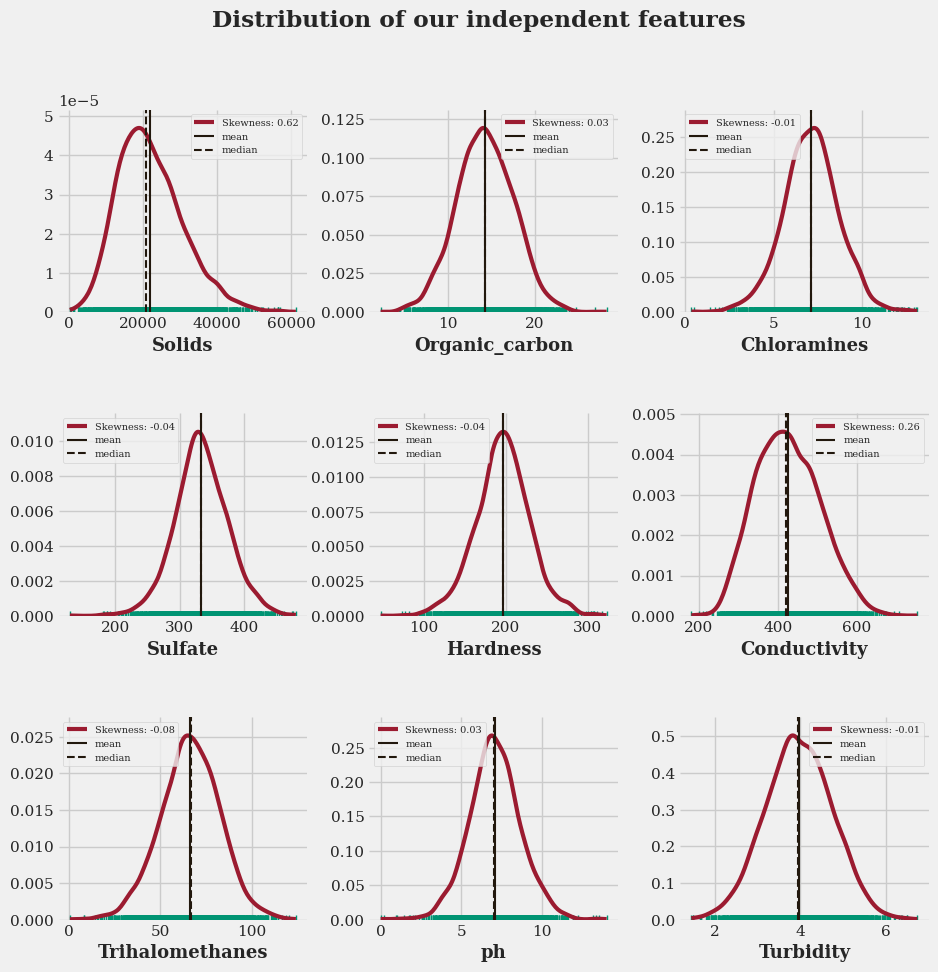

In [258]:
kdeall(df,col,cut=3,h=10,w=10,legendsize=7)
plt.suptitle('Distribution of our independent features',fontweight='bold')
plt.show()

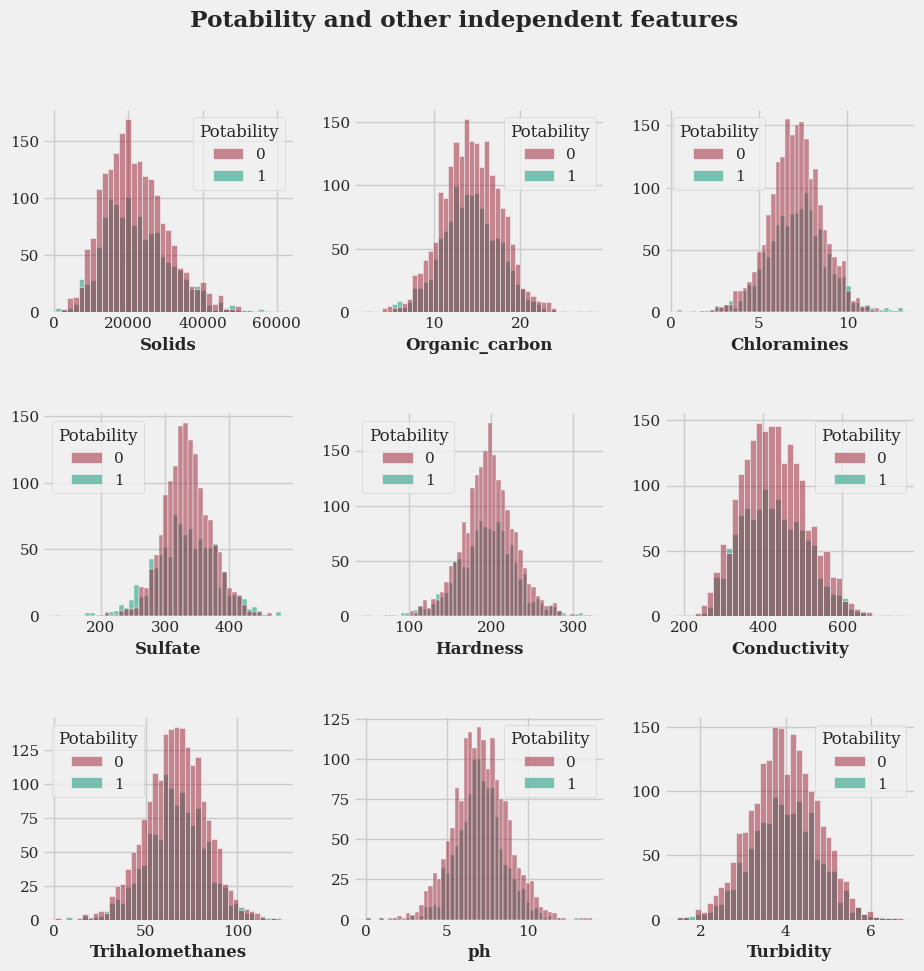

In [259]:
histall(df,col,"Potability",h=10)
plt.suptitle('Potability and other independent features',fontweight='bold')
plt.show()

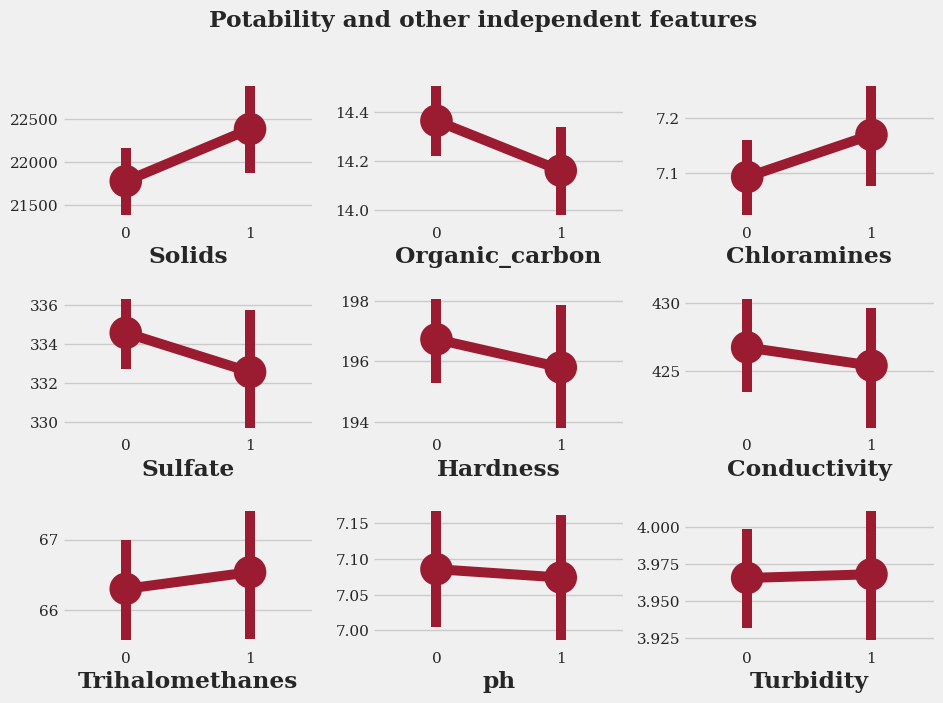

In [260]:
pointall(df,col,"Potability",h=7)
plt.suptitle('Potability and other independent features',fontweight='bold')
plt.show()

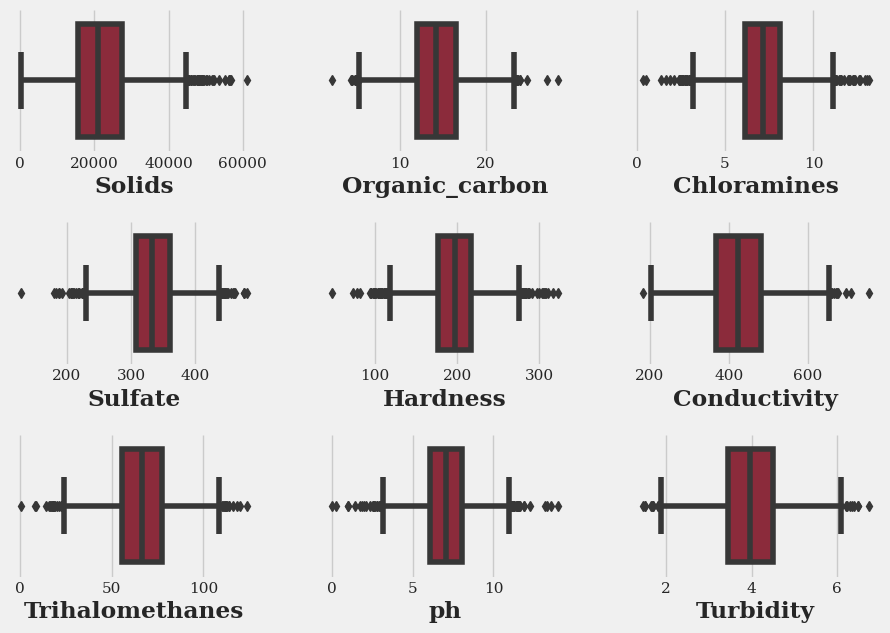

In [261]:
boxall(df,col,h=7)

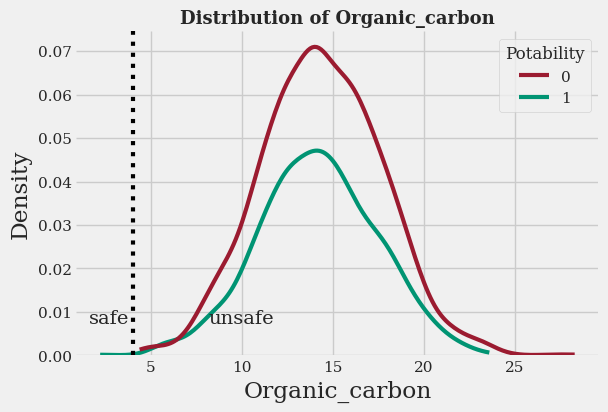

In [262]:
kdesmall("Organic_carbon")
plt.axvline(x=4,lw=3,ls=':',color='black')
plt.figtext(0.1, 0.15, 'safe')
plt.figtext(0.3, 0.15, 'unsafe')
despine()

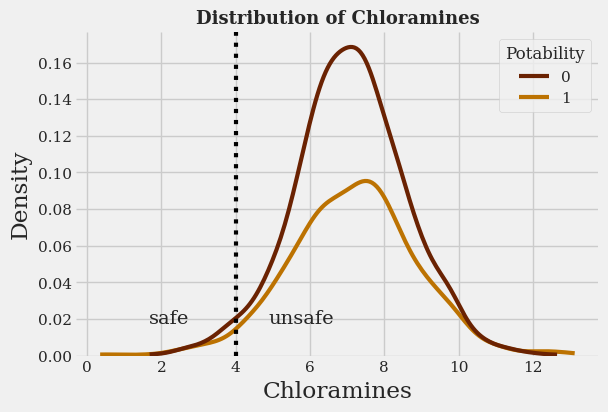

In [77]:
kdesmall("Chloramines")
plt.axvline(x=4,lw=3,ls=':',color='black')
plt.figtext(0.2, 0.15, 'safe')
plt.figtext(0.4, 0.15, 'unsafe')
despine()

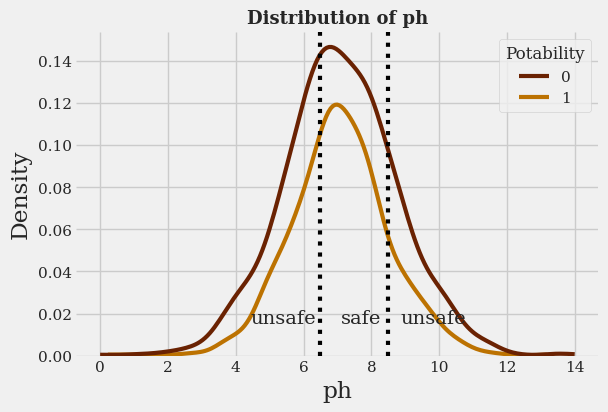

In [78]:
kdesmall("ph")
plt.axvline(x=6.5,lw=3,ls=':',color='black')
plt.axvline(x=8.5,lw=3,ls=':',color='black')
plt.figtext(0.52, 0.15, 'safe')
plt.figtext(0.37, 0.15, 'unsafe')
plt.figtext(0.62, 0.15, 'unsafe')

despine()

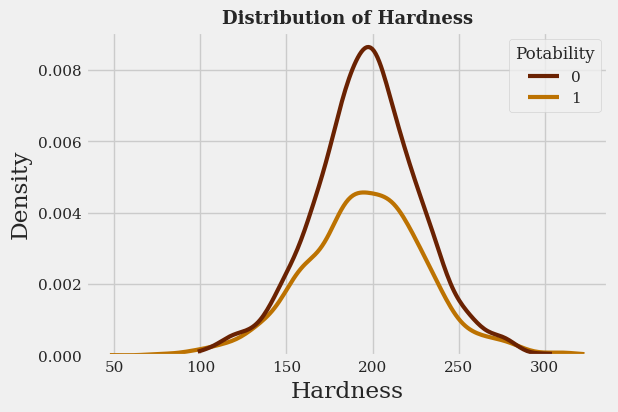

In [79]:
kdesmall("Hardness")

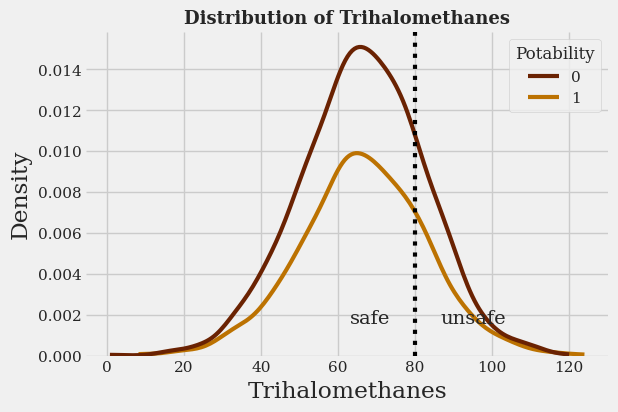

In [80]:
kdesmall("Trihalomethanes")
plt.axvline(x=80,lw=3,ls=':',color='black')
plt.figtext(0.52, 0.15, 'safe')
plt.figtext(0.67, 0.15, 'unsafe')
despine()

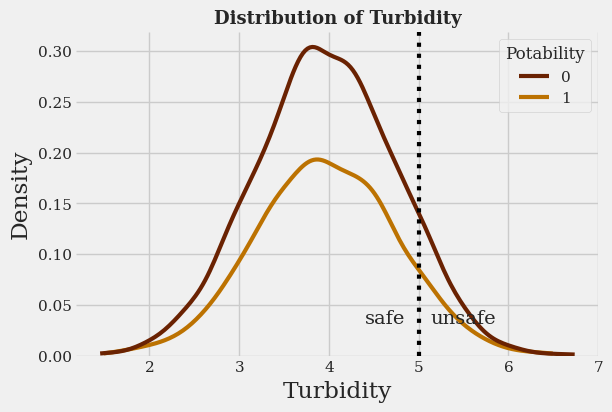

In [81]:
kdesmall("Turbidity")
plt.axvline(x=5,lw=3,ls=':',color='black')
plt.figtext(0.56, 0.15, 'safe')
plt.figtext(0.67, 0.15, 'unsafe')

despine()

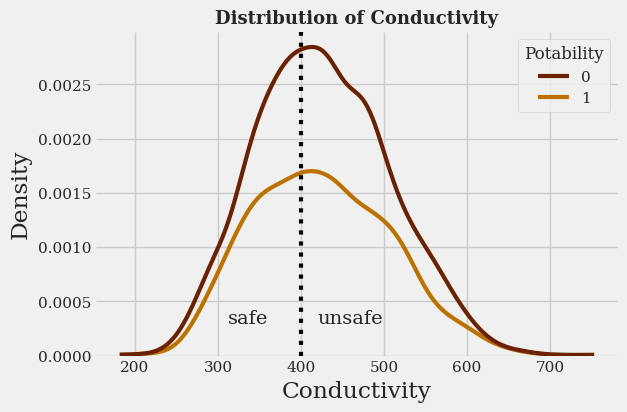

In [82]:
kdesmall("Conductivity")
plt.axvline(x=400,lw=3,ls=':',color='black')
plt.figtext(0.3, 0.15, 'safe')
plt.figtext(0.45, 0.15, 'unsafe')

despine()

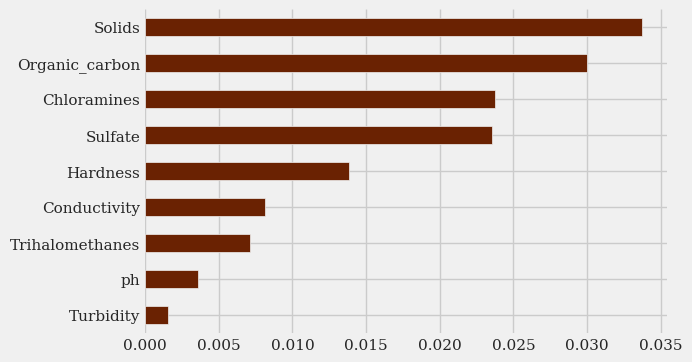

In [83]:
df.corr().Potability.abs().sort_values(ascending=False)[1:][::-1].plot(kind='barh')
despine()

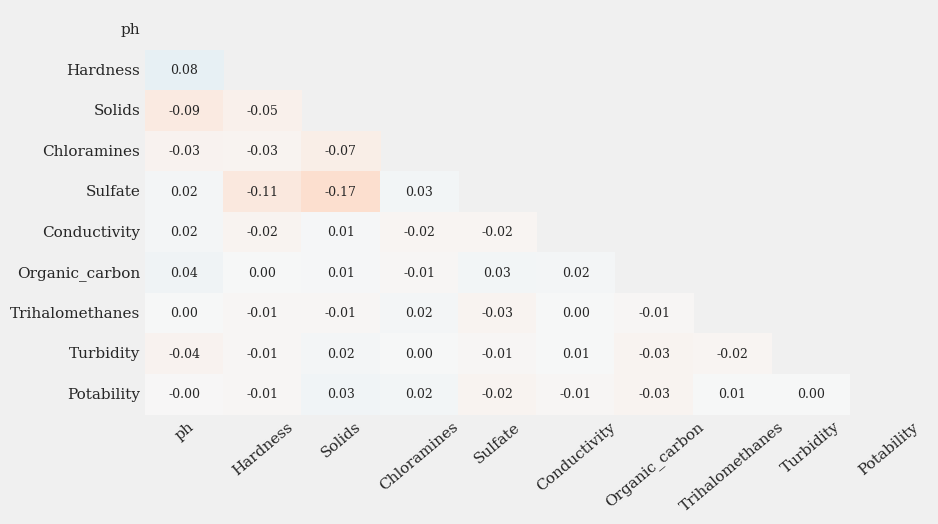

In [84]:
mask = np.triu(np.ones_like(df.corr()))
f=plt.figure(figsize=(9,5))
sns.heatmap(df.corr(),cmap='RdBu',vmax=1,vmin=-1,mask=mask,annot=True,fmt='.2f',annot_kws={"size":9},cbar=False)
plt.yticks(fontsize=11)
plt.xticks(fontsize=11,rotation=40)
plt.show()

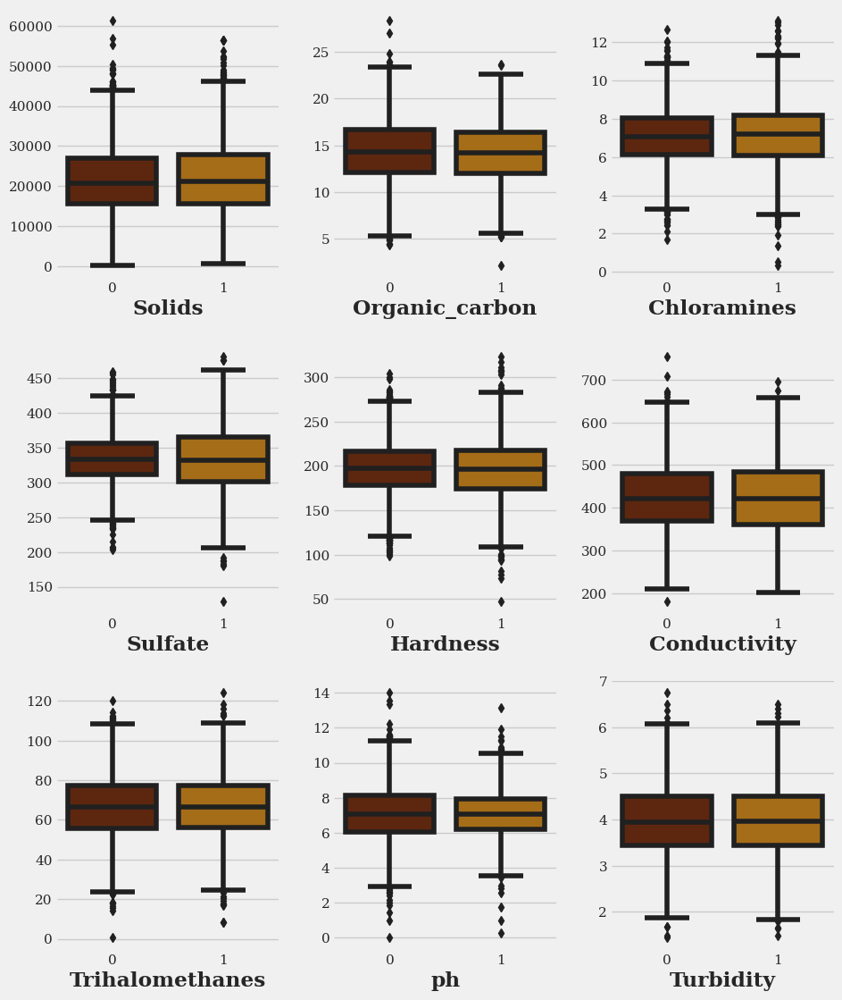

In [85]:
boxall(df,col,h=13,target="Potability",hspace=.25)

In [91]:
df.dropna(inplace=True)

In [92]:
import statsmodels.api as sm
def select_by_pvalue(target,df,fence=.05,w=7,h=5,textw=.5,texth=.2):
    mod=sm.OLS(df[target],df.drop(target,axis=1))
    fii=mod.fit()
    sub=fii.summary2().tables[1]["P>|t|"].sort_values()
    sub.plot(kind='barh',figsize=(w,h))
    pvalue_set=sub[sub<=fence].index.tolist()
    plt.axvline(x=fence,c='black')
    plt.figtext(textw, texth, 'dropped',fontsize=15, fontweight='bold')
    return pvalue_set

['Solids']

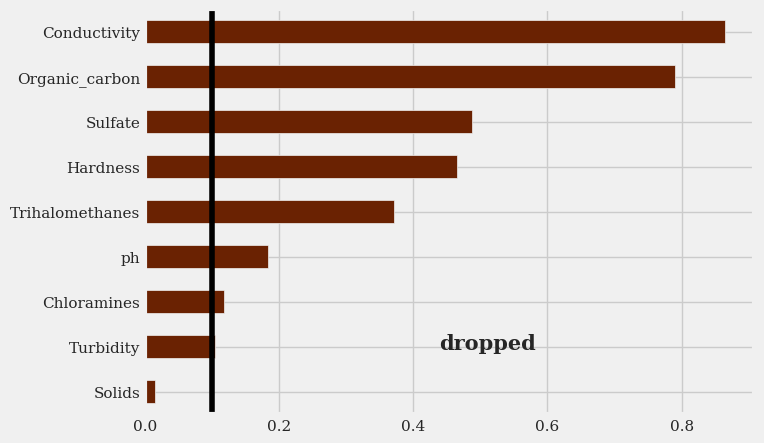

In [93]:
select_by_pvalue("Potability",df,fence=.1)

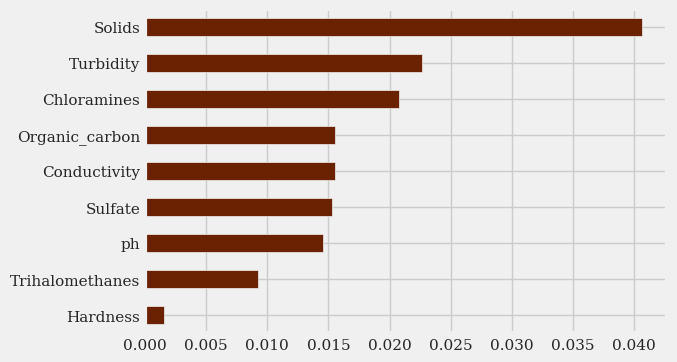

In [94]:
df.corr().Potability.abs().sort_values(ascending=False)[1:][::-1].plot(kind='barh')

In [95]:
# Plotting
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
morancolor=sns.color_palette(['#66260b', '#cb8034', '#ddc08d', '#9c886f', '#47261a','#363634', '#524636', '#ac7330', '#b19a78', '#d1c5ab'])
sns.set_theme(style="whitegrid", palette=morancolor)
plt.rcParams['font.family']='serif'
plt.rcParams['figure.dpi'] =100 # high resolution

# Manage warnings
import warnings
warnings.filterwarnings('ignore')

In [165]:
# Plotting
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
morancolor=sns.color_palette(['#9b1b30', '#009473', '#f0c05a'])
sns.set_theme(style="whitegrid", palette=morancolor)
plt.rcParams['font.family']='serif'
plt.rcParams['figure.dpi'] =100 # high resolution

# Manage warnings
import warnings
warnings.filterwarnings('ignore')

In [166]:
path="https://raw.githubusercontent.com/Rodrigo-Lopes-de-Andrade/Datasets/main/00-seabornWA_Fn-UseC_-Telco-Customer-Churn.csv"
df=pd.read_csv(path)
df.shape

(7043, 21)

In [167]:
df.TotalCharges=df.TotalCharges.replace(' ',0).astype('float32')
df.Churn=df.Churn.map({'Yes':1,'No':0}).astype('int')

In [168]:
def despine():
    sns.despine(top=1,bottom=1,right=1,left=1)
    
def title(title,fontsize=13):
    plt.title(title,fontweight='bold',fontsize=fontsize)

In [169]:
from scipy.stats import skew
def kdeall(df,lst,target,h=4,w=15,cut=3,showmeans=False,hspace=.5,wspace=.25,showskew=True):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.kdeplot(df.dropna(subset=[col,target])[col],cut=0,multiple='stack',alpha=.2)
        sns.kdeplot(df.dropna(subset=[col,target])[col],hue=df[target],cut=0)
        sns.rugplot(df.dropna(subset=[col,target])[col],hue=df.Churn)
        despine()
        plt.ylabel('')
        plt.xlabel(col,fontweight='bold')

In [170]:
def barall(df,lst,target,h=4,w=15,cut=3,hspace=.5,wspace=.25,rotatelst=[],rotation=20,xticksize=10,titlesize=11,yticksize=10):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.barplot(data=df,x=col,y=target)
        if col in rotatelst: plt.xticks(rotation=rotation)
        plt.xticks(fontsize=xticksize)
        plt.yticks(fontsize=yticksize)
        plt.xlabel('')
        plt.title(col,fontweight='bold',fontsize=titlesize)
        plt.ylabel('')
        despine()

In [171]:
def boxall(df,lst,h=4,w=10,cut=3,hspace=.5,wspace=.25,showmeans=True):
    f=plt.figure(figsize=(w,h))
    plt.subplots_adjust(hspace=hspace,wspace=wspace)
    for i,col in enumerate(lst):
        f.add_subplot(math.ceil(len(lst)/cut),cut,i+1)
        sns.boxplot(df[col], showmeans=showmeans)
        plt.xlabel(col,fontweight='bold')
        plt.ylabel('')
        despine()

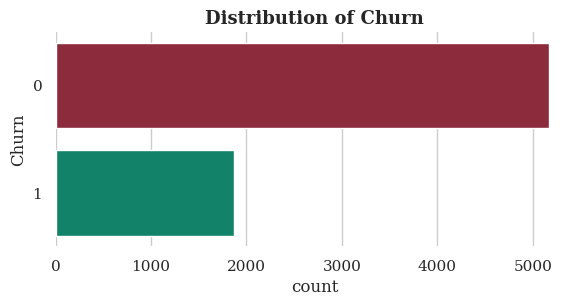

In [172]:
sns.catplot(data=df,y='Churn',kind='count',height=3,aspect=2)
title('Distribution of Churn')
despine()

In [173]:
numcol=df.select_dtypes('number').drop(['SeniorCitizen','Churn'],axis=1).columns.tolist()
numcol

['tenure', 'MonthlyCharges', 'TotalCharges']

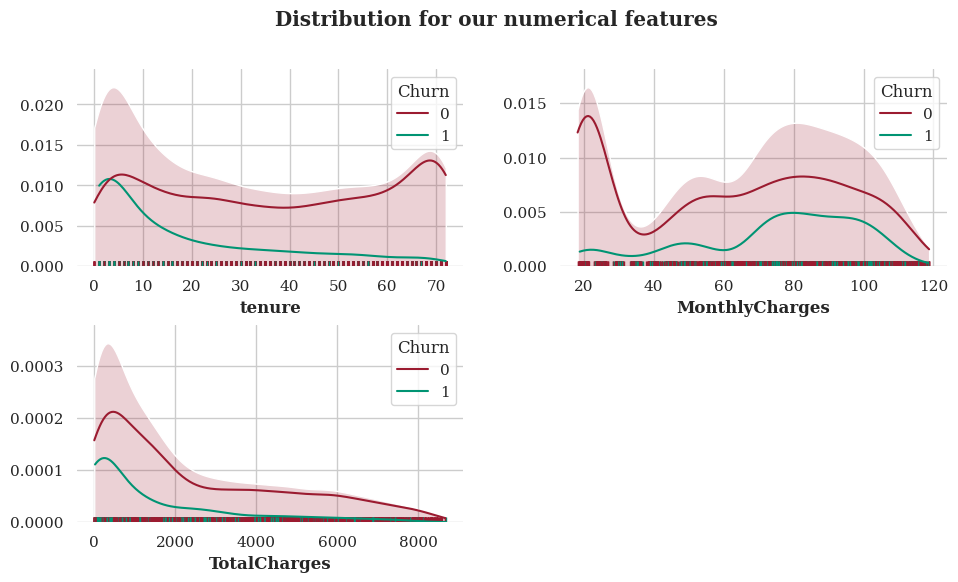

In [174]:
kdeall(df,numcol,'Churn',h=6,cut=2,w=10,hspace=.3)
plt.suptitle('Distribution for our numerical features',fontweight='bold')
plt.show()

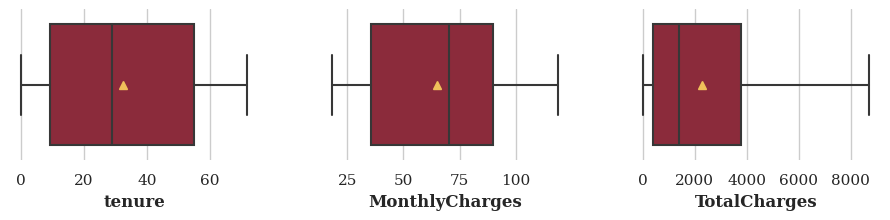

In [175]:
boxall(df,numcol,h=2)

In [176]:
catcol=df.select_dtypes("O").nunique().sort_values(ascending=False)[1:].index.tolist()
print(f"We have {len(catcol)} categorical features")

We have 15 categorical features


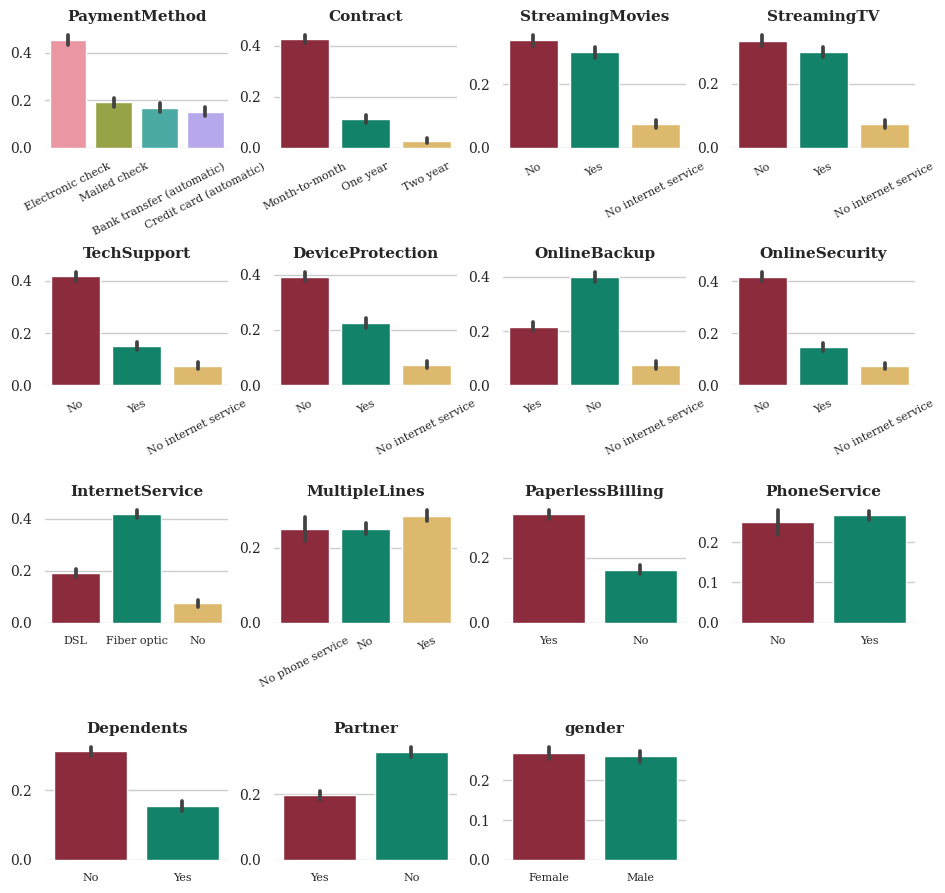

In [177]:
barall(df,catcol,'Churn',w=10,h=11,cut=4,
       rotatelst=['PaymentMethod','MultipleLines','OnlineSecurity','OnlineBackup','DeviceProtection','TechSupport',
                 'Contract','StreamingTV','StreamingMovies'],
       xticksize=8,rotation=27,hspace=1)

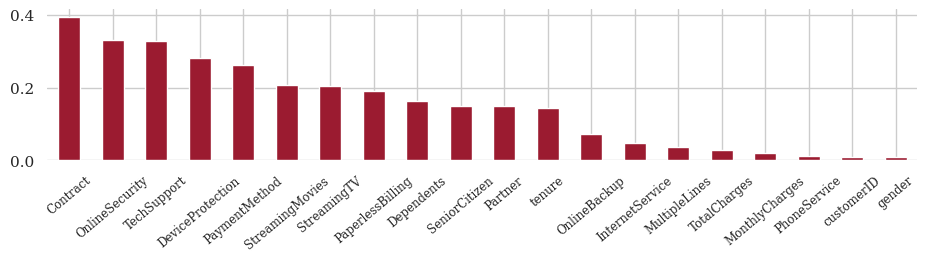

In [178]:
# we use pd.factorize to encode the object as an enumerated type or categorical variable
df.apply(lambda x: pd.factorize(x)[0]).corr().Churn.abs().sort_values(ascending=False)[1:].plot(kind='bar',figsize=(10,2))
plt.xticks(fontsize=8.5, rotation=40)
despine()

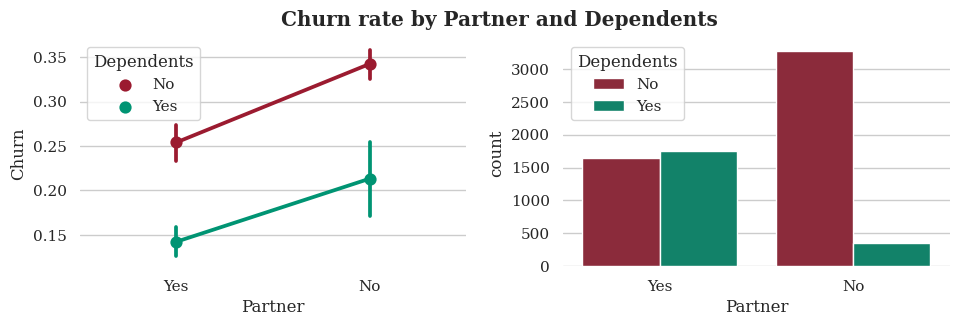

In [179]:
f,ax=plt.subplots(1,2,figsize=(10,3))
plt.subplots_adjust(wspace=.25)
sns.pointplot(data=df,x='Partner',y='Churn',hue='Dependents',ax=ax[0])
sns.countplot(df.Partner,hue=df.Dependents,ax=ax[1])
plt.suptitle('Churn rate by Partner and Dependents',fontweight='bold')
despine()

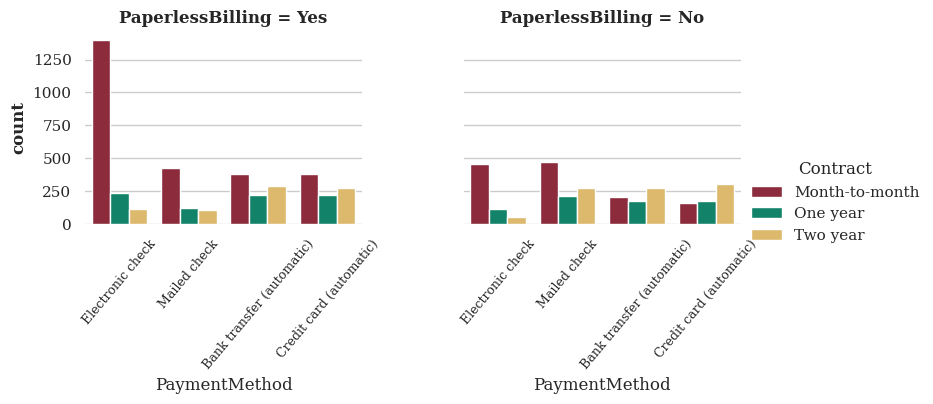

In [180]:
g=sns.catplot(data=df,x="PaymentMethod",col="PaperlessBilling",hue="Contract",kind='count',height=3,aspect=1.3,
             col_wrap=2)
for ax in g.axes:
    ax.set_xticklabels(ax.get_xticklabels(),rotation=50,fontsize=9)
g.set_titles(fontweight='bold')
g.set_ylabels(fontweight='bold')
despine()

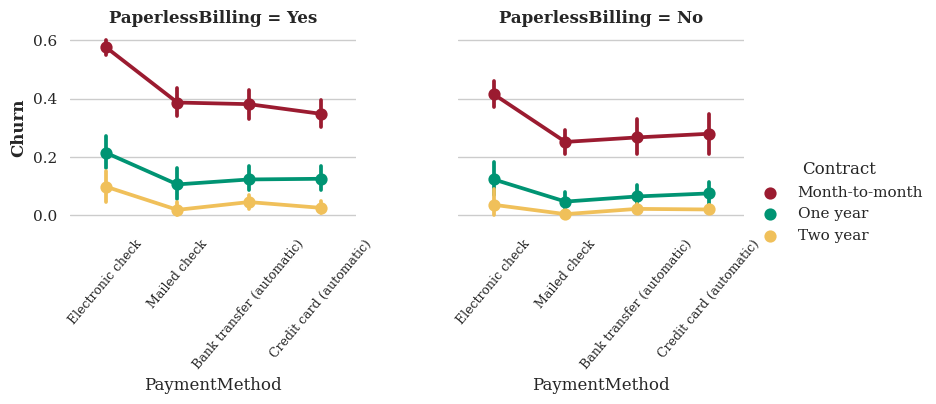

In [181]:
g=sns.catplot(data=df,x="PaymentMethod",y="Churn",col="PaperlessBilling",hue="Contract",kind='point',height=3,aspect=1.3,
             col_wrap=2)
for ax in g.axes:
    ax.set_xticklabels(ax.get_xticklabels(),rotation=50,fontsize=9)
g.set_titles(fontweight='bold')
g.set_ylabels(fontweight='bold')
despine()

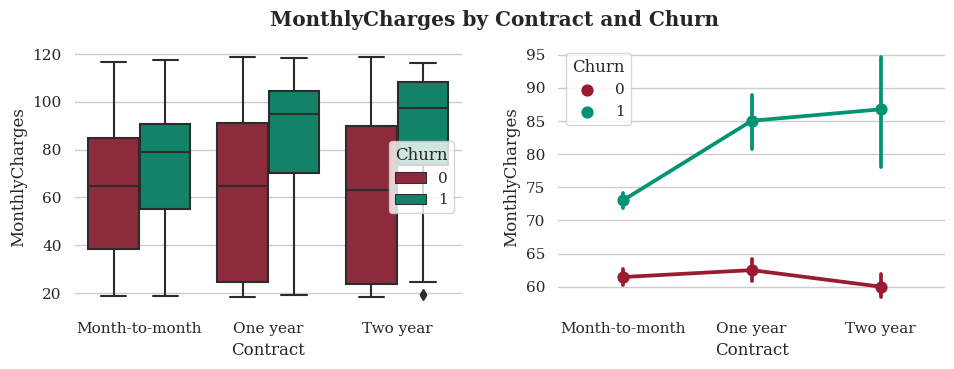

In [182]:
f,ax=plt.subplots(1,2,figsize=(10,3.5))
plt.subplots_adjust(wspace=.25)
sns.boxplot(df.Contract,df.MonthlyCharges,hue=df.Churn,ax=ax[0])
sns.pointplot(df.Contract,df.MonthlyCharges,hue=df.Churn)
plt.suptitle('MonthlyCharges by Contract and Churn',fontweight='bold')
despine()

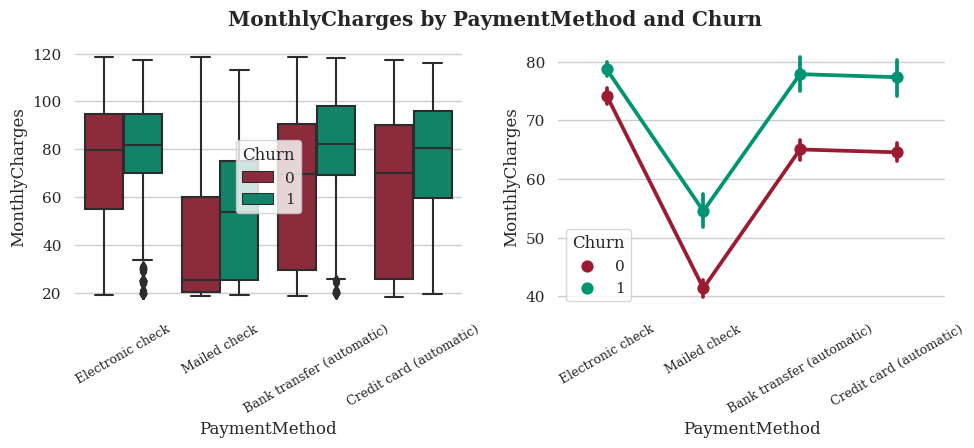

In [183]:
f,ax=plt.subplots(1,2,figsize=(10,3.5))
plt.subplots_adjust(wspace=.25)
sns.boxplot(df.PaymentMethod,df.MonthlyCharges,hue=df.Churn,ax=ax[0])
sns.pointplot(df.PaymentMethod,df.MonthlyCharges,hue=df.Churn)
plt.suptitle('MonthlyCharges by PaymentMethod and Churn',fontweight='bold')
for i in [0,1]:
    ax[i].tick_params(axis='x', rotation=30, labelsize=9)
despine()

In [184]:
sub=pd.Series(data=clf.feature_importances_,index=X.columns).sort_values()
plt.figure(figsize=(5,10))
plt.barh(sub.index,sub.values)
plt.yticks(fontsize=8)
title('Our features importance')
despine()

NameError: ignored

## Paletas

In [ ]:
colors = ["#004c70", "#990000",'#990000']

In [ ]:
# Default visual settings

plt.rcParams["font.family"] = "serif"
plt.rcParams['figure.dpi'] = 150

In [ ]:
# Ignore warnings

import warnings
warnings.filterwarnings("ignore")
background_color = "#fafafa"

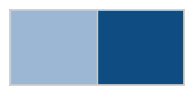

In [121]:
sns.palplot(['#9bb7d4','#0f4c81'])

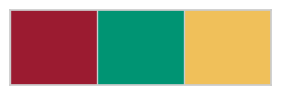

In [120]:
sns.palplot(['#9b1b30', '#009473', '#f0c05a'])

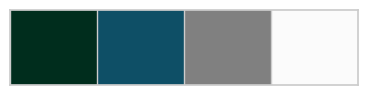

In [119]:
sns.palplot(['#002d1d','#0e4f66','gray','#fbfbfb'])

In [117]:
background_color = "#fafafa"
face_color = '#fafafa'


yes_c='#9b1b30'
no_c='#009473'
neut_c ='#112e51'

sub_col = '#a49a93'

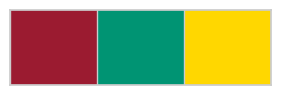

In [118]:
sns.palplot([yes_c,no_c,'gold'])


In [124]:
# Custom parameters for my plots
import matplotlib.pyplot as plt
from matplotlib import rc
font = {'size'   : 10}
matplotlib.rc('font', **font)
# change font
matplotlib.rcParams['font.sans-serif'] = "Times New Roman"
matplotlib.rcParams['font.family'] = "serif"


# colors

background_color = '#fff1e5'
face_color = '#fffcfa'

col = '#33302e'
sub_col = '#a49a93'

# Custom colour map 
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['#1e558b','#FF8AAF','#E6668E'])

surv_c = '#1e558b'
no_surv_c = '#E6668E'


title = 15
sub = 10
font = 'serif'
b = 'bold'

col = '#33302e'
sub_col = '#a49a93'

# Custom colour map 
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['#1e558b','#FF8AAF','#E6668E'])

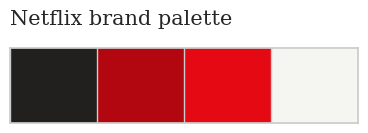

In [125]:
# Palette
sns.palplot(['#221f1f', '#b20710', '#e50914','#f5f5f1'])

plt.title("Netflix brand palette ",loc='left',fontfamily='serif',fontsize=15,y=1.2)
plt.show()

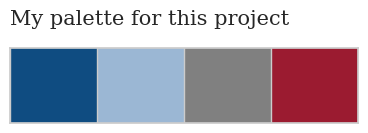

In [126]:
sns.palplot(['#0f4c81', '#9bb7d4', 'gray','#9b1b30'])
plt.title("My palette for this project",loc='left',fontfamily='serif',fontsize=15,y=1.2)
plt.show()

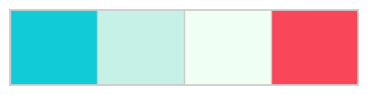

In [140]:
colors= ['#11CBD7' ,'#C6F1E7' ,'#F0FFF3' ,'#FA4659']
sns.palplot(colors,size = 1)



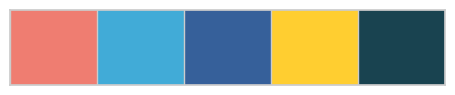

In [133]:
# color palette
colors = ['#EF7D71','#41ABD7','#36609A','#FFCE30','#194350']
sns.palplot(colors,size = 1)

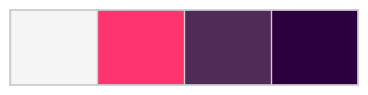

In [136]:
# color palette for visualizations
colors = ['#f6f5f5','#fe346e','#512b58','#2c003e']
palette = sns.color_palette( palette = colors)
sns.palplot(colors,size = 1)

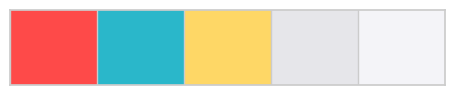

In [137]:
colors= ['#fe4a49' ,'#2ab7ca' ,'#fed766' ,'#e6e6ea' ,'#f4f4f8']
palette = sns.color_palette( palette = colors)
sns.palplot(colors,size = 1)

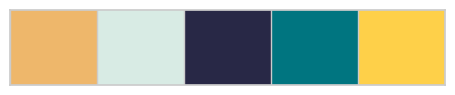

In [138]:
colors = ['#EEB76B','#D8EBE4','#282846','#007580','#fed049']
palette = sns.color_palette( palette = colors)
sns.palplot(colors,size = 1)

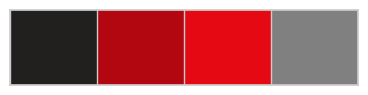

In [139]:
colors = ['#221f1f', '#b20710', '#e50914','grey']
palette = sns.color_palette( palette = colors)
sns.palplot(colors,size = 1)

In [143]:
colors = ['#FB5B68','#FFEB48','#2676A1','#FFBDB0',]
colormap = matplotlib.colors.LinearSegmentedColormap.from_list("",colors)

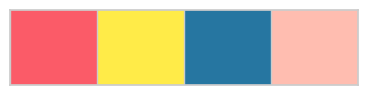

In [142]:
colors = ['#FB5B68','#FFEB48','#2676A1','#FFBDB0',]
palette = sns.color_palette( palette = colors)
sns.palplot(colors,size = 1)